# <a name="0"><font color='Blue'>**Walmart Sales**</font></a>
## **A Time Series problem.**
### The competition page from [this](https://www.kaggle.com/datasets/mikhail1681/walmart-sales) link.
![Drag Racing](https://academy.education.investing.com/wp-content/uploads/2022/10/walmart.jpg)

We will study the sales data of one of the largest retailers in the world. Let's figure out what factors influence its revenue. Can factors such as air temperature and fuel cost influence the success of a huge company along with the purchasing power index and seasonal discounts? And how does machine learning minimize costs and increase economic impact?

The data contains the following columns:

- Store: Store number
- Date: Sales week start date
- Weekly_Sales: Sales
- Holiday_Flag: Mark on the presence or absence of a holiday
- Temperature: Air temperature in the region
- Fuel_Price: Fuel cost in the region
- CPI: Consumer price index
- Unemployment: Unemployment rate

## **Table of Contents of the notebook:**

1. <a href="#1">**Setup**</a>
2. <a href="#2">**Data Preperation**</a>
4. <a href="#3">**Gaining Insights (EDA)**</a>
5. <a href="#4">**Train Test Split**</a>
6. <a href="#5">**Time Series Models**</a>
7. <a href="#6">**Machine Leaning Model**</a>
8. <a href="#7">**Deep Leaning Model**</a>
8. <a href="#8">**Choosing Best Model**</a>

# 1. <a name="1">**Setup**</a>

**Installing and Importing used libraries.**

In [73]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import mean_squared_error
from joblib import Parallel, delayed
from statsmodels.tsa.seasonal import MSTL
from statsmodels.tsa.stattools import kpss,adfuller
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pmdarima import auto_arima
from lightgbm import LGBMRegressor
from prophet import Prophet
#logging.getLogger("cmdstanpy").disabled = True
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm
from itertools import product
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
from pandas.plotting import autocorrelation_plot
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
import statsmodels.tsa as smt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import STL
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
import statsmodels.api as sm
import scipy.stats as scs

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, month_plot, quarter_plot
plt.rcParams['figure.figsize'] = 25, 8


# 2. <a name="2">**Reading the dataset**</a>


In [2]:
df = pd.read_csv('Walmart.csv', low_memory=False, parse_dates=['Date'])

In [3]:
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


In [4]:
df["Store"].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45])

In [5]:
df["Store"].nunique()

45

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


# 3. <a name="3">**Data preperation**</a>


## A- Choose The Store We will work on (Store 1)

In [7]:
df_1 = df[df["Store"] == 1]

## B- Check for nulls

In [8]:
df_1.isnull().sum()

Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64

## C- Make freq as Weekly

In [9]:
df_1.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


In [10]:
df_1["Date"] = pd.to_datetime(df_1["Date"],format='%d-%m-%Y')

In [11]:
df_1 = df_1.set_index("Date")

In [12]:
df_1

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
Date,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...
2012-09-28,1,1437059.26,0,76.08,3.666,222.981658,6.908
2012-10-05,1,1670785.97,0,68.55,3.617,223.181477,6.573
2012-10-12,1,1573072.81,0,62.99,3.601,223.381296,6.573


# 5. <a name="5">**Insights (EDA)**</a>

## A- Plot Sales (All train data)

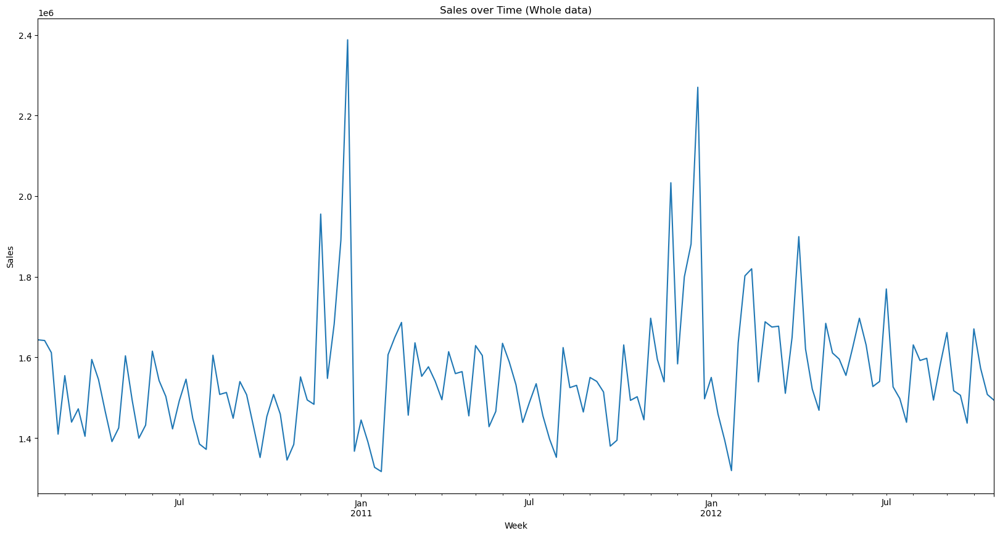

In [13]:
plt.figure(figsize=(20,10))
df_1["Weekly_Sales"].plot()
# plt.ylim(bottom=0)
plt.xlabel('Week')
plt.ylabel('Sales')
plt.title('Sales over Time (Whole data)')
plt.show()

## B- Plot Sales (Two Months)

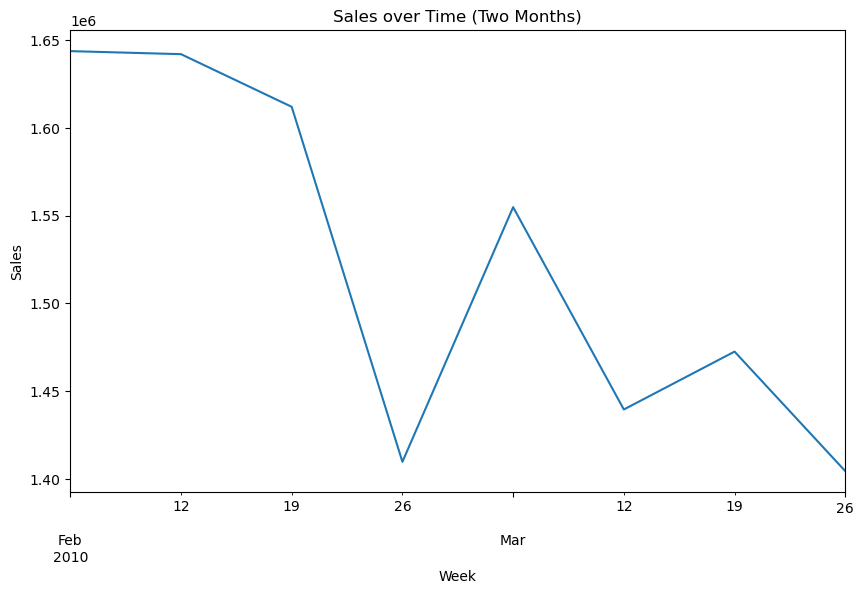

In [14]:
plt.figure(figsize=(10, 6))
df_1['Weekly_Sales'][:8].plot()
# plt.ylim(bottom=0)
plt.xlabel('Week')
plt.ylabel('Sales')
plt.title('Sales over Time (Two Months)')
plt.show()

## C- Plot Sales (One Year)

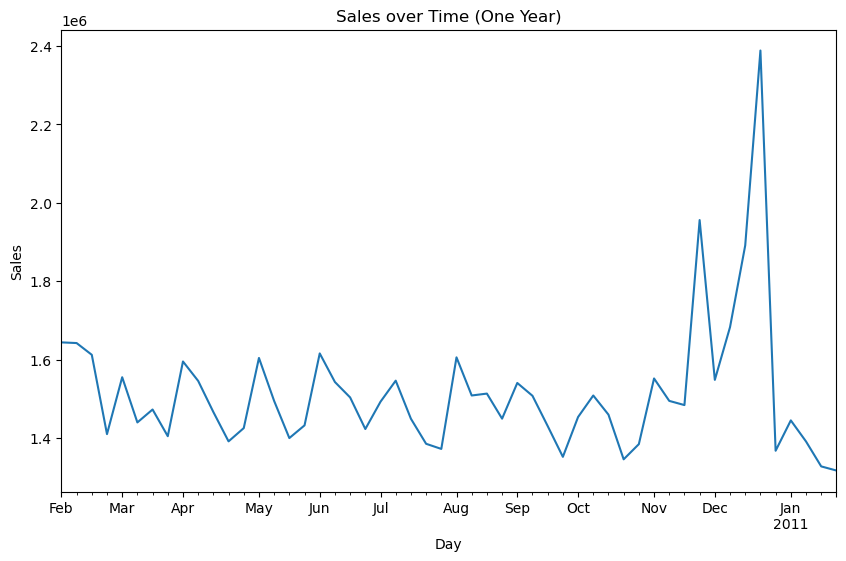

In [15]:
plt.figure(figsize=(10, 6))
df_1['Weekly_Sales'][:52].plot()

plt.xlabel('Day')
plt.ylabel('Sales')
plt.title('Sales over Time (One Year)')
plt.show()

### <font color='green'>**We see a peak in sales in Dec(Christmas weeks)**</font>

## D- Extract additional columns

In [16]:
df_1['year'] = df_1.index.year
df_1['month'] = df_1.index.month
df_1['Quarter'] = df_1.index.quarter
# Convert the columns to integers
df_1['year'] = df_1['year'].astype(int)
df_1['month'] = df_1['month'].astype(int)
df_1['Quarter'] = df_1['Quarter'].astype(int)


In [17]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 143 entries, 2010-02-05 to 2012-10-26
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         143 non-null    int64  
 1   Weekly_Sales  143 non-null    float64
 2   Holiday_Flag  143 non-null    int64  
 3   Temperature   143 non-null    float64
 4   Fuel_Price    143 non-null    float64
 5   CPI           143 non-null    float64
 6   Unemployment  143 non-null    float64
 7   year          143 non-null    int64  
 8   month         143 non-null    int64  
 9   Quarter       143 non-null    int64  
dtypes: float64(5), int64(5)
memory usage: 12.3 KB


## E- Seasonal Plots (Plot sales by different dates values)

In [18]:
df_1['wom'] = df_1.index.day // 7 + 1


In [19]:
def draw_seasonal_box_plot(df, col_name):
    # Draw Plot
    
    #plt.figure(figsize=(10, 10))  # Adjust the figsize as needed
    fig, axes = plt.subplots(1, 4,figsize=(15, 10))
    sns.boxplot(x='year', y=col_name, data=df, ax=axes[0])
    sns.boxplot(x='Quarter', y=col_name, data=df, ax=axes[1])
    sns.boxplot(x='month', y=col_name, data=df, ax=axes[2])
    sns.boxplot(x='wom', y=col_name, data=df, ax=axes[3])
    # Set Title
    axes[0].set_title('Year-wise Box Plot\n(The Trend)', fontsize=10)
    axes[1].set_title('Quarter-wise Box Plot\n(The Seasonality)', fontsize=10)
    axes[2].set_title('Month-wise Box Plot\n(The Seasonality)', fontsize=10)
    axes[3].set_title('Weeknumber-wise Box Plot\n(The Seasonality)', fontsize=10)
    
    plt.tight_layout()
    plt.show()

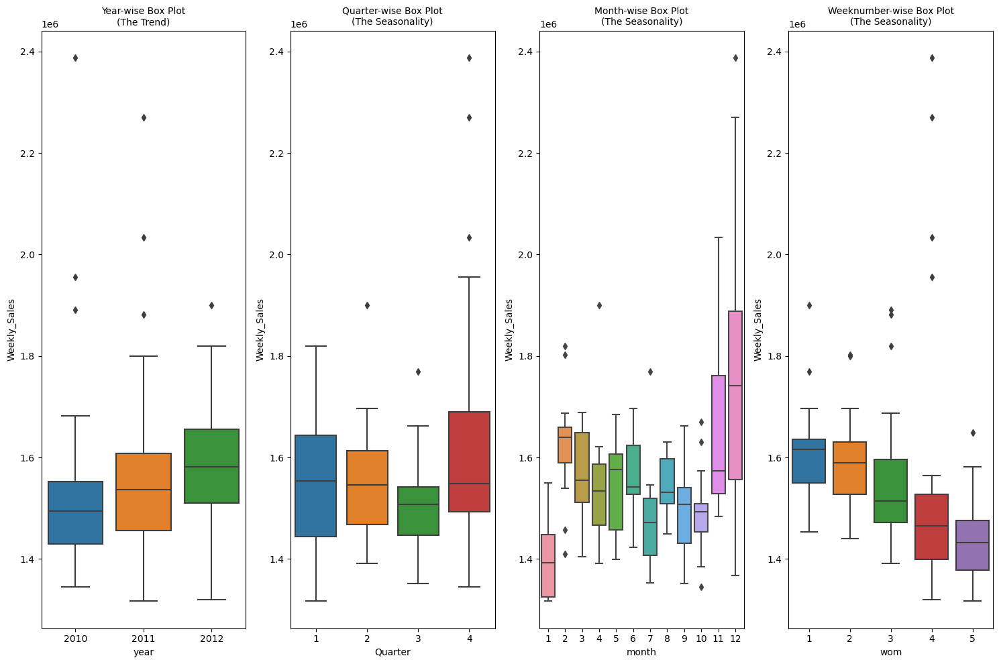

In [20]:
draw_seasonal_box_plot(df_1,"Weekly_Sales")

In [21]:
df_1.head()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,year,month,Quarter,wom
Date,,,,,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106,2010,2,1,1
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,1,2
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106,2010,2,1,3
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106,2010,2,1,4
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106,2010,3,1,1


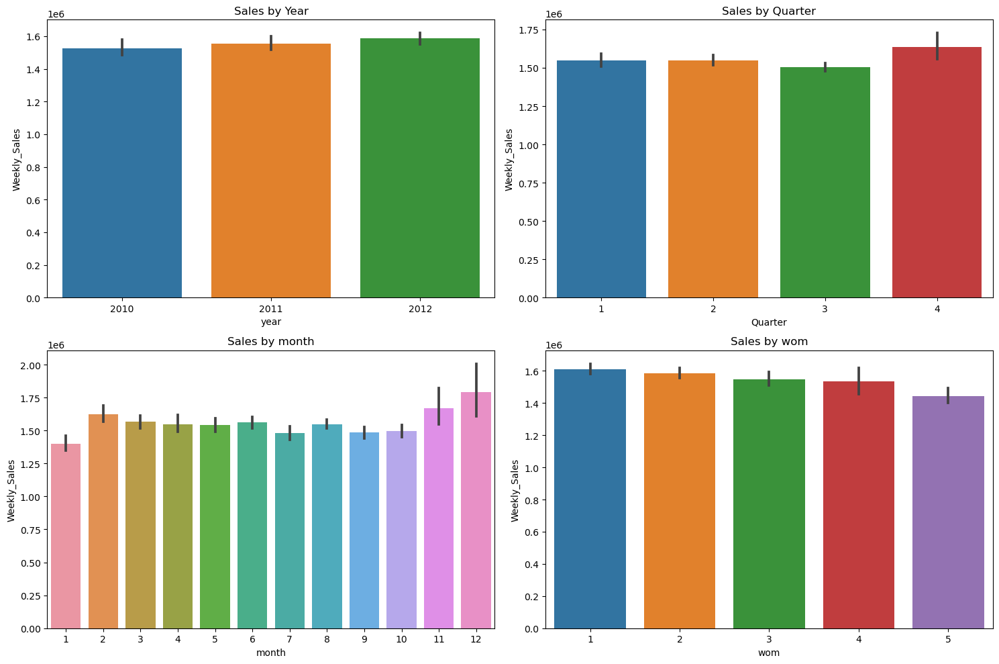

In [22]:
# Create a grid of bar charts
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
sns.barplot(x='year',y="Weekly_Sales", data=df_1, ax=axes[0, 0])
sns.barplot(x='Quarter',y="Weekly_Sales", data=df_1, ax=axes[0, 1])
sns.barplot(x='month',y="Weekly_Sales", data=df_1, ax=axes[1, 0])
sns.barplot(x='wom',y="Weekly_Sales", data=df_1, ax=axes[1, 1])

# Set the titles for each chart
axes[0, 0].set_title('Sales by Year')
axes[0, 1].set_title('Sales by Quarter')
axes[1, 0].set_title('Sales by month')
axes[1, 1].set_title('Sales by wom')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the grid of bar charts
plt.show()

### <font color='blue'>**The Insighst we gained:**<Br><Br>1. Sales Increase over the years<Br><Br>2. The peak of sales is on Nov and Dec<Br><Br>3. Sales increase in the first & second week and decrease through the month</font>

## F- Define Monthly seasonal plot

In [23]:
def monthly_quarter_line_plot(df,col_x,col_y,hue_col,title="Monthly"):
    plt.figure(figsize=(10,8))
    sns.lineplot(data=df,
                 x=col_x,
                 y=col_y,
                 hue=hue_col,
                 legend='full',palette="tab10")

    # add title
    plt.title(title+' Seasonal plot')

    # move the legend outside of the main figure
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)

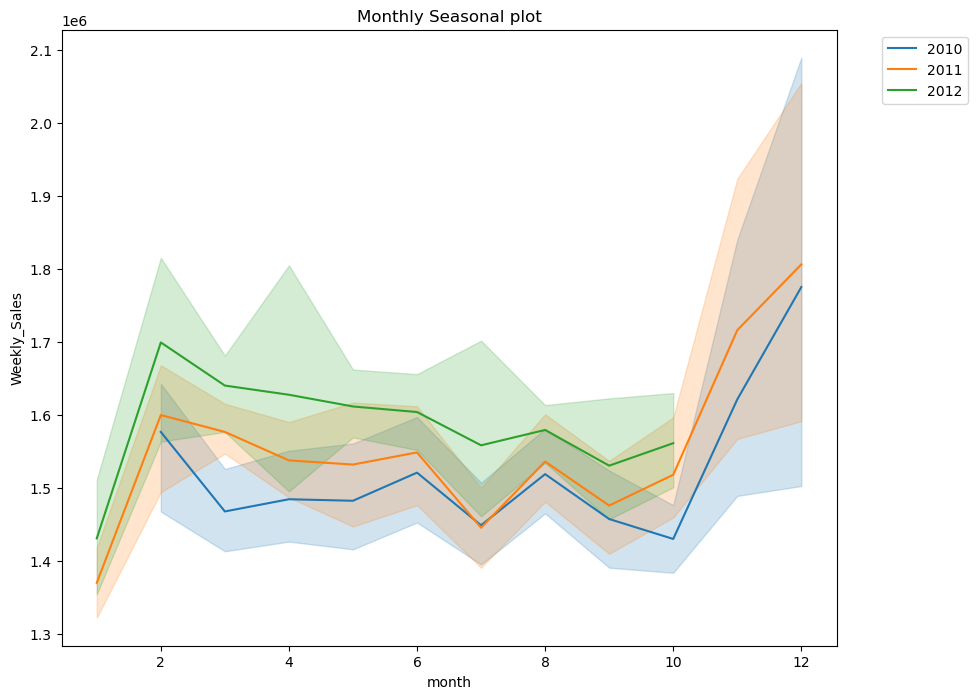

In [24]:
monthly_quarter_line_plot(df_1,"month","Weekly_Sales","year",title="Monthly")

In [25]:
df_1.columns

Index(['Store', 'Weekly_Sales', 'Holiday_Flag', 'Temperature', 'Fuel_Price',
       'CPI', 'Unemployment', 'year', 'month', 'Quarter', 'wom'],
      dtype='object')

In [26]:
df_1.head()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,year,month,Quarter,wom
Date,,,,,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106,2010,2,1,1
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,1,2
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106,2010,2,1,3
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106,2010,2,1,4
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106,2010,3,1,1


## H- Plot Sales in different conditions

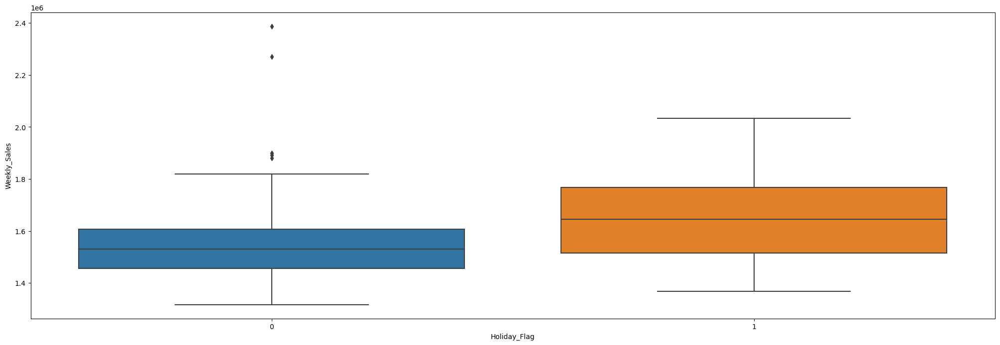

In [27]:
# Create a grid of bar charts

sns.boxplot(x='Holiday_Flag',y="Weekly_Sales", data=df_1)


# Set the titles for each chart
#plt.set_title('Sales in Holidays')

# Show the grid of bar charts
plt.show()

### <font color='green'>**Sales in holidays is higher than in normal days**</font>

## I- Define histogram function

In [28]:
def histograms(df,col_name,bins_number=100,diff=False, xmin=-1000, xmax=1000):
    if diff:
        plt.figure(figsize=(8,6))
        plt.hist(df[col_name].diff(),bins=bins_number)
        plt.xlim(xmin,xmax)
        plt.show()
    else:
        plt.figure(figsize=(8,6))
        plt.hist(df[col_name],bins=bins_number)
        plt.show()

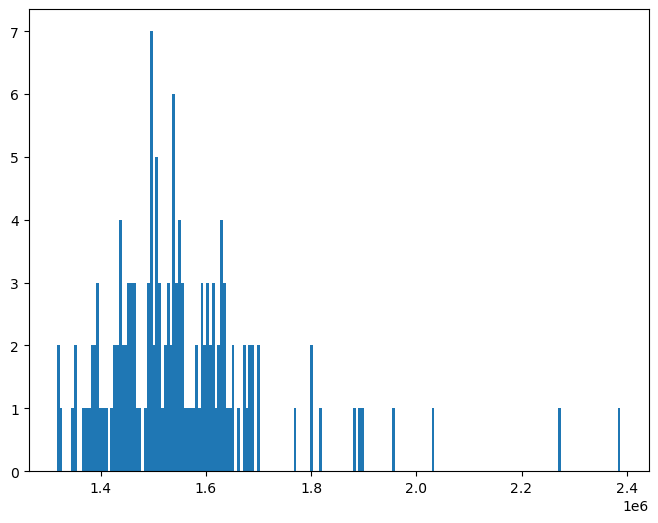

In [29]:
histograms(df_1,"Weekly_Sales",bins_number=200,diff=False)

## J- Time Series Decomposition:

### J1- Classical Decomposotion:

In [30]:
def classical_decomposition(data,period_value=7,model_type="additive",plots=True):
    #We set extrapolate_trend to 'freq' which results in no NaN values in trend or resid components
    #Because smoothing using moving average method within the period value in case of two_sided=True
    #or at the begining only if we set two_sided=False
    result= seasonal_decompose(data,period=period_value, model=model_type,two_sided=False,
                                   extrapolate_trend='freq')
    
    trend = result.trend
    
    seasonal = result.seasonal
    residuals = result.resid
    
    if plots:
        resid_var = np.var(residuals.values)
        trend_resid_var = np.var(residuals.values+trend.values)
        seasonal_resid_var = np.var(residuals.values+seasonal.values)
        trend_strength = max(0,1-(resid_var/trend_resid_var))
        seasonal_strength = max(0,1-(resid_var/seasonal_resid_var))
        
        print(f"The strength of the trend is: {trend_strength} \n And the strength of Seasonality is: {seasonal_strength}")
        
        fig,axes = plt.subplots(4, 1, sharex=True, sharey=False)
        fig.set_figheight(10)
        fig.set_figwidth(15)

        axes[0].plot(data, label='Original')
        axes[0].legend(loc='upper left')

        axes[1].plot(trend, label='Trend')
        axes[1].legend(loc='upper left')

        axes[2].plot(seasonal, label='Seasonality')
        axes[2].legend(loc='upper left')

        axes[3].plot(residuals, label='Residuals')
        axes[3].legend(loc='upper left')
    
    return trend,seasonal,residuals


The strength of the trend is: 0.3386355232675762 
 And the strength of Seasonality is: 0.009698456853384885


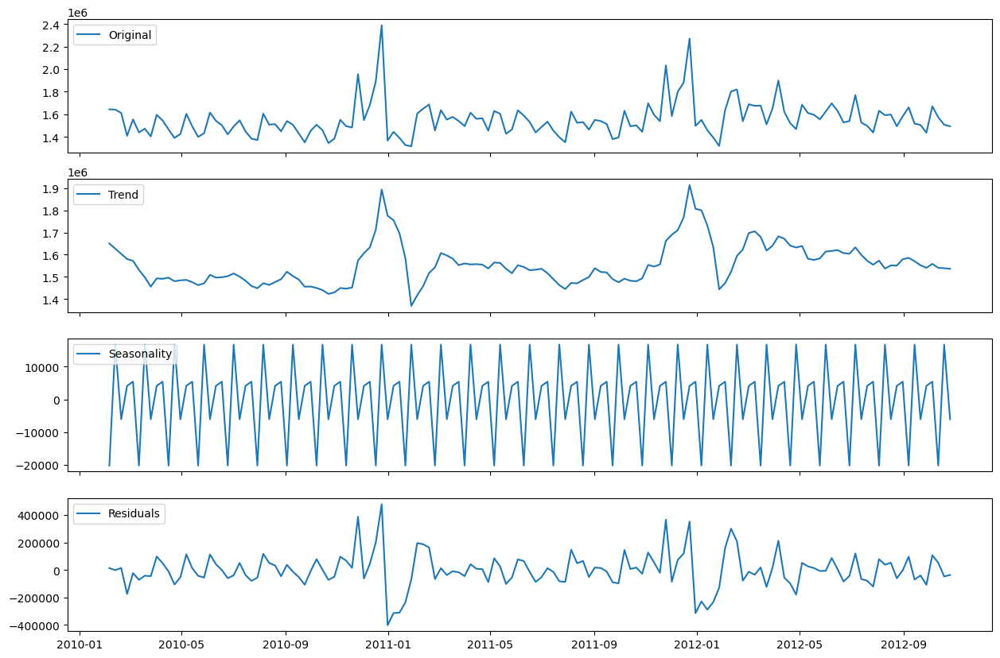

In [31]:
trend_add, seasonal_add, resid_add = classical_decomposition(df_1['Weekly_Sales'],period_value=5,
                                                            model_type="additive",plots=True)

The strength of the trend is: 0.999999999999329 
 And the strength of Seasonality is: 0.009217235446638328


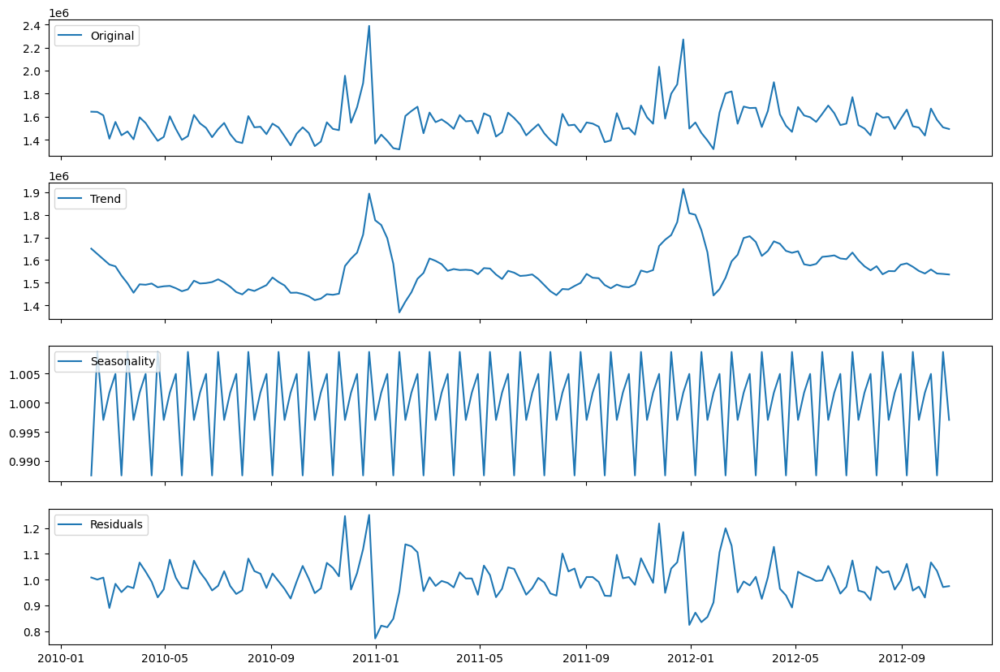

In [32]:
trend_mul, seasonal_mul, resid_mul = classical_decomposition(df_1['Weekly_Sales'],period_value=5,
                                                            model_type="multiplicative")

### J2- STL Decomposition:

In [33]:
def STL_decomposition(data,n_p=7,robustness=True,n_t=14,n_L=9,s_d=0,t_d=0,lp_d=0,model_type="additive",plots=True):
    if model_type =="multiplicative":
        data_used = np.log(data)
    else:
        data_used = data
    stl = STL(data_used,robust = robustness,
              period=n_p,trend=n_t,low_pass=n_L,
              seasonal_deg=s_d,trend_deg=t_d,low_pass_deg=lp_d,
             )
    result = stl.fit()
    if model_type =="multiplicative":
        trend = np.exp(result.trend)
        seasonal = np.exp(result.seasonal)
        residuals = np.exp(result.resid)
    else:
        trend = result.trend
        seasonal = result.seasonal
        residuals = result.resid

    if plots:
        resid_var = np.var(residuals.values)
        trend_resid_var = np.var(residuals.values+trend.values)
        seasonal_resid_var = np.var(residuals.values+seasonal.values)
        trend_strength = max(0,1-(resid_var/trend_resid_var))
        seasonal_strength = max(0,1-(resid_var/seasonal_resid_var))
        
        print(f"The strength of the trend is: {trend_strength} \n And the strength of Seasonality is: {seasonal_strength}")
        
        fig,axes = plt.subplots(4, 1, sharex=True, sharey=False)
        fig.set_figheight(10)
        fig.set_figwidth(15)

        axes[0].plot(data, label='Original')
        axes[0].legend(loc='upper left')

        axes[1].plot(trend, label='Trend')
        axes[1].legend(loc='upper left')

        axes[2].plot(seasonal, label='Seasonality')
        axes[2].legend(loc='upper left')

        axes[3].plot(residuals, label='Residuals')
        axes[3].legend(loc='upper left')
    
    return trend,seasonal,residuals


The strength of the trend is: 0.12562276095100577 
 And the strength of Seasonality is: 0.06313736869249598


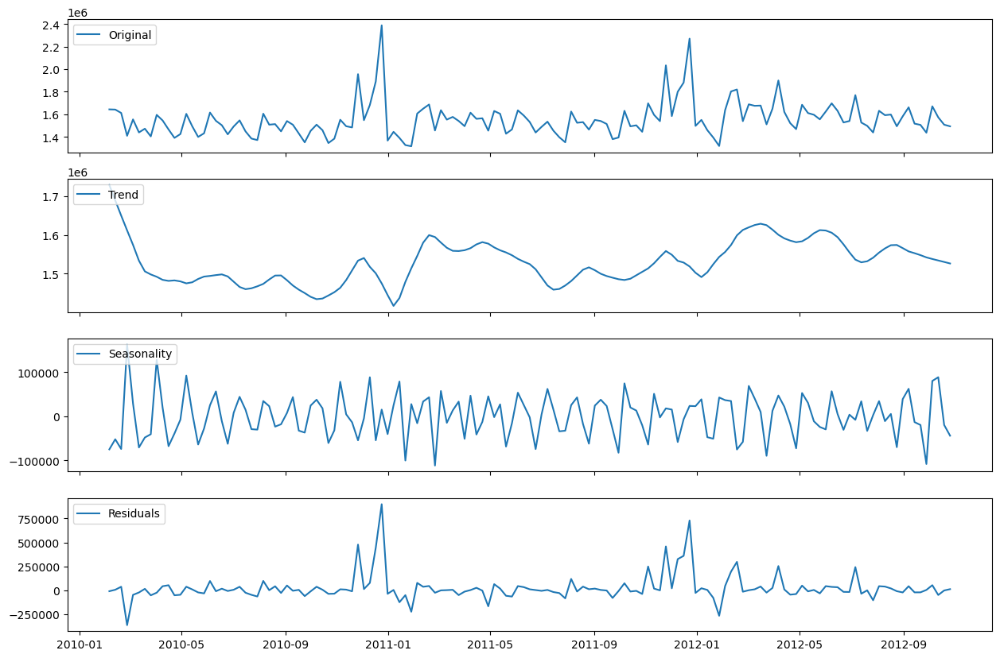

In [34]:
trend_stl,seasonal_stl,residuals_stl = STL_decomposition(df_1['Weekly_Sales'],
                                                         n_p=5,robustness=True,n_t=11,n_L=7,
                                                         s_d=1,t_d=1,lp_d=1,model_type="additive",plots=True)


The strength of the trend is: 0.9999999999971521 
 And the strength of Seasonality is: 0.06247369143837733


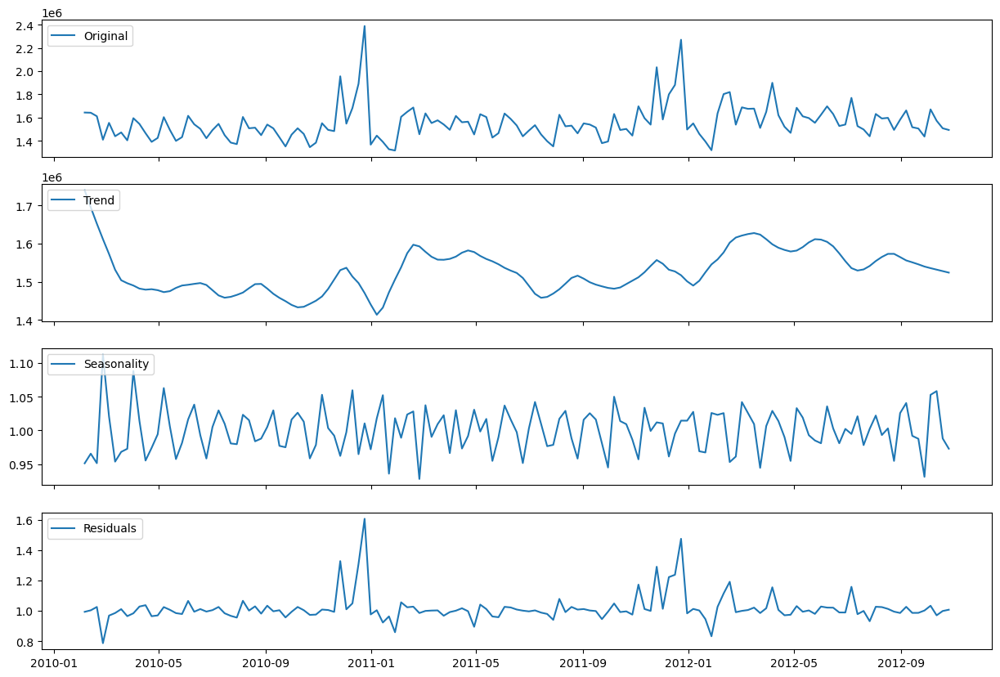

In [35]:
trend_stl,seasonal_stl,residuals_stl = STL_decomposition(df_1['Weekly_Sales'],
                                                         n_p=5,robustness=True,n_t=11,n_L=7,
                                                         s_d=1,t_d=1,lp_d=1,model_type="multiplicative",plots=True)


## J3-MSTL Model

In [36]:
mstl = MSTL(df_1["Weekly_Sales"], periods=(4, 12, 52), stl_kwargs={"seasonal_deg": 1})
res = mstl.fit()

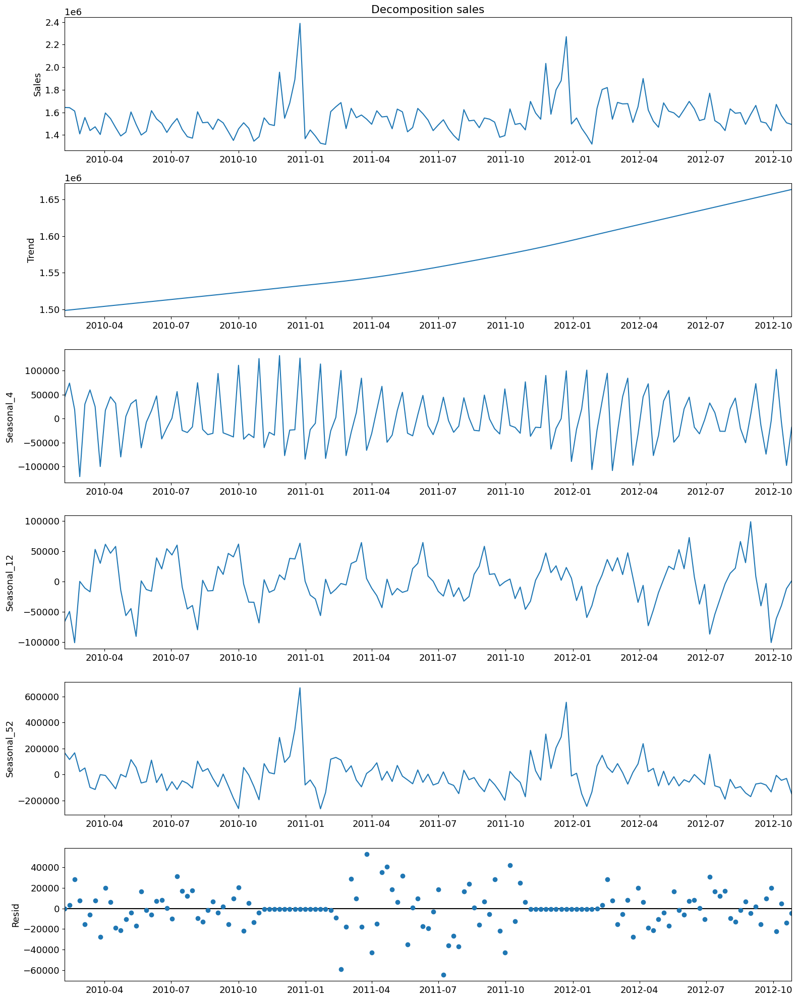

In [37]:
# Start with the plot from the results object `res`
plt.rc("figure", figsize=(16, 20))
plt.rc("font", size=13)
fig = res.plot()

# Make plot pretty
axs = fig.get_axes()

axs[0].set_ylabel("Sales")
axs[0].set_title("Decomposition sales")

plt.tight_layout()

### <font color='green'>**Multiple seasonal periods are allowed, so we will choose monthly, quarterly and anually**</font>

# 4. <a name="4">**Train Test Split**</a>

In [38]:
len(df_1["Weekly_Sales"])

143

In [39]:
test_data = df_1['Weekly_Sales'].iloc[-28:]
train_data = df_1['Weekly_Sales'].iloc[:-28]
print(train_data.index)
print(test_data.index)

DatetimeIndex(['2010-02-05', '2010-02-12', '2010-02-19', '2010-02-26',
               '2010-03-05', '2010-03-12', '2010-03-19', '2010-03-26',
               '2010-04-02', '2010-04-09',
               ...
               '2012-02-10', '2012-02-17', '2012-02-24', '2012-03-02',
               '2012-03-09', '2012-03-16', '2012-03-23', '2012-03-30',
               '2012-04-06', '2012-04-13'],
              dtype='datetime64[ns]', name='Date', length=115, freq=None)
DatetimeIndex(['2012-04-20', '2012-04-27', '2012-05-04', '2012-05-11',
               '2012-05-18', '2012-05-25', '2012-06-01', '2012-06-08',
               '2012-06-15', '2012-06-22', '2012-06-29', '2012-07-06',
               '2012-07-13', '2012-07-20', '2012-07-27', '2012-08-03',
               '2012-08-10', '2012-08-17', '2012-08-24', '2012-08-31',
               '2012-09-07', '2012-09-14', '2012-09-21', '2012-09-28',
               '2012-10-05', '2012-10-12', '2012-10-19', '2012-10-26'],
              dtype='datetime64[ns]', 

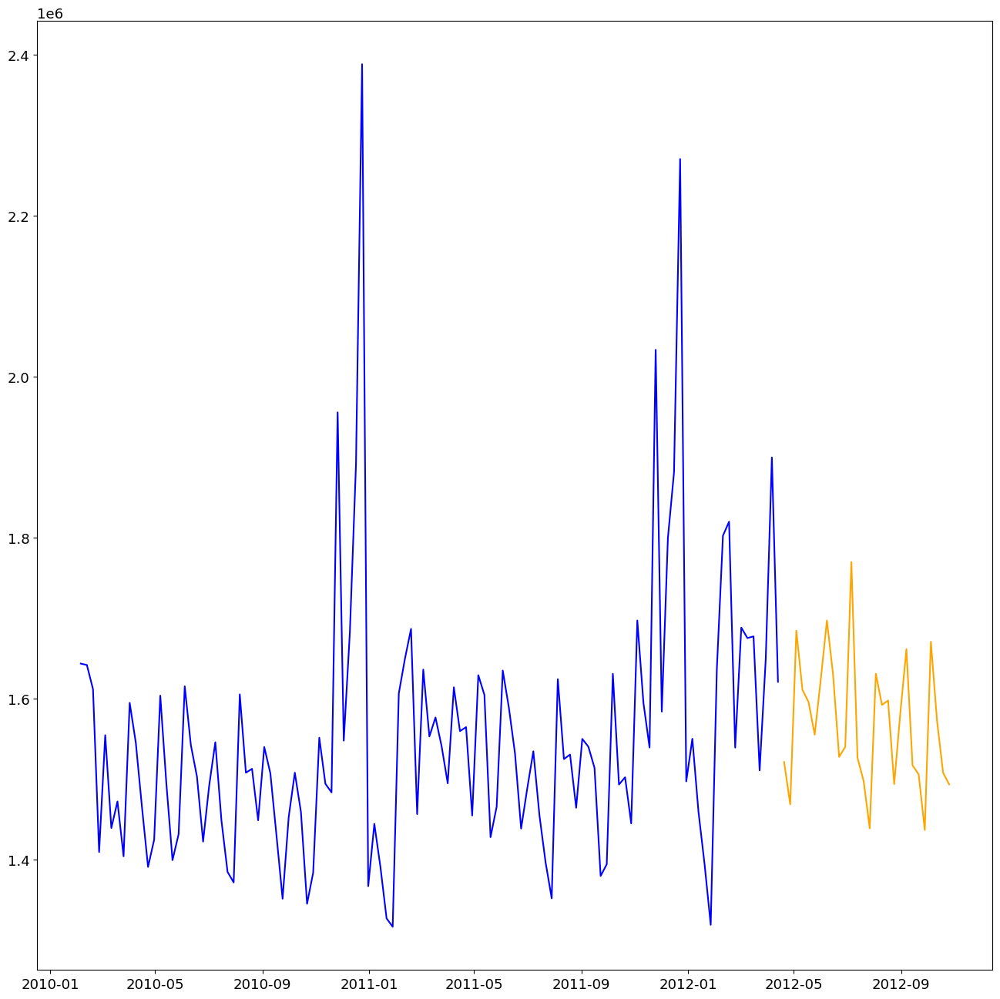

In [40]:
fig ,axes =plt.subplots(1,1)
fig.set_figheight(16)
fig.set_figwidth(16)

axes.plot(train_data, label='Train',color='blue')
axes.plot(test_data, label='Test',color='orange')
plt.show()

In [41]:
from sklearn.metrics import mean_squared_error,mean_absolute_error
def mdrae(y, y_hat, bnchmrk):
    abs_scaled_errors = np.abs(y - y_hat)/np.abs(y - bnchmrk+1e-10)
    #print(abs_scaled_errors)
    return np.median(abs_scaled_errors)

def gmrae(y, y_hat, bnchmrk): 
    abs_scaled_errors = np.abs(y - y_hat)/np.abs(y - bnchmrk+1e-10)
    #print(abs_scaled_errors)
    return np.exp(np.mean(np.log(abs_scaled_errors)))



def timeseries_evaluation_metrics(y_true, y_pred, y_bench):
    y_true, y_pred = np.array(y_true), np.array(y_pred) 
    MAPE = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    RMSE = np.sqrt(mean_squared_error(y_true, y_pred))
    MAE = mean_absolute_error(y_true, y_pred)
    MdRAE = mdrae(y_true, y_pred, y_bench)
    GMRAE = gmrae(y_true, y_pred, y_bench)
    return MAE,RMSE,MAPE,MdRAE,GMRAE

In [42]:
def average_method(train_data,test_data):
    ## Average method 
    average_prediction = [np.mean(train_data)]*len(test_data)
    average_pred = pd.DataFrame(average_prediction)
    average_pred.index = test_data.index
    return average_pred

def naive_method(train_data,test_data):
    ##Naive method
    naiive_prediction = [train_data.iloc[-1]]*len(test_data)
    naiive_pred = pd.DataFrame(naiive_prediction)
    naiive_pred.index = test_data.index
    return naiive_pred

def seasonal_naive(train_data,test_data):
    ##SEasonal_NAive
    #print(test_data.index)
    dates = (test_data.index - np.timedelta64(52, 'W')).values.astype('datetime64[D]')
    dates_added = dates[2:] +np.timedelta64(1,'W')
    dates = np.concatenate((dates[:2],dates_added))
    #print(train_data.index)
    #print(dates)
    #print(train_data.index.isin(dates))
    seasonal_naive_prediction = train_data[train_data.index.isin(dates)].values # seasonal naive prediction
    #print(seasonal_naive)
    #seasonal_naive = test_data.copy()
    seasonal_naive = pd.DataFrame(seasonal_naive_prediction).set_index(test_data.index)
    return seasonal_naive

def drift_method(train_data,test_data):
    # Get the slope
    y_t = train_data[len(train_data)-1]
    #print(y_t)
    #print(train_data[1])
    m = (y_t - train_data[1]) / len(train_data)
    #print(m)
    #y_hat_drift = test.copy().drop('sales', axis=1)
    h = np.linspace(0,len(test_data)-1, len(test_data))
    #print(h)
    drift_prediction = y_t + m * h
    drift_pred = pd.DataFrame(drift_prediction).set_index(test_data.index)
    return drift_pred

In [43]:
train_data

Date
2010-02-05    1643690.90
2010-02-12    1641957.44
2010-02-19    1611968.17
2010-02-26    1409727.59
2010-03-05    1554806.68
                 ...    
2012-03-16    1677472.78
2012-03-23    1511068.07
2012-03-30    1649604.63
2012-04-06    1899676.88
2012-04-13    1621031.70
Name: Weekly_Sales, Length: 115, dtype: float64

In [44]:
average_pred = average_method(train_data,test_data)
naiive_pred = naive_method(train_data,test_data)
seasonal_naive_pred = seasonal_naive(train_data,test_data)
drift_pred = drift_method(train_data,test_data)

### Plot predicions

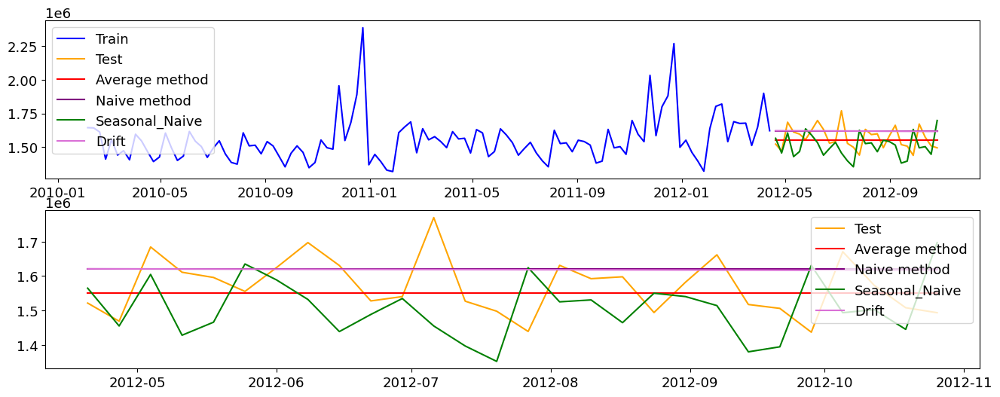

In [45]:
fig ,axes =plt.subplots(2,1)
fig.set_figheight(6)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')

axes[0].plot(average_pred,label="Average method",color='red')
axes[0].plot(naiive_pred,label="Naive method",color='purple')
axes[0].plot(seasonal_naive_pred, label='Seasonal_Naive',color='green')
axes[0].plot(drift_pred,label='Drift',color='orchid')
axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(average_pred,label="Average method",color='red')
axes[1].plot(naiive_pred,label="Naive method",color='purple')
axes[1].plot(seasonal_naive_pred, label='Seasonal_Naive',color='green')
axes[1].plot(drift_pred,label='Drift',color='orchid')
axes[1].legend(loc='best')
plt.show()

In [46]:
MAE_average,RMSE_average,MAPE_average,MdRAE_average,GMRAE_average = timeseries_evaluation_metrics(
    test_data, average_pred[0], naiive_pred[0])
MAE_Naive,RMSE_Naive,MAPE_Naive,MdRAE_Naive,GMRAE_Naive = timeseries_evaluation_metrics(
    test_data, naiive_pred[0], naiive_pred[0])
MAE_Seasonal_Naive,RMSE_Seasonal_Naive,MAPE_Seasonal_Naive,MdRAE_Seasonal_Naive,GMRAE_Seasonal_Naive = timeseries_evaluation_metrics(
    test_data, seasonal_naive_pred[0], naiive_pred[0])
MAE_Drift,RMSE_Drift,MAPE_Drift,MdRAE_Drift,GMRAE_Drift = timeseries_evaluation_metrics(
    test_data, drift_pred[0], naiive_pred[0])

In [47]:
MAE_average,RMSE_average,MAPE_average,MdRAE_average,GMRAE_average = timeseries_evaluation_metrics(test_data.values,
                                                                                                average_pred[0].values,
                                                                                                naiive_pred[0].values)
#print(MAE_average)
MAE_naive,RMSE_naive,MAPE_naive,MdRAE_naive,GMRAE_naive = timeseries_evaluation_metrics(test_data.values,
                                                                                        naiive_pred[0].values,
                                                                                        naiive_pred[0].values)

MAE_snaive,RMSE_snaive,MAPE_snaive,MdRAE_snaive,GMRAE_snaive = timeseries_evaluation_metrics(test_data.values,
                                                                                            seasonal_naive_pred[0].values,
                                                                                            seasonal_naive_pred[0].values)
MAE_drift,RMSE_drift,MAPE_drift,MdRAE_drift,GMRAE_drift = timeseries_evaluation_metrics(test_data.values,
                                                                                        drift_pred[0].values,
                                                                                        naiive_pred[0].values)
print(f"""
MAE for average method:{MAE_average}
RMSE for average method:{RMSE_average}
MAPE for average method:{MAPE_average}
MdRAE for average method:{MdRAE_average}
GMRAE for average method:{GMRAE_average}""")

print(f"""
MAE for naive method:{MAE_naive}
RMSE for naive method:{RMSE_naive}
MAPE for naive method:{MAPE_naive}
MdRAE for naive method:{MdRAE_naive}
GMRAE for naive method:{GMRAE_naive}""")


print(f"""
MAE for Seasonal naiive method:{MAE_snaive}
RMSE for Seasonal naiive method:{RMSE_snaive}
MAPE for Seasonal naiive method:{MAPE_snaive}
MdRAE for Seasonal naiive method:{MdRAE_snaive}
GMRAE for Seasonal naiive method:{GMRAE_snaive}""")

print(f"""
MAE for drift method:{MAE_drift}
RMSE for drift method:{RMSE_drift}
MAPE for drift method:{MAPE_drift}
MdRAE for drift method:{MdRAE_drift}
GMRAE for drift method:{GMRAE_drift}""")


MAE for average method:67697.47073602486
RMSE for average method:82552.01856371747
MAPE for average method:4.249192071285634
MdRAE for average method:0.6209891698448935
GMRAE for average method:0.9152917839933227

MAE for naive method:79841.1196428571
RMSE for naive method:95373.1824431179
MAPE for naive method:5.203151318104223
MdRAE for naive method:1.0000000000000009
GMRAE for naive method:0.9999999999999993

MAE for Seasonal naiive method:115907.51999999999
RMSE for Seasonal naiive method:135437.56832740753
MAPE for Seasonal naiive method:7.337516370775966
MdRAE for Seasonal naiive method:0.9999999999999993
GMRAE for Seasonal naiive method:0.9999999999999986

MAE for drift method:78593.3736552795
RMSE for drift method:93811.54614578235
MAPE for drift method:5.117633295198511
MdRAE for drift method:0.9791034878106434
GMRAE for drift method:1.000537409129315


# 5. <a name="5">**Time Series Models**</a>

## A- ETS Models:

In [48]:
from itertools import permutations
from statsmodels.tsa.api import SimpleExpSmoothing

def SES(train_data,test_data,plots=True):
    Simple_Exponential_df = pd.DataFrame(columns = ['Alpha','RMSE','MAE','MAPE','MdRAE','GMRAE'])
    perm = permutations(list(np.arange(0,1,0.05)), 1)
    naiive_pred = naive_method(train_data,test_data)
    for i in list(perm):
        #print(train_data.values)
        fit_sim_exp = SimpleExpSmoothing(np.asarray(train_data.values)).fit(smoothing_level = i[0])
        pred_values = fit_sim_exp.forecast(len(test_data))
        #print(pred_values)
        MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,pred_values,naiive_pred[0].values)
        Simple_Exponential_df = pd.concat([Simple_Exponential_df, pd.DataFrame([{'Alpha' : i[0] , 'RMSE' :RMSE, 'MAE':MAE, 
                                                                      'MAPE':MAPE,'MdRAE':MdRAE,'GMRAE':GMRAE} ])], ignore_index=True)
        
        
    if plots:
        fig,axes = plt.subplots(5,1,sharex=True, sharey=False)
        fig.set_figheight(15)
        fig.set_figwidth(15)

        axes[0].plot(Simple_Exponential_df['Alpha'],Simple_Exponential_df['RMSE'], label='RMSE')
        axes[0].legend(loc='upper left')

        axes[1].plot(Simple_Exponential_df['Alpha'],Simple_Exponential_df['MAE'], label='MAE')
        axes[1].legend(loc='upper left')

        axes[2].plot(Simple_Exponential_df['Alpha'],Simple_Exponential_df['MAPE'], label='MAPE')
        axes[2].legend(loc='upper left')
        
        axes[3].plot(Simple_Exponential_df['Alpha'],Simple_Exponential_df['MdRAE'], label='MdRAE')
        axes[3].legend(loc='upper left')
        
        axes[4].plot(Simple_Exponential_df['Alpha'],Simple_Exponential_df['GMRAE'], label='GMRAE')
        axes[4].legend(loc='upper left')

        return Simple_Exponential_df

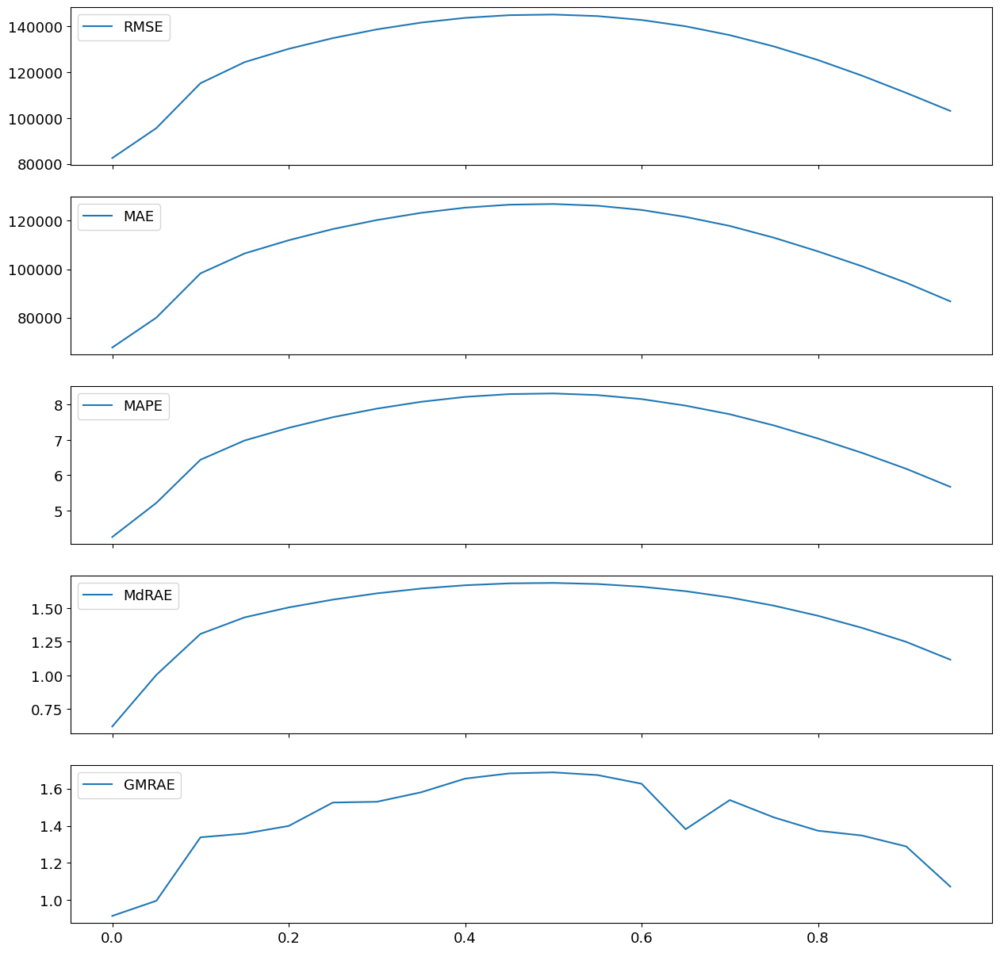

In [49]:
Simple_Exponential_df = SES(train_data,test_data)

In [50]:
Simple_Exponential_df

,Alpha,RMSE,MAE,MAPE,MdRAE,GMRAE
0,0.00,82549.146828,67696.540842,4.249168,0.621060,0.915229
1,0.05,95614.244732,80033.275604,5.216444,1.003772,0.996632
2,0.10,115182.978565,98277.210479,6.439358,1.307903,1.337941
3,0.15,124383.038961,106485.258695,6.984539,1.430482,1.357881
4,0.20,130182.286229,111936.932494,7.343425,1.504285,1.398943
5,0.25,134845.043634,116550.342961,7.645097,1.562142,1.524757
6,0.30,138669.305180,120268.003879,7.888195,1.608765,1.529036
7,0.35,141621.211309,123237.507127,8.081554,1.644303,1.579854
8,0.40,143687.824022,125383.407712,8.220797,1.668972,1.653448
9,0.45,144869.543691,126604.078732,8.300004,1.683005,1.681452


#### 2) Holt's Linear Trend method(Double Exponential Smoothing):

In [51]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import itertools

def holt(train_data,test_data,damped_value=True,trend_value="add"):
    """
    Function performing grid search for the parameters of the Holt's method and 
    try several combinations of alpha ,beta and gamma,
    then returns a dataframe with those parameters and corresponding train & test evaluation scores.
    
    
    train: (pandas series)
        -  Training data
        
    test: (pandas series)
        -  Test data
    
    """
    naiive_pred = naive_method(train_data,test_data)
    #print(naiive_pred)
    if damped_value:
        Holt_df = pd.DataFrame(columns = ['Alpha','Beta','Phi','RMSE','MAE','MAPE','MdRAE','GMRAE'])
        
        s = [list(np.arange(0.1,1,0.1)),list(np.arange(0.1,1,0.1)),list(np.arange(0.1,1,0.1))]
        perm = list(itertools.product(*s))
        
        for i in perm:
            try:
                fit_holt = ExponentialSmoothing(np.asarray(train_data),damped=True,
                                                trend=trend_value).fit(
                                                                      smoothing_level = i[0],
                                                                      smoothing_slope = i[1],
                                                                      damping_slope = i[2])
                pred_values = fit_holt.forecast(len(test_data))
                MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,pred_values,
                                                                          naiive_pred[0].values)
                Holt_df = pd.concat([Holt_df, pd.DataFrame([{'Alpha' : i[0],'Beta':i[1],'Phi':i[2], 'RMSE' :RMSE, 
                                                                              'MAE':MAE, 
                                                                              'MAPE':MAPE,"MdRAE":MdRAE,"GMRAE":GMRAE} ])], ignore_index=True)
                
            except ValueError:
                    Holt_df = pd.concat([Holt_df, pd.DataFrame([{'Alpha' : i[0],'Beta':i[1],'Phi':i[2], 'RMSE' :None, 
                                                                              'MAE':None, 
                                                                              'MAPE':None,"MdRAE":None,"GMRAE":None} ])], ignore_index=True)
                
                    
    
    else:
        
        Holt_df = pd.DataFrame(columns = ['Alpha','Beta','RMSE','MAE','MAPE','MdRAE','GMRAE'])
        s = [list(np.arange(0.1,1,0.1)),list(np.arange(0.1,1,0.1))]
        perm = list(itertools.product(*s))
        for i in perm:
            try:
                #print(i)
                #print(np.asarray(train_data))
                fit_holt = ExponentialSmoothing(np.asarray(train_data),damped=False,
                                                trend=trend_value).fit(
                                                                      smoothing_level = i[0],
                                                                      smoothing_slope = i[1])
                pred_values = fit_holt.forecast(len(test_data))
                #print(pred_values)
                MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,pred_values,
                                                                          naiive_pred[0].values)
                Holt_df = pd.concat([Holt_df, pd.DataFrame([{'Alpha' : i[0],'Beta':i[1], 'RMSE' :RMSE, 
                                                                              'MAE':MAE, 
                                                                              'MAPE':MAPE,"MdRAE":MdRAE,"GMRAE":GMRAE} ])], ignore_index=True)
                
            except ValueError:
                    Holt_df = pd.concat([Holt_df, pd.DataFrame([{'Alpha' : i[0],'Beta':i[1], 'RMSE' :None, 
                                                                              'MAE':None, 
                                                                              'MAPE':None,"MdRAE":None,"GMRAE":None} ])], ignore_index=True)
                
                    
            


    return Holt_df

In [52]:
#Holt'linear method with normal additive trend
Holt_df_linear_add = holt(train_data,test_data,damped_value=False,trend_value="add")
opt_values_linear_add = Holt_df_linear_add.loc[Holt_df_linear_add['RMSE'] == min(Holt_df_linear_add['RMSE'])
                                           ,['Alpha','Beta']].values
fit_holt_linear_add = ExponentialSmoothing(np.asarray(train_data),damped=False,
                                           trend="add").fit(smoothing_level = opt_values_linear_add[0][0],
                                                            smoothing_slope=opt_values_linear_add[0][1])

pred_values_linear_add = fit_holt_linear_add.forecast(len(test_data))


In [53]:
Holt_df_linear_add.loc[Holt_df_linear_add['RMSE'] == min(Holt_df_linear_add['RMSE'])]

,Alpha,Beta,RMSE,MAE,MAPE,MdRAE,GMRAE
3,0.1,0.4,83069.107426,64888.413029,4.053673,0.772046,0.693429


In [54]:
#Holt's linear method with damped trend
Holt_df_damp_add = holt(train_data,test_data,damped_value=True,trend_value="add")
opt_values_damp_add = Holt_df_damp_add.loc[Holt_df_damp_add['RMSE'] == min(Holt_df_damp_add['RMSE']),
                                               ['Alpha','Beta','Phi']].values

fit_holt_damp_add = ExponentialSmoothing(np.asarray(train_data),damped=True,
                                         trend="add").fit(smoothing_level = opt_values_damp_add[0][0],
                                                          smoothing_slope=opt_values_damp_add[0][1],
                                                          damping_slope = opt_values_damp_add[0][2])

pred_values_damp_add = fit_holt_damp_add.forecast(len(test_data))

In [55]:
Holt_df_damp_add.loc[Holt_df_damp_add['RMSE'] == min(Holt_df_damp_add['RMSE'])]

,Alpha,Beta,Phi,RMSE,MAE,MAPE,MdRAE,GMRAE
722,0.9,0.9,0.3,81406.392829,68476.395516,4.352195,0.721565,0.928031


In [56]:
#Holt'linear method with normal multiplicative trend
Holt_df_linear_mul = holt(train_data,test_data,damped_value=False,trend_value="mul")
Holt_df_linear_mul = Holt_df_linear_mul.dropna(subset=["RMSE"])
opt_values_linear_mul = Holt_df_linear_mul.loc[Holt_df_linear_mul['RMSE'] == min(Holt_df_linear_mul['RMSE'])
                                               ,['Alpha','Beta']].values
print(opt_values_linear_mul)
fit_holt_linear_mul = ExponentialSmoothing(np.asarray(train_data),damped=True,
                                      trend="mul").fit(smoothing_level = opt_values_linear_mul[0][0],
                                                        smoothing_slope=opt_values_linear_mul[0][1])

pred_values_linear_mul = fit_holt_linear_mul.forecast(len(test_data))


[[0.3 0.8]]


In [57]:
Holt_df_linear_mul.loc[Holt_df_linear_mul['RMSE'] == min(Holt_df_linear_mul['RMSE'])]

,Alpha,Beta,RMSE,MAE,MAPE,MdRAE,GMRAE
25,0.3,0.8,86532.060068,69036.254504,4.366431,1.15828,0.789281


In [58]:
#Holt's linear method with damped multiplicative trend
Holt_df_damp_mul = holt(train_data,test_data,damped_value=True,trend_value="mul")
opt_values_damp_mul = Holt_df_damp_mul.loc[Holt_df_damp_mul['RMSE'] == min(Holt_df_damp_mul['RMSE']),
                                               ['Alpha','Beta','Phi']].values

fit_holt_damp_mul = ExponentialSmoothing(np.asarray(train_data),damped=True,
                                         trend="mul").fit(smoothing_level = opt_values_damp_mul[0][0],
                                                          smoothing_slope=opt_values_damp_mul[0][1],
                                                          damping_slope = opt_values_damp_mul[0][2])

pred_values_damp_mul = fit_holt_damp_mul.forecast(len(test_data))


In [59]:
Holt_df_damp_mul.loc[Holt_df_damp_mul['RMSE'] == min(Holt_df_damp_mul['RMSE'])]

,Alpha,Beta,Phi,RMSE,MAE,MAPE,MdRAE,GMRAE
722,0.9,0.9,0.3,81890.999466,68765.56858,4.393791,0.72042,0.898288


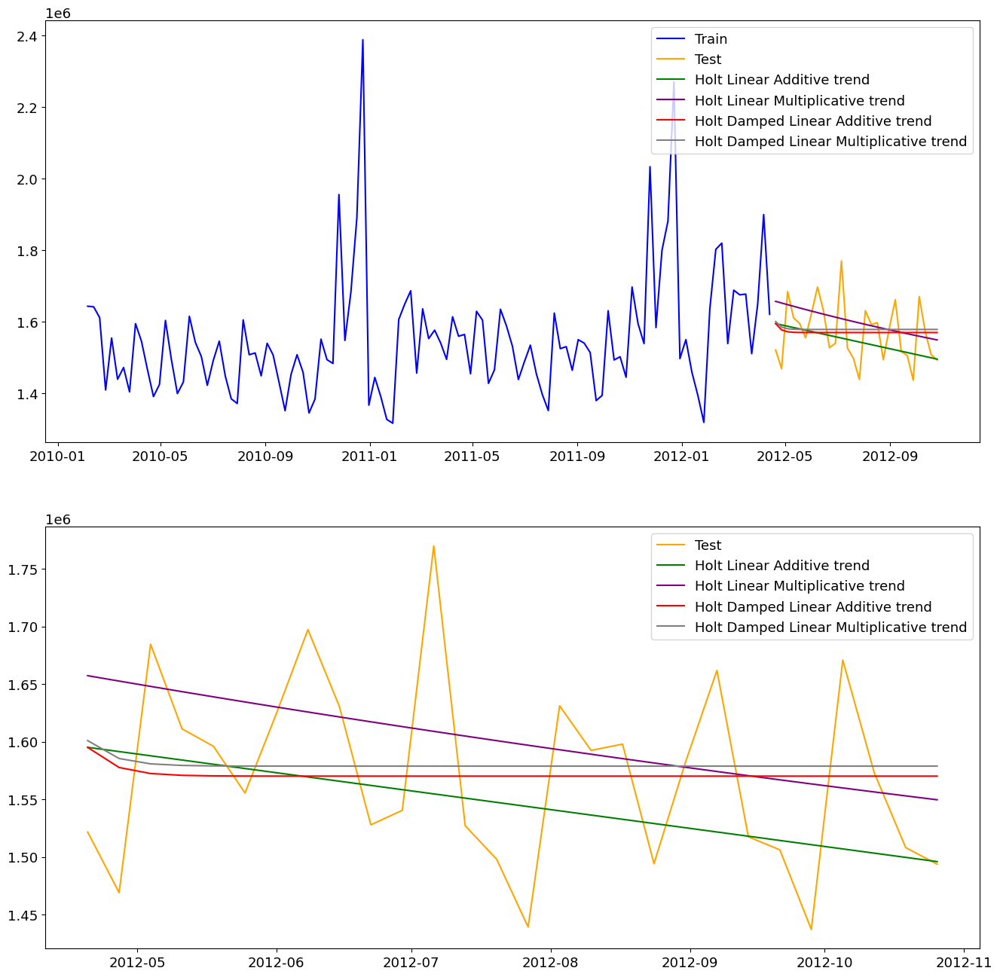

In [60]:
predictions = {'Linear additive':pred_values_linear_add,'Damped additive':pred_values_damp_add,
              'Linear multiplicative':pred_values_linear_mul,'Damped multiplicative':pred_values_damp_mul}
pred_data =pd.DataFrame(data=predictions,index=test_data.index)


fig ,axes =plt.subplots(2,1)
fig.set_figheight(16)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')
axes[0].plot(pred_data['Linear additive'], label='Holt Linear Additive trend',color='green')
axes[0].plot(pred_data['Linear multiplicative'], label='Holt Linear Multiplicative trend',color='purple')
axes[0].plot(pred_data['Damped additive'], label='Holt Damped Linear Additive trend',color='red')
axes[0].plot(pred_data['Damped multiplicative'], label='Holt Damped Linear Multiplicative trend',color='gray')
axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(pred_data['Linear additive'], label='Holt Linear Additive trend',color='green')
axes[1].plot(pred_data['Linear multiplicative'], label='Holt Linear Multiplicative trend',color='purple')
axes[1].plot(pred_data['Damped additive'], label='Holt Damped Linear Additive trend',color='red')
axes[1].plot(pred_data['Damped multiplicative'], label='Holt Damped Linear Multiplicative trend',color='gray')
axes[1].legend(loc='best')
plt.show()

#### 3) Holt-Winters' Seasonal Method:

In [36]:
def holt_winters_seasonal_Grid_exhaustive(train_data,test_data):
    """
    Function performing grid search for the parameters of the Holt-Winter's method and 
    try several combinations of them,
    then returns a dataframe with those parameters and corresponding train & test evaluation scores.
    
    
    train: (pandas series)
        -  Training data
        
    test: (pandas series)
        -  Test data
    
    """
    naiive_pred = naive_method(train_data,test_data)
    param_grid = {'trend': ['add', 'mul'],'seasonal' :['add', 'mul'],'seasonal_periods':[90,365],
              'damped' : [True, False], 'smoothing_level': [0.10, 0.20,.30,.40,.50,.60,.70,.80,.90], 
              'smoothing_slope':[0.10, 0.20,.30,.40,.50,.60,.70,.80,.90],
              'damping_slope': [.80,.90,.98],
              'smoothing_seasonal':[0.10, 0.20,.30,.40,.50,.60,.70,.80,.90],
              'optimized':[True],'remove_bias':[False]} 

    pg = list(ParameterGrid(param_grid))
    df_results = pd.DataFrame(columns=['trend','seasonal','seasonal_ periods',
                                       'damped','smoothing_level','smoothing_slope','damping_slope'
                                       ,'remove_ bias','optimized','use_basinhopping',
                                       'AICc','BIC','RMSE','MAE','MAPE',
                                      'MdRAE','GMRAE'])
    
    print(len(pg))
    
    for a,b in enumerate(pg):
        
        trend = b.get('trend')
        seasonal = b.get('seasonal')
        seasonal_periods = b.get('seasonal_periods')
        damped = b.get('damped')
        smoothing_level = b.get('smoothing_level')
        smoothing_slope = b.get('smoothing_slope')
        damping_slope = b.get('damping_slope')
        smoothing_seasonal = b.get('smoothing_seasonal')
        optimized = b.get('optimized')
        remove_bias = b.get('remove_bias')
        
        
        try:
            model = ExponentialSmoothing(np.asarray(train_data),trend=trend,seasonal=seasonal, 
                                         damped=damped,
                                         seasonal_periods=seasonal_periods).fit(smoothing_level=smoothing_level, 
                                         smoothing_slope=smoothing_slope, 
                                         damping_slope = damping_slope,
                                         smoothing_seasonal=smoothing_seasonal,optimized=optimized)
            aicc = model.aicc.round(2)
            bic = model.bic.round(2)
            #mae_train,rmse_train,mape_train = timeseries_evaluation_metrics(train_data.values,model.fittedvalues)
            pred_values = model.forecast(len(test_data))
            MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,pred_values,naiive_pred[0].values)



            df_results = df_results.append({'trend':trend,'seasonal':seasonal,'seasonal_ periods':seasonal_periods,
                                        'damped':damped,'smoothing_level':smoothing_level,'smoothing_slope':smoothing_slope,
                                        'damping_slope':damping_slope,'remove_ bias':remove_bias,
                                        'optimized':optimized,
                                        'AICc':aicc,'BIC':bic,
                                        'RMSE':RMSE,'MAE':MAE,'MAPE':MAPE,'MdRAE':MdRAE,'GMRAE':GMRAE}, 
                                        ignore_index=True)
        except:
            df_results = df_results.append({'trend':trend,'seasonal':seasonal,'seasonal_ periods':seasonal_periods,
                                        'damped':damped,'smoothing_level':smoothing_level,'smoothing_slope':smoothing_slope,
                                        'damping_slope':damping_slope,'remove_ bias':remove_bias,
                                        'optimized':optimized,
                                        'AICc':None,'BIC':None,
                                        'RMSE':None,'MAE':None,'MAPE':None,'MdRAE':None,'GMRAE':None}, 
                                        ignore_index=True)
            
        

        
    

    return df_results.sort_values(by=['RMSE','MAE','MAPE','MdRAE','GMRAE']).style.highlight_min(subset=['RMSE','MAE','MAPE','MdRAE','GMRAE','AICc','BIC'],color='lightgreen')


In [37]:
param_grid = {'trend': ['add', 'mul'],'seasonal' :['add', 'mul'],'seasonal_periods':[5,12,52],
              'damped' : [True, False], 'smoothing_level': [0.10, 0.20,.30,.40,.50], 
              'smoothing_slope':[0.10, 0.20,.30,.40,.50,],
              'damping_slope': [.80,.90,.98],
              'smoothing_seasonal':[0.10, 0.20,.30,.40,.50,],
              'optimized':[True],'remove_bias':[False]} 

In [38]:
all_params = [dict(zip((param_grid),v)) for v in itertools.product(*param_grid.values())]

In [39]:
len(all_params)

9000

In [40]:
def run_one(train_data,test_data,params):
    naiive_pred = naive_method(train_data,test_data)
    trend = params['trend']
    seasonal = params['seasonal']
    seasonal_periods = params['seasonal_periods']
    damped = params['damped']
    smoothing_level = params['smoothing_level']
    smoothing_slope = params['smoothing_slope']
    damping_slope = params['damping_slope']
    smoothing_seasonal = params['smoothing_seasonal']
    optimized = params['optimized']
    remove_bias = params['remove_bias']


    try:
        model = ExponentialSmoothing(np.asarray(train_data),trend=trend,seasonal=seasonal, 
                                     damped_trend=damped,
                                     seasonal_periods=seasonal_periods).fit(smoothing_level=smoothing_level, 
                                     smoothing_trend=smoothing_slope, 
                                     damping_trend = damping_slope,
                                     smoothing_seasonal=smoothing_seasonal,optimized=optimized)
        aicc = model.aicc.round(2)
        bic = model.bic.round(2)
        #mae_train,rmse_train,mape_train = timeseries_evaluation_metrics(train_data.values,model.fittedvalues)
        pred_values = model.forecast(len(test_data))
        MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,pred_values,naiive_pred[0].values)
        results = {'trend':trend,'seasonal':seasonal,'seasonal_ periods':seasonal_periods,
                                        'damped':damped,'smoothing_level':smoothing_level,'smoothing_slope':smoothing_slope,
                                        'damping_slope':damping_slope,'smoothing_seasonal':smoothing_slope,'remove_bias':remove_bias,
                                        'optimized':optimized,
                                        'AICc':aicc,'BIC':bic,
                                        'RMSE':RMSE,'MAE':MAE,'MAPE':MAPE,'MdRAE':MdRAE,'GMRAE':GMRAE}
    
    except:
        results = {'trend':trend,'seasonal':seasonal,'seasonal_ periods':seasonal_periods,
                                        'damped':damped,'smoothing_level':smoothing_level,'smoothing_slope':smoothing_slope,
                                        'damping_slope':damping_slope,'smoothing_seasonal':smoothing_slope,'remove_ bias':remove_bias,
                                        'optimized':optimized,
                                        'AICc':None,'BIC':None,
                                        'RMSE':None,'MAE':None,'MAPE':None,'MdRAE':None,'GMRAE':None}
    return results

In [41]:

jobs = list()
for param in all_params:
    jobs.append(delayed(run_one)(train_data,test_data,param))

In [42]:
jobs[0]

(<function __main__.run_one(train_data, test_data, params)>,
 (Date
  2010-02-05    1643690.90
  2010-02-12    1641957.44
  2010-02-19    1611968.17
  2010-02-26    1409727.59
  2010-03-05    1554806.68
                   ...    
  2012-03-16    1677472.78
  2012-03-23    1511068.07
  2012-03-30    1649604.63
  2012-04-06    1899676.88
  2012-04-13    1621031.70
  Name: Weekly_Sales, Length: 115, dtype: float64,
  Date
  2012-04-20    1521577.87
  2012-04-27    1468928.37
  2012-05-04    1684519.99
  2012-05-11    1611096.05
  2012-05-18    1595901.87
  2012-05-25    1555444.55
  2012-06-01    1624477.58
  2012-06-08    1697230.96
  2012-06-15    1630607.00
  2012-06-22    1527845.81
  2012-06-29    1540421.49
  2012-07-06    1769854.16
  2012-07-13    1527014.04
  2012-07-20    1497954.76
  2012-07-27    1439123.71
  2012-08-03    1631135.79
  2012-08-10    1592409.97
  2012-08-17    1597868.05
  2012-08-24    1494122.38
  2012-08-31    1582083.40
  2012-09-07    1661767.33
  2012-09-

In [43]:
p = Parallel(n_jobs=6)(jobs)
results = pd.DataFrame(p)

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/holtwinters/model.py:91

In [45]:
results.sort_values(by=['RMSE','MAE','MAPE','MdRAE','GMRAE']).style.highlight_min(subset=['RMSE','MAE','MAPE','MdRAE','GMRAE','AICc','BIC'],color='lightgreen')


,trend,seasonal,seasonal_ periods,damped,smoothing_level,smoothing_slope,damping_slope,smoothing_seasonal,remove_bias,optimized,AICc,BIC,RMSE,MAE,MAPE,MdRAE,GMRAE,remove_ bias
1501,add,add,52,True,0.100000,0.100000,0.800000,0.100000,False,True,2687.080000,2714.810000,57518.368847,46254.531279,2.945894,0.549566,0.461597,nan
1500,add,add,52,True,0.100000,0.100000,0.800000,0.100000,False,True,2677.090000,2704.830000,57714.322851,46620.311697,2.969050,0.565925,0.530727,nan
1849,add,add,52,True,0.500000,0.400000,0.800000,0.400000,False,True,2740.860000,2768.590000,57785.488323,43466.762642,2.744054,0.409477,0.435120,nan
1502,add,add,52,True,0.100000,0.100000,0.800000,0.100000,False,True,2695.930000,2723.670000,57840.953044,46578.520138,2.965942,0.567047,0.494791,nan
1864,add,add,52,True,0.500000,0.500000,0.800000,0.500000,False,True,2745.490000,2773.230000,57930.496404,44900.948967,2.838744,0.452932,0.526419,nan
1869,add,add,52,True,0.500000,0.500000,0.900000,0.500000,False,True,2749.670000,2777.410000,57944.855980,44455.363881,2.808338,0.423846,0.485258,nan
1874,add,add,52,True,0.500000,0.500000,0.980000,0.500000,False,True,2753.080000,2780.810000,58623.022173,45012.158698,2.842583,0.409514,0.514227,nan
1819,add,add,52,True,0.500000,0.200000,0.800000,0.200000,False,True,2731.680000,2759.410000,59174.478222,45584.373925,2.887105,0.419549,0.510831,nan
1503,add,add,52,True,0.100000,0.100000,0.800000,0.100000,False,True,2703.940000,2731.670000,59383.417610,48812.083511,3.110574,0.582820,0.613924,nan
1834,add,add,52,True,0.500000,0.300000,0.800000,0.300000,False,True,2736.220000,2763.960000,59633.723650,46848.153388,2.969500,0.522760,0.551425,nan


In [148]:
model = ExponentialSmoothing(np.asarray(train_data),trend="add",seasonal="add", 
                                     damped_trend=True,
                                     seasonal_periods=52).fit(smoothing_level=0.1, 
                                     smoothing_trend=0.1, 
                                     damping_trend = 0.8,
                                     smoothing_seasonal=0.1,optimized=True,remove_bias=False)

pred_values = model.forecast(len(test_data))
pred_data =pd.DataFrame(data=pred_values,index=test_data.index)


In [149]:
pred_values

array([1599264.63607497, 1559834.31664997, 1737378.72335166,
       1672561.64063886, 1536023.9301868 , 1570567.3796789 ,
       1746002.61189115, 1685030.41377893, 1636526.10205327,
       1547002.34236857, 1605221.37842858, 1654062.41953686,
       1565562.14724233, 1502605.53542876, 1473453.90670727,
       1723069.67453748, 1624183.44670004, 1627102.04403885,
       1561904.80074441, 1649078.32636682, 1627982.214878  ,
       1572772.54484316, 1466020.5871415 , 1523534.62951589,
       1667800.47676856, 1571866.90179953, 1517696.28507879,
       1506941.48926101])

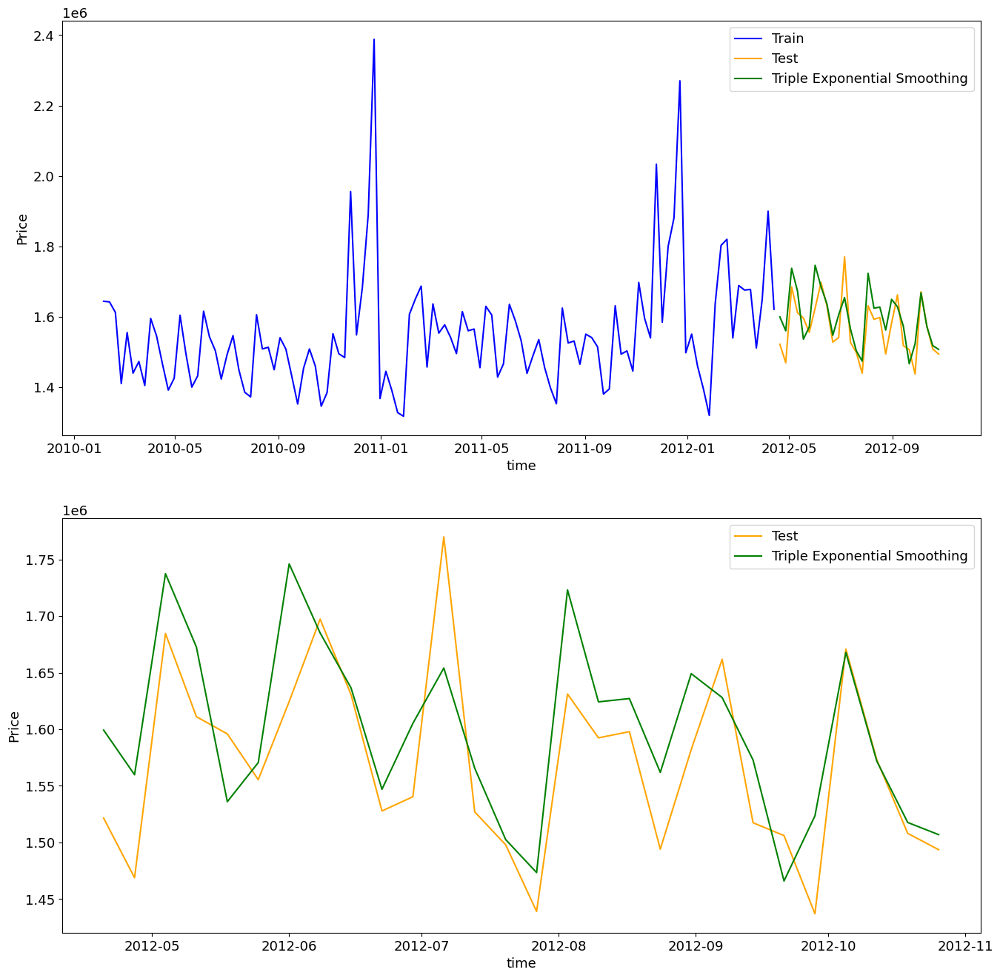

In [150]:
fig ,axes =plt.subplots(2,1)
fig.set_figheight(16)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')
axes[0].plot(pred_data, label='Triple Exponential Smoothing',color='green')
axes[0].set_xlabel('time')
axes[0].set_ylabel("Price")

axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(pred_data, label='Triple Exponential Smoothing',color='green')

axes[1].set_xlabel('time')
axes[1].set_ylabel("Price")
axes[1].legend(loc='best')
plt.show()

## B- ARIMA Models:

### Define kpss_test function

In [62]:
def kpss_test(data,threshold=0.05,regression="c"):
    result = kpss(data,regression="c")
    #print(result)
    # Print test results
    print('KPSS Statistic:', result[0])
    print('p-value:', result[1])
    print('Lags Used:', result[2])
    print('Critical Values:')
    for key, value in result[3].items():
        print('\t{}: {}'.format(key, value))
    if result[1]<=threshold:
        print("The data is not stationary")
    else:
        print("The data is stationary")

### Define adf_test function

In [63]:
def adf_test(data,threshold=0.05):
    # Perform ADF test
    result = adfuller(data,autolag="AIC")

    # Print test results
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t{}: {}'.format(key, value))

    if result[1] <= threshold:
        print("Conclusion:====>")
        print("Reject the null hypothesis")
        print("Data is stationary")
    else:
        print("Conclusion:====>")
        print("Fail to reject the null hypothesis")
        print("Data is non-stationary")

### Define autocorrelatin_graphs function

In [64]:
def autocorrelatin_graphs(value,n_lags,title_text):
    fig, axes = plt.subplots(3,1,dpi=80)
    fig.set_figheight(12)
    fig.set_figwidth(16)
    value_plot = axes[0].plot(value)
    plt.title(f'{title_text}')
    acf_plot = plot_acf(value, lags=n_lags, title=f'Autocorrelation in {title_text}',ax=axes[1])
    plt.xlabel('Lags')
    pacf_plot = plot_pacf(value, lags=n_lags, title=f'Partial Autocorrelation in {title_text}',ax=axes[2])
    plt.xlabel('Lags')
    plt.tight_layout()
    plt.show()

### Plot Rolling mean and STD

Text(0.5, 1.0, 'Rolling Mean & Standard Deviation')

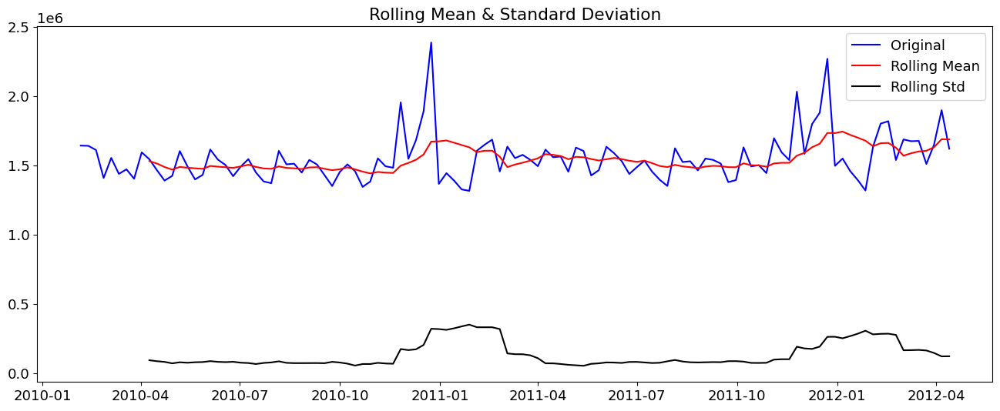

In [65]:
fig ,axes =plt.subplots(1,1)
fig.set_figheight(6)
fig.set_figwidth(16)

#Determing rolling statistics
rolmean = train_data.rolling( window=10).mean()
rolstd = train_data.rolling(window=10).std()

#Plot rolling statistics:
orig = axes.plot(train_data, color='blue',label='Original')
mean = axes.plot(rolmean, color='red', label='Rolling Mean')
std = axes.plot(rolstd, color='black', label = 'Rolling Std')
axes.legend(loc='best')
axes.set_title('Rolling Mean & Standard Deviation')

### Check stationarity:

In [66]:
adf_test(train_data)

ADF Statistic: -4.666401983458514
p-value: 9.727147275114244e-05
Critical Values:
	1%: -3.4912451337340342
	5%: -2.8881954545454547
	10%: -2.5809876033057852
Conclusion:====>
Reject the null hypothesis
Data is stationary


In [67]:
kpss_test(train_data)

KPSS Statistic: 0.4807181139345229
p-value: 0.04600943379853088
Lags Used: 4
Critical Values:
	10%: 0.347
	5%: 0.463
	2.5%: 0.574
	1%: 0.739
The data is not stationary


### <font color='red'>**In the first look, data seems to be stationary. Despite that, the tests :one confirm that the data is stationary. and the other is not **</font>

### Autocorrelatin Graphs

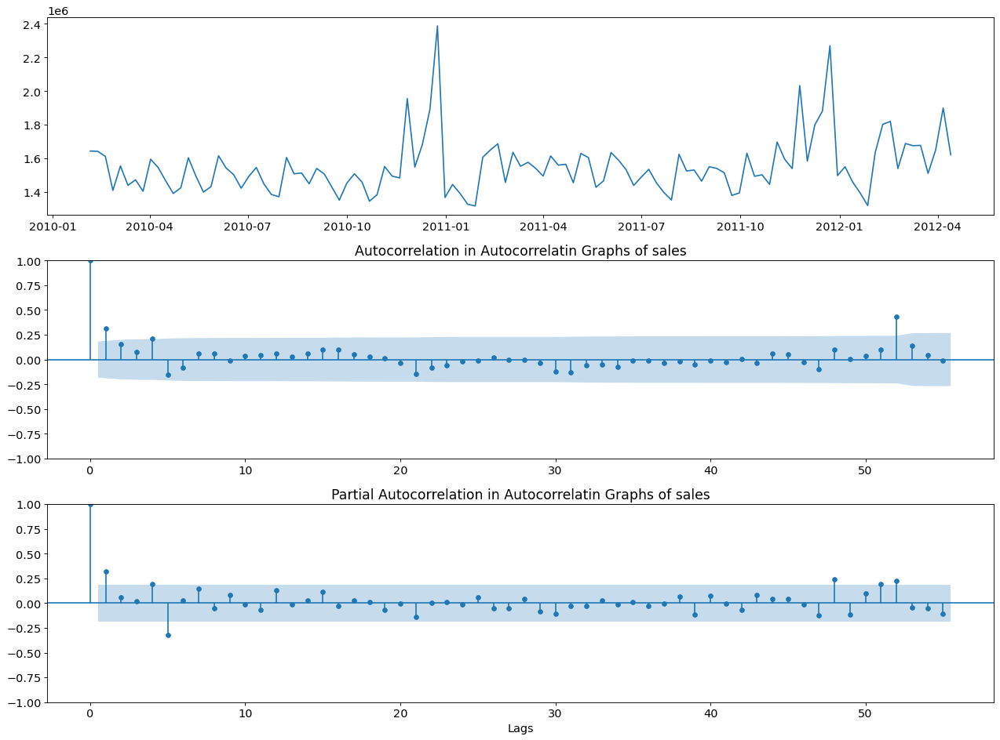

In [68]:
autocorrelatin_graphs(train_data, n_lags=55, title_text="Autocorrelatin Graphs of sales")

In [166]:
# fit model
ARIMA_model = ARIMA(train_data, order=(1, 0, 1))
ARIMA_model_fit = ARIMA_model.fit()

In [167]:
ARIMA_model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:           Weekly_Sales   No. Observations:                  115
Model:                 ARIMA(1, 0, 1)   Log Likelihood               -1540.854
Date:                Thu, 28 Mar 2024   AIC                           3089.708
Time:                        00:52:48   BIC                           3100.688
Sample:                    02-05-2010   HQIC                          3094.164
                         - 04-13-2012                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.552e+06   2.94e+04     52.836      0.000    1.49e+06    1.61e+06
ar.L1          0.5376      0.319      1.686      0.092      -0.088       1.163
ma.L1         -0.2500      0.374     -0.668      0.504      -0.983       0.483
sigma2      2.599e+10      0.228   1.14e+11      0.000     2.6e+10     2.6e+10
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):               165.55
Prob(Q):                              0.94   Prob(JB):                         0.00
Heteroskedasticity (H):               4.10   Skew:                             1.57
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.97
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 6.21e+25. Standard errors may be unstable.
"""

In [168]:
start_index = test_data.index.min()
end_index = test_data.index.max()

#Predictions
arima_preds = ARIMA_model_fit.predict(start=start_index, end=end_index)

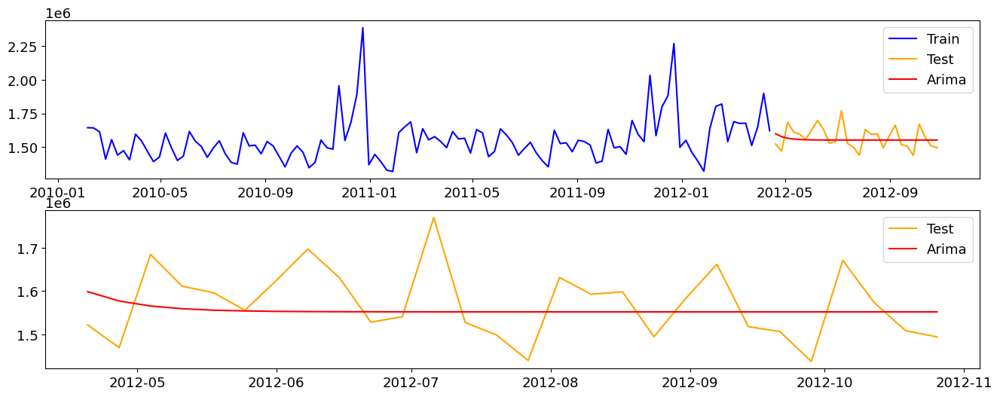

In [169]:
fig ,axes =plt.subplots(2,1)
fig.set_figheight(6)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')

axes[0].plot(arima_preds,label="Arima",color='red')
axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(arima_preds,label="Arima",color='red')
axes[1].legend(loc='best')
plt.show()

In [170]:
MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,arima_preds,naiive_pred[0].values)

In [171]:
print(f"""
MAE for arima method:{MAE}
RMSE for arima method:{RMSE}
MAPE for arima method:{MAPE}
MdRAE for arima method:{MdRAE}
GMRAE for arima method:{GMRAE}""")


MAE for arima method:69243.25556822389
RMSE for arima method:83591.09054282442
MAPE for arima method:4.357826549617619
MdRAE for arima method:0.7410513564926066
GMRAE for arima method:0.9166893984747284


### SARIMAX

In [177]:
# fit model
SARIMAX_model = SARIMAX(train_data, order=(1, 0, 1), seasonal_order=(1, 0, 1, 52))
SARIMAX_model_fit = SARIMAX_model.fit()

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01

At iterate    5    f=  1.33439D+01    |proj g|=  4.55021D-02

At iterate   10    f=  1.33331D+01    |proj g|=  1.54654D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   3.285D-06   1.333D+01
  F =   13.333118727916172     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


In [178]:
SARIMAX_model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                       Weekly_Sales   No. Observations:                  115
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 52)   Log Likelihood               -1533.309
Date:                            Thu, 28 Mar 2024   AIC                           3076.617
Time:                                    00:56:58   BIC                           3090.342
Sample:                                02-05-2010   HQIC                          3082.188
                                     - 04-13-2012                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9991      0.011     91.517      0.000       0.978       1.021
ma.L1         -0.8359      0.078    -10.784      0.000      -0.988      -0.684
ar.S.L52       0.5990      2.023      0.296      0.767      -3.366       4.564
ma.S.L52      -0.0280      3.095     -0.009      0.993      -6.094       6.038
sigma2      3.166e+10   2.58e-10   1.23e+20      0.000    3.17e+10    3.17e+10
===================================================================================
Ljung-Box (L1) (Q):                   3.26   Jarque-Bera (JB):               304.71
Prob(Q):                              0.07   Prob(JB):                         0.00
Heteroskedasticity (H):               1.63   Skew:                             1.53
Prob(H) (two-sided):                  0.14   Kurtosis:                        10.36
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.17e+36. Standard errors may be unstable.
"""

In [179]:
start_index = test_data.index.min()
end_index = test_data.index.max()

#Predictions
SARIMAX_preds = SARIMAX_model_fit.predict(start=start_index, end=end_index)

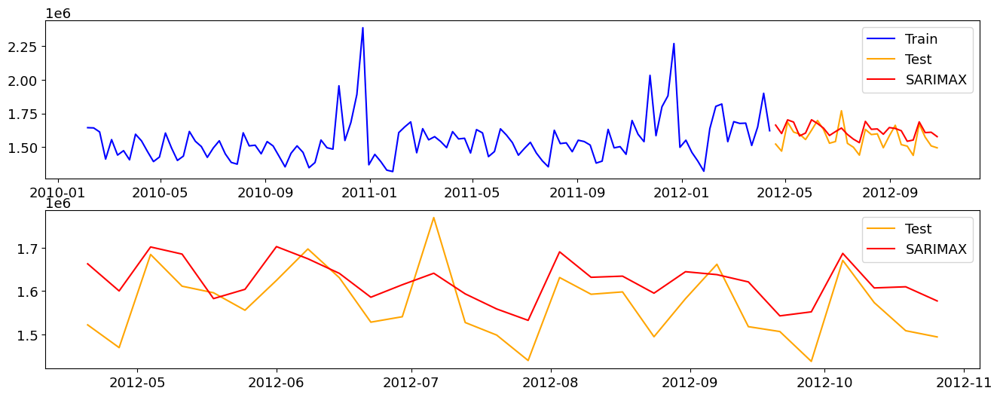

In [180]:
fig ,axes =plt.subplots(2,1)
fig.set_figheight(6)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')

axes[0].plot(SARIMAX_preds,label="SARIMAX",color='red')
axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(SARIMAX_preds,label="SARIMAX",color='red')
axes[1].legend(loc='best')
plt.show()

In [181]:
MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,SARIMAX_preds,naiive_pred[0].values)

In [182]:
print(f"""
MAE for sarimax method:{MAE}
RMSE for sarimax method:{RMSE}
MAPE for sarimax method:{MAPE}
MdRAE for sarimax method:{MdRAE}
GMRAE for sarimax method:{GMRAE}""")


MAE for sarimax method:65323.02490363665
RMSE for sarimax method:75404.08591034528
MAPE for sarimax method:4.23051784353149
MdRAE for sarimax method:0.7659261026336299
GMRAE for sarimax method:0.936054163325504


### Auto Arima

In [183]:
stepwise_model = auto_arima(train_data,start_p=1, start_q=1,d=1, max_p=3, max_q=3,
                            seasonal=True, start_P =1, start_Q=1, D=1, max_Q=3, max_P=3, max_order=12, m=52,
                            trace=True,stationary=True,error_action='ignore',
                            suppress_warnings=True, stepwise=True,information_criterion="bic")
stepwise_model.summary()

Performing stepwise search to minimize bic
 ARIMA(1,0,1)(1,0,1)[52] intercept   : BIC=3077.193, Time=2.21 sec
 ARIMA(0,0,0)(0,0,0)[52] intercept   : BIC=3103.851, Time=0.04 sec
 ARIMA(1,0,0)(1,0,0)[52] intercept   : BIC=3084.281, Time=0.86 sec
 ARIMA(0,0,1)(0,0,1)[52] intercept   : BIC=3077.753, Time=0.53 sec
 ARIMA(0,0,0)(0,0,0)[52]             : BIC=3611.067, Time=0.03 sec
 ARIMA(1,0,1)(0,0,1)[52] intercept   : BIC=3077.077, Time=0.84 sec
 ARIMA(1,0,1)(0,0,0)[52] intercept   : BIC=3100.985, Time=0.10 sec
 ARIMA(1,0,1)(0,0,2)[52] intercept   : BIC=3076.414, Time=8.10 sec
 ARIMA(1,0,1)(1,0,2)[52] intercept   : BIC=3080.589, Time=12.98 sec
 ARIMA(1,0,1)(0,0,3)[52] intercept   : BIC=3079.631, Time=15.88 sec
 ARIMA(1,0,1)(1,0,3)[52] intercept   : BIC=3084.375, Time=32.43 sec
 ARIMA(0,0,1)(0,0,2)[52] intercept   : BIC=3077.706, Time=2.91 sec
 ARIMA(1,0,0)(0,0,2)[52] intercept   : BIC=3071.171, Time=3.42 sec
 ARIMA(1,0,0)(0,0,1)[52] intercept   : BIC=3071.944, Time=0.61 sec
 ARIMA(1,0,0)(1,

<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:                                       y   No. Observations:                  115
Model:             SARIMAX(1, 0, 0)x(0, 0, [1, 2], 52)   Log Likelihood               -1523.723
Date:                                 Thu, 28 Mar 2024   AIC                           3057.446
Time:                                         01:04:55   BIC                           3071.171
Sample:                                     02-05-2010   HQIC                          3063.017
                                          - 04-13-2012                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   1.059e+06   1.72e+05      6.154      0.000    7.22e+05     1.4e+06
ar.L1          0.3181      0.095      3.361      0.001       0.133       0.504
ma.S.L52       0.5975      0.477      1.253      0.210      -0.337       1.532
ma.S.L104      0.2768      1.033      0.268      0.789      -1.748       2.302
sigma2      2.569e+10      0.182   1.41e+11      0.000    2.57e+10    2.57e+10
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):               240.63
Prob(Q):                              0.97   Prob(JB):                         0.00
Heteroskedasticity (H):               1.87   Skew:                             1.42
Prob(H) (two-sided):                  0.06   Kurtosis:                         9.49
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.43e+31. Standard errors may be unstable.
"""

In [185]:
length = len(test_data)

#Predictions
auto_arima_forecast,conf_int = stepwise_model.predict(n_periods=length,return_conf_int=True)

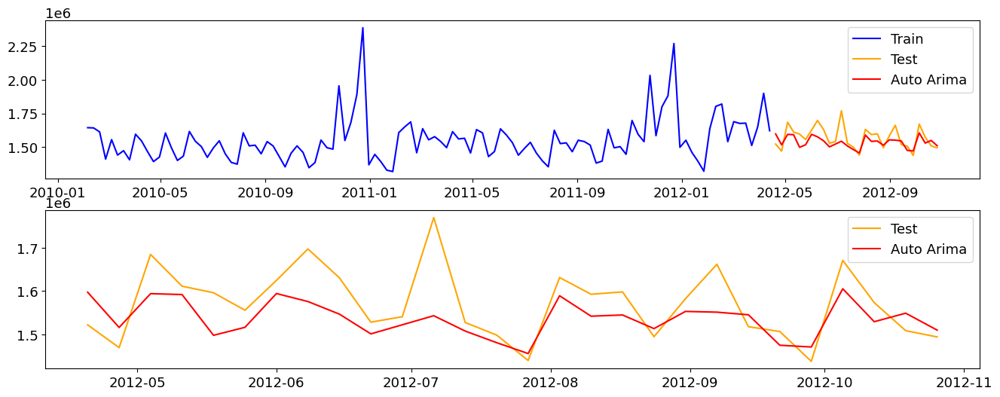

In [186]:
fig ,axes =plt.subplots(2,1)
fig.set_figheight(6)
fig.set_figwidth(16)

axes[0].plot(train_data, label='Train',color='blue')
axes[0].plot(test_data, label='Test',color='orange')

axes[0].plot(auto_arima_forecast,label="Auto Arima",color='red')
axes[0].legend(loc='best')

axes[1].plot(test_data, label='Test',color='orange')
axes[1].plot(auto_arima_forecast,label="Auto Arima",color='red')
axes[1].legend(loc='best')
plt.show()

In [187]:
MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,auto_arima_forecast,naiive_pred[0].values)

In [188]:
print(f"""
MAE for Auto Arima method:{MAE}
RMSE for Auto Arima method:{RMSE}
MAPE for Auto Arima method:{MAPE}
MdRAE for Auto Arima method:{MdRAE}
GMRAE for Auto Arima method:{GMRAE}""")


MAE for Auto Arima method:53454.93843058932
RMSE for Auto Arima method:69660.11092696314
MAPE for Auto Arima method:3.309182473244164
MdRAE for Auto Arima method:0.7566936205183251
GMRAE for Auto Arima method:0.736805991918521


### ARIMA fine tuning:

In [69]:
def run_one_arima(train_data,test_data,params):
    naiive_pred = naive_method(train_data,test_data)
    p = params['p']
    d = params['d']
    q = params['q']
    P = params['P']
    D = params['D']
    Q = params['Q']
    seasonal_order = params['seasonal_periods']
    


    try:
        model = SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, seasonal_order))
        SARIMAX_model_fit = model.fit()
        aicc = SARIMAX_model_fit.aicc.round(2)
        bic = SARIMAX_model_fit.bic.round(2)
        start_index = test_data.index.min()
        end_index = test_data.index.max()
        
        #Predictions
        SARIMAX_preds = SARIMAX_model_fit.predict(start=start_index, end=end_index)
        
        MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data.values,SARIMAX_preds,naiive_pred[0].values)
        results = {'p':p,'d':d,'q':q,'seasonal_order':seasonal_order,
                                        'P':P,'D':D,'Q':Q,
                                        'AICc':aicc,'BIC':bic,
                                        'RMSE':RMSE,'MAE':MAE,'MAPE':MAPE,'MdRAE':MdRAE,'GMRAE':GMRAE}
        
    except:
        results = {'p':p,'d':d,'q':q,'seasonal_order':seasonal_order,
                                        'P':P,'D':D,'Q':Q,
                                        'AICc':None,'BIC':None,
                                        'RMSE':None,'MAE':None,'MAPE':None,'MdRAE':None,'GMRAE':None}
    return results

In [70]:
param_grid = {'p': [0,1,2,3],'d' :[0,1],'q': [0,1,2,3],'seasonal_periods':[5,12,52],
              'P' : [0,1,2], 'D': [0,1], 'Q':[0,1,2]} 

In [71]:
all_params = [dict(zip((param_grid),v)) for v in itertools.product(*param_grid.values())]

In [74]:
jobs = list()
for param in all_params:
    jobs.append(delayed(run_one_arima)(train_data,test_data,param))

In [75]:
p = Parallel(n_jobs=6)(jobs)
results = pd.DataFrame(p)

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.55604D+01    |proj g|=  6.61553D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.59399D+01    |proj g|=  1.66577D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.56797D+01    |proj g|=  3.55269D-10

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      8      9      1     0     0   8.578D-07   1.538D+01
  F =   15.379532368959165     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32791D+01    |proj g|=  1.71596D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.62707D+03    |proj g|=  2.84620D+03

At iterate    5    f=  1.43963D+01    |proj g|=  5.18668D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34753D+01    |proj g|=  6.50361D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34198D+01    |proj g|=  6.75980D-01

At iterate    5    f=  4.41817D+01    |proj g|=  2.79542D+01

At iterate   10    f=  1.38242D+01    |proj g|=  3.87751D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8      9      1     0     0   5.601D-07   1.535D+01
  F =   15.348076923477207     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41034D+01    |proj g|=  2.88785D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.58982D+02    |proj g|=  3.64501D+02

At iterate   25    f=  1.31946D+01    |proj g|=  1.32291D-02

At iterate    5    f=  1.45899D+01    |proj g|=  1.62596D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.08186D+01    |proj g|=  4.87468D+01

At iterate   25    f=  1.38250D+01    |proj g|=  1.39544D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     25     32      1     0     0   1.395D-03   1.383D+01
  F =   13.825002218141822     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   45    f=  1.31915D+01    |proj g|=  7.25854D-04

At iterate   10    f=  1.39702D+01    |proj g|=  6.72754D-02

At iterate    5    f=  1.23492D+01    |proj g|=  2.98425D-04

           * * *

Tit   = total number of iterations
Tnf   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.38306D+01    |proj g|=  3.21046D-02

At iterate   15    f=  1.38663D+01    |proj g|=  5.94820D-04

At iterate    5    f=  1.23095D+01    |proj g|=  5.25587D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.55699D+01    |proj g|=  5.72668D+01

At iterate    5    f=  1.43005D+01    |proj g|=  7.35786D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     17     19      1     0     0   2.849D-06   1.387D+01
  F =   13.866279991514235     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At iterate   20    f=  1.38132D+01    |proj g|=  2.14832D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30063D+01    |proj g|=  1.44729D+00

At iterate   10    f=  1.39211D+01    |proj g|=  2.24985D-02

At iterate    5    f=  1.41909D+01    |proj g|=  2.86727D-01
RUNNING THE L-BFGS-B CODE


At iterate   10    f=  1.23085D+01    |proj g|=  1.79252D-02
           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33950D+01    |proj g|=  2.20308D+00

At iterate   10    f=  1.38049D+01    |proj g|=  9.20647D-03

At iterate   15    f=  1.38622D+01    |proj g|=  3.35223D-02

At iterate    5    f=  1.23590D+01    |proj g|=  1.18496D-02

At iterate   15    f=  1.23083D+01    |proj g|=  7.73708D-05

At iterate   25    f=  1.38124D+01    |proj g|

Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     16     18      1     0     0   8.773D-05   1.231D+01
  F =   12.308273877239770     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.38207D+01    |proj g|=  1.24711D-02

At iterate    5    f=  1.23208D+01    |proj g|=  1.80025D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5     18      1     0     0   1.

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be 


At iterate    5    f=  1.23082D+01    |proj g|=  8.82479D-02

At iterate    5    f=  2.87095D+01    |proj g|=  7.40073D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     19     23      1     0     0   2.580D-05   1.234D+01
  F =   12.340302695215611     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.07324D+00    |proj g|=  6.97255D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     42      2     0     0   8.721D-05   1.380D+01
  F =   13.797415470666309     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  2.78366D+01    |proj g|=  3.67511D-02

At iterate   10    f=  1.23057D+01    |proj g|=  9.85262D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.70190D+02    |proj g|=  2.83023D+02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06217D+00    |proj g|=  6.84168D+00

At iterate   15    f=  2.77210D+01    |proj g|=  1.83695D-03


 This problem is unconstrained.



At iterate    5    f=  2.46232D+01    |proj g|=  6.93882D+00

At iterate   15    f=  1.23000D+01    |proj g|=  2.10915D-02

At iterate   20    f=  2.76951D+01    |proj g|=  1.66617D-04

At iterate   10    f=  1.50845D+01    |proj g|=  3.26126D-01

At iterate   20    f=  1.22992D+01    |proj g|=  1.60656D-02

At iterate   15    f=  1.41560D+01    |proj g|=  9.69239D-03

At iterate   25    f=  1.76151D+01    |proj g|=  1.94830D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2     27     29      1     0     0   5.537D-06   1.606D+01
  F =   16.063938136886364     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     36      1     0     0   1.826D-05   1.230D+01
  F =   12.299142284060986     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.62144D+01    |proj g|=  4.74365D+01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   3.153D-06   6.966D+00
  F =   6.9662830354258851     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.50543D+01    |proj g|=  9.55932D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65831D+01    |proj g|=  4.78454D+01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exact

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.02559D+00    |proj g|=  2.33264D-05

At iterate   20    f=  1.42582D+01    |proj g|=  1.25695D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06217D+00    |proj g|=  6.84409D+00


 This problem is unconstrained.



At iterate   10    f=  1.82424D+01    |proj g|=  3.41510D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     21     27      1     0     0   1.084D-04   1.426D+01
  F =   14.258171427738695     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.48279D+01    |proj g|=  7.58919D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.27268D+02    |proj g|=  2.35861D+02


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06534D+00    |proj g|=  6.95100D+00

At iterate   15    f=  1.80966D+01    |proj g|=  1.73204D-03


 This problem is unconstrained.



At iterate    5    f=  6.96391D+00    |proj g|=  5.49451D-01

At iterate    5    f=  1.72077D+01    |proj g|=  2.86908D+00

At iterate   20    f=  1.80763D+01    |proj g|=  8.35772D-05

At iterate   10    f=  1.43601D+01    |proj g|=  7.22422D-02

At iterate   10    f=  6.92661D+00    |proj g|=  1.50747D+00

At iterate    5    f=  6.84687D+00    |proj g|=  5.93983D-03

At iterate   10    f=  1.46932D+01    |proj g|=  1.21326D-01

At iterate   15    f=  6.89409D+00    |proj g|=  1.57306D-01

At iterate   25    f=  1.68038D+01    |proj g|=  2.37748D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      9   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.62144D+01    |proj g|=  4.74365D+01


 This problem is unconstrained.



At iterate   15    f=  1.41455D+01    |proj g|=  3.01719D-02

At iterate   20    f=  1.42565D+01    |proj g|=  6.31034D-04

At iterate   25    f=  6.88340D+00    |proj g|=  8.94848D-03

At iterate    5    f=  6.84687D+00    |proj g|=  1.74344D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     22     27      1     0     0   2.250D-05   1.426D+01
  F =   14.256452231551521     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.44968D+01    |proj g|=  4.99449D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.40995D+01    |proj g|=  6.83912D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   1.680D-03   6.847D+00
  F =   6.8468721796415819     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65831D+01    |proj g|=  4.78454D+01


 This problem is unconstrained.



At iterate   30    f=  6.88199D+00    |proj g|=  7.71429D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.42611D+01    |proj g|=  1.66804D-02

At iterate   35    f=  6.88143D+00    |proj g|=  2.22912D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05907D+00    |proj g|=  6.73717D+00


 This problem is unconstrained.



At iterate    5    f=  1.45137D+01    |proj g|=  4.89620D-01

At iterate   40    f=  6.88117D+00    |proj g|=  2.32413D-03

At iterate   15    f=  1.42583D+01    |proj g|=  5.96774D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     16     17      1     0     0   4.545D-05   1.426D+01
  F =   14.258341263238556     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.42634D+01    |proj g|=  8.82726D-02

At iterate   45    f=  6.88106D+00    |proj g|=  1.87364D-04

At iterate   25    f=  1.40993D+01    |proj g|=  7.51632D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06217D+00    |proj g|=  6.84409D+00


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06534D+00    |proj g|=  6.95100D+00


 This problem is unconstrained.



At iterate   15    f=  1.42565D+01    |proj g|=  3.99187D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     27     54      1     0     0   1.400D-04   1.410D+01
  F =   14.099251086666071     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  1.15995D-01

At iterate    5    f=  1.53478D+01    |proj g|=  4.47464D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      6      1     0     0   4.475D-07   1.535D+01
  F =   15.347760605620239     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.54865D+01    |proj g|=  6.72100D-01

At iterate    5    f=  1.52821D+01    |proj g|=  1.11161D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    3      6      7      1     0     0   3.804D-06   1.528D+01
  F =   15.282146611701029     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53338D+01    |proj g|=  2.64479D-01

At iterate    5    f=  1.52538D+01    |proj g|=  3.94706D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8      9      1     0     0   5.668D-07   1.525D+01
  F =   15.253822547199238     

CONVERGENCE: NORM_OF_PROJECTED_GRADI

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32703D+01    |proj g|=  9.06064D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      3      5      1     0     0   1.243D-08   1.327D+01
  F =   13.266944545829105     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32782D+01    |proj g|=  3.75693D-01


 This problem is unconstrained.



At iterate    5    f=  1.31656D+01    |proj g|=  2.22013D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     22      1     0     0   9.520D-07   1.315D+01
  F =   13.145030282201036     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32731D+01    |proj g|=  3.97967D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anac

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52810D+01    |proj g|=  2.85896D-02

At iterate    5    f=  1.31724D+01    |proj g|=  1.53339D-01

At iterate    5    f=  1.52392D+01    |proj g|=  4.16943D-02

At iterate   10    f=  1.31447D+01    |proj g|=  3.90955D-03

At iterate   10    f=  1.52248D+01    |proj g|=  2.03541D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     17      1     0     0   9.748D-06   1.522D+01
  F =   15.224781338957719     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL    

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32474D+01    |proj g|=  3.29728D-01

At iterate   15    f=  1.52281D+01    |proj g|=  1.45096D-03

At iterate    5    f=  1.31600D+01    |proj g|=  2.77651D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     48     78      1     0     0   1.371D-04   6.881D+00
  F =   6.8810580300236124     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total nu


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   20    f=  1.52202D+01    |proj g|=  1.42738D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32505D+01    |proj g|=  3.77788D-01

At iterate   25    f=  1.52172D+01    |proj g|=  4.35715D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     26     32      1     0     0   6.090D-06   1.522D+01
  F =   15.217233967396727     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.31453D+01    |proj g|=  9.52181D-03

At iterate   10    f=  1.31447D+01    |proj g|=  3.31376D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     13      1     0     0   2.989D-06   1.314D+01
  F =   13.144705039933195     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32990D+01    |proj g|=  4.26429D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.69132D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.52204D+01    |proj g|=  3.71750D-03

At iterate    5    f=  1.31781D+01    |proj g|=  2.43764D-01

At iterate   10    f=  1.52200D+01    |proj g|=  6.15148D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     11      1     0     0   6.151D-07   1.522D+01
  F =   15.220030569870179     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  6.84708D+00    |proj g|=  1.15393D-02

At iterate   10    f=  1.31448D+01    |proj g|=  3.96775D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.68877D+01    |proj g|=  3.40519D+00

At iterate    5    f=  1.52225D+01    |proj g|=  9.85765D-03

At iterate   15    f=  1.31448D+01    |proj g|=  2.53159D-03

At iterate   10    f=  1.52193D+01    |proj g|=  6.10561D-03

At iterate   20    f=  1.31447D+01    |proj g|=  5.54602D-03

At iterate   15    f=  1.52172D+01    |proj g|=  5.30000D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


At iterate   25    f=  1.31446D+01    |proj g|=  4.76570D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.69132D-01

At iterate   30    f=  1.31444D+01    |proj g|=  1.06864D-02

At iterate    5    f=  1.52190D+01    |proj g|=  1.22851D-02

At iterate   10    f=  1.52173D+01    |proj g|=  2.26891D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   2.950D-06   1.522D+01
  F =   15.217329420273099     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   35    f=  1.31439D+01    |proj g|=  1.82605D-03
RUNNING THE L-BFGS-B CODE

           * * *

At iterate   40    f=  1.31437D+01    |proj g|=  5.24811D-04

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32644D+01    |proj g|=  3.52484D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    4      7      9      1     0     0   9.377D-07   1.315D+01
  F =   13.146159834477587     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.31460D+01    |proj g|=  5.56425D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32730D+01    |proj g|=  3.82449D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  1.15995D-01

At iterate    5    f=  1.53478D+01    |proj g|=  4.47464D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauch

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      9      1     0     0   3.556D-06   1.528D+01
  F =   15.284278625733970     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.31445D+01    |proj g|=  1.60400D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarni

RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.51441D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23307D+01    |proj g|=  1.14056D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   1.474D-08   1.232D+01
  F =   12.324739167002690     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING T

 This problem is unconstrained.


    3      9     11      1     0     0   3.348D-07   1.229D+01
  F =   12.289268621442860     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.22893D+01    |proj g|=  1.43105D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.55639D+01    |proj g|=  1.44055D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.72139D+01    |proj g|=  3.00110D+00

At iterate    5    f=  1.55449D+01    |proj g|=  2.59026D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/s

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.51448D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     18     39      1     0     0   1.220D-06   1.525D+01
  F =   15.248900067868787     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   1.332D-03   6.847D+00
  F =   6.8470782157026271     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.22893D+01    |proj g|=  4.18816D-03

At iterate   10    f=  1.52432D+01    |proj g|=  3.15330D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30894D+01    |proj g|=  1.18079D+00

At iterate   10    f=  1.22893D+01    |proj g|=  3.72475D-03

At iterate   15    f=  1.52430D+01    |proj g|=  6.46967D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     18      1     0     0   6.470D-06   1.524D+01
  F =   15.242997652969262     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be 


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.51448D-01

At iterate    5    f=  1.22891D+01    |proj g|=  7.52871D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     27      1     0     0   3.113D-05   1.229D+01
  F =   12.289265229646743     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.52454D+01    |proj g|=  4.44558D-03

At iterate   10    f=  1.52453D+01    |proj g|=  9.41203D-06

           * * *

Tit   = total number of iteration

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  3.51448D-01

At iterate    5    f=  1.52455D+01    |proj g|=  3.02912D-03

At iterate    5    f=  6.84687D+00    |proj g|=  1.44268D-03

At iterate   15    f=  1.22864D+01    |proj g|=  1.83251D-04

At iterate   10    f=  1.52431D+01    |proj g|=  4.13586D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     19      1     0     0   7.861D-05   1.229D+01
  F =   12.286415311815134     

CONVERGENCE: REL_REDUCTION_OF_F_<

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.52433D+01    |proj g|=  8.22470D-04

At iterate    5    f=  1.22883D+01    |proj g|=  2.31021D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     10      1     0     0   9.845D-07   1.229D+01
  F =   12.288310895144418     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.52431D+01    |proj g|=  2.23961D-03

At iterate    5    f=  1.22878D+01    |proj g|=  8.45882D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   25    f=  1.52430D+01    |proj g|=  1.44715D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30855D+01    |proj g|=  1.09329D+00



   evaluations in the last line search.  Termination



At iterate   10    f=  1.22844D+01    |proj g|=  3.08278D-02

At iterate    5    f=  6.84735D+00    |proj g|=  9.67327D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5     17      1     0     0   9.673D-05   6.847D+00
  F =   6.8473514402708497     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  1.52429D+01    |proj g|=  1.11528D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23588D-01

At iterate   10    f=  1.22827D+01    |proj g|=  9.32988D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     34      1     0     0   2.907D-05   1.228D+01
  F =   12.283527751216036     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.22822D+01    |proj g|=  1.26109D-02

At iterate    5    f=  1.53211D+01    |proj g|=  2.58944D-03



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     12      1     0     0   3.702D-06   1.532D+01
  F =   15.320998258285302     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.22817D+01    |proj g|=  2.73909D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23588D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  3.22292D-01

At iterate   25    f=  1.22814D+01    |proj g|=  1.27197D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56199D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01

At iterate    5    f=  1.53171D+01    |proj g|=  1.10453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56199D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     10      1     0     0   5.047D-07   1.532D+01
  F =   15.315872319878602     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01

At iterate    5    f=  1.53167D+01    |proj g|=  6.40183D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.00563D+00    |proj g|=  1.85474D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01

At iterate    5    f=  1.53157D+01    |proj g|=  1.51367D-03


 This problem is unconstrained.



At iterate   10    f=  1.53157D+01    |proj g|=  1.53300D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.533D-06   1.532D+01
  F =   15.315715544702179     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.96124D+01    |proj g|=  2.30575D+01


 This problem is unconstrained.



At iterate   10    f=  6.95373D+00    |proj g|=  4.20008D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   4.952D-06   6.954D+00
  F =   6.9537307874739520     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56278D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.53160D+01    |proj g|=  4.07189D-03

At iterate    5    f=  7.12041D+00    |proj g|=  3.04803D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56278D+00


 This problem is unconstrained.



At iterate   10    f=  6.95235D+00    |proj g|=  3.36205D-02

At iterate    5    f=  7.02158D+00    |proj g|=  1.45505D+00

At iterate   10    f=  1.53157D+01    |proj g|=  1.31208D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     13     18      1     0     0   5.993D-06   6.952D+00
  F =   6.9520801641500025     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.96461D+00    |proj g|=  6.51121D-01

At iterate   10    f=  6.95204D+00    |proj g|=  3.09719D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     18      1     0     0   3.917D-06   1.532D+01
  F =   15.315714875319848     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.53176D+01    |proj g|=  1.34938D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.91762D+00    |proj g|=  3.91421D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     10      1     0     0   7.589D-06   1.532D+01
  F =   15.315714870611314     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.87774D+00    |proj g|=  1.08729D-02

At iterate   20    f=  6.90675D+00    |proj g|=  1.04258D-01

At iterate    5    f=  6.97138D+00    |proj g|=  9.86569D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53821D+01    |proj g|=  2.23593D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6     20      1     0     0   1.443D-03   6.847D+00
  F =   6.8468719424631823     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate    5    f=  1.53159D+01    |proj g|=  6.48847D-03

At iterate   25    f=  6.90320D+00    |proj g|=  2.59465D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     15      1     0     0   1.646D-05   6.878D+00
  F =   6.8777421718758989     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56278D+00


 This problem is unconstrained.



At iterate   35    f=  6.90143D+00    |proj g|=  3.98089D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      9     11      1     0     0   7.911D-05   1.532D+01
  F =   15.315714963866990     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.87774D+00    |proj g|=  1.39328D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56278D+00


 This problem is unconstrained.



At iterate   40    f=  6.90134D+00    |proj g|=  5.20246D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.06253D+00    |proj g|=  1.56278D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01

At iterate    5    f=  1.52515D+01    |proj g|=  1.80073D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      8      1     0     0   4.021D-06   1.525D+01
  F =   15.251468922298434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.54269D+01    |proj g|=  5.41587D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     43     51      1     0     0   1.287D-05   6.901D+00
  F =   6.9013367510773742     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.52292D+01    |proj g|=  7.03931D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53043D+01    |proj g|=  2.12856D-01

At iterate    5    f=  1.52226D+01    |proj g|=  5.19911D-03

At iterate   10    f=  1.52218D+01    |proj g|=  2.93065D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   2.880D-06   1.522D+01
  F =   15.221836947705999     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32736D+01    |proj g|=  1.13405D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4      6      1     0     0   9.791D-07   1.327D+01
  F =   13.266876168927711     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   1.046D-03   6.878D+00
  F =   6.8777409653471020     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32468D+01    |proj g|=  3.53597D-01

At iterate    5    f=  1.31671D+01    |proj g|=  9.57193D-03

At iterate   10    f=  1.31287D+01    |proj g|=  9.85715D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     19      1     0     0   2.674D-06   1.313D+01
  F =   13.128379834751343     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32401D+01    |proj g|=  3.69073D-01

At iterate    5    f=  1.31428D+01    |proj g|=  4.33419D-02

At iterate   10    f=  1.31259D+01    |proj g|=  1.25925D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     16      1     0     0   6.228D-06   1.313D+01
  F =   13.125782888024137     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52773D+01    |proj g|=  1.04724D-02

At iterate    5    f=  1.52558D+01    |proj g|=  4.49806D-02

At iterate   10    f=  1.52333D+01    |proj g|=  2.87865D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.97105D-01

At iterate   15    f=  1.52304D+01    |proj g|=  1.01223D-02

At iterate    5    f=  1.52187D+01    |proj g|=  9.77776D-03

At iterate   20    f=  1.52271D+01    |proj g|=  1.24201D-02

At iterate   25    f=  1.52270D+01    |proj g|=  2.74991D-04

At iterate   10    f=  1.52116D+01    |proj g|=  4.14771D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     26     42      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     18      1     0     0   2.004D-06   1.521D+01
  F =   15.211455557470698     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.59889D+01    |proj g|=  1.90359D+01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32232D+01    |proj g|=  2.85613D-01

At iterate    5    f=  1.53406D+01    |proj g|=  1.49966D-01

At iterate    5    f=  1.31510D+01    |proj g|=  1.48371D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.52179D+01    |proj g|=  6.36055D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32197D+01    |proj g|=  3.38878D-01

At iterate    5    f=  1.31258D+01    |proj g|=  7.72019D-04

At iterate   20    f=  1.52139D+01    |proj g|=  1.06680D-02

At iterate   10    f=  1.31258D+01    |proj g|=  2.83071D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   1.684D-06   1.313D+01
  F =   13.125787487816856     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32637D+01    |proj g|=  3.90705D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.97105D-01

At iterate    5    f=  1.31555D+01    |proj g|=  5.73077D-02

At iterate    5    f=  1.52140D+01    |proj g|=  2.14731D-03

At iterate   10    f=  1.52139D+01    |proj g|=  1.36451D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.65545D+01    |proj g|=  2.73918D+00

At iterate   15    f=  1.31259D+01    |proj g|=  2.39952D-03

At iterate    5    f=  1.52138D+01    |proj g|=  6.39315D-03

At iterate   20    f=  1.31258D+01    |proj g|=  2.37668D-03

At iterate   10    f=  1.52121D+01    |proj g|=  4.36831D-03

At iterate   15    f=  1.52113D+01    |proj g|=  1.09338D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     20      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    6     24     28      1     0     0   9.189D-06   1.313D+01
  F =   13.125772818345697     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.97105D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32356D+01    |proj g|=  3.12626D-01

At iterate    5    f=  1.52140D+01    |proj g|=  1.15208D-02

At iterate    5    f=  1.31322D+01    |proj g|=  1.56407D-02

At iterate    5    f=  6.92488D+00    |proj g|=  1.40724D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skip

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/


At iterate   10    f=  1.52115D+01    |proj g|=  2.78881D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     13     16      1     0     0   1.195D-05   1.521D+01
  F =   15.211450946925483     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32352D+01    |proj g|=  3.26970D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32409D+01    |proj g|=  3.60822D-01

At iterate    5    f=  1.31298D+01    |proj g|=  9.15038D-03

At iterate   10    f=  1.31258D+01    |proj g|=  4.17024D-03

At iterate    5    f=  1.31289D+01    |proj g|=  1.98946D-02

At iterate   15    f=  1.31258D+01    |proj g|=  2.68656D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function v

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     15      1     0     0   8.347D-05   1.313D+01
  F =   13.125751735324751     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01

At iterate    5    f=  1.52515D+01    |proj g|=  1.80073D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserW

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53381D+01    |proj g|=  2.66379D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.81057D-01

At iterate    5    f=  1.52381D+01    |proj g|=  3.73945D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   3.350D-06   1.524D+

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.52328D+01    |proj g|=  1.65368D-04

At iterate    5    f=  1.23246D+01    |proj g|=  3.63780D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   3.638D-06   1.232D+01
  F =   12.324592687980825     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     14      1     0     0   5.953D-07   1.523D+01
  F =   15.232799148769315     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25770D+01    |proj g|=  7.31708D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.23058D+01    |proj g|=  1.69710D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23347D+01    |proj g|=  5.47650D-01

At iterate   10    f=  1.22845D+01    |proj g|=  2.08995D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     14      1     0     0   1.430D-06   1.228D+01
  F =   12.284513562250760     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.55631D+01    |proj g|=  6.34620D-03

At iterate    5    f=  1.22845D+01    |proj g|=  8.06408D-04

At iterate    5    f=  1.55414D+01    |proj g|=  8.96041D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     11      1     0     0   1.811D-06   1.228D+01
  F =   12.284494874903295     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.52946D+01    |proj g|=  8.07078D-02

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.68298D+01    |proj g|=  2.43103D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.52284D+01    |proj g|=  9.07135D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.81063D-01

At iterate   10    f=  1.52263D+01    |proj g|=  2.84881D-03

At iterate   15    f=  1.52257D+01    |proj g|=  7.37526D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     16      1     0     0   7.375D-06   1.523D+01
  F =   15.225743761386655     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25164D+01    |proj g|=  7.42087D-01

At iterate   10    f=  1.52259D+01    |proj g|=  3.56144D-03

At iterate    5    f=  1.22864D+01    |proj g|=  2.84482D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   4.609D-06   1.229D+01
  F =   12.286138884037111     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.52256D+01    |proj g|=  1.79313D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     19      1     0     0   2.660D-06   1.523D+01
  F =   15.225554466870108     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11


At iterate    5    f=  1.22851D+01    |proj g|=  3.45807D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.81063D-01

At iterate    5    f=  1.52275D+01    |proj g|=  3.21321D-03

At iterate   10    f=  1.22845D+01    |proj g|=  5.61717D-03

At iterate    5    f=  1.22918D+01    |proj g|=  1.12036D-01

At iterate   10    f=  1.52273D+01    |proj g|=  7.86399D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     13      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/ba

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.57763D+01    |proj g|=  1.09122D+00

At iterate   10    f=  1.22829D+01    |proj g|=  6.65925D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.81063D-01

At iterate    5    f=  1.52274D+01    |proj g|=  4.25439D-03

At iterate   10    f=  1.52263D+01    |proj g|=  3.80036D-03

At iterate   15    f=  1.22828D+01    |proj g|=  3.69267D-03

At iterate    5    f=  1.52283D+01    |proj g|=  1.24222D-02

At iterate   15    f=  1.52255D+01    |proj g|=  4.45177D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     21      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     24      1     0     0   4.447D-05   1.228D+01
  F =   12.282754166276051     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25449D+01    |proj g|=  6.47711D-01

At iterate   15    f=  1.52257D+01    |proj g|=  1.89442D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.22922D+01    |proj g|=  1.43015D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25816D+01    |proj g|=  7.46859D-01

At iterate    5    f=  6.92562D+00    |proj g|=  7.19744D-01

At iterate   20    f=  1.52256D+01    |proj g|=  3.24416D-03

At iterate   10    f=  1.22835D+01    |proj g|=  1.54330D-04

At iterate   25    f=  1.52256D+01    |proj g|=  5.70839D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     14      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'



At iterate   30    f=  1.52255D+01    |proj g|=  1.51819D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29482D+01    |proj g|=  1.18299D+00


 This problem is unconstrained.



At iterate   10    f=  1.22824D+01    |proj g|=  2.21162D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     39      1     0     0   1.306D-04   1.523D+01
  F =   15.225537883777809     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01

At iterate   15    f=  1.22801D+01    |proj g|=  3.84986D-03

At iterate    5    f=  1.52515D+01    |proj g|=  1.80073D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      8      1     0     0   4.021D-06   1.525D+01
  F =   15.251468922298434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.22904D+01    |proj g|=  2.37496D-01

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     22      1     0     0   7.434D-06   1.228D+01
  F =   12.280146108398904     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.22801D+01    |proj g|=  4.87740D-03

At iterate    5    f=  1.52485D+01    |proj g|=  7.55601D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



At iterate    5    f=  6.95579D+00    |proj g|=  9.29209D-01

At iterate   15    f=  1.22797D+01    |proj g|=  1.72461D-03

At iterate   10    f=  1.52474D+01    |proj g|=  1.24363D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     11      1     0     0   1.244D-06   1.525D+01
  F =   15.247404076905783     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.22796D+01    |proj g|=  2.24214D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  1.00954D-01


 This problem is unconstrained.



At iterate   25    f=  1.22790D+01    |proj g|=  2.33904D-03

At iterate    5    f=  7.00180D+00    |proj g|=  3.70459D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      8      1     0     0   3.705D-06   7.002D+00
  F =   7.0017978015692188     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63366D+00


 This problem is unconstrained.



At iterate    5    f=  1.52484D+01    |proj g|=  8.31105D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     15      1     0     0   2.808D-06   6.878D+00
  F =   6.8777377857703952     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63366D+00


 This problem is unconstrained.



At iterate    5    f=  6.95381D+00    |proj g|=  2.07948D-01

At iterate   10    f=  1.52471D+01    |proj g|=  1.74467D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     12      1     0     0   3.208D-06   1.525D+01
  F =   15.247088059601275     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.95228D+00    |proj g|=  1.65917D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarnin

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



At iterate    5    f=  1.52481D+01    |proj g|=  6.59082D-03

At iterate   10    f=  6.87774D+00    |proj g|=  7.25223D-03

At iterate    5    f=  1.52481D+01    |proj g|=  7.40691D-03

At iterate   10    f=  1.52471D+01    |proj g|=  6.79918D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     11      1     0     0   6.799D-06   1.525D+01
  F =   15.247123897764959     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.52471D+01    |proj g|=  3.21054D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



At iterate   15    f=  1.52471D+01    |proj g|=  3.37108D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     19      1     0     0   1.597D-05   1.525D+01
  F =   15.247075856258627     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  6.87776D+00    |proj g|=  8.04581D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.35007D+01    |proj g|=  3.06419D+01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     17      1     0     0   9.211D-04   6.878D+00
  F =   6.8777379258998108     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.89966D+00    |proj g|=  3.72438D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate    5    f=  1.52486D+01    |proj g|=  2.67104D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63472D+00


 This problem is unconstrained.



At iterate   10    f=  1.52471D+01    |proj g|=  1.05347D-03

At iterate   10    f=  7.02136D+00    |proj g|=  9.98357D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.95414D+00    |proj g|=  6.70954D-01

At iterate   15    f=  6.95070D+00    |proj g|=  9.19706D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63472D+00


 This problem is unconstrained.



At iterate   15    f=  1.52471D+01    |proj g|=  4.00075D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     18     25      1     0     0   7.759D-04   6.951D+00
  F =   6.9505649443377440     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.95050D+00    |proj g|=  4.69425D-01

At iterate   10    f=  6.88213D+00    |proj g|=  3.25605D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



At iterate   20    f=  1.52471D+01    |proj g|=  8.47550D-05

At iterate   15    f=  6.93311D+00    |proj g|=  1.01526D+00

At iterate    5    f=  1.52482D+01    |proj g|=  7.25009D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     22     25      1     0     0   2.250D-06   1.525D+01
  F =   15.247075539948112     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  6.91172D+00    |proj g|=  2.56096D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     12      1     0     0   7.711D-06   1.525D+01
  F =   15.247075520999651     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     18      1     0     0   1.077D-04   6.882D+00
  F =   6.8820828955023545     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53429D+01    |proj g|=  2.25444D-01


 This problem is unconstrained.



At iterate   25    f=  6.90635D+00    |proj g|=  6.95195D-02

At iterate    5    f=  1.52486D+01    |proj g|=  2.96298D-02

At iterate    5    f=  6.88798D+00    |proj g|=  1.12177D-01

At iterate   30    f=  6.90365D+00    |proj g|=  3.52630D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.52471D+01    |proj g|=  1.68337D-03

At iterate    5    f=  1.52494D+01    |proj g|=  1.97128D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63472D+00

At iterate   35    f=  6.90278D+00    |proj g|=  5.50941D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     14      1     0     0   3.439D-05   1.525D+01
  F =   15.247075742845624     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63472D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.52471D+01    |proj g|=  6.17245D-03

At iterate   40    f=  6.90260D+00    |proj g|=  3.96581D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00492D+00    |proj g|=  2.63472D+00


 This problem is unconstrained.



At iterate   10    f=  6.88208D+00    |proj g|=  6.27150D-03

At iterate   45    f=  6.90257D+00    |proj g|=  3.55858D-04

At iterate   15    f=  1.52471D+01    |proj g|=  1.96677D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     15      1     0     0   2.242D-03   6.882D+00
  F =   6.8820818693054555     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.88996D+00    |proj g|=  2.57639D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate    5    f=  1.52350D+01    |proj g|=  2.14629D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   5.864D-07   1.523D+01
  F =   15.234874808802084     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53604D+01    |proj g|=  3.86850D-01

At iterate    5    f=  1.52297D+01    |proj g|=  1.02480D-02

At iterate   10    f=  1.52279D+01    |proj g|=  8.45652D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   8.457D-06   1.523D+01
  F =   15.227934972937710     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52734D+01    |proj g|=  1.48619D-01

At iterate    5    f=  1.52246D+01    |proj g|=  3.93414D-03

At iterate   10    f=  1.52231D+01    |proj g|=  8.83743D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     17      1     0     0   8.804D-06   1.522D+01
  F =   15.223113642031008     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32774D+01    |proj g|=  2.75560D-01

At iterate    5    f=  1.32213D+01    |proj g|=  1.63904D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32315D+01    |proj g|=  2.88285D-01


 This problem is unconstrained.



At iterate   10    f=  1.32026D+01    |proj g|=  1.08652D-02

At iterate    5    f=  1.31709D+01    |proj g|=  1.15491D-02

At iterate   15    f=  1.32009D+01    |proj g|=  6.84652D-03

At iterate   20    f=  1.32008D+01    |proj g|=  3.64318D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     21     25      1     0     0   1.108D-04   1.320D+01
  F =   13.200777334200081     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.31612D+01    |proj g|=  8.36228D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.31325D+01    |proj g|=  3.19991D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32232D+01    |proj g|=  3.02570D-01

At iterate   20    f=  1.31315D+01    |proj g|=  3.10399D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     21     27      1     0     0   2.773D-05   1.313D+01
  F =   13.131453690452208     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.31511D+01    |proj g|=  2.70957D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52821D+01    |proj g|=  1.97663D-02

At iterate   10    f=  1.31305D+01    |proj g|=  3.00301D-02

At iterate    5    f=  1.52679D+01    |proj g|=  2.22691D-02

At iterate   15    f=  1.31290D+01    |proj g|=  4.51795D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     18      1     0     0   8.388D-06   1.313D+01
  F =   13.129029123424747     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.52474D+01    |proj g|=  1.05986D-01

At iterate   15    f=  1.52410D+01    |proj g|=  1.36026D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.09415D-01

At iterate   20    f=  1.52366D+01    |proj g|=  3.24402D-02

At iterate    5    f=  1.52221D+01    |proj g|=  3.17727D-02

At iterate   25    f=  1.52285D+01    |proj g|=  2.24326D-02

At iterate   10    f=  1.52130D+01    |proj g|=

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarnin


           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32109D+01    |proj g|=  2.42567D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     43     63      1     0     0   6.408D-06   1.522D+01
  F =   15.217789207491426     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.53108D+01    |proj g|=  9.08326D-02

At iterate    5    f=  1.31513D+01    |proj g|=  4.17531D-03

At iterate   10    f=  1.31512D+01    |proj g|=  1.06528D-06

           * * *

Tit   = total n

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.52225D+01    |proj g|=  1.04777D-02

At iterate    5    f=  1.31291D+01    |proj g|=  2.25867D-03

At iterate   10    f=  6.88208D+00    |proj g|=  4.60318D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32449D+01    |proj g|=  3.21205D-01

At iterate   15    f=  1.52170D+01    |proj g|=  4.49733D-03

At iterate   10    f=  1.31290D+01    |proj g|=  1.67237D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   1.476D-06   1.313D+01
  F =   13.129032762292308     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   20    f=  1.52137D+01    |proj g|=  3.38447D-03

At iterate    5    f=  1.31624D+01    |proj g|=  4.96156D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.09415D-01

At iterate   25    f=  1.52133D+01    |proj g|=  2.36749D-03

At iterate   10    f=  1.31314D+01    |proj g|=  4.44499D-02

At iterate    5    f=  1.52160D+01    |proj g|=  4.80457D-03

At iterate   10    f=  1.52157D+01    |proj g|=  1.63548D-04

At iterate   30    f=  1.52128D+01    |proj g|=  7.07689D-04

At iterate   15    f=  1.31292D+01    |proj g|=  5.88137D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarnin

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.61678D+01    |proj g|=  1.96090D+00



 This problem is unconstrained.


At iterate   20    f=  1.31290D+01    |proj g|=  2.03445D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.09415D-01

At iterate    5    f=  1.52160D+01    |proj g|=  1.14812D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     27      1     0     0   5.501D-06   1.313D+01
  F =   13.129021217137469     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.52174D+01    |proj g|=  1.01671D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  1.52138D+01    |proj g|=  5.21736D-03

At iterate   10    f=  1.52128D+01    |proj g|=  4.24764D-04

At iterate   15    f=  1.52128D+01    |proj g|=  9.08755D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32204D+01    |proj g|=  2.70575D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     21      1     0     0   1.722D-05   1.521D+01
  F =   15.212792396085929     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     15     17      1     0     0   1.112D-05   1.521D+01
  F =   15.212777919643363     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.89227D+00    |proj g|=  4.81379D-01

At iterate    5    f=  1.31346D+01    |proj g|=  7.79730D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7      9      1     0     0   7.759D-05   1.313D+01
  F =   13.134648087423773     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =    

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32234D+01    |proj g|=  2.87162D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate    5    f=  1.52350D+01    |proj g|=  2.14629D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.31332D+01    |proj g|=  8.57040D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   5.864D-07   1.523D+01
  F =   15.234874808802084     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


 This problem is unconstrained.


At iterate    5    f=  1.31298D+01    |proj g|=  1.20180D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52972D+01    |proj g|=  1.89272D-01

At iterate   10    f=  1.31295D+01    |proj g|=  2.16329D-02

At iterate    5    f=  1.52285D+01    |proj g|=  4.25656D-03

At iterate   15    f=  1.31290D+01    |proj g|=  2.98348D-04

At iterate   10    f=  1.52281D+01    |proj g|=  8.33413D-06

At iterate   10    f=  1.31290D+01    |proj g|=  1.57255D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23480D+01    |proj g|=  3.05200D-01

At iterate    5    f=  1.23131D+01    |proj g|=  2.16622D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25598D+01    |proj g|=  7.94596D-01

At iterate    5    f=  1.52272D+01    |proj g|=  5.27069D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   2.036D-06   1.231D+01
  F =   12.313049317583539     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.52259D+01    |proj g|=  5.89094D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23480D+01    |proj g|=  5.36039D-01

At iterate    5    f=  1.23296D+01    |proj g|=  2.44988D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     14      1     0     0   7.503D-06   1.523D+01
  F =   15.225852848326568     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.22872D+01    |proj g|=  3.07168D-02
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.55545D+01    |proj g|=  1.88116D-02

At iterate   15    f=  1.22839D+01    |proj g|=  5.89245D-04

At iterate    5    f=  1.22841D+01    |proj g|=  1.38838D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     22      1     0     0   5.548D-07   1.228D+01
  F =   12.283949406755537     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.63912D+01    |proj g|=  1.82546D+00

At iterate   10    f=  1.52862D+01    |proj g|=  4.39676D-02

At iterate   10    f=  1.22839D+01    |proj g|=  1.53998D-05

At iterate    5    f=  1.52259D+01    |proj g|=  1.63698D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   2.188D-06   1.228D+01
  F =   12.283948557720887     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/


At iterate   30    f=  1.52262D+01    |proj g|=  7.48947D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.00330D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25112D+01    |proj g|=  6.93563D-01


 This problem is unconstrained.



At iterate   35    f=  1.52252D+01    |proj g|=  5.99696D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     36     65      1     0     0   2.518D-05   1.523D+01
  F =   15.225198186999409     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.22856D+01    |proj g|=  1.44080D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25682D+01    |proj g|=  8.21501D-01

At iterate    5    f=  1.52265D+01    |proj g|=  4.55410D-03

At iterate   10    f=  1.22855D+01    |proj g|=  2.83635D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     14      1     0     0   3.720D-06   1.229D+01
  F =   12.285465765203204     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


At iterate   10    f=  1.52234D+01    |proj g|=  3.94747D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29156D+01    |proj g|=  1.33076D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.22840D+01    |proj g|=  2.72627D-03

At iterate   15    f=  1.52222D+01    |proj g|=  1.58673D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     21      1     0     0   7.378D-06   1.522D+01
  F =   15.222162765355494     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.22839D+01    |proj g|=  1.88826D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     20      1     0     0   9.035D-06   1.228D+01
  F =   12.283948907549098     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.23160D+01    |proj g|=  2.12276D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.00330D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.56160D+01    |proj g|=  7.96031D-01

At iterate    5    f=  1.52243D+01    |proj g|=  4.73081D-03

At iterate    5    f=  1.52240D+01    |proj g|=  4.44240D-03

At iterate   10    f=  1.52236D+01    |proj g|=

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/st


At iterate   10    f=  1.52228D+01    |proj g|=  2.33461D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  2.00330D-01

At iterate   15    f=  1.52222D+01    |proj g|=  1.42170D-03

At iterate   15    f=  1.22820D+01    |proj g|=  5.03264D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     18      1     0     0   1.279D-05   1.522D+01
  F =   15.222159765111741     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.52251D+01    |proj g|=  8.18561D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25307D+01    |proj g|=  6.90787D-01

At iterate   20    f=  1.22819D+01    |proj g|=  5.67639D-03

At iterate   10    f=  1.52223D+01    |proj g|=  3.24533D-04

At iterate    5    f=  1.22839D+01    |proj g|=  1.99288D-02

At iterate   10    f=  6.88236D+00    |proj g|=  1.17177D-01

At iterate   15    f=  1.52223D+01    |proj g|=  8.91363D-05

At iterate   10    f=  1.22829D+01    |proj g|=  1.85999D-04

At iterate   25    f=  1.22819D+01    |proj g|=  4.21291D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting 

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25633D+01    |proj g|=  7.66939D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29085D+01    |proj g|=  1.19990D+00


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   25    f=  1.52222D+01    |proj g|=  8.83191D-04

At iterate    5    f=  1.22837D+01    |proj g|=  2.67025D-02

At iterate   30    f=  1.52222D+01    |proj g|=  1.92961D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     33     39      1     0     0   7.776D-06   1.522D+01
  F =   15.222159638041743     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.22902D+01    |proj g|=  1.25467D-01

At iterate   10    f=  1.22824D+01    |proj g|=  3.45925D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate    5    f=  1.52350D+01    |proj g|=  2.14629D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   5.864D-07   1.523D+01
  F =   15.234874808802084     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   15    f=  1.22818D+01    |proj g|=  3.03589D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate   10    f=  1.22795D+01    |proj g|=  2.32499D-02

At iterate   20    f=  1.22797D+01    |proj g|=  9.03400D-03

At iterate   15    f=  1.22791D+01    |proj g|=  2.68485D-03

At iterate    5    f=  1.52334D+01    |proj g|=  5.30681D-03

At iterate   25    f=  1.22796D+01    |proj g|=  2.58833D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.22791D+01    |proj g|=  2.73143D-03

At iterate   10    f=  1.52328D+01    |proj g|=  6.64997D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     11      1     0     0   6.650D-06   1.523D+01
  F =   15.232807111344163     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate   25    f=  1.22789D+01    |proj g|=  1.83093D-02


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  9.35839D-02

At iterate   30    f=  1.22785D+01    |proj g|=  3.32758D-03

At iterate    5    f=  6.99858D+00    |proj g|=  3.03045D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     10      1     0     0   8.341D-06   6.999D+00
  F =   6.9985778446203302     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   35    f=  1.22785D+01    |proj g|=  2.25804D-04

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87046D+00


 This problem is unconstrained.



At iterate    5    f=  1.52341D+01    |proj g|=  1.02881D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87046D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     17      1     0     0   1.316D-03   6.882D+00
  F =   6.8820782268730083     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.95297D+00    |proj g|=  1.98877D-01

At iterate   10    f=  6.88214D+00    |proj g|=  1.05540D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate    5    f=  1.52331D+01    |proj g|=  4.66198D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01

At iterate   10    f=  1.52327D+01    |proj g|=  5.91345D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped


 This problem is unconstrained.


Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     11      1     0     0   5.913D-07   1.523D+01
  F =   15.232719177610843     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.52337D+01    |proj g|=  6.50769D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     13     16      1     0     0   1.306D-03   6.882D+00
  F =   6.8820792340270103     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     22      1     0     0   1.911D-04   6.947D+00
  F =   6.9469564815642864     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.52327D+01    |proj g|=  4.41858D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.58366D+01    |proj g|=  3.77898D+01


 This problem is unconstrained.



At iterate   15    f=  1.52327D+01    |proj g|=  5.55881D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     19      1     0     0   5.893D-06   1.523D+01
  F =   15.232697962885194     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.88603D+00    |proj g|=  3.28051D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87166D+00

At iterate    5    f=  7.53315D+00    |proj g|=  8.75512D-02

At iterate    5    f=  1.52341D+01    |proj g|=  1.72141D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87166D+00


 This problem is unconstrained.



At iterate    5    f=  6.95241D+00    |proj g|=  3.65408D-01

At iterate   10    f=  7.42659D+00    |proj g|=  1.86739D+00

At iterate   10    f=  1.52327D+01    |proj g|=  8.29066D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01


 This problem is unconstrained.



At iterate   10    f=  6.94933D+00    |proj g|=  6.45278D-01

At iterate   10    f=  6.87054D+00    |proj g|=  1.54258D-01

At iterate   15    f=  7.08429D+00    |proj g|=  3.59586D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     16      1     0     0   2.466D-05   1.523D+01
  F =   15.232698720505100     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.52337D+01    |proj g|=  5.59042D-03

At iterate   15    f=  6.94284D+00    |proj g|=  9.19591D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.98880D+00    |proj g|=  1.26338D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01


 This problem is unconstrained.



At iterate   10    f=  1.52327D+01    |proj g|=  2.26621D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     13      1     0     0   5.633D-06   1.523D+01
  F =   15.232697834901618     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  6.93819D+00    |proj g|=  2.86084D-01

At iterate   25    f=  6.94515D+00    |proj g|=  7.42220D-03

At iterate    5    f=  6.88141D+00    |proj g|=  2.50932D-01

At iterate    5    f=  1.52340D+01    |proj g|=  1.69213D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  6.94511D+00    |proj g|=  1.90106D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     30     42      1     0     0   1.901D-06   6.945D+00
  F =   6.9451135367646630     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53006D+01    |proj g|=  1.80449D-01


 This problem is unconstrained.



At iterate   15    f=  6.86875D+00    |proj g|=  1.66141D-01

At iterate   25    f=  6.90876D+00    |proj g|=  2.67750D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.52327D+01    |proj g|=  7.24904D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87166D+00

At iterate   30    f=  6.89815D+00    |proj g|=  1.12751D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     13     15      1     0     0   8.434D-06   1.523D+01
  F =   15.232697892291082     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.52350D+01    |proj g|=  1.29437D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.89473D+00    |proj g|=  1.77542D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87166D+00

At iterate   10    f=  1.52327D+01    |proj g|=  7.30058D-04

At iterate   10    f=  6.86863D+00    |proj g|=  3.43574D-02


 This problem is unconstrained.



At iterate   40    f=  6.89285D+00    |proj g|=  7.19129D-03

At iterate    5    f=  6.88016D+00    |proj g|=  1.39202D-01

At iterate   15    f=  1.52327D+01    |proj g|=  1.02035D-04

At iterate   45    f=  6.89210D+00    |proj g|=  1.18354D-02

At iterate   50    f=  6.89183D+00    |proj g|=  4.87923D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     58      1     0     0   4.879D-03   6.892D+00
  F =   6.8918297825078829     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.52327D+01    |proj g|=  3.89402D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     20     23      1     0     0   3.894D-04   1.523D+01
  F =   15.232698134900307     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.88315D+00    |proj g|=  6.35480D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.00240D+00    |proj g|=  2.87166D+00


 This problem is unconstrained.



At iterate   10    f=  6.86896D+00    |proj g|=  9.66375D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34943D+01    |proj g|=  4.40537D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   4.405D-08   1.349D+01
  F =   13.494311204308085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34886D+01    |proj g|=  2.32896D-01

At iterate    5    f=  1.34489D+01    |proj g|=  2.62546D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   2.625D-07   1.345D+01
  F =   13.448931199377339     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34983D+01    |proj g|=  2.03116D-01

At iterate    5    f=  1.34557D+01    |proj g|=  7.93144D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate    5    f=  1.30720D+01    |proj g|=  4.03755D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     10      1     0     0   8.198D-06   1.307D+01
  F =   13.071954749891086     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34614D+01    |proj g|=  1.50093D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    2      4      6      1     0     0   2.541D-06   1.345D+01
  F =   13.452181140878935     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34854D+01    |proj g|=  2.89450D-01

At iterate    5    f=  1.34487D+01    |proj g|=  3.15558D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     11      1     0     0   1.167D-05   1.345D+01
  F =   13.448648328065854     

CONVERGENCE: REL_REDUCTION_OF_F_<=_F

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32047D+01    |proj g|=  1.13301D-01

At iterate    5    f=  1.31886D+01    |proj g|=  5.47296D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      8      1     0     0   5.473D-07   1.319D+01
  F =   13.188638355424427     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30702D+01    |proj g|=  2.15074D-01

At iterate    5    f=  1.30362D+01    |proj g|=  2.22487D-02

At iterate   10    f=  1.30348D+01    |proj g|=  4.66450D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   4.921D-06   1.303D+01
  F =   13.034750935493062     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31943D+01    |proj g|=  4.22013D-01

At iterate    5    f=  1.30472D+01    |proj g|=  7.01210D-03

At iterate   10    f=  1.30467D+01    |proj g|=  5.37753D-03

At iterate   15    f=  1.30443D+01    |proj g|=  3.96941D-02

At iterate   20    f=  1.30372D+01    |proj g|=  1.02841D-03

At iterate   25    f=  1.30372D+01    |proj g|=  2.64997D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     25     30      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34564D+01    |proj g|=  1.39134D-01

At iterate    5    f=  1.34488D+01    |proj g|=  3.29869D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   3.299D-07   1.345D+01
  F =   13.448760429193534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34854D+01    |proj g|=  2.89639D-01

At iterate    5    f=  1.34486D+01    |proj g|=  1.30882D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   9.846D-05   1.345D+01
  F =   13.448635772881826     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34989D+01    |proj g|=  3.02224D-01

At iterate    5    f=  1.34547D+01    |proj g|=  1.16319D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   1.163D-04   1.345D+01
  F =   13.454734655136452     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31373D+01    |proj g|=  1.70194D-01

At iterate    5    f=  1.31116D+01    |proj g|=  2.04619D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   2.046D-06   1.311D+01
  F =   13.111565090771899     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30964D+01    |proj g|=  2.84027D-01


 This problem is unconstrained.



At iterate    5    f=  1.30343D+01    |proj g|=  3.93339D-02

At iterate   10    f=  1.30300D+01    |proj g|=  6.16022D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     15      1     0     0   7.857D-06   1.303D+01
  F =   13.030031948289354     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30916D+01    |proj g|=  2.21039D-01

At iterate    5    f=  1.30344D+01    |proj g|=  4.44072D-03

At iterate   10    f=  1.30343D+01    |proj g|=  9.64550D-03

At iterate   15    f=  1.30310D+01    |proj g|=  2.85357D-02

At iterate   20    f=  1.30291D+01    |proj g|=  1.71669D-02

At iterate   25    f=  1.30281D+01    |proj g|=  5.75887D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     27     36      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34943D+01    |proj g|=  4.40537D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   4.405D-08   1.349D+01
  F =   13.494311204308085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35148D+01    |proj g|=  2.15190D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      2      4      1     0     0   1.136D-06   1.351D+01
  F =   13.514575839292789     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36105D+01    |proj g|=  4.36946D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4      6      1     0     0   2.158D-05   1.350D+01
  F =   13.504502931687423     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23878D+01    |proj g|=  4.27

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23794D+01    |proj g|=  1.87065D-01

At iterate    5    f=  1.23212D+01    |proj g|=  3.01552D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     10      1     0     0   2.000D-06   1.232D+01
  F =   12.321218960571713     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34952D+01    |proj g|=  1.34560D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    2      2      4      1     0     0   1.123D-06   1.350D+01
  F =   13.495124817739290     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35141D+01    |proj g|=  1.85623D-02

At iterate    5    f=  1.35139D+01    |proj g|=  2.71781D-03

At iterate   10    f=  1.35131D+01    |proj g|=  2.75361D-02

At iterate   15    f=  1.35099D+01    |proj g|=  2.70428D-03

At iterate   20    f=  1.35093D+01    |proj g|=  1.50728D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36137D+01    |proj g|=  4.38888D-01

At iterate    5    f=  1.35045D+01    |proj g|=  2.33698D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      8      1     0     0   2.337D-06   1.350D+01
  F =   13.504492675792955     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23037D+01    |proj g|=  1.23585D-01

At iterate    5    f=  1.22839D+01    |proj g|=  2.88836D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      8      1     0     0   2.888D-07   1.228D+01
  F =   12.283927127654186     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22677D+01    |proj g|=  2.12781D-01

At iterate    5    f=  1.21871D+01    |proj g|=  1.96088D-02

At iterate   10    f=  1.21827D+01    |proj g|=  1.19046D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     13     15      1     0     0   5.151D-06   1.218D+01
  F =   12.182666135249169     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23610D+01    |proj g|=  4.35313D-01

At iterate    5    f=  1.22149D+01    |proj g|=  1.97624D-03

At iterate   15    f=  6.86860D+00    |proj g|=  4.16503D-04

At iterate   10    f=  1.22148D+01    |proj g|=  7.20375D-04

At iterate   15    f=  1.22147D+01    |proj g|=  6.47580D-03

At iterate   10    f=  6.87737D+00    |proj g|=  7.76509D-01

At iterate   20    f=  1.22141D+01    |proj g|=  9.71647D-04

At iterate   20    f=  6.86860D+00    |proj g|=  3.28538D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   25    f=  1.22140D+01    |proj g|=  3.82557D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     28     30      1     0     0   7.721D-06   1.221D+01
  F =   12.213951537897755     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35023D+01    |proj g|=  5.67530D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      3      5      1     0     0   2.972D-06   1.350D+01
  F =   13.500679217678060     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35150D+01    |proj g|=  5.29501D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      4      6      1     0     0   7.499D-05   1.351D+01
  F =   13.513606633445004     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     18      1     0     0   1.897D-05   6.869D+00
  F =   6.8685980368487902     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36049D+01    |proj g|=  4.48092D-01

At iterate    5    f=  1.35031D+01    |proj g|=  1.49743D-02

At iterate   10    f=  1.34985D+01    |proj g|=  2.50461D-02

At iterate   15    f=  1.34961D+01    |proj g|=  1.49331D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22602D+01    |proj g|=  1.27223D-01

At iterate    5    f=  1.22472D+01    |proj g|=  6.77325D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   6.773D-07   1.225D+01
  F =   12.247221531047808     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     25      1     0     0   1.679D-03   6.869D+00
  F =   6.8686013103784447     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22607D+01    |proj g|=  2.54626D-01

At iterate    5    f=  1.21965D+01    |proj g|=  7.76330D-02

At iterate   10    f=  1.21775D+01    |proj g|=  9.14237D-03

At iterate   15    f=  1.21767D+01    |proj g|=  3.56348D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23264D+01    |proj g|=  3.89236D-01

At iterate    5    f=  1.22132D+01    |proj g|=  7.96622D-03

At iterate   10    f=  1.22124D+01    |proj g|=  3.77196D-03

At iterate    5    f=  6.88469D+00    |proj g|=  2.36031D-01

At iterate   15    f=  1.22116D+01    |proj g|=  4.61894D-03

At iterate   20    f=  1.22114D+01    |proj g|=  7.52407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     28      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34943D+01    |proj g|=  4.40537D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   4.405D-08   1.349D+01
  F =   13.494311204308085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34943D+01    |proj g|=  5.66237D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      3      6      1     0     0   7.614D-06   1.339D+01
  F =   13.386122321103025     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34944D+01    |proj g|=  5.71161D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96653D+00    |proj g|=  7.13802D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.138D-06   6.967D+00
  F =   6.9665318113662904     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90267D+00    |proj g|=  4.73569D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90277D+00    |proj g|=  4.81084D-01


 This problem is unconstrained.



At iterate    5    f=  1.33605D+01    |proj g|=  1.23309D-01

At iterate   15    f=  6.86958D+00    |proj g|=  1.32279D-01

At iterate    5    f=  6.87712D+00    |proj g|=  5.94190D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      6      8      1     0     0   4.853D-07   6.877D+00
  F =   6.8771157906900742     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38529D+01    |proj g|=  1.91108D-01

At iterate    5    f=  1.37457D+01    |proj g|=  2.49741D-04

At iterate   10    f=  1.33561D+01    |proj g|=  2.27775D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     10     12      1     0     0   2.278D-05   1.336D+01
  F =   13.356121660501243     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.37457D+01    |proj g|=  6.96313D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.35669D+01    |proj g|=  1.91914D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds


 This problem is unconstrained.



At iterate    0    f=  1.34943D+01    |proj g|=  5.66250D-01

At iterate    5    f=  1.33549D+01    |proj g|=  5.59972D-02

At iterate   25    f=  1.32996D+01    |proj g|=  1.36072D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     11      1     0     0   5.939D-06   1.335D+01
  F =   13.352474035649461     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to e

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.95660D+00    |proj g|=  3.61516D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90267D+00    |proj g|=  4.73569D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34944D+01    |proj g|=  5.71174D-01


 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   2.232D-06   6.926D+00
  F =   6.9258339859918685     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.87277D+00    |proj g|=  7.24834D-03

At iterate   10    f=  6.86985D+00    |proj g|=  1.21997D-01

At iterate    5    f=  6.87405D+00    |proj g|=  6.26051D-03

At iterate    5    f=  1.33526D+01    |proj g|=  5.14456D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90277D+00    |proj g|=  4.81084D-01


 This problem is unconstrained.



At iterate   10    f=  6.87323D+00    |proj g|=  3.80509D-04

At iterate   10    f=  1.33510D+01    |proj g|=  1.81772D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     12     18      1     0     0   3.054D-05   6.873D+00
  F =   6.8732263053504408     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.86860D+00    |proj g|=  1.18146D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40170D+01    |proj g|=  1.81067D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34943D+01    |proj g|=  5.66250D-01


 This problem is unconstrained.



At iterate    5    f=  1.33867D+01    |proj g|=  9.95323D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      8      1     0     0   6.696D-06   1.339D+01
  F =   13.386710578500903     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.33525D+01    |proj g|=  2.66183D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34944D+01    |proj g|=  5.71174D-01


 This problem is unconstrained.



At iterate   15    f=  6.86860D+00    |proj g|=  5.80431D-03

At iterate   10    f=  1.33524D+01    |proj g|=  3.85715D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   1.358D-05   6.873D+00
  F =   6.8727513943356264     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33509D+01    |proj g|=  7.87651D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     17     19      1     0     0   1.294D-03   6.869D+00
  F =   6.8685989889611951     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90263D+00    |proj g|=  4.66006D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.33508D+01    |proj g|=  1.16614D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     13      1     0     0   1.166D-05   1.335D+01
  F =   13.350769281231203     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.90267D+00    |proj g|=  4.73569D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  2.88236D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      7      1     0     0   2.082D-06   1.343D+01
  F =   13.425259924515116     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34159D+01    |proj g|=  2.04760D-01

At iterate    5    f=  1.33803D+01    |proj g|=  1.49413D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     10      1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  1.99492D-01


 This problem is unconstrained.



At iterate    5    f=  1.33799D+01    |proj g|=  2.41992D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   6.954D-06   1.338D+01
  F =   13.379703986242232     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32937D+01    |proj g|=  9.11706D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   4.230D-06   1.328D+01
  F =   13.283260792985601     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.9

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32937D+01    |proj g|=  6.43278D-01

At iterate    5    f=  1.30484D+01    |proj g|=  4.03577D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     10      1     0     0   1.484D-06   1.305D+01
  F =   13.048181263953161     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31036D+01    |proj g|=  1.39689D-01

At iterate    5    f=  1.30474D+01    |proj g|=  1.57594D-02

At iterate   10    f=  1.30470D+01    |proj g|=  1.64313D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.643D-06   1.305D+01
  F =   13.047007736180932     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33960D+01    |proj g|=  1.33448D-01

At iterate    5    f=  1.33849D+01    |proj g|=  6.34874D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6     10      1     0     0   2.449D-06   1.338D+01
  F =   13.384915989831297     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34138D+01    |proj g|=  2.59985D-01

At iterate    5    f=  1.33801D+01    |proj g|=  2.78384D-02

At iterate   10    f=  1.33797D+01    |proj g|=  8.44474D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     14      1     0     0   3.399D-06   1.338D+01
  F =   13.379749385913783     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34256D+01    |proj g|=  2.98620D-01

At iterate    5    f=  1.33801D+01    |proj g|=  3.03833D-02

At iterate   10    f=  1.33797D+01    |proj g|=  1.91775D-03

At iterate   15    f=  1.33795D+01    |proj g|=  1.37424D-02

At iterate   20    f=  1.33787D+01    |proj g|=  5.81769D-03

At iterate   25    f=  1.33786D+01    |proj g|=  6.17336D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     26     31      1     0     0   5.810D-06   1.338D+01
  F 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31571D+01    |proj g|=  1.01961D-01

At iterate    5    f=  1.31289D+01    |proj g|=  8.09307D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      8      1     0     0   8.093D-07   1.313D+01
  F =   13.128877976222718     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30963D+01    |proj g|=  1.57992D-01

At iterate    5    f=  1.30472D+01    |proj g|=  1.47200D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   4.948D-06   1.305D+01
  F =   13.047208586922311     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31432D+01    |proj g|=  2.63435D-01

At iterate    5    f=  1.30482D+01    |proj g|=  9.06378D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     10      1     0     0   4.522D-05   1.305D+01
  F =   13.048178820150756     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33886D+01    |proj g|=  1.26882D-01

At iterate    5    f=  1.33797D+01    |proj g|=  1.44078D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     11      1     0     0   2.190D-05   1.338D+01
  F =   13.379669323432744     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At itera

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34251D+01    |proj g|=  3.06552D-01

At iterate    5    f=  1.33797D+01    |proj g|=  1.50466D-02

At iterate   10    f=  1.33796D+01    |proj g|=  1.41654D-03

At iterate   15    f=  1.33793D+01    |proj g|=  1.87032D-02

At iterate   20    f=  1.33786D+01    |proj g|=  3.87553D-03

At iterate   25    f=  1.33786D+01    |proj g|=  1.85794D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     25     40      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31185D+01    |proj g|=  1.29572D-01

At iterate    5    f=  1.30800D+01    |proj g|=  9.05787D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   2.132D-06   1.308D+01
  F =   13.080023352074530     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at th

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31160D+01    |proj g|=  1.45845D-01


 This problem is unconstrained.



At iterate    5    f=  1.30465D+01    |proj g|=  1.24700D-02

At iterate   10    f=  1.30459D+01    |proj g|=  1.78595D-04

At iterate   15    f=  1.30458D+01    |proj g|=  9.85439D-03

At iterate   20    f=  1.30447D+01    |proj g|=  1.27302D-02

At iterate   25    f=  1.30434D+01    |proj g|=  4.30027D-03

At iterate   30    f=  1.30432D+01    |proj g|=  2.83059D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     40      1     0     0   2.949D-06   1.304D+01
  F =   13.043183285432583     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  2.88236D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      7      1     0     0   2.082D-06   1.343D+01
  F =   13.425259924515116     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34283D+01    |proj g|=  5.10604D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35486D+01    |proj g|=  4.79122D-01

At iterate    5    f=  6.87314D+00    |proj g|=  4.20845D-03

At iterate    5    f=  1.34238D+01    |proj g|=  3.19591D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6     10     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22431D+01    |proj g|=  1.36696D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.34190D+01    |proj g|=  4.37660D-03


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22288D+01    |proj g|=  1.98657D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate    5    f=  1.22090D+01    |proj g|=  3.08972D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      8      1     0     0   4.979D-07   1.221D+01
  F =   12.209018121021238     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22199D+01    |proj g|=  1.99385D-01

At iterate   15    f=  1.34145D+01    |proj g|=  8.35668D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22755D+01    |proj g|=  2.74100D-01

At iterate   20    f=  1.34123D+01    |proj g|=  1.87368D-03


 This problem is unconstrained.



At iterate    5    f=  1.21699D+01    |proj g|=  3.50623D-02

At iterate   25    f=  1.34115D+01    |proj g|=  7.42994D-04

At iterate   10    f=  1.21590D+01    |proj g|=  2.57244D-03

At iterate    5    f=  1.21608D+01    |proj g|=  2.51454D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     16      1     0     0   2.442D-06   1.216D+01
  F =   12.158976475239932     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.21593D+01    |proj g|=  9.82412D-05

At iterate   30    f=  1.34113D+01    |proj g|=  9.38992D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  2.88236D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      7      1     0     0   2.082D-06   1.343D+01
  F =   13.425259924515116     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89572D-01


 This problem is unconstrained.



At iterate   15    f=  1.21592D+01    |proj g|=  6.03773D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate    5    f=  1.33103D+01    |proj g|=  2.78377D-03

At iterate   20    f=  1.21591D+01    |proj g|=  2.46258D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      9      1     0     0   3.010D-05   6.873D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


  F =   6.8727467112741936     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  1.34113D+01    |proj g|=  2.36594D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     11      1     0     0   9.733D-07   1.331D+01
  F =   13.310307874808904     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.21589D+01    |proj g|=  2.15610D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Na

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  1.21588D+01    |proj g|=  1.96266D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89572D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      5      1     0     0   3.117D-06   6.902D+00
  F =   6.9023283759331235     

CONVERGENCE: NORM_OF_PROJE

 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     36     42      1     0     0   6.608D-06   1.216D+01
  F =   12.158769891127879     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34665D+01    |proj g|=  1.87995D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.32711D+01    |proj g|=  1.25130D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     11      1     0     0   1.667D-06   1.327D+01
  F =   13.270965384231172     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89585D-01


 This problem is unconstrained.



At iterate    5    f=  1.32678D+01    |proj g|=  4.37223D-02

At iterate   10    f=  1.32644D+01    |proj g|=  5.11314D-04

At iterate    5    f=  6.85828D+00    |proj g|=  2.98809D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     14      1     0     0   7.873D-06   1.326D+01
  F =   13.264355799521594     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.32862D+01    |proj g|=  1.43000D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     10      1     0     0   5.091D-06   6.858D+00
  F =   6.8582825192643107     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89585D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.31468D+00    |proj g|=  3.58967D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00

At iterate   10    f=  1.32705D+01    |proj g|=  6.90680D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     16      1     0     0   9.191D-06   1.327D+01
  F =   13.270495962587686     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 


 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  6.86102D+00    |proj g|=  2.91346D-04

At iterate    5    f=  1.32684D+01    |proj g|=  2.46384D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      7      1     0     0   2.114D-06   6.861D+00
  F =   6.8610231289873376     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.86778D+00    |proj g|=  6.32972D-02

At iterate    5    f=  6.85294D+00    |proj g|=  8.10838D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/


At iterate    0    f=  1.34290D+01    |proj g|=  5.89585D-01

At iterate   10    f=  1.32655D+01    |proj g|=  1.96483D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00

At iterate   10    f=  6.85250D+00    |proj g|=  1.88876D-02

At iterate    5    f=  1.32665D+01    |proj g|=  2.62300D-02


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89585D-01

At iterate   15    f=  6.85225D+00    |proj g|=  5.73867D-04

At iterate   15    f=  1.32642D+01    |proj g|=  1.59634D-03

At iterate   10    f=  1.32642D+01    |proj g|=  1.01037D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.010D-05   1.326D+01
  F =   13.264197512729417     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34290D+01    |proj g|=  5.89585D-01

At iterate   10    f=  6.85258D+00    |proj g|=  2.99583D-02


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00


 This problem is unconstrained.



At iterate   10    f=  1.32643D+01    |proj g|=  1.06463D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     16      1     0     0   3.867D-06   6.852D+00
  F =   6.8524964604011807     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.88200D+00    |proj g|=  7.70694D-02

At iterate    5    f=  1.32662D+01    |proj g|=  3.06177D-02

At iterate   15    f=  1.32642D+01    |proj g|=  5.32059D-03

At iterate   10    f=  1.32643D+01    |proj g|=  5.59269D-03

At iterate   20    f=  1.32642D+01    |proj g|=  2.01842D-05

At iterate    5    f=  6.85285D+00    |proj g|=  2.80831D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.70048D+00    |proj g|=  4.06608D+00


 This problem is unconstrained.



At iterate    5    f=  6.87790D+00    |proj g|=  3.99593D-01

At iterate   15    f=  1.32642D+01    |proj g|=  9.90816D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   8.772D-06   6.853D+00
  F =   6.8525453996219587     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  1.08279D-01

At iterate    5    f=  1.33930D+01    |proj g|=  9.98407D-03

At iterate   10    f=  6.85617D+00    |proj g|=  1.29204D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     12      1     0     0   4.457D-07   1.339D+01
  F =   13.392797456768742     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33953D+01    |proj g|=  1.85035D-01

At iterate    5    f=  1.33577D+01    |proj g|=  2.89547D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   2.214D-06   1.336D+01
  F =   13.357600618476415     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 v

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33575D+01    |proj g|=  6.65901D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     11      1     0     0   5.887D-06   1.336D+01
  F =   13.357340706800629     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32971D+01    |proj g|=  1.11136D-01

At iterate    5    f=  1.32853D+01    |proj g|=  1.56595D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7      9      1     0     0   1.580D-06   1.329D+01
  F =   13.285332233085491     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32971D+01    |proj g|=  5.02403D-01

At iterate    5    f=  1.31131D+01    |proj g|=  8.94617D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     10      1     0     0   7.829D-06   1.311D+01
  F =   13.112663446826902     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  1.31112D+01    |proj g|=  2.45338D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     15      1     0     0   1.680D-06   1.311D+01
  F =   13.111162985001931     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33761D+01    |proj g|=  1.24133D-01

At iterate    5    f=  1.33616D+01    |proj g|=  1.05322D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33933D+01    |proj g|=  2.35783D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   5.388D-06   1.336D+01
  F =   13.361576343833

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     15      1     0     0   1.880D-05   1.336D+01
  F =   13.357373772199074     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33578D+01    |proj g|=  1.53246D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31875D+01    |proj g|=  7.28486D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     21     46      2     0     0   1.377D-05   1.326D+01
  F =   13.264197514786870     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33573D+01    |proj g|=  2.36792D-04

At iterate    5    f=  1.31693D+01    |proj g|=  9.59286D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31335D+01    |proj g|=  1.16012D-01

At iterate   20    f=  1.33570D+01    |proj g|=  2.21377D-03

At iterate    5    f=  1.31114D+01    |proj g|=  2.55328D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6      8      1     0     0   1.147D-05   1.311D+01
  F =   13.111410883655900     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  1.33569D+01    |proj g|=  5.64553D-04
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate    5    f=  1.31126D+01    |proj g|=  8.47852D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33701D+01    |proj g|=  1.17535D-01

At iterate    5    f=  1.33575D+01    |proj g|=  1.35254D-02

At iterate   10    f=  1.31125D+01    |proj g|=  8.55914D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     12      1     0     0   4.832D-05   1.336D+01
  F =   13.357208130218915     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33933D+01    |proj g|=  2.35924D-01

At iterate   15    f=  1.31122D+01    |proj g|=  1.75826D-02

At iterate    5    f=  1.33578D+01    |proj g|=  1.65900D-02

At iterate   20    f=  1.31107D+01    |proj g|=  5.19288D-03

At iterate   10    f=  1.33572D+01    |proj g|=  9.91852D-04

At iterate   15    f=  1.33572D+01    |proj g|=  2.96001D-03

At iterate   25    f=  1.31094D+01    |proj g|=  2.22522D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34036D+01    |proj g|=  2.76974D-01
RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31535D+01    |proj g|=  9.11585D-02

At iterate    5    f=  1.33573D+01    |proj g|=  1.27813D-02

At iterate    5    f=  1.31325D+01    |proj g|=  5.73221D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6      8      1     0     0   3.682D-06   1.313D+01
  F =   13.132504040164225     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.33572D+01    |proj g|=  5.55656D-04
RUNNING THE L-BFGS-B CODE

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.33930D+01    |proj g|=  9.98407D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     12      1     0     0   4.457D-07   1.339D+01
  F =   13.392797456768742     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   30    f=  1.33569D+01    |proj g|=  3.06532D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     41      1     0     0   9.912D-06   1.336D+01
  F =   13.356922484634698     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.31109D+01    |proj g|=  1.56080D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34029D+01    |proj g|=  1.07977D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33941D+01    |proj g|=  4.27138D-02

At iterate   10    f=  1.31105D+01    |proj g|=  8.07221D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35143D+01    |proj g|=  4.46535D-01

At iterate   10    f=  1.33918D+01    |proj g|=  8.66397D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   7.573D-06   1.339D+01
  F =   13.391771943111136     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


At iterate    5    f=  1.33927D+01    |proj g|=  1.13168D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23057D+01    |proj g|=  7.98796D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4      6      1     0     0   4.223D-06   1.230D+01
  F =   12.297683575015585     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.33915D+01    |proj g|=  1.13074D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     11      1     0     0   3.594D-06   1.218D+01
  F =   12.176820648958900     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22529D+01    |proj g|=  2.36400D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     35      1     0     0   1.705D-06   1.311D+01
  F =   13.109293324194343     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     12      1     0     0   1.869D-06   1.217D+01
  F =   12.174859797632649     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.33872D+01    |proj g|=  7.66454D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.33860D+01    |proj g|=  1.02208D-03

At iterate    5    f=  1.33945D+01    |proj g|=  2.77757D-02

At iterate   30    f=  1.33859D+01    |proj g|=  9.06012D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22417D+01    |proj g|=  1.12499D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     32     35      1     0     0   7.465D-06   1.339D+01
  F =   13.385910106153915     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate    5    f=  1.21767D+01    |proj g|=  3.82753D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23010D+01    |proj g|=  2.90520D-01

At iterate   15    f=  1.33910D+01    |proj g|=  1.76417D-02

At iterate   10    f=  1.21750D+01    |proj g|=  2.64580D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   4.961D-06   1.217D+01
  F =   12.174971999049658     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21767D+01    |proj g|=  3.85864D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34029D+01    |proj g|=  1.08175D-01

At iterate   20    f=  1.33868D+01    |proj g|=  1.81306D-02

At iterate    5    f=  1.33920D+01    |proj g|=  1.77251D-02

At iterate   25    f=  1.33859D+01    |proj g|=  1.06821D-03

At iterate   10    f=  1.21765D+01    |proj g|=  1.62669D-03

At iterate   10    f=  1.33914D+01    |proj g|=  4.97486D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     45      1     0     0   2.382D-04   1.339D+01
  F =   13.385848973025530     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.21758D+01    |proj g|=  1.72253D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33932D+01    |proj g|=  3.56865D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35074D+01    |proj g|=  4.72171D-01

At iterate   20    f=  1.21749D+01    |proj g|=  8.35097D-03

At iterate   10    f=  1.33913D+01    |proj g|=  5.49544D-04

At iterate    5    f=  1.33932D+01    |proj g|=  3.62088D-02

At iterate   15    f=  1.33911D+01    |proj g|=  3.04966D-02

At iterate   25    f=  1.21748D+01    |proj g|=  2.20222D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22121D+01    |proj g|=  1.10280D-01

At iterate   20    f=  1.33836D+01    |proj g|=  1.11295D-03

At iterate   30    f=  1.33859D+01    |proj g|=  2.45700D-03

At iterate    5    f=  1.21925D+01    |proj g|=  1.19872D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6      8      1     0     0   1.072D-06   1.219D+01
  F =   12.192500855682903     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting 

F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     35     42      1     0     0   6.699D-05   1.339D+01
  F =   13.385852432713731     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  1.33836D+01    |proj g|=  7.39649D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22190D+01    |proj g|=  1.66436D-01

At iterate   30    f=  1.33835D+01    |proj g|=  5.95427D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22680D+01    |proj g|=  2.58758D-01

At iterate   15    f=  6.85247D+00    |proj g|=  2.39116D-04

At iterate   35    f=  1.33835D+01    |proj g|=  1.14870D-05

           * * *

Tit   = tota

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21755D+01    |proj g|=  2.03832D-02

At iterate    5    f=  1.33930D+01    |proj g|=  9.98407D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     12      1     0     0   4.457D-07   1.339D+01
  F =   13.392797456768742     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.21747D+01    |proj g|=  1.77157D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06547D-01


 This problem is unconstrained.



At iterate   10    f=  1.21748D+01    |proj g|=  4.63008D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     16      1     0     0   4.443D-05   1.217D+01
  F =   12.174735224293247     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.33156D+01    |proj g|=  8.05647D-02

At iterate   15    f=  1.21746D+01    |proj g|=  6.46967D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06547D-01

At iterate   10    f=  1.33108D+01    |proj g|=  3.28504D-03


 This problem is unconstrained.



At iterate   20    f=  1.21743D+01    |proj g|=  3.29855D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     16      1     0     0   5.121D-06   1.331D+01
  F =   13.310784630846699     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.21741D+01    |proj g|=  8.80604D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  5.04525D-01


 This problem is unconstrained.



At iterate   30    f=  1.21741D+01    |proj g|=  3.09612D-05

At iterate   15    f=  6.85248D+00    |proj g|=  2.63993D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     31     39      1     0     0   1.026D-05   1.217D+01
  F =   12.174060694987061     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01


 This problem is unconstrained.



At iterate    5    f=  1.32886D+01    |proj g|=  1.22068D-01

At iterate   10    f=  6.85204D+00    |proj g|=  2.73537D-03

At iterate    5    f=  6.87251D+00    |proj g|=  2.78992D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   8.728D-05   6.873D+00
  F =   6.8725110912533882     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.32831D+01    |proj g|=  5.81906D-04

At iterate   20    f=  6.85242D+00    |proj g|=  1.16435D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34954D+01    |proj g|=  1.93368D-01


 This problem is unconstrained.



At iterate    5    f=  1.32830D+01    |proj g|=  6.60007D-04

At iterate   10    f=  1.32830D+01    |proj g|=  1.43531D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   7.237D-06   1.328D+01
  F =   13.283039753152773     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06559D-01


 This problem is unconstrained.



At iterate    5    f=  1.32821D+01    |proj g|=  6.25501D-02

At iterate   10    f=  1.32783D+01    |proj g|=  2.47254D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32783D+01    |proj g|=  5.45128D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     18      1     0     0   5.451D-06   1.328D+01
  F =   13.278334460839840     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06559D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.01976D+00    |proj g|=  1.16941D+00


 This problem is unconstrained.



At iterate   20    f=  6.85239D+00    |proj g|=  2.10383D-02

At iterate    5    f=  6.86556D+00    |proj g|=  2.07430D-02

At iterate   15    f=  6.85183D+00    |proj g|=  3.00300D-02

At iterate    5    f=  6.87529D+00    |proj g|=  1.18526D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   4.170D-06   6.875D+00
  F =   6.8752945774791430     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32800D+01    |proj g|=  1.53415D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01


 This problem is unconstrained.



At iterate   25    f=  6.85201D+00    |proj g|=  6.75771D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     11      1     0     0   7.098D-06   6.865D+00
  F =   6.8654550482497134     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.32783D+01    |proj g|=  1.87910D-03

At iterate    5    f=  6.87371D+00    |proj g|=  1.57515D-02

At iterate   25    f=  6.85198D+00    |proj g|=  1.72833D-02

At iterate   15    f=  1.32782D+01    |proj g|=  8.58619D-04

At iterate   10    f=  6.86953D+00    |proj g|=  9.48312D-02

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.84952D+00    |proj g|=  2.06541D-02

At iterate   30    f=  6.85095D+00    |proj g|=  4.41874D-03

At iterate   15    f=  6.86488D+00    |proj g|=  1.27069D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06559D-01


 This problem is unconstrained.



At iterate   20    f=  6.86377D+00    |proj g|=  1.66980D-02

At iterate   30    f=  6.85059D+00    |proj g|=  2.40380D-02

At iterate    5    f=  1.32782D+01    |proj g|=  1.96057D-03

At iterate   25    f=  6.85701D+00    |proj g|=  1.64432D-02

At iterate   35    f=  6.84895D+00    |proj g|=  6.23089D-03

At iterate   10    f=  1.32782D+01    |proj g|=  7.75747D-05

At iterate   30    f=  6.85590D+00    |proj g|=  5.81267D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   3.158D-06   1.328D+01
  F =   13.278210546327607     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.85567D+00    |proj g|=  2.14407D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06559D-01

At iterate   35    f=  6.84886D+00    |proj g|=  6.62547D-03


 This problem is unconstrained.



At iterate    5    f=  6.86570D+00    |proj g|=  2.71192D-02

At iterate   40    f=  6.85564D+00    |proj g|=  7.37840D-04

At iterate    5    f=  1.32783D+01    |proj g|=  1.74576D-03

At iterate   45    f=  6.85563D+00    |proj g|=  2.04338D-04

At iterate   40    f=  6.84857D+00    |proj g|=  1.48333D-03

At iterate   30    f=  6.84772D+00    |proj g|=  6.28330D-03

At iterate   10    f=  1.32783D+01    |proj g|=  3.60131D-04

At iterate   40    f=  6.84847D+00    |proj g|=  1.02654D-02

At iterate   50    f=  6.85555D+00    |proj g|=  5.95480D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     50     55   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.86549D+00    |proj g|=  8.23823D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32783D+01    |proj g|=  4.23350D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  5.06559D-01


 This problem is unconstrained.



At iterate   45    f=  6.84849D+00    |proj g|=  6.74813D-04

At iterate   20    f=  1.32782D+01    |proj g|=  1.26753D-04

At iterate   45    f=  6.84840D+00    |proj g|=  1.10247D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     25      1     0     0   4.240D-05   1.328D+01
  F =   13.278210546235794     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32784D+01    |proj g|=  9.26456D-03

At iterate   15    f=  6.86547D+00    |proj g|=  1.44247D-02

At iterate   35    f=  6.84763D+00    |proj g|=  1.00983D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52430D-01


 This problem is unconstrained.



At iterate   10    f=  1.32782D+01    |proj g|=  2.31596D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     10     13      1     0     0   2.316D-05   1.328D+01
  F =   13.278214308252810     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.84848D+00    |proj g|=  1.06741D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  6.84839D+00    |proj g|=  2.09364D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     50     56      1     0     0   2.094D-04   6.848D+00
  F =   6.8483949712900829     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:86

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01


 This problem is unconstrained.



At iterate   40    f=  6.84750D+00    |proj g|=  2.12123D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.86490D+00    |proj g|=  1.84920D-02

At iterate    5    f=  6.86555D+00    |proj g|=  2.83202D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  1.35565D-01

At iterate    5    f=  1.33754D+01    |proj g|=  5.86721D-03

At iterate   10    f=  1.33748D+01    |proj g|=  1.18430D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.184D-06   1.337D+01
  F =   13.374826455024749     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33961D+01    |proj g|=  2.17379D-01

At iterate    5    f=  1.33467D+01    |proj g|=  1.13832D-02

At iterate   10    f=  1.33435D+01    |proj g|=  7.52897D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     16      1     0     0   3.984D-06   1.334D+01
  F =   13.343469766937204     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34019D+01    |proj g|=  2.14705D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.96347D+00    |proj g|=  8.52517D-01

At iterate    5    f=  1.33466D+01    |proj g|=  1.22154D-02

At iterate   10    f=  1.33433D+01    |proj g|=  1.59986D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.32685D+01    |proj g|=  2.12511D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     11      1     0     0   1.206D-06   1.327D+01
  F =   13.268498234708375     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32746D+01    |proj g|=  4.15593D-01

At iterate    5    f=  1.31039D+01    |proj g|=  1.21957D-02

At iterate   10    f=  1.31034D+01    |proj g|=  2.75052D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     15      1     0     0   2.564D-06   1.310D+01
  F =   13.103400562434985     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33669D+01    |proj g|=  1.42711D-01

At iterate    5    f=  1.33488D+01    |proj g|=  2.46276D-02

At iterate   10    f=  1.33462D+01    |proj g|=  7.47672D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     16      1     0     0   2.471D-05   1.335D+01
  F =   13.346205553036587     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34035D+01    |proj g|=  2.94028D-01

At iterate    5    f=  1.33469D+01    |proj g|=  1.99339D-02

At iterate   10    f=  1.33433D+01    |proj g|=  1.05974D-03

At iterate   15    f=  1.33433D+01    |proj g|=  4.57309D-04

At iterate   20    f=  1.33432D+01    |proj g|=  4.98453D-03

At iterate   25    f=  1.33430D+01    |proj g|=  4.27536D-03

At iterate   30    f=  1.33429D+01    |proj g|=  4.07692D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32017D+01    |proj g|=  8.63094D-02

At iterate    5    f=  1.31624D+01    |proj g|=  1.31570D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     10      1     0     0   3.815D-06   6.866D+00
  F =   6.8655493973727459     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.31621D+01    |proj g|=  2.13234D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluatio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31791D+01    |proj g|=  1.44651D-01

At iterate    5    f=  1.31022D+01    |proj g|=  4.97539D-03

At iterate   10    f=  1.31021D+01    |proj g|=  3.95924D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     15      1     0     0   5.265D-06   1.310D+01
  F =   13.102100061665974     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31891D+01    |proj g|=  1.94832D-01

At iterate    5    f=  1.31035D+01    |proj g|=  1.22330D-02

At iterate   10    f=  1.31033D+01    |proj g|=  3.18897D-04

At iterate   15    f=  1.31032D+01    |proj g|=  4.20665D-03

At iterate   20    f=  1.31012D+01    |proj g|=  3.92570D-03

At iterate   25    f=  1.30999D+01    |proj g|=  6.01191D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     36      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33636D+01    |proj g|=  1.40092D-01


 This problem is unconstrained.



At iterate    5    f=  1.33464D+01    |proj g|=  2.22726D-02

At iterate   10    f=  1.33433D+01    |proj g|=  1.13111D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     16      1     0     0   8.457D-07   1.334D+01
  F =   13.343290962069192     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33923D+01    |proj g|=  2.62958D-01

At iterate    5    f=  1.33469D+01    |proj g|=  1.83595D-02

At iterate   10    f=  1.33433D+01    |proj g|=  2.59416D-03

At iterate    5    f=  6.86560D+00    |proj g|=  1.30714D-02

At iterate   15    f=  1.33433D+01    |proj g|=  1.11019D-03

At iterate   20    f=  1.33432D+01    |proj g|=  6.58985D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     22     26      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34030D+01    |proj g|=  3.01489D-01

At iterate    5    f=  1.33465D+01    |proj g|=  2.37555D-02

At iterate   10    f=  1.33433D+01    |proj g|=  2.30357D-03

At iterate   25    f=  6.86256D+00    |proj g|=  7.41104D-02

At iterate   15    f=  1.33432D+01    |proj g|=  1.29610D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     18     21      1     0     0   4.126D-05   1.334D+01
  F =   13.343242399142920     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31849D+01    |proj g|=  1.14607D-01

At iterate    5    f=  1.31245D+01    |proj g|=  8.17582D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      9     11      1     0     0   2.912D-05   1.312D+01
  F =   13.124338929822525     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31859D+01    |proj g|=  1.67996D-01

At iterate    5    f=  1.31035D+01    |proj g|=  9.74163D-03

At iterate   10    f=  1.31008D+01    |proj g|=  1.82400D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     17      1     0     0   8.174D-06   1.310D+01
  F =   13.100766233184510     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32018D+01    |proj g|=  1.21952D-01

At iterate    5    f=  1.31030D+01    |proj g|=  1.45147D-02

At iterate   45    f=  6.84742D+00    |proj g|=  1.42607D-03

At iterate   10    f=  1.31011D+01    |proj g|=  2.00756D-04

At iterate   15    f=  1.31011D+01    |proj g|=  3.34159D-03

At iterate   20    f=  1.31007D+01    |proj g|=  6.26045D-03

At iterate   25    f=  1.31000D+01    |proj g|=  8.51478D-03

At iterate   30    f=  1.30998D+01    |proj g|=  1.77932D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  1.35565D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33814D+01    |proj g|=  1.35481D-01

At iterate    5    f=  1.33754D+01    |proj g|=  5.86721D-03

At iterate   10    f=  1.33748D+01    |proj g|=  1.18430D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.184D-06   1.337D+01
  F =   13

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24502D+01    |proj g|=  1.46517D-01

At iterate    5    f=  1.33742D+01    |proj g|=  3.93385D-03

At iterate    5    f=  1.22995D+01    |proj g|=  7.85243D-02

At iterate   10    f=  1.22968D+01    |proj g|=  2.05436D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     15      1     0     0   2.054D-06   1.230D+01
  F =   12.296846381079344     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   1.512D-06   1.337D+01
  F =   13.373757800856380     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23762D+01    |proj g|=  1.68453D-01

At iterate    5    f=  1.21828D+01    |proj g|=  3.15905D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 v

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.21759D+01    |proj g|=  8.90469D-03

At iterate   15    f=  1.21758D+01    |proj g|=  1.81583D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     17      1     0     0   1.816D-05   1.218D+01
  F =   12.175826532625269     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21740D+01    |proj g|=  1.21537D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33808D+01    |proj g|=  1.35128D-01

At iterate    5    f=  1.33742D+01    |proj g|=  4.22701D-03

At iterate   10    f=  1.33738D+01    |proj g|=  2.74006D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     14      1     0     0   4.990D-06   1.337D+01
  F =   13.373784388334892     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33813D+01    |proj g|=  1.35474D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     15      1     0     0   2.446D-05   1.217D+01
  F =   12.173863438350747     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33741D+01    |proj g|=  4.61492D-03

At iterate   10    f=  1.33738D+01    |proj g|=  3.79563D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.33737D+01    |proj g|=  3.51341D-03

At iterate    5    f=  6.86558D+00    |proj g|=  1.24970D-02

At iterate   20    f=  1.33735D+01    |proj g|=  3.47031D-02

At iterate    5    f=  1.33742D+01    |proj g|=  3.88897D-03

At iterate   25    f=  1.33700D+01    |proj g|=  7.37510D-03

At iterate   30    f=  1.33685D+01    |proj g|=  2.60173D-03

At iterate   10    f=  1.33738D+01    |proj g|=  3.84620D-04

At iterate   35    f=  1.33684D+01    |proj g|=  1.67864D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     38     48      1     0     0   2.137D-04   1.337D+01
  F =   13.3683582313

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24174D+01    |proj g|=  1.69050D-01

At iterate    5    f=  1.22180D+01    |proj g|=  3.04659D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      9     11      1     0     0   1.620D-04   6.866D+00
  F =   6.8655419479746422     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.33733D+01    |proj g|=  3.20850D-02

At iterate   10    f=  1.22170D+01    |proj g|=  2.81890D-06

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24095D+01    |proj g|=  1.86915D-01


 This problem is unconstrained.



At iterate   25    f=  1.33707D+01    |proj g|=  1.31221D-02

At iterate    5    f=  1.21809D+01    |proj g|=  3.30266D-02

At iterate   30    f=  1.33688D+01    |proj g|=  7.43889D-03

At iterate   10    f=  1.21741D+01    |proj g|=  7.09255D-03

At iterate   35    f=  1.33683D+01    |proj g|=  1.29465D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     19      1     0     0   5.877D-06   1.217D+01
  F =   12.174017368573780     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  1.33683D+01    |proj g|=  6.45008D-05

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24823D+01    |proj g|=  2.92856D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33823D+01    |proj g|=  1.35441D-01

At iterate    5    f=  1.21767D+01    |proj g|=  1.22405D-02

At iterate    5    f=  1.33742D+01    |proj g|=  4.06378D-03

At iterate   10    f=  1.33737D+01    |proj g|=  8.97989D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     15      1     0     0   4.182D-05   1.337D+01
  F =   13.373742334892455     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33826D+01    |proj g|=  1.35903D-01

At iterate   15    f=  1.21756D+01    |proj g|=  8.02966D-03

At iterate    5    f=  1.33741D+01    |proj g|=  4.64433D-03

At iterate   10    f=  1.33737D+01    |proj g|=  3.36046D-04

At iterate   15    f=  1.33737D+01    |proj g|=  4.27991D-03

At iterate   20    f=  1.33735D+01    |proj g|=  3.06468D-02

At iterate   20    f=  1.21741D+01    |proj g|=  6.24541D-03

At iterate   25    f=  1.33702D+01    |proj g|=  2.13025D-02

At iterate   30    f=  1.33685D+01    |proj g|=  8.42117D-03

At iterate   25    f=  1.21738D+01    |proj g|=  4.34585D-04

At iterate   35    f=  1.33683D+01    |proj g|=  1.36603D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34801D+01    |proj g|=  4.46527D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23898D+01    |proj g|=  1.75675D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  6.84737D+00    |proj g|=  5.51960D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     55      1     0     0   5.520D-04   6.847D+00
  F =   6.8473650569550726     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.21923D+01    |proj g|=  9.81649D-03

At iterate    5    f=  1.33728D+01    |proj g|=  8.11553D-03

At iterate   10    f=  1.21922D+01    |proj g|=  4.77556D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24005D+01    |proj g|=  1.99563D-01

At iterate   15    f=  1.33683D+01    |proj g|=  2.71549D-02

At iterate   20    f=  1.33667D+01    |proj g|=  1.29376D-03

At iterate    5    f=  1.21865D+01    |proj g|=  2.84380D-02

At iterate   25    f=  1.33666D+01    |proj g|=  3.38808D-04

At iterate   30    f=  1.33666D+01    |proj g|=  3.76544D-03

At iterate   10    f=  1.21754D+01    |proj g|=  2.14974D-02

At iterate   35    f=  1.33666D+01    |proj g|=  1.26974D-04

At iterate   15    f=  1.21736D+01    |proj g|=  3.19650D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarni

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  1.35565D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16


 This problem is unconstrained.
 This problem is unconstrained.


 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24506D+01    |proj g|=  2.58937D-01

At iterate    5    f=  1.33754D+01    |proj g|=  5.86721D-03

At iterate   10    f=  1.33748D+01    |proj g|=  1.18430D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.184D-06   1.337D+01
  F =   13.374826455024749     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to e

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68227D-01

At iterate    5    f=  1.21749D+01    |proj g|=  3.11938D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68227D-01

At iterate   10    f=  1.21737D+01    |proj g|=  2.79975D-03


 This problem is unconstrained.



At iterate    5    f=  1.32955D+01    |proj g|=  5.79661D-03

At iterate   15    f=  1.21737D+01    |proj g|=  1.97741D-03

At iterate   10    f=  1.32938D+01    |proj g|=  1.63242D-03

At iterate   20    f=  1.21733D+01    |proj g|=  2.68630D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     15      1     0     0   8.145D-06   1.329D+01
  F =   13.293815147150781     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.86552D+00    |proj g|=  1.03592D-03

At iterate   25    f=  1.21732D+01    |proj g|=  5.93634D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



At iterate   30    f=  1.21732D+01    |proj g|=  8.18668D-05

At iterate    5    f=  6.91703D+00    |proj g|=  7.36628D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     31     35      1     0     0   9.959D-06   1.217D+01
  F =   12.173181095555137     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34902D+01    |proj g|=  1.93268D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00

At iterate    5    f=  1.32710D+01    |proj g|=  7.50335D-03


 This problem is unconstrained.



At iterate    5    f=  1.32714D+01    |proj g|=  6.66402D-03

At iterate   35    f=  6.85525D+00    |proj g|=  3.01781D-03

At iterate   10    f=  1.32689D+01    |proj g|=  1.43671D-02

At iterate   15    f=  1.32687D+01    |proj g|=  2.12399D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     19      1     0     0   2.124D-06   1.327D+01
  F =   13.268683588628315     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.86904D+00    |proj g|=  7.58686D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68238D-01


 This problem is unconstrained.



At iterate    5    f=  1.32703D+01    |proj g|=  5.51718D-02

At iterate   10    f=  1.32658D+01    |proj g|=  5.98091D-03

At iterate   10    f=  1.32685D+01    |proj g|=  2.40415D-03

At iterate   10    f=  6.86762D+00    |proj g|=  3.93463D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   3.935D-06   6.868D+00
  F =   6.8676243264403958     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.32644D+01    |proj g|=  2.27824D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68238D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     18      1     0     0   2.445D-06   1.327D+01
  F =   13.268436875227748     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.99907D+00    |proj g|=  6.55028D+00


 This problem is unconstrained.



At iterate   15    f=  6.86547D+00    |proj g|=  2.19450D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.86951D+00    |proj g|=  7.25983D-02

At iterate    5    f=  6.87085D+00    |proj g|=  2.07323D-03

At iterate   40    f=  6.85503D+00    |proj g|=  1.39695D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      8      1     0     0   5.191D-05   6.871D+00
  F =   6.8708511659881042     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32686D+01    |proj g|=  9.61840D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.86606D+00    |proj g|=  8.65814D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



At iterate   10    f=  1.32643D+01    |proj g|=  3.54628D-03

At iterate   10    f=  6.86349D+00    |proj g|=  3.29446D-02

At iterate   10    f=  6.85977D+00    |proj g|=  7.80303D-03

At iterate   15    f=  1.32642D+01    |proj g|=  3.39736D-04

At iterate   20    f=  6.86394D+00    |proj g|=  3.91950D-02

At iterate   15    f=  6.85904D+00    |proj g|=  1.00057D-02

At iterate   45    f=  6.85499D+00    |proj g|=  2.42742D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     22      1     0     0   1.086D-05   1.326D+01
  F =   13.264247947348606     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68238D-01


 This problem is unconstrained.



At iterate   25    f=  6.85234D+00    |proj g|=  1.31986D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     16      1     0     0   1.833D-05   6.860D+00
  F =   6.8597108643518494     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.85498D+00    |proj g|=  6.79022D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.32672D+01    |proj g|=  7.65300D-03

At iterate   30    f=  6.85063D+00    |proj g|=  1.63107D-03

At iterate   25    f=  6.85646D+00    |proj g|=  4.35485D-02

At iterate   10    f=  1.32648D+01    |proj g|=  2.42988D-02

At iterate   35    f=  6.85033D+00    |proj g|=  1.11956D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68238D-01


 This problem is unconstrained.



At iterate   15    f=  1.32642D+01    |proj g|=  7.84246D-05
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33820D+01    |proj g|=  4.68238D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     18      1     0     0   6.862D-06   1.326D+01
  F =   13.264245202822208     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  6.85027D+00    |proj g|=  1.08049D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.86779D+00    |proj g|=  1.37572D-01

At iterate    5    f=  1.32671D+01    |proj g|=  8.61086D-03

At iterate   30    f=  6.85406D+00    |proj g|=  5.63590D-03

At iterate   45    f=  6.85026D+00    |proj g|=  2.84526D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



At iterate    5    f=  1.32669D+01    |proj g|=  1.64379D-02

At iterate   50    f=  6.85026D+00    |proj g|=  1.93658D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     55      1     0     0   1.937D-04   6.850D+00
  F =   6.8502574166245624     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.32643D+01    |proj g|=  2.87082D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



At iterate   10    f=  1.32644D+01    |proj g|=  7.29562D-03

At iterate   15    f=  1.32643D+01    |proj g|=  2.40312D-03

At iterate    5    f=  6.86549D+00    |proj g|=  8.70439D-02

At iterate   15    f=  6.85966D+00    |proj g|=  4.41103D-04

At iterate   35    f=  6.85347D+00    |proj g|=  1.55105D-03

At iterate   20    f=  1.32642D+01    |proj g|=  4.72855D-04

At iterate   15    f=  1.32642D+01    |proj g|=  4.05675D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     15     19      1     0     0   4.057D-05   1.326D+01
  F =   13.264248304315700     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.92461D+00    |proj g|=  1.93454D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.05655D+01    |proj g|=  7.05481D+00


 This problem is unconstrained.



At iterate   10    f=  6.85983D+00    |proj g|=  2.73505D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     22     34      1     0     0   1.415D-05   1.326D+01
  F =   13.264245206317796     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  6.85312D+00    |proj g|=  1.40233D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  1.40977D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      1      3      1     0     0   2.134D-06   1.363D+01
  F =   13.629044905837240     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35875D+01    |proj g|=  1.00462D-01

At iterate    5    f=  1.35819D+01    |proj g|=  1.29655D-02

At iterate   10    f=  1.35789D+01    |proj g|=  4.62991D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     14     16      1     0     0   5.039D-06   1.358D+01
  F =   13.578771358854015     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36467D+01    |proj g|=  3.67791D-01

At iterate    5    f=  1.35790D+01    |proj g|=  5.60302D-03

At iterate   10    f=  1.35769D+01    |proj g|=  8.74529D-03

At iterate   15    f=  1.35767D+01    |proj g|=  5.46326D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     16     18      1     0     0   1.157D-06   1.358D+01
  F =   13.576739625216982     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    0    f=  1.32725D+01    |proj g|=  1.07060D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   8.633D-08   1.327D+01
  F =   13.267502035099259     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32540D+01    |proj g|=  4.96583D-01

At iterate    5    f=  1.31240D+01    |proj g|=  5.45827D-02

At iterate   10    f=  1.31184D+01    |proj g|=  2.13713D-04

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32481D+01    |proj g|=  5.24140D-01

At iterate    5    f=  1.31217D+01    |proj g|=  1.98969D-02

At iterate   10    f=  1.31123D+01    |proj g|=  6.52235D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     17      1     0     0   1.192D-06   1.311D+01
  F =   13.112294775238508     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.44957D+01    |proj g|=  1.06312D-02

At iterate    5    f=  1.35825D+01    |proj g|=  1.09115D-02

At iterate   10    f=  1.35795D+01    |proj g|=  7.83115D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     12     24      1     0     0   3.409D-06   1.358D+01
  F =   13.579479668681865     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/

 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.07863D-01

At iterate    5    f=  1.35800D+01    |proj g|=  5.93328D-03

At iterate   10    f=  1.35787D+01    |proj g|=  1.62568D-02

At iterate   15    f=  1.35773D+01    |proj g|=  8.37160D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     19     21      1     0     0   6.298D-06   1.358D+01
  F =   13.577298785070793     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =    

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32282D+01    |proj g|=  3.79458D-01

At iterate    5    f=  1.31461D+01    |proj g|=  5.31713D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      8      1     0     0   6.129D-06   1.315D+01
  F =   13.146090563130754     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32271D+01    |proj g|=  4.93394D-01

At iterate    5    f=  1.31122D+01    |proj g|=  3.86035D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   7.182D-06   1.311D+01
  F =   13.112182194838239     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32729D+01    |proj g|=  5.59867D-01

At iterate    5    f=  1.31338D+01    |proj g|=  3.93968D-02

At iterate   10    f=  1.31126D+01    |proj g|=  2.01275D-03

At iterate   15    f=  1.31123D+01    |proj g|=  1.21250D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     21      1     0     0   8.239D-06   1.311D+01
  F =   13.112155104466586     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.07852D-01

At iterate    5    f=  1.35796D+01    |proj g|=  2.25574D-03

At iterate   10    f=  1.35774D+01    |proj g|=  2.20252D-02

At iterate   15    f=  1.35767D+01    |proj g|=  8.53249D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     18     21      1     0     0   9.852D-07   1.358D+01
  F =   13.576691557265784     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37566D+01    |proj g|=  6.03009D-01

At iterate    5    f=  1.35813D+01    |proj g|=  1.82579D-03

At iterate   10    f=  1.35811D+01    |proj g|=  1.37107D-02

At iterate   15    f=  1.35772D+01    |proj g|=  1.49419D-02

At iterate   20    f=  1.35769D+01    |proj g|=  2.58021D-03

At iterate   25    f=  1.35765D+01    |proj g|=  2.23280D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.07863D-01

At iterate   30    f=  1.35765D+01    |proj g|=  1.48990D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     31     34      1     0     0   5.592D-07   1.358D+01
  F =   13.576520928949595     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.35786D+01    |proj g|=  2.75989D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


 This problem is unconstrained.


At iterate   15    f=  1.35735D+01    |proj g|=  1.48252D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32432D+01    |proj g|=  4.82353D-01

At iterate   20    f=  1.35731D+01    |proj g|=  1.31924D-03

At iterate    5    f=  1.31172D+01    |proj g|=  4.03533D-02

At iterate   25    f=  1.35731D+01    |proj g|=  1.04667D-03

At iterate   10    f=  1.31122D+01    |proj g|=  2.72459D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     16      1     0     0   5

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32489D+01    |proj g|=  5.05700D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  1.40977D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      1      3      1     0     0   2.134D-06   1.363D+01
  F =   13.629044905837240     

CONVERGENCE: NORM_OF_PROJE

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.31127D+01    |proj g|=  8.84431D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36285D+01    |proj g|=  2.12267D-02

At iterate   10    f=  1.31122D+01    |proj g|=  8.48191D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      2      4      1     0     0   5.849D-06   1.363D+01
  F =   13.628315778161861     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting 

RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.97935D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23341D+01    |proj g|=  1.29359D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   5.942D-07   1.233D+01
  F =   12.325827715445588     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL    

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.22829D+01    |proj g|=  1.46908D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     12     20      1     0     0   4.707D-06   1.228D+01
  F =   12.282871741902685     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23341D+01    |proj g|=  5.76188D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.44122D+01    |proj g|=  3.67247D-03
  ys=-5.348E-01  -gs= 4.697E-02 BFGS update SKIPPED

At iterate    5    f=  1.22828D+01    |proj g|=  8.46577D-03

At iterate    5    f=  1.40438D+01    |proj g|=  2.54406D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     10      1     0     0   2.820D-05   1.228D+01
  F =   12.282820965757622     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10  

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/ba

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.46674D+01    |proj g|=  2.03789D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.98037D-02

At iterate    5    f=  1.36199D+01    |proj g|=  4.21774D-03


 This problem is unconstrained.



At iterate   10    f=  1.36131D+01    |proj g|=  1.22835D-02

At iterate   15    f=  1.36105D+01    |proj g|=  2.70088D-03

At iterate   20    f=  1.36099D+01    |proj g|=  6.99437D-05

At iterate   25    f=  1.36099D+01    |proj g|=  5.56728D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     25     30      1     0     0   5.567D-06   1.361D+01
  F =   13.609893913621187     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.36212D+01    |proj g|=  4.35534D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25289D+01    |proj g|=  8.39383D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   45    f=  6.85274D+00    |proj g|=  2.10231D-03

At iterate    5    f=  1.22847D+01    |proj g|=  1.34927D-02

At iterate   10    f=  1.36100D+01    |proj g|=  8.94145D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     12      1     0     0   7.576D-07   1.228D+01
  F =   12.284693096430436     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.36067D+01    |proj g|=  7.37356D-04

At iterate    5    f=  6.92664D+00    |proj g|=  2.10623D-01
RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserW


           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26028D+01    |proj g|=  1.08260D+00

At iterate   20    f=  1.36065D+01    |proj g|=  2.86224D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     37      1     0     0   5.245D-06   1.361D+01
  F =   13.606526277569714     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.22842D+01    |proj g|=  7.66924D-02

At iterate   10    f=  1.22828D+01    |proj g|=  1.79236D-03

           * * *

Tit   = total n

 This problem is unconstrained.



At iterate    5    f=  1.23074D+01    |proj g|=  5.39390D-02

At iterate    5    f=  1.36274D+01    |proj g|=  2.33662D-03

At iterate   10    f=  1.36273D+01    |proj g|=  8.31864D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     16      1     0     0   1.215D-06   1.363D+01
  F =   13.627327854390423     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38840D+01    |proj g|=  8.14172D-01

At iterate   10    f=  1.22815D+01    |proj g|=  3.17919D-03

At iterate    5    f=  1.36254D+01    |proj g|=  5.14244D-03

At iterate   10    f=  1.36218D+01    |proj g|=  8.92743D-02

At iterate   15    f=  1.36144D+01    |proj g|=  1.41290D-02

At iterate   15    f=  1.22815D+01    |proj g|=  8.37058D-04

At iterate   20    f=  1.36083D+01    |proj g|=  1.32744D-02

At iterate   25    f=  1.36073D+01    |proj g|=  1.37254D-04

At iterate   30    f=  1.36072D+01    |proj g|=  8.69326D-04

At iterate   35    f=  1.36072D+01    |proj g|=  8.90683D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized C


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-inverti

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  3.98037D-02


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25597D+01    |proj g|=  9.17196D-01

At iterate    5    f=  1.36268D+01    |proj g|=  2.66020D-02

At iterate   10    f=  1.36109D+01    |proj g|=  1.77330D-02

At iterate    5    f=  1.22882D+01    |proj g|=  1.94844D-01

At iterate   15    f=  1.36060D+01    |proj g|=  1.75251D-03

At iterate   10    f=  1.22818D+01    |proj g|=  1.02277D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     15      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25998D+01    |proj g|=  1.03309D+00

At iterate   25    f=  1.36015D+01    |proj g|=  2.52322D-03

At iterate   30    f=  1.36015D+01    |proj g|=  5.13284D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     34     39      1     0     0   4.177D-05   1.360D+01
  F =   13.601457774581835     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.22817D+01    |proj g|=  3.30105D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29868D+01    |proj g|=  1.67109D+00

At iterate   10    f=  1.22812D+01    |proj g|=  2.58513D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.23075D+01    |proj g|=  2.58184D-01

At iterate   15    f=  1.22788D+01    |proj g|=  2.91272D-03

At iterate   25    f=  6.85897D+00    |proj g|=  2.05587D-02

At iterate   10    f=  1.22809D+01    |proj g|=  2.82263D-02

At iterate   20    f=  1.22788D+01    |proj g|=  9.60954D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     28      1     0     0   9.610D-05   1.228D+01
  F =   12.278751794727137     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.22781D+01    |proj g|=  1.37113D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  1.40977D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      1      3      1     0     0   2.134D-06   1.363D+01
  F =   13.629044905837240     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59320D-01

At iterate   20    f=  1.22779D+01    |proj g|=  1.53595D-02

At iterate   25    f=  1.22776D+01    |proj g|=  1.84334D-05

At iterate    5    f=  1.34989D+01    |proj g|=  8.34861D-04

At iterate   10    f=  1.34981D+01    |proj g|=  6.44807D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     13     18      1     0     0   2.418D-06   1.350D+01
  F =   13.497995459187742     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     44      1     0     0   1.843D-05   1.228D+01
  F =   12.277618562476121     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59320D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.2

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   5.471D-06   7.011D+00
  F =   7.0110105348515370     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.85975D+00    |proj g|=  2.06533D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



At iterate    5    f=  6.95046D+00    |proj g|=  9.89268D-02

At iterate   50    f=  6.85246D+00    |proj g|=  1.13766D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     53      1     0     0   1.138D-03   6.852D+00
  F =   6.8524616135602505     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.34734D+01    |proj g|=  8.95886D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     11      1     0     0   3.743D-07   6.950D+00
  F =   6.9504289632422136     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.34733D+01    |proj g|=  7.48380D-03

At iterate   10    f=  6.85911D+00    |proj g|=  4.99290D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



At iterate   15    f=  1.34712D+01    |proj g|=  4.55055D-03

At iterate   30    f=  6.85672D+00    |proj g|=  4.86663D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     19     24      1     0     0   2.492D-06   1.347D+01
  F =   13.471168361489337     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01
RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01

At iterate    5    f=  1.34616D+01    |proj g|=  1.58897D-03

At iterate    5    f=  1.34678D+01    |proj g|=  3.97880D-02

At iterate   10    f=  1.34599D+01    |proj g|=  3.97380D-02

At iterate   15    f=  1.34577D+01    |proj g|=  1.44352D-04

At iterate   10    f=  1.34613D+01    |proj g|=  4.77547D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     17     18      1     0     0   2.812D-06   1.346D+01
  F 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.34577D+01    |proj g|=  1.18189D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01


 This problem is unconstrained.



At iterate   20    f=  1.34575D+01    |proj g|=  2.81304D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     20     23      1     0     0   2.813D-06   1.346D+01
  F =   13.457544900512785     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.54696D+01    |proj g|=  1.67358D+01


 This problem is unconstrained.



At iterate   20    f=  6.85967D+00    |proj g|=  1.84406D-02

At iterate    5    f=  6.87057D+00    |proj g|=  1.82002D+00

At iterate    5    f=  1.34643D+01    |proj g|=  1.26016D-02

At iterate    5    f=  7.67448D+00    |proj g|=  9.36524D-01

At iterate   15    f=  6.85882D+00    |proj g|=  2.86379D-02

At iterate   10    f=  6.96673D+00    |proj g|=  1.83553D+00

At iterate   10    f=  1.34614D+01    |proj g|=  3.95440D-03

At iterate   15    f=  6.94837D+00    |proj g|=  5.79181D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     15     18      1     0     0   5.792D-07   6.948D+00
  F =   6.94836550271

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



At iterate   10    f=  6.85603D+00    |proj g|=  1.04828D-03

At iterate   35    f=  6.85143D+00    |proj g|=  2.12146D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     15      1     0     0   2.546D-06   6.856D+00
  F =   6.8560280802925666     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.97439D+00    |proj g|=  2.86855D+00

At iterate   20    f=  1.34579D+01    |proj g|=  1.58219D-02

At iterate   10    f=  6.94856D+00    |proj g|=  2.82539D-01

At iterate   25    f=  1.34575D+01    |proj g|=  2.81322D-06

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01

At iterate   15    f=  6.90096D+00    |proj g|=  3.39777D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



At iterate    5    f=  1.34615D+01    |proj g|=  1.60809D-03

At iterate   20    f=  6.89113D+00    |proj g|=  7.85852D-02

At iterate   20    f=  6.85462D+00    |proj g|=  2.99446D-02

At iterate   40    f=  6.84978D+00    |proj g|=  1.84390D-03

At iterate   10    f=  1.34601D+01    |proj g|=  3.37905D-02

At iterate   25    f=  6.88700D+00    |proj g|=  4.74255D-02

At iterate   30    f=  6.88521D+00    |proj g|=  5.55316D-03

At iterate   15    f=  1.34575D+01    |proj g|=  2.05398D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     16     17      1     0     0   2.813D-06   1.346D+01
  F =   13.4575465992

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.88471D+00    |proj g|=  3.15119D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01


 This problem is unconstrained.



At iterate    5    f=  7.01724D+00    |proj g|=  3.74992D+00

At iterate   40    f=  6.88455D+00    |proj g|=  1.67278D-03

At iterate    5    f=  1.34615D+01    |proj g|=  1.60255D-03

At iterate   45    f=  6.88454D+00    |proj g|=  8.79305D-05

At iterate   45    f=  6.84956D+00    |proj g|=  3.54378D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     48     57      1     0     0   1.039D-04   6.885D+00
  F =   6.8845366717219623     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.84912D+00    |proj g|=  1.15746D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.34591D+01    |proj g|=  3.96450D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36291D+01    |proj g|=  4.59325D-01


 This problem is unconstrained.



At iterate   10    f=  6.85603D+00    |proj g|=  1.06049D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   5.701D-05   1.346D+01
  F =   13.457572001487526     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.34619D+01    |proj g|=  5.98391D-03

At iterate   35    f=  6.85027D+00    |proj g|=  8.92649D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     16      1     0     0   2.973D-03   6.856D+00
  F =   6.8560279567579014     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.34614D+01    |proj g|=  3.48628D-03

At iterate   50    f=  6.84951D+00    |proj g|=  2.25229D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.34597D+01    |proj g|=  4.76959D-02

At iterate   30    f=  6.84820D+00    |proj g|=  8.87578D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.



At iterate   20    f=  1.34575D+01    |proj g|=  8.78320D-04

At iterate    5    f=  6.86243D+00    |proj g|=  4.89656D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     27      1     0     0   2.813D-06   1.346D+01
  F =   13.457543740553989     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  6.84963D+00    |proj g|=  3.70459D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.29718D+00    |proj g|=  8.88351D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  1.05700D-01

At iterate    5    f=  1.34778D+01    |proj g|=  5.58075D-04

At iterate   10    f=  1.34762D+01    |proj g|=  1.08972D-02

At iterate   15    f=  1.34718D+01    |proj g|=  1.72449D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     18     20      1     0     0   6.915D-07   1.347D+01
  F =   13.471799261344025     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34594D+01    |proj g|=  1.11531D-01

At iterate    5    f=  1.34335D+01    |proj g|=  8.68498D-04

At iterate   10    f=  1.34325D+01    |proj g|=  1.36916D-02

At iterate   15    f=  1.34259D+01    |proj g|=  7.38252D-03

At iterate   20    f=  1.34253D+01    |proj g|=  1.97199D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = tot

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.34318D+01    |proj g|=  9.84734D-03

At iterate   15    f=  1.34284D+01    |proj g|=  3.69110D-02

At iterate   20    f=  1.34250D+01    |proj g|=  1.98885D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     27      1     0     0   4.779D-06   1.342D+01
  F =   13.424964828013628     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32733D+01    |proj g|=  1.04178D-01

At iterate    5    f=  1.32669D+01    |proj g|=  1.09785D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     11      1     0     0   6.844D-07   1.327D+01
  F =   13.266922435170983     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32527D+01    |proj g|=  4.96437D-01

At iterate    5    f=  1.31344D+01    |proj g|=  7.04296D-02

At iterate   10    f=  1.30687D+01    |proj g|=  1.40892D-02

At iterate   15    f=  1.30591D+01    |proj g|=  5.35896D-03

At iterate   20    f=  1.30585D+01    |proj g|=  8.89049D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     20     26      1     0     0   8.890D-06   1.306D+01
  F =   13.058519036777374     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32467D+01    |proj g|=  5.23665D-01

At iterate    5    f=  1.31150D+01    |proj g|=  6.84714D-02

At iterate   10    f=  1.30709D+01    |proj g|=  1.56734D-02

At iterate   15    f=  1.30558D+01    |proj g|=  5.80634D-03

At iterate   20    f=  1.30552D+01    |proj g|=  1.35065D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     21     26      1     0     0   3.394D-06   1.306D+01
  F =   13.055198485633309     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43436D+01    |proj g|=  2.29249D-01

At iterate    5    f=  1.40378D+01    |proj g|=  1.73546D-02

At iterate   10    f=  1.34366D+01    |proj g|=  6.62251D-02

At iterate   15    f=  1.34334D+01    |proj g|=  1.18673D-03

At iterate   20    f=  1.34322D+01    |proj g|=  1.50363D-02

At iterate   25    f=  1.34297D+01    |proj g|=  8.53426D-04

At iterate   30    f=  1.34297D+01    |proj g|=  1.17435D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  2.99177D-01

At iterate    5    f=  1.34324D+01    |proj g|=  8.09796D-04

At iterate   10    f=  1.34322D+01    |proj g|=  4.18067D-03

At iterate   15    f=  1.34274D+01    |proj g|=  1.01738D-02

At iterate   35    f=  6.84804D+00    |proj g|=  1.83985D-03

At iterate   20    f=  1.34251D+01    |proj g|=  1.03865D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     27      1     0     0   4.713D-06   1.343D+01
  F 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.56621D+01    |proj g|=  4.62216D+00

At iterate    5    f=  1.34423D+01    |proj g|=  3.93846D-02

At iterate   10    f=  1.34312D+01    |proj g|=  6.93745D-03

At iterate   15    f=  1.34305D+01    |proj g|=  1.60839D-02

At iterate   20    f=  1.34264D+01    |proj g|=  7.44116D-04

At iterate   10    f=  6.85603D+00    |proj g|=  2.82919D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     15      1     0     0   2.829D-05   6.856D+00
  F =   6.8560250891871

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32269D+01    |proj g|=  3.81685D-01

At iterate    5    f=  1.31453D+01    |proj g|=  1.04413D-02

At iterate   10    f=  1.31400D+01    |proj g|=  5.14652D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     14      1     0     0   9.683D-07   1.314D+01
  F =   13.140010485166616     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32260D+01    |proj g|=  4.92930D-01

At iterate    5    f=  1.31078D+01    |proj g|=  4.83329D-02

At iterate   10    f=  1.30618D+01    |proj g|=  1.73010D-02

At iterate   15    f=  1.30559D+01    |proj g|=  3.16971D-03


At iterate   20    f=  1.30557D+01    |proj g|=  2.25819D-05
At iterate    5    f=  6.92793D+00    |proj g|=  2.64753D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     21     24      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32712D+01    |proj g|=  5.58928D-01

At iterate    5    f=  1.31245D+01    |proj g|=  8.15032D-02

At iterate   10    f=  1.30757D+01    |proj g|=  2.07016D-02

At iterate   15    f=  1.30580D+01    |proj g|=  1.02142D-02

At iterate   20    f=  1.30564D+01    |proj g|=  3.42424D-03

At iterate   25    f=  1.30551D+01    |proj g|=  5.34362D-03

At iterate   30    f=  1.30540D+01    |proj g|=  4.31321D-04

At iterate   35    f=  1.30540D+01    |proj g|=  2.85905D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  2.99168D-01

At iterate    5    f=  1.34316D+01    |proj g|=  6.99020D-03

At iterate   10    f=  1.34313D+01    |proj g|=  4.57215D-03

At iterate   15    f=  1.34281D+01    |proj g|=  1.68390D-02

At iterate   20    f=  1.34240D+01    |proj g|=  1.97443D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     30      1     0     0   3.123D-06   1.342D+01
  F =   13.423976125715527     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35732D+01    |proj g|=  4.72192D-01

At iterate    5    f=  1.34346D+01    |proj g|=  9.91491D-03

At iterate   10    f=  1.34309D+01    |proj g|=  2.36702D-02

At iterate   15    f=  1.34289D+01    |proj g|=  8.33541D-03

At iterate   20    f=  1.34286D+01    |proj g|=  1.31609D-03

At iterate   25    f=  1.34276D+01    |proj g|=  1.23096D-02

At iterate   30    f=  1.34235D+01    |proj g|=  5.07850D-03

At iterate   35    f=  1.34233D+01    |proj g|=  1.46411D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  2.99177D-01

At iterate    5    f=  1.34312D+01    |proj g|=  6.73957D-03

At iterate   10    f=  1.34301D+01    |proj g|=  2.53758D-03

At iterate   45    f=  6.84947D+00    |proj g|=  3.62113D-03

At iterate   15    f=  1.34295D+01    |proj g|=  9.34927D-03

At iterate   20    f=  1.34294D+01    |proj g|=  1.52015D-03

At iterate   25    f=  1.34293D+01    |proj g|=  7.50146D-03

At iterate   30    f=  1.34248D+01    |proj g|=  8.13295D-03

At iterate   35    f=  1.34239D+01    |proj g|=  1.68141D-03

At iterate   40    f=  1.34239D+01    |proj g|=  1.01247D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32418D+01    |proj g|=  4.58104D-01

At iterate    5    f=  1.31209D+01    |proj g|=  2.40983D-02

At iterate   45    f=  1.34238D+01    |proj g|=  1.13424D-02

At iterate   10    f=  1.30991D+01    |proj g|=  5.89064D-03

At iterate   50    f=  1.34229D+01    |proj g|=  9.42004D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     66      1     0     0   9.420D-03   1.342D+01
  F =   13.422863218877477     

STOP: T

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py

At iterate   15    f=  1.30989D+01    |proj g|=  5.17826D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     20      1     0     0   5.178D-06   1.310D+01
  F =   13.098890413598930     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32421D+01    |proj g|=  4.81350D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 va

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.34762D+01    |proj g|=  1.08972D-02

At iterate   20    f=  1.30539D+01    |proj g|=  1.05275D-04

At iterate   15    f=  1.34718D+01    |proj g|=  1.72449D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     18     20      1     0     0   6.915D-07   1.347D+01
  F =   13.471799261344025     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.30539D+01    |proj g|=  1.24250D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35010D+01    |proj g|=  1.05772D-01

At iterate    5    f=  1.34773D+01    |proj g|=  5.10039D-04

At iterate   30    f=  1.30539D+01    |proj g|=  3.51139D-04

At iterate   10    f=  1.34772D+01    |proj g|=  1.18395D-02

At iterate   15    f=  1.34741D+01    |proj 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   35    f=  1.30539D+01    |proj g|=  1.95472D-04

At iterate   20    f=  1.34717D+01    |proj g|=  1.51224D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     22     25      1     0     0   7.016D-06   1.347D+01
  F =   13.471669113048129     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  1.05700D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23359D+01    |proj g|=  1.31563D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.23259D+01    |proj g|=  3.39306D-02

At iterate    5    f=  1.34763D+01    |proj g|=  4.69596D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     11      1     0     0   1.795D-06   1.232D+01
  F =   12.324701868175792     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25700D+01    |proj g|=  1.00174D+00

At iterate   10    f=  1.34762D+01    |proj g|=  5.61614D-03

At iterate   15    f=  1.34742D+01    |proj g|=  3.69695D-02

At iterate    5    f=  1.22825D+01    |proj g|=  3.60857D-02

At iterate   20    f=  1.34714D+01    |proj g|=  1.24467D-03

At iterate   10    f=  1.22790D+01    |proj g|=  2.97425D-03

At iterate   25    f=  1.34714D+01    |proj g|=  2.32903D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   15    f=  1.22556D+01    |proj g|=  6.09576D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23359D+01    |proj g|=  5.70625D-01

At iterate   20    f=  1.22361D+01    |proj g|=  6.30757D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     24     36      1     0     0   7.376D-06   1.224D+01
  F =   12.236049804109383     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.22825D+01    |proj g|=  8.32109D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42892D+01    |proj g|=  1.92038D-01

At iterate   10    f=  1.22740D+01    |proj g|=  9.32380D-02

At iterate    5    f=  1.41751D+01    |proj g|=  2.08634D+00

At iterate   10    f=  1.39135D+01    |proj g|=  2.83102D-02

At iterate   15    f=  1.22444D+01    |proj g|=  2.40988D-01

At iterate   10    f=  6.85603D+00    |proj g|=  1.88116D-02

At iterate   15    f=  1.38876D+01    |proj g|=  2.32817D-02

At iterate   20    f=  1.22239D+01    |proj g|=  6.39391D-03

At iterate   20    f=  1.34738D+01    |proj g|=  8.47716D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43923D+01    |proj g|=  1.80663D+00

At iterate   25    f=  1.22232D+01    |proj g|=  2.19451D-03

At iterate    5    f=  6.86040D+00    |proj g|=  1.16827D+00

At iterate    5    f=  1.34738D+01    |proj g|=  1.17838D-02

At iterate   10    f=  1.34721D+01    |proj g|=  4.52159D-03

At iterate   15    f=  1.34696D+01    |proj g|=  4.97192D-04

At iterate   30    f=  1.22232D+01    |proj g|=  4.06786D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     30     36      1     0     0   4.068D-06   1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  1.05700D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25075D+01    |proj g|=  7.98083D-01

At iterate    5    f=  1.22838D+01    |proj g|=  4.71100D-03

At iterate    5    f=  1.34763D+01    |proj g|=  1.54153D-03

At iterate   10    f=  1.22827D+01    |proj g|=  7.49996D-03

At iterate   10    f=  1.34756D+01    |proj g|=  2.86934D-02

At iterate   15    f=  1.22807D+01    |proj g|=  1.69133D-02

At iterate   20    f=  1.22805D+01    |proj g|=  1.51559D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.34693D+01    |proj g|=  6.02830D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25760D+01    |proj g|=  1.02824D+00

At iterate   25    f=  1.34693D+01    |proj g|=  1.72085D-04

At iterate    5    f=  1.22815D+01    |proj g|=  9.48539D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     31      1     0     0   1.014D-05   1.347D+01
  F =   13.469267719309235     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29389D+01    |proj g|=  1.69649D+00

At iterate   10    f=  1.22704D+01    |proj g|=  1.58508D-01

At iterate   15    f=  1.22306D+01    |proj g|=  4.09748D-02

At iterate    5    f=  1.22937D+01    |proj g|=  8.24442D-02

At iterate   20    f=  1.22224D+01    |proj g|=  2.14878D-02

At iterate   25    f=  1.22213D+01    |proj g|=  1.60349D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     26     35      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  1.05700D-01

At iterate    5    f=  1.34760D+01    |proj g|=  3.97227D-03

At iterate   10    f=  1.34760D+01    |proj g|=  2.39082D-03

At iterate   15    f=  1.34748D+01    |proj g|=  2.11941D-02

At iterate   20    f=  1.34714D+01    |proj g|=  2.18766D-03

At iterate   15    f=  1.22696D+01    |proj g|=  1.16352D-01

At iterate   25    f=  1.34713D+01    |proj g|=  4.66223D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37224D+01    |proj g|=  7.28958D-01

At iterate   20    f=  1.22281D+01    |proj g|=  1.95161D-02

At iterate    5    f=  1.34776D+01    |proj g|=  2.20948D-02

At iterate   25    f=  1.22267D+01    |proj g|=  8.00728D-03

At iterate   10    f=  1.34743D+01    |proj g|=  4.61572D-03

At iterate   15    f=  1.34705D+01    |proj g|=  1.73663D-02

At iterate   30    f=  1.22233D+01    |proj g|=  2.64782D-02

At iterate   20    f=  1.34697D+01    |proj g|=  2.75444D-03

At iterate   25    f=  1.34693D+01    |proj g|=  2.08026D-04

At iterate   35    f=  1.22228D+01    |proj g|=  5.78081D-04

At iterate   30    f=  1.34693D+01    |proj g|=  2.84603D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     41     54      1     0     0   2.284D-06   1.222D+01
  F =   12.222821758866832     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  1.05700D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34762D+01    |proj g|=  1.24918D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25365D+01    |proj g|=  8.71256D-01

At iterate   10    f=  1.34731D+01    |proj g|=  1.85457D-02

At iterate    5    f=  1.22801D+01    |proj g|=  9.52964D-03

At iterate   15    f=  1.34676D+01    |proj g|=  3.42090D-03

At iterate   10    f=  1.22781D+01    |proj g|=  4.44983D-02

At iterate   20    f=  1.34675D+01    |proj g|=  1.23391D-04

At iterate   25    f=  1.34675D+01    |proj g|=  4.05456D-04

At iterate   15    f=  1.22455D+01    |proj g|=  1.20281D-01

At iterate   30    f=  1.34675D+01    |proj g|=  2.09665D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     28      1     0     0   3.685D-05   1.224D+01
  F =   12.242098375065849     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25742D+01    |proj g|=  9.80038D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29416D+01    |proj g|=  1.58749D+00

At iterate    5    f=  1.22804D+01    |proj g|=  2.24832D-02


 This problem is unconstrained.



At iterate   50    f=  6.84945D+00    |proj g|=  1.38961D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     58      1     0     0   1.390D-03   6.849D+00
  F =   6.8494481145842139     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.22793D+01    |proj g|=  4.02796D-02

At iterate    5    f=  1.22858D+01    |proj g|=  1.03697D-01

At iterate   10    f=  1.22758D+01    |proj g|=  7.33186D-03

At iterate   15    f=  1.22529D+01    |proj g|=  3.90629D-02

At iterate   20    f=  1.22498D+01    |proj g|=  4.69741D-02

At iterate   15    f=  1.22625D+01    |proj g|=  2.27473D-01

At iterate   25    f=  1.22430D+01    |proj g|=  4.62540D-02

At iterate   20    f=  1.22472D+01    |proj g|=  7.92553D-02

At iterate   30    f=  1.22370D+01    |proj g|=  8.92943D-02

At iterate   10    f=  6.85603D+00    |proj g|=  1.35740D-03

At iterate   35    f=  1.22259D+01    |proj g|=  2.22009D-02

At iterate   25    f=  1.22204D+01    |proj g|=  3.32707D-02

At iterate   40    f=  1.22210D+01    |proj g|=  6.97605D-03

At iterate   40    f=  6.84765D+00    |proj g|=  7.18062D-03

At iterate   30    f=  1.22188D+01    |proj g|=  8.32352D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.34762D+01    |proj g|=  1.08972D-02

At iterate   15    f=  1.34718D+01    |proj g|=  1.72449D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     18     20      1     0     0   6.915D-07   1.347D+01
  F =   13.471799261344025     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26730D-01

At iterate   40    f=  1.22182D+01    |proj g|=  1.18412D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     15      1     0     0   1.186D-03   6.856D+00
  F =   6.8560260070219838     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33649D+01    |proj g|=  1.30006D-03

At iterate   45    f=  1.22173D+01    |proj g|=  3.15124D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


At iterate   15    f=  1.33641D+01    |proj g|=  1.20598D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26730D-01


 This problem is unconstrained.



At iterate   20    f=  1.33636D+01    |proj g|=  3.09120D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     21     26      1     0     0   4.944D-06   1.336D+01
  F =   13.363630348365009     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  1.81828D+00

At iterate    5    f=  7.01486D+00    |proj g|=  3.06800D-02

At iterate   10    f=  7.01235D+00    |proj g|=  2.83428D-01

At iterate   15    f=  6.92105D+00    |proj g|=  2.60886D-01

At iterate   20    f=  6.88255D+00    |proj g|=  3.65328D-02

At iterate   25    f=  6.87509D+00    |proj g|=  1.14064D-02

At iterate   30    f=  6.87276D+00    |proj g|=  2.01110D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.87185D+00    |proj g|=  6.32676D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00


 This problem is unconstrained.



At iterate   40    f=  6.87136D+00    |proj g|=  3.32754D-04

At iterate    5    f=  1.33449D+01    |proj g|=  1.34586D-02

At iterate   45    f=  6.87111D+00    |proj g|=  1.64926D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     24      1     0     0   1.383D-03   6.856D+00
  F =   6.8560252872532406     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.87103D+00    |proj g|=  3.98114D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.95807D+00    |proj g|=  3.56805D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01

At iterate    5    f=  1.33341D+01    |proj g|=  7.23786D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00


 This problem is unconstrained.



At iterate   10    f=  1.33428D+01    |proj g|=  1.08250D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     10      1     0     0   4.784D-06   1.333D+01
  F =   13.333190044654947     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01

At iterate   10    f=  7.83585D+00    |proj g|=  8.18023D-02

At iterate    5    f=  1.33439D+01    |proj g|=  4.55021D-02

At iterate   10    f=  1.33331D+01    |proj g|=  1.54651D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   3.284D-06   1.333D+01
  F =   13.333118727916771     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  1.33428D+01    |proj g|=  2.29806D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01

At iterate   15    f=  7.81797D+00    |proj g|=  3.59063D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.06755D+01    |proj g|=  4.12926D+00

At iterate   20    f=  1.33424D+01    |proj g|=  3.71500D-03

At iterate   20    f=  7.81398D+00    |proj g|=  7.57901D-03

At iterate   45    f=  6.84732D+00    |proj g|=  2.82568D-03

At iterate    5    f=  1.33410D+01    |proj g|=  2.27004D-02

At iterate    5    f=  8.17578D+00    |proj g|=  1.22016D-01

At iterate    5    f=  7.91721D+00    |proj g|=  4.92594D-02

At iterate   25    f=  7.81343D+00    |proj g|=  6.53188D-05

           * * *

Tit   = total number of ite

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


At iterate   30    f=  7.81336D+00    |proj g|=  4.67689D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     15      1     0     0   3.285D-06   1.333D+01
  F =   13.333117901705702     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  7.98782D+00    |proj g|=  1.47942D-01

At iterate   10    f=  6.94973D+00    |proj g|=  1.57249D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  7.72036D+00    |proj g|=  3.28618D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00


 This problem is unconstrained.



At iterate   15    f=  6.94939D+00    |proj g|=  2.22122D-03

At iterate   40    f=  7.40262D+00    |proj g|=  2.09804D-02

At iterate   10    f=  7.82139D+00    |proj g|=  1.83150D-01

At iterate   10    f=  7.70352D+00    |proj g|=  5.99912D-01

At iterate   20    f=  6.94936D+00    |proj g|=  1.38311D-02

At iterate   45    f=  7.39731D+00    |proj g|=  1.67566D-04

At iterate   50    f=  6.84707D+00    |proj g|=  3.32058D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   3.321D-03   6.847D+00
  F =   6.8470699956673382     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     49     64      1     0     0   8.283D-06   7.397D+00
  F =   7.3973072757613449     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  7.05482D+00    |proj g|=  2.94496D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     24     46      1     0     0   6.202D-04   6.949D+00
  F =   6.9493509277831453     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/st

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01

At iterate   15    f=  7.75550D+00    |proj g|=  5.86477D-03


atespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  7.81770D+00    |proj g|=  1.61226D-01

At iterate    5    f=  1.33355D+01    |proj g|=  1.21056D-02

At iterate    5    f=  1.33391D+01    |proj g|=  2.16998D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.33331D+01    |proj g|=  1.38371D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   1.384D-05   1.333D+01
  F =   13.333119216305226     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35012D+01    |proj g|=  4.26735D-01


 This problem is unconstrained.


  ys=-1.041E-02  -gs= 1.609E-03 BFGS update SKIPPED

At iterate   10    f=  1.33331D+01    |proj g|=  7.29100D-05

At iterate   20    f=  7.75012D+00    |proj g|=  2.36336D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   2.128D-05   1.333D+01
  F =   13.333131647730237     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04664D+00


 This problem is unconstrained.



At iterate    5    f=  1.33409D+01    |proj g|=  2.48996D-02

At iterate   10    f=  7.69306D+00    |proj g|=  1.91985D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00


 This problem is unconstrained.



At iterate   20    f=  7.05449D+00    |proj g|=  6.60831D-03

At iterate   10    f=  1.33332D+01    |proj g|=  3.85464D-03

At iterate   25    f=  7.74927D+00    |proj g|=  1.54556D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     13     14      1     0     0   5.967D-06   1.333D+01
  F =   13.333118389719949     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  7.99261D+00    |proj g|=  4.18220D-01
  ys=-2.441E-06  -gs= 5.303E-07 BFGS update SKIPPED


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.93767D+00    |proj g|=  2.04667D+00


 This problem is unconstrained.



At iterate   15    f=  7.68571D+00    |proj g|=  1.56613D-02

At iterate    5    f=  7.57332D+00    |proj g|=  7.47313D-02

At iterate   30    f=  7.74908D+00    |proj g|=  2.47228D-04

At iterate   10    f=  7.61213D+00    |proj g|=  1.11509D-01

At iterate   20    f=  7.68052D+00    |proj g|=  3.85746D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     96      1     2     0   4.268D-02   7.054D+00
  F =   7.0544941100935290     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate    5    f=  7.55478D+00    |proj g|=  4.97405D-02

At iterate   35    f=  7.74902D+00    |proj g|=  1.76241D-05

At iterate   10    f=  7.50791D+00    |proj g|=  2.54451D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate    5    f=  1.34602D+01    |proj g|=  3.88915D-04

At iterate   10    f=  1.34601D+01    |proj g|=  9.56931D-03

At iterate   15    f=  1.34564D+01    |proj g|=  3.97032D-02

At iterate   20    f=  1.34531D+01    |proj g|=  7.78124D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     23     26      1     0     0   2.558D-06   1.345D+01
  F =   13.453122687269380     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34442D+01    |proj g|=  1.14116D-01

At iterate    5    f=  1.34234D+01    |proj g|=  3.75601D-04

At iterate   10    f=  1.34234D+01    |proj g|=  2.62947D-03

At iterate   15    f=  1.34210D+01    |proj g|=  1.06451D-02

At iterate   20    f=  1.34188D+01    |proj g|=  6.33362D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     27      1     0     0   8.116D-05   1.342D+01
  F =   13.418793670575221     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35030D+01    |proj g|=  3.37493D-01

At iterate    5    f=  1.34224D+01    |proj g|=  3.73737D-03

At iterate   10    f=  1.34224D+01    |proj g|=  1.51282D-03

At iterate   15    f=  1.34218D+01    |proj g|=  1.74361D-02

At iterate   20    f=  1.34187D+01    |proj g|=  8.06356D-03

At iterate   25    f=  1.34184D+01    |proj g|=  9.68400D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     31      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32837D+01    |proj g|=  1.93761D-01

At iterate    5    f=  1.32703D+01    |proj g|=  7.30965D-04

At iterate   10    f=  1.32416D+01    |proj g|=  9.46024D-02

At iterate   15    f=  1.32287D+01    |proj g|=  7.33360D-02

At iterate   20    f=  1.31979D+01    |proj g|=  2.98460D-02

At iterate   25    f=  1.31780D+01    |proj g|=  7.36219D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     27     44      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34134D+01    |proj g|=  8.75473D-01

At iterate    5    f=  1.31499D+01    |proj g|=  2.02350D-02

At iterate   10    f=  1.30703D+01    |proj g|=  1.09585D-01

At iterate   15    f=  1.30381D+01    |proj g|=  2.35574D-02

At iterate   20    f=  1.30315D+01    |proj g|=  3.38840D-03

At iterate   25    f=  1.30313D+01    |proj g|=  3.67037D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     27     33      1     0     0   3.162D-06   1.303D+01
  F =   13.031302684792

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34150D+01    |proj g|=  9.06808D-01

At iterate    5    f=  1.31288D+01    |proj g|=  3.01932D-02

At iterate   10    f=  1.30836D+01    |proj g|=  1.50640D-01

At iterate   15    f=  1.30455D+01    |proj g|=  8.21375D-02

At iterate   20    f=  1.30286D+01    |proj g|=  1.16438D-02

At iterate   25    f=  1.30279D+01    |proj g|=  2.10741D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     29     34      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42814D+01    |proj g|=  2.14004D-01

At iterate    5    f=  1.40677D+01    |proj g|=  1.20916D-02


 This problem is unconstrained.



At iterate   10    f=  1.35587D+01    |proj g|=  9.31265D-02

At iterate   15    f=  1.34251D+01    |proj g|=  7.57239D-04

At iterate   20    f=  1.34250D+01    |proj g|=  5.60741D-03

At iterate   25    f=  1.34224D+01    |proj g|=  2.06166D-02

At iterate   30    f=  1.34214D+01    |proj g|=  2.22595D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     34     57      1     0     0   8.562D-06   1.342D+01
  F =   13.421393095102776     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  2.85899D-01

At iterate    5    f=  1.34228D+01    |proj g|=  8.10185D-03

At iterate   10    f=  1.34227D+01    |proj g|=  3.50386D-04

At iterate   15    f=  1.34226D+01    |proj g|=  8.19782D-03

At iterate   20    f=  1.34198D+01    |proj g|=  2.25024D-02

At iterate   25    f=  1.34185D+01    |proj g|=  5.03794D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     29     32      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53906D+01    |proj g|=  4.08716D+00

At iterate    5    f=  1.34589D+01    |proj g|=  9.67890D-02

At iterate   10    f=  1.34239D+01    |proj g|=  1.87690D-02

At iterate   15    f=  1.34216D+01    |proj g|=  7.76959D-04

At iterate   20    f=  1.34212D+01    |proj g|=  1.81227D-02

At iterate   25    f=  1.34191D+01    |proj g|=  1.33044D-03

At iterate   30    f=  1.34190D+01    |proj g|=  1.77691D-04

At iterate   35    f=  1.34189D+01    |proj g|=  1.94868D-03

At iterate   40    f=  1.34188D+01    |proj g|=  7.23577D-04

At iterate   40    f=  7.72236D+00    |proj g|=  8.10336D-02

At iterate   45    f=  1.34188D+01    |proj g|=  2.34520D-03

At iterate   50    f=  1.34188D+01    |proj g|=  6.40348D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33580D+01    |proj g|=  7.35517D-01

At iterate    5    f=  1.31385D+01    |proj g|=  3.19254D-03

At iterate   10    f=  1.31369D+01    |proj g|=  9.01256D-02

At iterate   15    f=  1.31279D+01    |proj g|=  4.73042D-02

At iterate   20    f=  1.31259D+01    |proj g|=  3.88998D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     22     28      1     0     0   1.410D-05   1.313D+01
  F =   13.125915729783118     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33846D+01    |proj g|=  8.59846D-01

At iterate    5    f=  1.31079D+01    |proj g|=  1.20269D-02

At iterate   10    f=  1.30770D+01    |proj g|=  1.17827D-01

At iterate   15    f=  1.30388D+01    |proj g|=  2.72901D-02

At iterate   25    f=  7.67967D+00    |proj g|=  5.72455D-04

At iterate   20    f=  1.30285D+01    |proj g|=  4.90008D-03

At iterate   25    f=  1.30284D+01    |proj g|=  4.31063D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34512D+01    |proj g|=  9.56273D-01

At iterate    5    f=  1.31455D+01    |proj g|=  2.55187D-02

At iterate   15    f=  7.48003D+00    |proj g|=  2.12958D-02

At iterate   10    f=  1.30817D+01    |proj g|=  8.15146D-02

At iterate   15    f=  1.30575D+01    |proj g|=  5.58943D-02

At iterate   10    f=  7.47293D+00    |proj g|=  2.55045D-02

At iterate   20    f=  1.30327D+01    |proj g|=  1.39083D-02

At iterate   25    f=  1.30279D+01    |proj g|=  1.54715D-03

At iterate   30    f=  1.30274D+01    |proj g|=  6.26086D-03

At iterate   20    f=  7.50163D+00    |proj g|=  1.31650D-03

At iterate   35    f=  1.30271D+01    |proj g|=  2.03546D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  2.85890D-01

At iterate    5    f=  1.34219D+01    |proj g|=  7.33297D-03

At iterate   10    f=  1.34218D+01    |proj g|=  6.01133D-03

At iterate   15    f=  1.34196D+01    |proj g|=  3.52496D-02

At iterate   20    f=  1.34178D+01    |proj g|=  8.99503D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     27      1     0     0   2.901D-06   1.342D+01
  F =   13.417804930376576     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35392D+01    |proj g|=  4.09772D-01

At iterate    5    f=  1.34252D+01    |proj g|=  1.33327D-02

At iterate   10    f=  1.34244D+01    |proj g|=  1.33486D-03

At iterate   15    f=  1.34228D+01    |proj g|=  3.46762D-02

At iterate   20    f=  1.34211D+01    |proj g|=  5.16684D-03

At iterate   25    f=  1.34210D+01    |proj g|=  3.09973D-04

At iterate   30    f=  1.34210D+01    |proj g|=  2.98367D-03

At iterate   35    f=  1.34199D+01    |proj g|=  1.24595D-02

At iterate   40    f=  1.34176D+01    |proj g|=  4.87404D-03

At iterate   45    f=  1.34175D+01    |proj g|=  1.72485D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at f

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  2.85899D-01

At iterate    5    f=  1.34217D+01    |proj g|=  6.70193D-03

At iterate   10    f=  1.34210D+01    |proj g|=  1.42894D-03

At iterate   15    f=  1.34208D+01    |proj g|=  6.44136D-03

At iterate   20    f=  1.34206D+01    |proj g|=  2.78279D-04

At iterate   25    f=  1.34205D+01    |proj g|=  3.96790D-03

At iterate   30    f=  1.34183D+01    |proj g|=  2.65533D-02

At iterate   35    f=  1.34175D+01    |proj g|=  1.09926D-03

At iterate   40    f=  1.34175D+01    |proj g|=  2.07907D-04

At iterate   45    f=  1.34175D+01    |proj g|=  5.69784D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33939D+01    |proj g|=  8.26457D-01

At iterate    5    f=  1.31165D+01    |proj g|=  1.66436D-02

At iterate   10    f=  1.30988D+01    |proj g|=  9.57945D-02

At iterate   15    f=  1.30780D+01    |proj g|=  1.14752D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   2.302D-05   1.308D+01
  F =   13.077816753370545     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34002D+01    |proj g|=  8.54922D-01

At iterate    5    f=  1.31143D+01    |proj g|=  1.25638D-02

At iterate   45    f=  7.43860D+00    |proj g|=  1.58042D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   10    f=  1.31003D+01    |proj g|=  1.10071D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     25      1     0     0   1.181D-05   7.502D+00
  F =   7.5016220609251389     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.30447D+01    |proj g|=  5.47066D-02

At iterate   20    f=  1.30277D+01    |proj g|=  4.47151D-03

At iterate   25    f=  1.30275D+01    |proj g|=  2.34198D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34117D+01    |proj g|=  8.83380D-01

At iterate    5    f=  1.31123D+01    |proj g|=  2.66731D-02

At iterate   10    f=  1.31023D+01    |proj g|=  3.91205D-02

At iterate   15    f=  1.30450D+01    |proj g|=  6.12975D-02

At iterate   20    f=  1.30276D+01    |proj g|=  7.12035D-03

At iterate   25    f=  1.30272D+01    |proj g|=  3.45127D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     30      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate    5    f=  1.34602D+01    |proj g|=  3.88915D-04

At iterate   10    f=  1.34601D+01    |proj g|=  9.56931D-03

At iterate   15    f=  1.34564D+01    |proj g|=  3.97032D-02

At iterate   20    f=  1.34531D+01    |proj g|=  7.78124D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     23     26      1     0     0   2.558D-06   1.345D+01
  F =   13.453122687269380     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34847D+01    |proj g|=  8.17055D-02

At iterate    5    f=  1.34596D+01    |proj g|=  2.95926D-03

At iterate   10    f=  1.34594D+01    |proj g|=  3.05028D-03

At iterate   15    f=  1.34558D+01    |proj g|=  1.45138D-02

At iterate   20    f=  1.34526D+01    |proj g|=  2.12236D-04

At iterate   25    f=  1.34526D+01    |proj g|=  1.35554D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     25     31      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate   30    f=  7.67952D+00    |proj g|=  2.92799D-04

At iterate    5    f=  1.34588D+01    |proj g|=  3.49261D-04

At iterate   10    f=  1.34588D+01    |proj g|=  4.41445D-03

At iterate   15    f=  1.34568D+01    |proj g|=  2.85966D-02

At iterate   20    f=  1.34527D+01    |proj g|=  4.45476D-03

At iterate   20    f=  7.47384D+00    |proj g|=  2.65275D-03

At iterate   25    f=  1.34525D+01    |proj g|=  3.83258D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23408D+01    |proj g|=  1.46143D-01

At iterate    5    f=  1.23249D+01    |proj g|=  1.22786D-02

At iterate   10    f=  1.23243D+01    |proj g|=  3.57965D-02

At iterate   15    f=  1.23131D+01    |proj g|=  7.55390D-04

At iterate   20    f=  1.23120D+01    |proj g|=  1.46761D-03

At iterate   25    f=  1.23119D+01    |proj g|=  4.76675D-05

At iterate   30    f=  1.23119D+01    |proj g|=  3.83491D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26248D+01    |proj g|=  5.59257D-01

At iterate    5    f=  1.22966D+01    |proj g|=  2.39489D-01

At iterate   10    f=  1.22785D+01    |proj g|=  6.29668D-02

At iterate   15    f=  1.22643D+01    |proj g|=  1.11476D-02

At iterate   20    f=  1.22641D+01    |proj g|=  2.45066D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     25      1     0     0   2.451D-06   1.226D+01
  F =   12.264055049025838     

CONVERGENCE: NORM_OF_PROJECTED_GR

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23408D+01    |proj g|=  5.76802D-01


 This problem is unconstrained.



At iterate    5    f=  1.22886D+01    |proj g|=  1.61986D-02

At iterate   10    f=  1.22850D+01    |proj g|=  1.44910D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42513D+01    |proj g|=  1.38479D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.22662D+01    |proj g|=  7.12108D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   20    f=  1.22641D+01    |proj g|=  1.06634D-02

At iterate   15    f=  7.45461D+00    |proj g|=  2.87024D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     30      1     0     0   3.183D-06   1.226D+01
  F =   12.264051861585843     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj


 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/ba

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42953D+01    |proj g|=  1.64672D+00

At iterate    5    f=  1.34556D+01    |proj g|=  1.33146D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate   10    f=  1.34537D+01    |proj g|=  2.83791D-03

At iterate   15    f=  1.34512D+01    |proj g|=  9.90082D-03

At iterate    5    f=  1.34588D+01    |proj g|=  3.61288D-03

At iterate   20    f=  1.34504D+01    |proj g|=  1.11519D-03

At iterate   25    f=  1.34504D+01    |proj g|=  1.53187D-04

At iterate   10    f=  1.34588D+01    |proj g|=  2.60414D-03

At iterate   30    f=  1.34504D+01    |proj g|=  8.28258D-05

At iterate   35    f=  1.34503D+01    |proj g|=  8.97034D-05

At iterate   40    f=  1.345

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  1.34496D+01    |proj g|=  1.87156D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     59      1     0     0   1.872D-04   1.345D+01
  F =   13.449586227423854     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.34504D+01    |proj g|=  5.45671D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25508D+01    |proj g|=  8.19804D-01

At iterate    5    f=  1.22894D+01    |proj g|=  6.26491D-03

At iterate   30    f=  1.34500D+01    |proj g|=  8.35348D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     42      1     0     0   3.779D-05   1.345D+01
  F =   13.450030680752832     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26307D+01    |proj g|=  9.04984D-01

At iterate   15    f=  1.22667D+01    |proj g|=  8.76914D-03

At iterate   20    f=  1.22663D+01    |proj g|=  2.48868D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     30      1     0     0   2.489D-06   1.227D+01
  F =   12.266285541243930     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.22887D+01    |proj g|=  3.22703D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30228D+01    |proj g|=  1.00946D+00

At iterate   10    f=  1.22861D+01    |proj g|=  1.10370D-01


 This problem is unconstrained.



At iterate   15    f=  1.22713D+01    |proj g|=  4.22482D-02

At iterate    5    f=  1.22926D+01    |proj g|=  2.12266D-01

At iterate   20    f=  1.22641D+01    |proj g|=  1.22808D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     27      1     0     0   5.734D-06   1.226D+01
  F =   12.264053001374643     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate   10    f=  1.22794D+01    |proj g|=  5.88543D-02

At iterate    5    f=  1.34586D+01    |proj g|=  6.69772D-04

At iterate   10    f=  1.34585D+01    |proj g|=  3.16410D-03

At iterate   15    f=  1.34568D+01    |proj g|=  2.70943D-02

At iterate   35    f=  7.67949D+00    |proj g|=  9.53654D-05

At iterate   20    f=  1.34528D+01    |proj g|=  3.90347D-03

At iterate   15    f=  1.22632D+01    |proj g|=  1.55583D-02

At iterate   25    f=  1.34525D+01    |proj g|=  8.73559D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


At iterate   20    f=  1.22626D+01    |proj g|=  4.42400D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36901D+01    |proj g|=  6.77378D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     22     30      1     0     0   9.459D-05   1.226D+01
  F =   12.262571421412105     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.34622D+01    |proj g|=  2.66013D-02

At iterate   25    f=  7.47300D+00    |proj g|=  2.62924D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate   10    f=  1.34572D+01    |proj g|=  3.47666D-03

At iterate    5    f=  1.34586D+01    |proj g|=  4.82154D-03

At iterate   15    f=  1.34522D+01    |proj g|=  2.45287D-02

At iterate   20    f=  1.34509D+01    |proj g|=  6.87379D-03

At iterate   10    f=  1.34550D+01    |proj g|=  3.15806D-02

At iterate   25    f=  1.34503D+01    |proj g|=  2.60017D-04

At iterate   15    f=  1.34495D+01    |proj g|=  1.40536D-02

At iterate   30    f=  1.34503D+01    |proj g|=  5.19497D-05

At iterate   20    f=  1.34480D+01    |proj g|=  3.17012D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Ca

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.34479D+01    |proj g|=  1.16006D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25862D+01    |proj g|=  7.07188D-01

At iterate   30    f=  1.34479D+01    |proj g|=  4.14632D-04

At iterate    5    f=  1.22873D+01    |proj g|=  3.55524D-02

At iterate   35    f=  1.34479D+01    |proj g|=  6.16687D-05

At iterate   10    f=  1.22828D+01    |proj g|=  1.46751D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26284D+01    |proj g|=  8.31077D-01

At iterate   40    f=  1.34479D+01    |proj g|=  1.03028D-03


 This problem is unconstrained.



At iterate   45    f=  1.34472D+01    |proj g|=  3.43938D-03

At iterate   15    f=  1.22662D+01    |proj g|=  3.22308D-02

At iterate    5    f=  1.22870D+01    |proj g|=  7.79159D-03

At iterate   50    f=  1.34470D+01    |proj g|=  2.78404D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   2.784D-04   1.345D+01
  F =   13.447042416579876     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   20    f=  1.22629D+01    |proj g|=  6.72312D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'



At iterate   10    f=  1.22812D+01    |proj g|=  1.37448D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     28      1     0     0   2.202D-05   1.226D+01
  F =   12.262850146221837     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30279D+01    |proj g|=  9.02002D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  8.17927D-02

At iterate    5    f=  1.34602D+01    |proj g|=  3.88915D-04

At iterate   10    f=  1.34601D+01    |proj g|=  9.56931D-03

At iterate   15    f=  1.34564D+01    |proj g|=  3.97032D-02

At iterate   20    f=  1.34531D+01    |proj g|=  7.78124D-04

At iterate   15    f=  1.22618D+01    |proj g|=  1.76673D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     23     26      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


At iterate    5    f=  1.23248D+01    |proj g|=  2.26927D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93226D-01


 This problem is unconstrained.



At iterate   20    f=  1.22608D+01    |proj g|=  1.91764D-03

At iterate   10    f=  1.22812D+01    |proj g|=  6.77379D-03

At iterate   25    f=  1.22606D+01    |proj g|=  4.11043D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     35      1     0     0   1.981D-05   1.226D+01
  F =   12.260575903887055     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33628D+01    |proj g|=  1.16350D-02

At iterate   15    f=  1.22727D+01    |proj g|=  8.91234D-02

At iterate   20    f=  7.45126D+00    |proj g|=  3.26332D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.22620D+01    |proj g|=  1.93899D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93226D-01

At iterate   10    f=  1.33620D+01    |proj g|=  1.25889D-03


 This problem is unconstrained.



At iterate   25    f=  1.22604D+01    |proj g|=  7.08751D-03

At iterate   15    f=  1.33612D+01    |proj g|=  1.70301D-02

At iterate   30    f=  1.22603D+01    |proj g|=  1.98194D-03

At iterate   20    f=  1.33603D+01    |proj g|=  4.43554D-04

At iterate   35    f=  1.22603D+01    |proj g|=  2.56353D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     36     42      1     0     0   1.582D-05   1.226D+01
  F =   12.260282369126621     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  3.69361D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3


At iterate    5    f=  7.04054D+00    |proj g|=  2.72521D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68383D+00


 This problem is unconstrained.



At iterate   10    f=  7.03830D+00    |proj g|=  1.09317D-01

At iterate   15    f=  7.03664D+00    |proj g|=  2.88852D-02

At iterate   20    f=  7.02284D+00    |proj g|=  1.39203D-01

At iterate   25    f=  7.00394D+00    |proj g|=  6.03631D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     29     41      1     0     0   4.041D-06   7.004D+00
  F =   7.0039321596931261     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate    5    f=  6.96120D+00    |proj g|=  5.64718D-01

At iterate    5    f=  1.33467D+01    |proj g|=  1.66831D-02

At iterate   40    f=  7.63947D+00    |proj g|=  2.05611D-02

At iterate   30    f=  7.47285D+00    |proj g|=  9.99777D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68383D+00


 This problem is unconstrained.



At iterate   10    f=  6.95680D+00    |proj g|=  5.21760D-03

At iterate   10    f=  1.33432D+01    |proj g|=  6.88767D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     17      1     0     0   8.532D-05   1.334D+01
  F =   13.343206549836546     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  6.95679D+00    |proj g|=  4.55948D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93231D-01


 This problem is unconstrained.



At iterate    5    f=  1.33377D+01    |proj g|=  1.05478D-02

At iterate   20    f=  6.95631D+00    |proj g|=  3.14583D-01

At iterate   10    f=  1.33357D+01    |proj g|=  2.88956D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   2.863D-05   1.334D+01
  F =   13.335746356473711     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  7.45058D+00    |proj g|=  2.58445D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to ze

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93231D-01

At iterate   45    f=  7.41959D+00    |proj g|=  6.24348D-03

At iterate    5    f=  1.33479D+01    |proj g|=  4.32361D-02

At iterate   25    f=  6.95589D+00    |proj g|=  9.29808D-03

At iterate   10    f=  1.33357D+01    |proj g|=  3.83832D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     17      1     0     0   2.582D-05   1.334D+01
  F =   13.335687029708479     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH     

 This problem is unconstrained.



At iterate    5    f=  6.83760D+00    |proj g|=  9.03285D-02

At iterate    5    f=  1.33460D+01    |proj g|=  4.77855D-02
  ys=-1.195E-04  -gs= 3.940E-05 BFGS update SKIPPED

At iterate   30    f=  7.45045D+00    |proj g|=  1.33606D-04

At iterate   10    f=  1.33366D+01    |proj g|=  2.39136D-02

At iterate   50    f=  7.41719D+00    |proj g|=  1.47279D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     57      1     0     0   1.473D-04   7.417D+00
  F =   7.4171903983042249     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     29     47      1     0     0   1.589D-03   6.956D+00
  F =   6.9558917511608946     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   10    f=  6.83720D+00    |proj g|=  3.37551D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.35955D+01    |proj g|=  6.90465D+01

At iterate   15    f=  1.33357D+01    |proj g|=  2.84785D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     19      1     0     0   2.555D-05   1.334D+01
  F =   13.335685980928156     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  7.82941D+00    |proj g|=  1.13025D+00

At iterate   35    f=  7.47281D+00    |proj g|=  2.41071D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68618D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3


At iterate   10    f=  7.32964D+00    |proj g|=  3.91151D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68618D+00


 This problem is unconstrained.



At iterate   15    f=  6.83703D+00    |proj g|=  1.07674D-01

At iterate    5    f=  6.95797D+00    |proj g|=  6.37279D-01

At iterate   15    f=  6.95498D+00    |proj g|=  5.76248D-01

At iterate   10    f=  6.95250D+00    |proj g|=  6.63973D-02

At iterate   20    f=  6.95418D+00    |proj g|=  5.34481D-03
  ys=-1.555E-05  -gs= 6.663E-06 BFGS update SKIPPED

At iterate   25    f=  6.95414D+00    |proj g|=  2.27612D-02

At iterate   15    f=  6.94273D+00    |proj g|=  1.85286D+00
  ys=-1.234E-06  -gs= 5.652E-07 BFGS update SKIPPED

At iterate   20    f=  6.83600D+00    |proj g|=  3.19548D-02

At iterate   30    f=  6.95343D+00    |proj g|=  1.65124D-01

At iterate   20    f=  6.89181D+00    |proj g|=  2.38488D-01

At iterate    5    f=  6.84229D+00    |proj g|=  2.77501D-01

At iterate   35    f=  7.45043D+00    |proj g|=  4.70925D-04

At iterate   25    f=  6.87835D+00    |proj g|=  7.76409D-02

At iterate   35    f=  6.95305D+00    |proj g|=  1.12942D-04

           * * *

Tit   = t

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'



At iterate   30    f=  6.87321D+00    |proj g|=  4.25583D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93231D-01


 This problem is unconstrained.



At iterate   25    f=  6.83595D+00    |proj g|=  7.93235D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     28      1     0     0   7.037D-05   6.836D+00
  F =   6.8359513929913618     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33396D+01    |proj g|=  1.57785D-02

At iterate   35    f=  6.87085D+00    |proj g|=  2.72933D-02

At iterate   10    f=  6.83749D+00    |proj g|=  2.57995D-02

At iterate   40    f=  6.86989D+00    |proj g|=  5.87731D-03

At iterate   10    f=  1.33357D+01    |proj g|=  3.61287D-04

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93231D-01

At iterate   45    f=  6.86972D+00    |proj g|=  6.68556D-03


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34849D+01    |proj g|=  3.93231D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     39     55      1     1     0   6.532D-04   7.450D+00
  F =   7.4504285762860665     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.86904D+00    |proj g|=  1.67880D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.33439D+01    |proj g|=  2.48863D-02

At iterate    5    f=  1.33459D+01    |proj g|=  2.68578D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   15    f=  6.83725D+00    |proj g|=  6.14016D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68618D+00


 This problem is unconstrained.



At iterate   10    f=  1.33357D+01    |proj g|=  1.11867D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05761D+00    |proj g|=  6.68618D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     11     13      1     0     0   3.176D-05   1.334D+01
  F =   13.335697778648171     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33358D+01    |proj g|=  3.37727D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate    5    f=  1.34590D+01    |proj g|=  3.63966D-03

At iterate   10    f=  1.34590D+01    |proj g|=  2.70466D-03

At iterate   15    f=  1.34578D+01    |proj g|=  2.91466D-02

At iterate   20    f=  1.34504D+01    |proj g|=  9.95457D-03

At iterate   25    f=  1.34490D+01    |proj g|=  5.71744D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     28     30      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34352D+01    |proj g|=  9.08689D-02

At iterate    5    f=  1.34251D+01    |proj g|=  4.91866D-04

At iterate   10    f=  1.34251D+01    |proj g|=  3.91959D-03

At iterate   15    f=  1.34227D+01    |proj g|=  2.91648D-02

At iterate   20    f=  1.34184D+01    |proj g|=  2.48097D-03

At iterate   25    f=  1.34183D+01    |proj g|=  1.01374D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     30      1     0     0   5.192D-05   1.342D+01
  F =   13.41833891516

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32330D+01    |proj g|=  3.50565D-01

At iterate    5    f=  1.31695D+01    |proj g|=  3.33363D-02

At iterate   15    f=  1.33357D+01    |proj g|=  2.85130D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     15     16      1     0     0   2.851D-05   1.334D+01
  F =   13.335686611069308     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.31038D+01    |proj g|=  1.46421D-01

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32246D+01    |proj g|=  3.73985D-01


 This problem is unconstrained.



At iterate    5    f=  1.31500D+01    |proj g|=  3.24813D-02

At iterate   10    f=  1.31058D+01    |proj g|=  3.33628D-02

At iterate   15    f=  1.30793D+01    |proj g|=  3.41092D-02

At iterate   20    f=  1.30629D+01    |proj g|=  8.53533D-03

At iterate   25    f=  1.30618D+01    |proj g|=  1.66306D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     31      1     0     0   6.396D-05   1.306D+01
  F =   13.061798130093003     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41950D+01    |proj g|=  2.24762D-01

At iterate    5    f=  1.40695D+01    |proj g|=  4.32048D-02

At iterate   10    f=  1.40079D+01    |proj g|=  3.24033D-02

At iterate   15    f=  1.36431D+01    |proj g|=  5.26974D-01

At iterate   20    f=  1.34263D+01    |proj g|=  1.30212D-02

At iterate   25    f=  1.34261D+01    |proj g|=  9.13169D-04

At iterate   30    f=  1.34259D+01    |proj g|=  1.74479D-02

At iterate   35    f=  1.34212D+01    |proj g|=  2.20052D-02

At iterate   40    f=  1.34201D+01    |proj g|=  1.71494D-03

At iterate   45    f=  1.34200D+01    |proj g|=  3.55957D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  2.37035D-01

At iterate    5    f=  1.34244D+01    |proj g|=  3.04660D-03

At iterate   10    f=  1.34243D+01    |proj g|=  4.57029D-04

At iterate   15    f=  1.34243D+01    |proj g|=  3.97105D-03

At iterate   20    f=  1.34222D+01    |proj g|=  2.64794D-02

At iterate   25    f=  1.34181D+01    |proj g|=  3.64781D-03

At iterate   20    f=  6.83721D+00    |proj g|=  9.88334D-03

At iterate   30    f=  1.34180D+01    |proj g|=  9.97487D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.96665D+01    |proj g|=  1.35337D+01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32131D+01    |proj g|=  2.55586D-01

At iterate    5    f=  1.35050D+01    |proj g|=  1.22892D-01

At iterate    5    f=  1.31545D+01    |proj g|=  1.34294D-02

At iterate   10    f=  1.34270D+01    |proj g|=  4.26529D-02

At iterate   10    f=  1.31310D+01    |proj g|=  1.37366D-01

At iterate   15    f=  1.34223D+01    |proj g|=  1.69891D-03

At iterate   15    f=  1.30990D+01    |proj g|=  2.98550D-02

At iterate   20    f=  1.34221D+01    |proj g|=  4.00822D-03

At iterate   20    f=  1.30964D+01    |proj g|=  1.50380D-03

At iterate   25    f=  1.34192D+01    |proj g|=  3.83523D-03

At iterate    5    f=  6.83864D+00    |proj g|=  3.37710D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.34185D+01    |proj g|=  2.14408D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32049D+01    |proj g|=  3.53089D-01

At iterate   35    f=  1.34184D+01    |proj g|=  3.52748D-04

At iterate    5    f=  1.31311D+01    |proj g|=  7.13747D-03

At iterate   10    f=  1.31306D+01    |proj g|=  3.68340D-02

At iterate   40    f=  1.34184D+01    |proj g|=  1.48223D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     40     48      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE



 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32464D+01    |proj g|=  4.03104D-01

At iterate   25    f=  1.30633D+01    |proj g|=  1.06528D-02

At iterate   30    f=  1.30626D+01    |proj g|=  6.06179D-04

At iterate    5    f=  1.31627D+01    |proj g|=  4.85992D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     35      1     0     0   5.296D-06   1.306D+01
  F =   13.062601970051976     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

        

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36069D+01    |proj g|=  5.79290D-01

At iterate   30    f=  1.30612D+01    |proj g|=  9.72137D-03

At iterate    5    f=  1.34262D+01    |proj g|=  8.88852D-03

At iterate   35    f=  1.30609D+01    |proj g|=  1.24703D-03

At iterate   10    f=  1.34258D+01    |proj g|=  9.47591D-04

At iterate    5    f=  6.84299D+00    |proj g|=  2.85782D-01

At iterate   40    f=  1.30609D+01    |proj g|=  4.03091D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl

At iterate   20    f=  1.34225D+01    |proj g|=  3.13233D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  2.37035D-01

At iterate   25    f=  1.34224D+01    |proj g|=  4.05842D-04

At iterate    5    f=  1.34235D+01    |proj g|=  1.19090D-02

At iterate   30    f=  1.34224D+01    |proj g|=  3.31439D-03

At iterate   10    f=  1.34224D+01    |proj g|=  2.11050D-03

At iterate   35    f=  1.34206D+01    |proj g|=  1.41792D-02

At iterate   15    f=  1.34219D+01    |proj g|=  5.94556D-03

At iterate   40    f=  1.34189D+01    |proj g|=  3.50604D-03

At iterate   20    f=  1.34217D+01    |proj g|=  3.74063D-04

At iterate   45    f=  1.34176D+01    |proj g|=  6.35539D-03

At iterate   25    f=  1.34217D+01    |proj g|=  3.72944D-04

At iterate   50    f=  1.34169D+01    |proj g|=  1.43813D-03

           * * *

Tit   = t

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate    5    f=  1.34590D+01    |proj g|=  3.63966D-03

At iterate   25    f=  1.30614D+01    |proj g|=  5.69179D-03

At iterate   10    f=  1.34590D+01    |proj g|=  2.70466D-03

At iterate   15    f=  1.34578D+01    |proj g|=  2.91466D-02

At iterate   20    f=  1.34504D+01    |proj g|=  9.95457D-03

At iterate   30    f=  1.30612D+01    |proj g|=  8.00235D-04

At iterate   25    f=  1.34490D+01    |proj g|=  5.71744D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34655D+01    |proj g|=  9.33663D-02

At iterate   35    f=  1.30611D+01    |proj g|=  1.81459D-03

At iterate    5    f=  1.34584D+01    |proj g|=  9.04192D-03

At iterate   10    f=  1.34582D+01    |proj g|=  2.72698D-03

At iterate   40    f=  1.30611D+01    |proj g|=  4.08473D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     42     48      1     0     0   5.623D-05   1.306D+01
  F =   13.061074592183870     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   25    f=  1.34486D+01    |proj g|=  1.05988D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate   30    f=  1.34485D+01    |proj g|=  5.49116D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     36      1     0     0   1.866D-05   1.345D+01
  F =   13.448503998274401     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34577D+01    |proj g|=  1.07334D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23367D+01    |proj g|=  2.42150D-01

At iterate    5    f=  1.22840D+01    |proj g|=  2.71246D-02

At iterate   10    f=  1.22824D+01    |proj g|=  1.87600D-04

At iterate   10    f=  1.34576D+01    |proj g|=  1.41178D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   2.321D-06   1.228D+01
  F =   12.282401702246032     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25531D+01    |proj g|=  7.24064D-01

At iterate   15    f=  1.34571D+01    |proj g|=  2.11703D-02

At iterate    5    f=  1.23144D+01    |proj g|=  2.10976D-01

At iterate   20    f=  1.34509D+01    |proj g|=  1.28442D-02

At iterate   10    f=  1.22649D+01    |proj g|=  3.06882D-02

At iterate   25    f=  1.34485D+01    |proj g|=  8.13608D-03

At iterate   15    f=  1.22560D+01    |proj g|=  5.92089D-04

At iterate   30    f=  1.34484D+01    |proj g|=  2.01576D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarni

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42105D+01    |proj g|=  1.72430D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23367D+01    |proj g|=  5.31179D-01


 This problem is unconstrained.



At iterate    5    f=  1.41849D+01    |proj g|=  3.05123D-01

At iterate   10    f=  1.41408D+01    |proj g|=  1.03765D-01

At iterate    5    f=  1.22658D+01    |proj g|=  4.53961D-02
  ys=-6.868E-07  -gs= 2.847E-06 BFGS update SKIPPED

At iterate   10    f=  6.83728D+00    |proj g|=  9.25304D-02

At iterate   10    f=  1.22560D+01    |proj g|=  2.77353D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     13     15      1     0     0   1.849D-04   1.226D+01
  F =   12.255986988561940     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.83713D+00    |proj g|=  1.43350D-01

At iterate    5    f=  6.83776D+00    |proj g|=  1.82561D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be 


At iterate    5    f=  1.34586D+01    |proj g|=  3.11186D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate   10    f=  1.34516D+01    |proj g|=  7.87173D-03

At iterate   15    f=  1.34503D+01    |proj g|=  1.96379D-02

At iterate    5    f=  1.34577D+01    |proj g|=  8.22600D-03

At iterate   20    f=  1.34477D+01    |proj g|=  1.01867D-02

At iterate   25    f=  1.34465D+01    |proj g|=  7.78367D-04

At iterate   10    f=  1.34576D+01    |proj g|=  3.46564D-03

At iterate   30    f=  1.34465D+01    |proj g|=  3.01652D-04

At iterate   35    f=  1.34465D+01    |proj g|=  5.88176D-04

At iterate   15    f=  1.34562D+01    |proj g|=  5.31152D-02

At iterate   40    f=  1.34465D+01    |proj g|=  4.10678D-04

At iterate   45    f=  1.34464D+01    |proj g|=  3.61099D-03

At iterate   20    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  1.34462D+01    |proj g|=  3.17491D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25025D+01    |proj g|=  6.97505D-01

At iterate    5    f=  1.22684D+01    |proj g|=  4.54159D-02

At iterate   30    f=  1.34459D+01    |proj g|=  1.51462D-03

At iterate   10    f=  1.22582D+01    |proj g|=  4.67579D-02

At iterate   15    f=  1.22574D+01    |proj g|=  5.84494D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     19      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


.707D-05   1.226D+01
  F =   12.257356195844887     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25609D+01    |proj g|=  7.70287D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   35    f=  1.34459D+01    |proj g|=  1.03778D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     35     49      1     0     0   1.038D-04   1.345D+01
  F =   13.445894036724454     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


At iterate    5    f=  1.22710D+01    |proj g|=  1.47426D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29094D+01    |proj g|=  1.24127D+00

At iterate   10    f=  6.83745D+00    |proj g|=  2.53683D-02

At iterate   10    f=  1.22581D+01    |proj g|=  3.84688D-02

At iterate   15    f=  1.22560D+01    |proj g|=  3.07994D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     22      1     0     0   4.610D-05   1.226D+01
  F =   12.256001465252213     

CONVERGE

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate    5    f=  1.34573D+01    |proj g|=  3.34462D-03

At iterate   10    f=  1.22535D+01    |proj g|=  3.23497D-02

At iterate   10    f=  1.34573D+01    |proj g|=  1.48867D-03

At iterate   15    f=  1.34568D+01    |proj g|=  2.11734D-02

At iterate   15    f=  1.22520D+01    |proj g|=  1.48214D-03

At iterate   20    f=  1.34501D+01    |proj g|=  6.83341D-03

At iterate   20    f=  1.22518D+01    |proj g|=  4.39219D-03

At iterate   25    f=  1.34484D+01    |proj g|=  2.11739D-03

At iterate   30    f=  1.34484D+01    |proj g|=  1.10942D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at f

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36791D+01    |proj g|=  6.91976D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate    5    f=  1.34581D+01    |proj g|=  1.82961D-02

At iterate   10    f=  1.34558D+01    |proj g|=  3.23989D-03

At iterate    5    f=  1.34574D+01    |proj g|=  8.93771D-03

At iterate   15    f=  1.34539D+01    |proj g|=  3.83624D-02

At iterate   10    f=  1.34538D+01    |proj g|=  7.89829D-02

At iterate   20    f=  1.34492D+01    |proj g|=  1.21114D-02

At iterate   15    f=  1.34454D+01    |proj g|=  1.27234D-02

At iterate   25    f=  1.34468D+01    |proj g|=  4.10490D-03

At iterate   20    f=  1.34443D+01    |proj g|=  1.49950D-03

At iterate   30    f=  1.34464D+01    |proj g|=  3.07213D-03

At iterate   25    f=  1.34443D+01    |proj g|=  1.68258D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.34443D+01    |proj g|=  2.80023D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25225D+01    |proj g|=  6.11454D-01

At iterate   35    f=  1.34439D+01    |proj g|=  6.55926D-03

At iterate    5    f=  1.22679D+01    |proj g|=  4.27776D-02

At iterate   40    f=  1.34435D+01    |proj g|=  6.49414D-03

At iterate   10    f=  1.22556D+01    |proj g|=  3.98028D-02

At iterate   45    f=  1.34434D+01    |proj g|=  7.79127D-04

At iterate   15    f=  6.83720D+00    |proj g|=  3.39096D-02

At iterate   50    f=  1.34430D+01    |proj g|=  9.90511D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     20      1     0     0   3.494D-06   1.225D+01
  F =   12.254779994274344     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25559D+01    |proj g|=  6.97654D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29024D+01    |proj g|=  1.15464D+00


 This problem is unconstrained.



At iterate    5    f=  1.22663D+01    |proj g|=  2.73235D-02

At iterate   10    f=  1.22541D+01    |proj g|=  3.93201D-02

At iterate    5    f=  1.22724D+01    |proj g|=  1.14634D-01

At iterate   15    f=  1.22529D+01    |proj g|=  1.18460D-02

At iterate   10    f=  1.22573D+01    |proj g|=  2.59371D-02

At iterate   20    f=  1.22495D+01    |proj g|=  7.46887D-03

At iterate   15    f=  1.22496D+01    |proj g|=  9.86075D-03

At iterate   25    f=  1.22493D+01    |proj g|=  1.74480D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     29      1     0     0   4.693D-05   1.225D+01
  F =   12.2493262556

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  9.34572D-02

At iterate    5    f=  1.34590D+01    |proj g|=  3.63966D-03

At iterate   10    f=  1.34590D+01    |proj g|=  2.70466D-03

At iterate   15    f=  1.34578D+01    |proj g|=  2.91466D-02

At iterate   20    f=  1.34504D+01    |proj g|=  9.95457D-03

At iterate   25    f=  1.34490D+01    |proj g|=  5.71744D-04

At iterate   25    f=  1.22483D+01    |proj g|=  2.09990D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83751D-01

At iterate   10    f=  6.83721D+00    |proj g|=  6.98103D-03

At iterate   30    f=  1.22480D+01    |proj g|=  4.35356D-03

At iterate   30    f=  6.83606D+00    |proj g|=  6.84437D-02

At iterate    5    f=  1.33633D+01    |proj g|=  9.46573D-03

At iterate   35    f=  1.22479D+01    |proj g|=  3.26623D-03

At iterate   15    f=  6.83720D+00    |proj g|=  3.65660D-03

At iterate   40    f=  1.22479D+01    |proj g|=  2.97350D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.33624D+01    |proj g|=  4.35974D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83751D-01


 This problem is unconstrained.



At iterate   20    f=  1.33611D+01    |proj g|=  2.46915D-02

At iterate   25    f=  1.33596D+01    |proj g|=  1.29507D-03

At iterate   30    f=  1.33595D+01    |proj g|=  1.77143D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     36      1     0     0   3.941D-06   1.336D+01
  F =   13.359548227378356     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   20    f=  6.83674D+00    |proj g|=  3.57446D-01

At iterate    5    f=  8.89189D+00    |proj g|=  1.57644D+00

At iterate   10    f=  8.24506D+00    |proj g|=  1.95985D+00

At iterate   15    f=  7.96060D+00    |proj g|=  1.10371D-01

At iterate    5    f=  1.33458D+01    |proj g|=  1.95803D-02

At iterate   20    f=  7.95887D+00    |proj g|=  1.11470D-02

At iterate   25    f=  7.29390D+00    |proj g|=  6.39286D-01

At iterate   30    f=  7.28494D+00    |proj g|=  1.33778D-01

At iterate   35    f=  7.28427D+00    |proj g|=  1.93844D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     36     56   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   10    f=  1.33439D+01    |proj g|=  1.69165D-03

At iterate   20    f=  6.83712D+00    |proj g|=  5.23427D-02

At iterate   15    f=  6.83720D+00    |proj g|=  3.86911D-02

At iterate    5    f=  8.20184D+00    |proj g|=  1.51385D+00

At iterate   25    f=  6.83597D+00    |proj g|=  6.15843D-02

At iterate   15    f=  1.33439D+01    |proj g|=  4.47294D-04

At iterate   10    f=  8.07406D+00    |proj g|=  2.80018D-01

At iterate   20    f=  1.33438D+01    |proj g|=  6.17793D-03

At iterate   15    f=  8.03373D+00    |proj g|=  2.03329D-01

At iterate   25    f=  1.33426D+01    |proj g|=  6.05029D-03

At iterate   30    f=  6.83595D+00    |proj g|=  5.09186D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  7.51371D+00    |proj g|=  2.47809D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01


 This problem is unconstrained.



At iterate    5    f=  1.33387D+01    |proj g|=  1.25197D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   10    f=  1.33365D+01    |proj g|=  7.19218D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     10     12      1     0     0   7.192D-05   1.334D+01
  F =   13.336480914040374     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01


 This problem is unconstrained.



At iterate   30    f=  7.10310D+00    |proj g|=  2.68962D+00

At iterate    5    f=  1.33438D+01    |proj g|=  3.39069D-02

At iterate   10    f=  1.33364D+01    |proj g|=  2.18197D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     17      1     0     0   6.824D-05   1.334D+01
  F =   13.336396980461343     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01

At iterate   35    f=  7.06723D+00    |proj g|=  3.76963D-02


 This problem is unconstrained.



At iterate   30    f=  6.83599D+00    |proj g|=  8.24920D-03

At iterate   40    f=  7.05339D+00    |proj g|=  1.27559D+00

At iterate    5    f=  1.33375D+01    |proj g|=  1.72097D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   45    f=  6.94976D+00    |proj g|=  9.38282D-01

At iterate    5    f=  8.18752D+00    |proj g|=  8.05680D-01

At iterate   10    f=  1.33365D+01    |proj g|=  3.82642D-03

At iterate   50    f=  6.84997D+00    |proj g|=  1.82940D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     67      1     0     0   1.829D+00   6.850D+00
  F =   6.8499652774479536     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.33364D+01    |proj g|=  6.72443D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.75169D+01    |proj g|=  9.41111D+00


 This problem is unconstrained.



At iterate   20    f=  1.33364D+01    |proj g|=  2.17103D-03

At iterate    5    f=  8.69933D+00    |proj g|=  6.52015D-01

At iterate   35    f=  6.83598D+00    |proj g|=  2.12906D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     35     61      2     0     0   2.129D-03   6.836D+00
  F =   6.8359773328414075     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  7.98989D+00    |proj g|=  5.65283D-01

At iterate   25    f=  1.33361D+01    |proj g|=  6.87249D-03

At iterate   10    f=  7.60198D+00    |proj g|=  3.42318D-01

At iterate   15    f=  7.86561D+00    |proj g|=  1


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   35    f=  1.33360D+01    |proj g|=  4.93365D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     35     39      1     0     0   4.934D-06   1.334D+01
  F =   13.335955373385024     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  7.64861D+00    |proj g|=  9.08081D-01
  ys=-1.251E-01  -gs= 1.994E-02 BFGS update SKIPPED

At iterate   15    f=  7.58817D+00    |proj g|=  2.20487D-01

At iterate    5    f=  8.02900D+00    |proj g|=  1.17260D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate    5    f=  1.33388D+01    |proj g|=  1.30336D-02

At iterate   10    f=  7.41341D+00    |proj g|=  2.77161D-01

At iterate   30    f=  7.13946D+00    |proj g|=  4.70950D-01

At iterate   20    f=  7.56355D+00    |proj g|=  1.12794D+00

At iterate   15    f=  7.36406D+00    |proj g|=  1.97560D-01

At iterate   10    f=  1.33364D+01    |proj g|=  6.85807D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     11     12      1     0     0   6.837D-05   1.334D+01
  F =   13.336398403262228     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  6.98368D+00    |proj g|=  4

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.89281D+00    |proj g|=  7.68087D-01

At iterate   40    f=  6.96054D+00    |proj g|=  1.36330D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     43     63      1     1     0   6.377D-05   6.961D+00
  F =   6.9605218465664338     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  7.33684D+00    |proj g|=  9.09080D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  6.83596D+00    |proj g|=  3.35012D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     25     49      1     0     0   3.350D-02   6.836D+00
  F =   6.8359581437530741     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  3.83757D-01


 This problem is unconstrained.



At iterate    5    f=  1.33398D+01    |proj g|=  1.59026D-02

At iterate   25    f=  7.44533D+00    |proj g|=  1.35800D-01

At iterate    5    f=  1.33406D+01    |proj g|=  1.70851D-02

At iterate   10    f=  1.33364D+01    |proj g|=  6.94218D-05

At iterate   30    f=  7.33239D+00    |proj g|=  8.84051D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.33364D+01    |proj g|=  8.67746D-04

At iterate   10    f=  1.33366D+01    |proj g|=  5.24853D-03

At iterate   35    f=  7.32979D+00    |proj g|=  6.59930D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   30    f=  7.42036D+00    |proj g|=  1.44092D-01

At iterate   10    f=  7.79100D+00    |proj g|=  1.12619D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     14     15      1     0     0   6.793D-05   1.334D+01
  F =   13.336394994602818     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  7.32878D+00    |proj g|=  3.35803D-03

At iterate   20    f=  1.33364D+01    |proj g|=  3.66315D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   45    f=  7.32876D+00    |proj g|=  1.75700D-02

At iterate   25    f=  1.33363D+01    |proj g|=  3.01267D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate    5    f=  7.98264D+00    |proj g|=  1.67566D-01

At iterate   50    f=  7.32767D+00    |proj g|=  1.22137D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     69      1     0     0   1.221D-01   7.328D+00
  F =   7.3276748724781529     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   30    f=  1.33362D+01    |proj g|=  1.93238D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50411D+01    |proj g|=  7.07358D+00


 This problem is unconstrained.



At iterate   35    f=  1.33362D+01    |proj g|=  1.33478D-03

At iterate   15    f=  7.47390D+00    |proj g|=  4.35085D-01

At iterate    5    f=  8.10636D+00    |proj g|=  3.31529D-01

At iterate   40    f=  1.33361D+01    |proj g|=  4.71447D-03

At iterate   45    f=  1.33360D+01    |proj g|=  5.40755D-04

At iterate    5    f=  8.11887D+00    |proj g|=  5.29380D-01

At iterate   10    f=  7.53793D+00    |proj g|=  9.98705D-02

At iterate   20    f=  7.35055D+00    |proj g|=  7.20338D-01

At iterate   10    f=  7.43759D+00    |proj g|=  7.99815D-02

At iterate   50    f=  1.33360D+01    |proj g|=  2.01695D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   35    f=  7.41266D+00    |proj g|=  8.70036D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     35     54      1     0     0   8.700D-02   7.413D+00
  F =   7.4126573189885079     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  2.13810D-01

At iterate    5    f=  1.34464D+01    |proj g|=  3.14948D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   3.149D-07   1.345D+01
  F =   13.446449092551513     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34694D+01    |proj g|=  2.28526D-01

At iterate    5    f=  1.34052D+01    |proj g|=  5.16737D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      8      1     0     0   1.859D-06   1.341D+01
  F =   13.405204440321763     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34794D+01    |proj g|=  2.24243D-01

At iterate    5    f=  1.34047D+01    |proj g|=  1.27883D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.279D-05   1.340D+01
  F =   13.404721229454172     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33084D+01    |proj g|=  9.01467D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   6.502D-06   1.330D+01
  F =   13.303477234871691     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33084D+01    |proj g|=  6.05128D-01

At iterate    5    f=  1.30795D+01    |proj g|=  3.21250D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     10      1     0     0   3.131D-06   1.308D+01
  F =   13.079347557348852     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31203D+01    |proj g|=  1.40209D-01

At iterate    5    f=  1.30785D+01    |proj g|=  1.48285D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   3.297D-06   1.308D+01
  F =   13.078086797377518     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34448D+01    |proj g|=  2.25023D-01

At iterate    5    f=  1.34094D+01    |proj g|=  2.68585D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   2.686D-07   1.341D+01
  F =   13.409369104716280     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 v

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34049D+01    |proj g|=  7.53113D-03

At iterate   10    f=  1.34047D+01    |proj g|=  3.22995D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   3.230D-06   1.340D+01
  F =   13.404747414460877     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34809D+01    |proj g|=  3.33950D-01

At iterate    5    f=  1.34047D+01    |proj g|=  1.44906D-04

At iterate   10    f=  1.34047D+01    |proj g|=  1.58022D-03

At iterate   15    f=  1.34047D+01    |proj g|=  5.22749D-03

At iterate   20    f=  1.34045D+01    |proj g|=  1.94240D-02

At iterate   25    f=  1.34039D+01    |proj g|=  1.00310D-03

At iterate   30    f=  1.34039D+01    |proj g|=  1.50949D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31830D+01    |proj g|=  9.67651D-02

At iterate    5    f=  1.31602D+01    |proj g|=  1.69045D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      8      1     0     0   8.702D-07   1.316D+01
  F =   13.160228055834265     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31139D+01    |proj g|=  1.51261D-01

At iterate    5    f=  1.30784D+01    |proj g|=  5.73398D-03

At iterate   10    f=  1.30783D+01    |proj g|=  1.18810D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   1.188D-05   1.308D+01
  F =   13.078321192844490     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31696D+01    |proj g|=  2.70664D-01

At iterate    5    f=  1.30794D+01    |proj g|=  1.94523D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     10      1     0     0   5.414D-05   1.308D+01
  F =   13.079344164775854     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34383D+01    |proj g|=  2.21960D-01

At iterate    5    f=  1.34050D+01    |proj g|=  9.46443D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   9.464D-07   1.340D+01
  F =   13.404953689333382     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34676D+01    |proj g|=  2.95904D-01

At iterate    5    f=  1.34047D+01    |proj g|=  8.46290D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   8.463D-05   1.340D+01
  F =   13.404702223878505     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34807D+01    |proj g|=  3.43361D-01

At iterate   10    f=  7.57224D+00    |proj g|=  2.09066D-01

At iterate    5    f=  1.34047D+01    |proj g|=  4.08819D-04

At iterate   10    f=  1.34047D+01    |proj g|=  9.83281D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   3.326D-05   1.340D+01
  F =   13.404699358112966     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31452D+01    |proj g|=  1.29073D-01

At iterate    5    f=  1.31127D+01    |proj g|=  1.38625D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.386D-05   1.311D+01
  F =   13.112694083711787     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31290D+01    |proj g|=  1.88783D-01

At iterate    5    f=  1.30766D+01    |proj g|=  1.42849D-02

At iterate   10    f=  1.30763D+01    |proj g|=  8.05862D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   8.059D-06   1.308D+01
  F =   13.076257918744794     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  7.32860D+00    |proj g|=  2.12019D-01
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30771D+01    |proj g|=  5.64556D-03

At iterate   10    f=  1.30770D+01    |proj g|=  1.26795D-03

At iterate   15    f=  1.30760D+01    |proj g|=  2.58510D-02

At iterate   20    f=  1.30740D+01    |proj g|=  2.13754D-03

At iterate   25    f=  1.30739D+01    |proj g|=  3.41007D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     25     29      1     0     0   3.410D-06   1.307D+01
  F =   13.073940213665269     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  2.13810D-01

At iterate    5    f=  1.34464D+01    |proj g|=  3.14948D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   3.149D-07   1.345D+01
  F =   13.446449092551513     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34663D+01    |proj g|=  2.13432D-01

At iterate    5    f=  1.34453D+01    |proj g|=  4.43734D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   4.437D-07   1.345D+01
  F =   13.445329103508289     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35823D+01    |proj g|=  4.78518D-01

At iterate    5    f=  1.34453D+01    |proj g|=  9.41434D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   9.414D-06   1.345D+01
  F =   13.445309873743284     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23253D+01    |proj g|=  7.08413D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4      6      1     0     0   1.331D-06   1.232D+01
  F =   12.322336370365846     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22027D+01    |proj g|=  8.77500D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21895D+01    |proj g|=  2.20365D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22663D+01    |proj g|=  2.58770D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      9     12      1     0     0   1.169D-06   1.219D+01
  F =   12.189071006456562     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34655D+01    |proj g|=  2.12274D-01

At iterate    5    f=  1.21861D+01    |proj g|=  5.17010D-03

At iterate    5    f=  1.34453D+01    |proj g|=  4.02700D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   4.027D-07   1.345D+01
  F =   13.445320294007107     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34661D+01    |proj g|=  2.13332D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   2.551D-06   1.219D+01
  F =   12.185940537124194     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.34453D+01    |proj g|=  6.20030D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22673D+01    |proj g|=  1.28790D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35859D+01    |proj g|=  4.80184D-01

At iterate    5    f=  1.22399D+01    |proj g|=  1.16032D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      8      1     0     0   1.160D-06   1.224D+

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7     10      1     0     0   9.061D-06   1.345D+01
  F =   13.445313378003798     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22449D+01    |proj g|=  1.80112D-01

At iterate   15    f=  7.45997D+00    |proj g|=  8.82000D-02

At iterate    5    f=  1.21892D+01    |proj g|=  3.61876D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   15    f=  7.38969D+00    |proj g|=  3.28080D-02

At iterate   10    f=  1.21863D+01    |proj g|=  1.51337D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   1.601D-06   1.219D+01
  F =   12.186268125952182     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.21884D+01    |proj g|=  2.70121D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34675D+01    |proj g|=  2.11527D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34453D+01    |proj g|=  1.55644D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.556D-06   1.345D+01
  F =   13.445312408801497     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.21873D+01    |proj g|=  2.40696D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34679D+01    |proj g|=  2.12767D-01

At iterate   15    f=  1.21859D+01    |proj g|=  1.60951D-03

At iterate    5    f=  1.34453D+01    |proj g|=  1.89333D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6      8      1     0     0   4.347D-05   1.345D+01
  F =   13.445311918295584     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35751D+01    |proj g|=  5.03152D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     23      1     0     0   2.971D-06   1.219D+01
  F =   12.185840444021817     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.34444D+01    |proj g|=  3.02311D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At itera

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.34343D+01    |proj g|=  2.09141D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22351D+01    |proj g|=  1.92697D-01

At iterate    5    f=  1.21926D+01    |proj g|=  4.76782D-02

At iterate   25    f=  1.34342D+01    |proj g|=  3.29451D-03

At iterate   10    f=  1.21854D+01    |proj g|=  5.15045D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   1.173D-06   1.219D+01
  F =   12.185349311848352     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22960D+01    |proj g|=  3.11018D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     31     49      1     0     0   1.233D-03   1.343D+01
  F =   13.434214691409093     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   3.149D-07   1.345D+01
  F =   13.446449092551513     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  1.21869D+01    |proj g|=  1.62423D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79830D-01

At iterate   10    f=  1.21862D+01    |proj g|=  1.98630D-04

At iterate    5    f=  1.33393D+01    |proj g|=  6.30123D-02

At iterate   15    f=  1.21861D+01    |proj g|=  4.64184D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     10      1     0     0   4.795D-06   1.334D+01
  F =   13.336996622846407     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  1.21859D+01    |proj g|=  2.64329D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79830D-01


 This problem is unconstrained.



At iterate   30    f=  1.21858D+01    |proj g|=  8.00462D-04

At iterate   35    f=  1.21858D+01    |proj g|=  3.55564D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     36     41      1     0     0   1.768D-05   1.219D+01
  F =   12.185777465786440     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  7.13429D-01

At iterate    5    f=  6.88904D+00    |proj g|=  7.97317D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5      7      1     0     0   7.973D-07   6.889D+00
  F =   6.8890413249802309     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00


 This problem is unconstrained.



At iterate    5    f=  1.33071D+01    |proj g|=  1.02013D-01

At iterate   30    f=  7.32817D+00    |proj g|=  2.82986D-03

At iterate    5    f=  6.85478D+00    |proj g|=  3.22191D-03

At iterate   15    f=  7.44066D+00    |proj g|=  8.99176D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     10      1     0     0   8.828D-06   6.855D+00
  F =   6.8547787006106216     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.33031D+01    |proj g|=  2.18208D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


At iterate   20    f=  7.37777D+00    |proj g|=  2.32224D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35112D+01    |proj g|=  1.88750D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00

At iterate    5    f=  1.33025D+01    |proj g|=  9.75618D-04


 This problem is unconstrained.



At iterate   20    f=  7.42019D+00    |proj g|=  1.83105D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     10      1     0     0   5.975D-06   1.330D+01
  F =   13.302503311920656     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79842D-01


 This problem is unconstrained.



At iterate    5    f=  1.32983D+01    |proj g|=  3.85115D-02

At iterate   10    f=  1.32974D+01    |proj g|=  7.34541D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   7.345D-06   1.330D+01
  F =   13.297414578514248     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79842D-01


 This problem is unconstrained.



At iterate    5    f=  1.32994D+01    |proj g|=  6.35825D-03

At iterate    5    f=  6.85089D+00    |proj g|=  2.12347D-02

At iterate   10    f=  1.32978D+01    |proj g|=  2.73216D-02

At iterate   35    f=  7.32693D+00    |proj g|=  1.15457D-01

At iterate   25    f=  7.41883D+00    |proj g|=  2.55371D-02

At iterate   15    f=  1.32973D+01    |proj g|=  1.76777D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     18      1     0     0   1.446D-05   1.330D+01
  F =   13.297304481196278     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  7.36947D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.95600D+00    |proj g|=  3.86638D-01

At iterate    5    f=  6.85691D+00    |proj g|=  1.99435D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6      8      1     0     0   2.233D-06   6.857D+00
  F =   6.8569122042785811     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00


 This problem is unconstrained.



At iterate    5    f=  6.85538D+00    |proj g|=  2.90166D-02

At iterate   30    f=  7.40957D+00    |proj g|=  1.37389D-02

At iterate   40    f=  7.32424D+00    |proj g|=  8.44283D-02

At iterate   10    f=  6.85180D+00    |proj g|=  4.36536D-02

At iterate   30    f=  7.36263D+00    |proj g|=  1.32659D-02

At iterate   15    f=  6.85063D+00    |proj g|=  5.09404D-04

At iterate   25    f=  7.35957D+00    |proj g|=  1.59295D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     17     20      1     0     0   7.078D-05   6.851D+00
  F =   6.8506281570565024     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79842D-01


 This problem is unconstrained.



At iterate    5    f=  6.85126D+00    |proj g|=  7.22520D-02

At iterate    5    f=  1.32973D+01    |proj g|=  2.35758D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      8      1     0     0   2.603D-05   1.330D+01
  F =   13.297301446369385     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  7.40939D+00    |proj g|=  5.33697D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79842D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     36     46      1     0     0   4.135D-05   7.409D+00
  F =   7.4093850538529793     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  7.36075D+00    |proj g|=  1.82541D-02

At iterate   10    f=  6.85061D+00    |proj g|=  2.13425D-05

At iterate    5    f=  1.32974D+01    |proj g|=  1.23932D-03

At iterate   30    f=  7.35099D+00    |proj g|=  2.76129D-03

At iterate   10    f=  1.32974D+01    |proj g|=  2.48056D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34669D+01    |proj g|=  5.79842D-01

At iterate   15    f=  1.32973D+01    |proj g|=  1.37837D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     23      1     0     0   1.705D-05   1.330D+01
  F =   13.297301453233878     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  7.36017D+00    |proj g|=  2.71096D-03

At iterate    5    f=  1.32979D+01    |proj g|=  5.79629D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12592D+00


 This problem is unconstrained.



At iterate   10    f=  1.32973D+01    |proj g|=  2.46605D-03

At iterate   45    f=  7.31033D+00    |proj g|=  3.54295D-01

At iterate   35    f=  7.34648D+00    |proj g|=  7.71757D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     23      1     0     0   2.134D-05   6.851D+00
  F =   6.8506051482907688     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     16      1     0     0   2.030D-05   1.330D+01
  F =   13.297305252271125     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.85065D+00    |proj g|=  7.47190D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00


 This problem is unconstrained.



At iterate   45    f=  7.36009D+00    |proj g|=  4.34025D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04511D+00    |proj g|=  1.12599D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   1.944D-07   6.851D+00
  F =   6.8506016649196999     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  7.34424D+00    |proj g|=  4.05596D-03

At iterate    5    f=  6.85090D+00    |proj g|=  4.32265D-02

At iterate   50    f=  7.28949D+00    |proj g|=  1.41853D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.25865D-02

At iterate    5    f=  1.33800D+01    |proj g|=  1.56896D-02

At iterate   10    f=  1.33794D+01    |proj g|=  1.10653D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   1.665D-06   1.338D+01
  F =   13.379352424379245     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33884D+01    |proj g|=  2.25899D-01

At iterate    5    f=  1.33444D+01    |proj g|=  9.90559D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   8.087D-05   1.334D+01
  F =   13.344363286542853     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33966D+01    |proj g|=  2.21908D-01

At iterate    5    f=  1.33440D+01    |proj g|=  3.84751D-04

At iterate   10    f=  1.33440D+01    |proj g|=  2.77704D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   2.988D-06   1.334D+01
  F =   13.344033477546631     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32839D+01    |proj g|=  2.13073D-01

At iterate    5    f=  1.32609D+01    |proj g|=  4.26417D-02

At iterate   10    f=  1.32554D+01    |proj g|=  2.62388D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     14     16      1     0     0   7.797D-06   1.326D+01
  F =   13.255331009062612     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32839D+01    |proj g|=  5.89966D-01

At iterate    5    f=  1.30457D+01    |proj g|=  2.14439D-02

At iterate   10    f=  1.30446D+01    |proj g|=  2.29415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     13      1     0     0   1.485D-06   1.304D+01
  F =   13.044629080896950     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31301D+01    |proj g|=  2.49618D-01

At iterate    5    f=  1.30504D+01    |proj g|=  1.04684D-02

At iterate   10    f=  1.30432D+01    |proj g|=  3.88495D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     14      1     0     0   5.551D-05   1.304D+01
  F =   13.043246009162697     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33618D+01    |proj g|=  1.55258D-01

At iterate    5    f=  1.33479D+01    |proj g|=  1.25201D-03

At iterate   10    f=  1.33478D+01    |proj g|=  6.06565D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     13      1     0     0   4.936D-06   1.335D+01
  F =   13.347802979455180     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33856D+01    |proj g|=  2.84532D-01

At iterate    5    f=  1.33442D+01    |proj g|=  2.03831D-03

At iterate   10    f=  1.33441D+01    |proj g|=  2.97421D-04

At iterate   15    f=  1.33441D+01    |proj g|=  2.78062D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     17      1     0     0   2.781D-05   1.334D+01
  F =   13.344071549864756     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33982D+01    |proj g|=  3.21018D-01

At iterate    5    f=  1.33440D+01    |proj g|=  4.77643D-04

At iterate   10    f=  1.33440D+01    |proj g|=  8.40300D-04

At iterate   15    f=  1.33440D+01    |proj g|=  5.13636D-03

At iterate   20    f=  1.33437D+01    |proj g|=  4.40930D-03

At iterate   25    f=  1.33436D+01    |proj g|=  7.74047D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     30      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31682D+01    |proj g|=  2.12756D-01

At iterate    5    f=  1.31247D+01    |proj g|=  6.86558D-03

At iterate   10    f=  1.31239D+01    |proj g|=  1.31458D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     15      1     0     0   9.203D-06   1.312D+01
  F =   13.123940835102195     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31211D+01    |proj g|=  2.46274D-01

At iterate    5    f=  1.30449D+01    |proj g|=  2.58744D-02

At iterate   10    f=  1.30435D+01    |proj g|=  3.24974D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     16      1     0     0   1.346D-04   1.304D+01
  F =   13.043482980963203     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31531D+01    |proj g|=  2.57461D-01

At iterate    5    f=  6.85200D+00    |proj g|=  8.03975D-02

At iterate    5    f=  1.30470D+01    |proj g|=  9.36744D-03

At iterate   10    f=  1.30446D+01    |proj g|=  2.04779D-04

At iterate   15    f=  1.30446D+01    |proj g|=  4.51963D-03

At iterate   20    f=  1.30425D+01    |proj g|=  1.44726D-02

At iterate   25    f=  1.30403D+01    |proj g|=  2.27173D-03

At iterate   30    f=  1.30402D+01    |proj g|=  1.84120D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33562D+01    |proj g|=  1.51472D-01

At iterate    5    f=  1.33440D+01    |proj g|=  2.99988D-04

At iterate   10    f=  1.33439D+01    |proj g|=  1.41373D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   8.916D-06   1.334D+01
  F =   13.343948552822237     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33856D+01    |proj g|=  2.84764D-01

At iterate    5    f=  1.33440D+01    |proj g|=  1.12783D-03

At iterate   10    f=  1.33439D+01    |proj g|=  3.61347D-03

At iterate   15    f=  1.33439D+01    |proj g|=  1.14072D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     22      1     0     0   6.804D-05   1.334D+01
  F =   13.343897629216439     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33978D+01    |proj g|=  3.29721D-01

At iterate    5    f=  1.33440D+01    |proj g|=  1.28737D-03

At iterate   10    f=  1.33439D+01    |proj g|=  3.86652D-04

At iterate   15    f=  1.33439D+01    |proj g|=  6.11431D-04

At iterate   20    f=  1.33439D+01    |proj g|=  5.53438D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     24      1     0     0   5.534D-05   1.334D+01
  F =   13.343908387441996     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31363D+01    |proj g|=  2.30474D-01

At iterate    5    f=  1.30760D+01    |proj g|=  2.02402D-02

At iterate   10    f=  1.30751D+01    |proj g|=  1.17754D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   1.178D-06   1.308D+01
  F =   13.075078367898753     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31313D+01    |proj g|=  2.48352D-01

At iterate   10    f=  6.85060D+00    |proj g|=  1.80332D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   1.803D-05   6.851D+00
  F =   6.8506021674890869     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.30449D+01    |proj g|=  3.40100D-02

At iterate   10    f=  1.30416D+01    |proj g|=  3.00030D-04

           * * *

Tit   = total n

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


umber of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     15      1     0     0   1.891D-04   1.304D+01
  F =   13.041623441259382     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31440D+01    |proj g|=  2.50476D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30446D+01    |proj g|=  2.12446D-02

At iterate   10    f=  1.30422D+01    |proj g|=  9.09552D-04

At iterate   15    f=  1.30422D+01    |proj g|=  4.98179D-03

At iterate   20    f=  1.30415D+01    |proj g|=  3.12074D-03

At iterate   25    f=  1.30403D+01    |proj g|=  7.01901D-03

At iterate   30    f=  1.30398D+01    |proj g|=  1.12843D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     33     40      1     0     0   3.824D-06   1.304D+01
  F =   13.039800332188522     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarni


           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.25865D-02

At iterate    5    f=  1.33800D+01    |proj g|=  1.56896D-02

At iterate   10    f=  1.33794D+01    |proj g|=  1.10653D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   1.665D-06   1.338D+01
  F =   13.379352424379245     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4    

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23236D+01    |proj g|=  6.35982D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23730D+01    |proj g|=  6.07151D-01

At iterate    5    f=  1.21595D+01    |proj g|=  2.85676D-02

At iterate   10    f=  1.21521D+01    |proj g|=  1.68197D-03

At iterate    5    f=  1.21635D+01    |proj g|=  1.73830D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           *

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33818D+01    |proj g|=  5.21932D-02

At iterate   10    f=  1.21527D+01    |proj g|=  8.07281D-03

At iterate    5    f=  1.33782D+01    |proj g|=  1.01184D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     12      1     0     0   6.525D-06   1.338D+01
  F =   13.377859786567743     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.21487D+01    |proj g|=  1.23803D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33823D+01    |proj g|=  5.25058D-02

At iterate    5    f=  1.33793D+01    |proj g|=  1.12845D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     20      1     0     0   1.510D-06   1.215D+01
  F =   12.148710070321600     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.33777D+01    |proj g|=  1.06829D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35102D+01    |proj g|=  4.98638D-01

At iterate   20    f=  1.33712D+01    |proj g|=  7.32911D-03


 This problem is unconstrained.



At iterate   25    f=  1.33694D+01    |proj g|=  1.28092D-03

At iterate   30    f=  1.33689D+01    |proj g|=  7.28958D-04

At iterate    5    f=  1.33795D+01    |proj g|=  7.05866D-03

At iterate   35    f=  1.33688D+01    |proj g|=  2.79513D-03

At iterate   10    f=  1.33777D+01    |proj g|=  3.21891D-04

At iterate   40    f=  1.33688D+01    |proj g|=  2.25466D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     41     63      1     0     0   5.081D-05   1.337D+01
  F =   13.368784839046093     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.33774D+01    |proj g|=  2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23724D+01    |proj g|=  5.81825D-01


 This problem is unconstrained.



At iterate    5    f=  1.22280D+01    |proj g|=  1.95660D-02

At iterate   20    f=  1.33735D+01    |proj g|=  2.13339D-02

At iterate   10    f=  1.22044D+01    |proj g|=  3.84356D-02

At iterate   25    f=  1.33703D+01    |proj g|=  4.83533D-03

At iterate   15    f=  1.22029D+01    |proj g|=  9.71792D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     15     20      1     0     0   9.718D-06   1.220D+01
  F =   12.202938653807294     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.33692D+01    |proj g|=  9.37845D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23599D+01    |proj g|=  6.09140D-01

At iterate    5    f=  1.21658D+01    |proj g|=  2.00193D-02

At iterate   35    f=  1.33688D+01    |proj g|=  1.49600D-03

At iterate   10    f=  1.21509D+01    |proj g|=  6.47921D-03

At iterate   10    f=  6.85060D+00    |proj g|=  1.56858D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     10     12      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24465D+01    |proj g|=  5.97846D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33825D+01    |proj g|=  4.98012D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     41     64      1     0     0   2.174D-04   1.337D+01
  F =   13.368691210249661     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33788D+01    |proj g|=  1.64367D-02

At iterate   45    f=  7.34384D+00    |proj g|=  2.58203D-03

At iterate    5    f=  1.21626D+01    |proj g|=  2.24633D-02
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33776D+01    |proj g|=  1.85888D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   5.378D-06   1.338D+01
  F =   13.377645032727232     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.33792D+01    |proj g|=  9.49557D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34992D+01    |proj g|=  5.19033D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33776D+01    |proj g|=  6.41377D-04

At iterate   10    f=  1.21520D+01    |proj g|=  2.40673D-02

At iterate    5    f=  1.33777D+01    |proj g|=  7.47580D-03

At iterate   15    f=  1.33774D+01    |proj g|=  1.78869D-02

At iterate   15    f=  1.21512D+01    |proj g|=  3.38127D-03

At iterate   10    f=  1.33702D+01    |proj g|=  1.56802D-02

At iterate   20    f=  1.33766D+01    |proj g|=  5.02585D-02

At iterate   15    f=  1.33677D+01    |proj g|=  8.92335D-03

At iterate   20    f=  1.21492D+01    |proj g|=  1.26804D-02

At iterate   25    f=  1.33715D+01    |proj g|=  1.21717D-02

At iterate   20    f=  1.33657D+01    |proj g|=  1.53284D-03

At iterate   30    f=  1.33694D+01    |proj g|=  3.38820D-03

At iterate   25    f=  1.21487D+01    |proj g|=  1.45576D-03

At iterate   35    f=  1.33689D+01    |proj g|=  3.83350D-03

At iterate   25    f=  1.33655D+01    |proj g|=  4.51401D-04

At iterate   30    f=  1.21487D+01    |proj g|=  5.35445D-05

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23374D+01    |proj g|=  5.75778D-01

At iterate   45    f=  1.33687D+01    |proj g|=  1.12353D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23491D+01    |proj g|=  6.06367D-01

At iterate    5    f=  1.21974D+01    |proj g|=  2.56187D-02

At iterate    5    f=  1.21814D+01    |proj g|=  4.02410D-02
  ys=-9.982E-06  -gs= 2.646E-06 BFGS update SKIPPED

At iterate   50    f=  1.33687D+01    |proj g|=  2.01626D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     69      1     1     0   2.016D-03   1.337D+01
  F =   13.368683306640341     

STOP: TOTAL NO. o

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.21568D+01    |proj g|=  1.27254D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24075D+01    |proj g|=  5.85667D-01

At iterate   15    f=  1.21730D+01    |proj g|=  4.89440D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     17      1     0     0   4.894D-06   1.217D+01
  F =   12.173005042151718     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.21491D+01    |proj g|=  1.07384D-02
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21669D+01    |proj g|=  2.51443D-02

At iterate   10    f=  1.33794D+01    |proj g|=  1.10653D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   1.665D-06   1.338D+01
  F =   13.379352424379245     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51649D-01

At iterate   20    f=  1.21485D+01    |proj g|=  1.33207D-04


 This problem is unconstrained.



At iterate   10    f=  1.21536D+01    |proj g|=  3.02526D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     26      1     0     0   4.808D-06   1.215D+01
  F =   12.148469264035635     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.21486D+01    |proj g|=  4.44556D-03

At iterate    5    f=  1.32796D+01    |proj g|=  1.60901D-03

At iterate   20    f=  1.21486D+01    |proj g|=  1.68240D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51649D-01

At iterate   10    f=  1.32794D+01    |proj g|=  4.21238D-04


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     16      1     0     0   4.096D-06   1.328D+01
  F =   13.279418298493702     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.21482D+01    |proj g|=  3.78270D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.



At iterate   30    f=  1.21480D+01    |proj g|=  1.58833D-03

At iterate    5    f=  6.90312D+00    |proj g|=  5.66751D-02

At iterate   35    f=  1.21479D+01    |proj g|=  3.57955D-04

At iterate   10    f=  6.90220D+00    |proj g|=  1.72969D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     14      1     0     0   3.607D-06   6.902D+00
  F =   6.9022043850209300     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  1.21479D+01    |proj g|=  4.00219D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: 

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34530D+01    |proj g|=  1.92620D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.32461D+01    |proj g|=  7.03897D-04

At iterate   10    f=  1.32461D+01    |proj g|=  8.06750D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   5.956D-06   1.325D+01
  F =   13.246102036223910     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51662D-01


 This problem is unconstrained.



At iterate    5    f=  1.32565D+01    |proj g|=  1.38331D-01

At iterate    5    f=  1.32426D+01    |proj g|=  4.23624D-02

At iterate    5    f=  6.86044D+00    |proj g|=  6.43703D-03

At iterate   10    f=  1.32403D+01    |proj g|=  5.54394D-04

At iterate   15    f=  1.32403D+01    |proj g|=  2.33479D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     18      1     0     0   4.826D-06   1.324D+01
  F =   13.240267591768625     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.32454D+01    |proj g|=  2.21512D-04

At iterate   10    f=  6.85991D+00    |proj g|=  4.11871D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51662D-01


 This problem is unconstrained.



At iterate   50    f=  7.36008D+00    |proj g|=  1.57645D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     63      1     0     0   1.576D-03   7.360D+00
  F =   7.3600779798419431     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  7.34373D+00    |proj g|=  7.10989D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     54      1     0     0   7.110D-04   7.344D+00
  F =   7.3437272243651224     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


    4     13     15      1     0     0   5.000D-06   6.860D+00
  F =   6.8599088529221284     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.32454D+01    |proj g|=  8.12076D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     20      1     0     0   9.272D-06   1.325D+01
  F =   13.245359481439051     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.26304D+00    |proj g|=  1.27787D+00


 This problem is unconstrained.



At iterate    5    f=  1.32421D+01    |proj g|=  6.15891D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.85445D+00    |proj g|=  1.03627D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00

At iterate    5    f=  6.86316D+00    |proj g|=  7.29472D-03


 This problem is unconstrained.



At iterate   10    f=  1.32402D+01    |proj g|=  4.44220D-03

At iterate   10    f=  6.86250D+00    |proj g|=  8.21242D-03

At iterate    5    f=  6.86157D+00    |proj g|=  1.45347D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13     15      1     0     0   7.570D-06   6.862D+00
  F =   6.8624893395494624     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32401D+01    |proj g|=  1.77383D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarnin

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51662D-01

At iterate   10    f=  6.85844D+00    |proj g|=  9.09912D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51662D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     21      1     0     0   1.087D-05   1.324D+01
  F =   13.240132665423410     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.85396D+00    |proj g|=  6.65815D-03

At iterate   15    f=  6.85478D+00    |proj g|=  8.14312D-03

At iterate    5    f=  1.32402D+01    |proj g|=  3.80419D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.32402D+01    |proj g|=  6.90639D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33831D+01    |proj g|=  5.51662D-01


 This problem is unconstrained.



At iterate   20    f=  6.85367D+00    |proj g|=  3.05396D-03

At iterate   10    f=  1.32401D+01    |proj g|=  1.28419D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     15      1     0     0   5.697D-06   6.854D+00
  F =   6.8539490290390876     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.32402D+01    |proj g|=  2.59965D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.85447D+00    |proj g|=  5.85949D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     29     34      1     0     0   9.470D-06   6.854D+00
  F =   6.8536048492184429     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.32401D+01    |proj g|=  1.30728D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting param


At iterate   10    f=  1.32401D+01    |proj g|=  7.18285D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.28112D+00    |proj g|=  1.66051D+00


 This problem is unconstrained.



At iterate   20    f=  1.32401D+01    |proj g|=  1.31495D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     24      1     0     0   1.315D-05   1.324D+01
  F =   13.240128609675137     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.32401D+01    |proj g|=  1.30289D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  2.37242D-01

At iterate    5    f=  1.34219D+01    |proj g|=  1.78891D-03

At iterate   10    f=  1.34216D+01    |proj g|=  2.88085D-02

At iterate   15    f=  1.34169D+01    |proj g|=  4.12801D-02

At iterate   20    f=  1.34098D+01    |proj g|=  5.26873D-03

At iterate   25    f=  1.34074D+01    |proj g|=  5.79191D-04

At iterate   30    f=  1.34070D+01    |proj g|=  1.45986D-03

At iterate   35    f=  1.34069D+01    |proj g|=  2.71516D-04

At iterate   40    f=  1.34069D+01    |proj g|=  2.81016D-04

At iterate   45    f=  1.34068D+01    |proj g|=  4.70487D-04

At iterate   50    f=  1.34068D+01    |proj g|=  2.95969D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34094D+01    |proj g|=  1.61001D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33768D+01    |proj g|=  7.36933D-03

At iterate   10    f=  1.33727D+01    |proj g|=  9.03745D-02

At iterate   15    f=  1.33532D+01    |proj g|=  5.18041D-02

At iterate   20    f=  1.33464D+01    |proj g|=  1.57638D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     33      1     0     0   4.272D-06   1.335D+01
  F =   13.346406112200039     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34135D+01    |proj g|=  1.57815D-01

At iterate    5    f=  1.33770D+01    |proj g|=  7.43781D-03

At iterate   10    f=  1.33747D+01    |proj g|=  6.42608D-02

At iterate   10    f=  6.85403D+00    |proj g|=  1.49014D-02

At iterate   15    f=  1.33529D+01    |proj g|=  6.09826D-02

At iterate   20    f=  1.33461D+01    |proj g|=  2.90799D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     28      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33949D+01    |proj g|=  5.26028D-01

At iterate    5    f=  1.32820D+01    |proj g|=  9.64897D-03

At iterate   10    f=  1.32600D+01    |proj g|=  4.12878D-02

At iterate   15    f=  1.32461D+01    |proj g|=  3.04568D-03

At iterate   20    f=  1.32452D+01    |proj g|=  4.68070D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     22     28      1     0     0   8.077D-06   1.325D+01
  F =   13.245195985673794     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33949D+01    |proj g|=  8.10649D-01

At iterate    5    f=  1.30449D+01    |proj g|=  2.08439D-02


 This problem is unconstrained.



At iterate   10    f=  1.30410D+01    |proj g|=  1.30699D-03

At iterate   15    f=  1.30409D+01    |proj g|=  3.59162D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     16      1     0     0   3.592D-06   1.304D+01
  F =   13.040896912464417     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31041D+01    |proj g|=  1.48776D-01

At iterate   20    f=  1.32401D+01    |proj g|=  2.48864D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     22      1     0     0   2.489D-05   1.324D+01
  F =   13.240132494887767     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.30406D+01    |proj g|=  8.74459D-03

At iterate   10    f=  1.30394D+01    |proj g|=  1.25343D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33962D+01    |proj g|=  9.49724D-02

At iterate    5    f=  1.33818D+01    |proj g|=  7.14491D-03


 This problem is unconstrained.



At iterate   10    f=  1.33798D+01    |proj g|=  5.01113D-02

At iterate   15    f=  1.33625D+01    |proj g|=  7.55786D-02

At iterate   20    f=  1.33498D+01    |proj g|=  8.43781D-03

At iterate   25    f=  1.33496D+01    |proj g|=  3.37135D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     25     33      1     0     0   3.371D-06   1.335D+01
  F =   13.349632107427476     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34060D+01    |proj g|=  1.88365D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33767D+01    |proj g|=  1.15003D-02

At iterate   10    f=  1.33682D+01    |proj g|=  1.04883D-01

At iterate   15    f=  1.33465D+01    |proj g|=  1.78575D-02

At iterate   20    f=  1.33462D+01    |proj g|=  1.00172D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     31      1     0     0   4.011D-06   1.335D+01
  F =   13.346157054170034     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34146D+01    |proj g|=  2.30131D-01

At iterate    5    f=  1.33768D+01    |proj g|=  5.75866D-03

At iterate   10    f=  1.33743D+01    |proj g|=  8.90484D-02

At iterate   15    f=  1.33505D+01    |proj g|=  2.44909D-02

At iterate   20    f=  1.33461D+01    |proj g|=  2.39829D-03

At iterate   25    f=  1.33461D+01    |proj g|=  4.91564D-04

At iterate   30    f=  1.33460D+01    |proj g|=  8.38338D-03

At iterate   35    f=  1.33458D+01    |proj g|=  3.06613D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32017D+01    |proj g|=  2.59132D-01

At iterate   40    f=  1.33458D+01    |proj g|=  4.76908D-04

At iterate    5    f=  1.31229D+01    |proj g|=  3.86885D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     44     56      1     0     0   1.092D-05   1.335D+01
  F =   13.345788935958703     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.31219D+01    |proj g|=  2.28890D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     15      1     0     0   3.467D-05   1.312D+01
  F =   13.121864358501705     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30991D+01    |proj g|=  1.54809D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate    5    f=  1.30400D+01    |proj g|=  5.14605D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31900D+01    |proj g|=  3.29535D-01

At iterate   10    f=  1.30397D+01    |proj g|=  2.37532D-03

At iterate    5    f=  1.30416D+01    |proj g|=  8.52311D-03

At iterate   15    f=  1.30396D+01    |proj g|=  8.41604D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     17      1     0     0   8.416D-05   1.304D+01
  F =   13.039634697815600     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.30411D+01    |proj g|=  4.08588D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33902D+01    |proj g|=  9.58274D-02

At iterate    5    f=  1.33766D+01    |proj g|=  1.24087D-02

At iterate   15    f=  1.30409D+01    |proj g|=  5.55434D-04

At iterate   10    f=  1.33719D+01    |proj g|=  9.88661D-02

At iterate   20    f=  1.30408D+01    |proj g|=  1.34823D-03

At iterate   15    f=  1.33475D+01    |proj g|=  1.71631D-02

At iterate   20    f=  1.33461D+01    |proj g|=  6.36531D-05

At iterate    5    f=  6.85451D+00    |proj g|=  7.48314D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34060D+01    |proj g|=  1.88272D-01

At iterate   30    f=  1.30366D+01    |proj g|=  1.31725D-02

At iterate    5    f=  1.33766D+01    |proj g|=  8.19182D-03

At iterate   35    f=  1.30363D+01    |proj g|=  1.44847D-04

At iterate   10    f=  1.33723D+01    |proj g|=  6.63686D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     37     43      1     0     0   2.594D-05   1.304D+01
  F =   13.036346482808085     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.33460D+01    |proj g|=  4.76925D-03

At iterate    5    f=  1.33768D+01    |proj g|=  4.69457D-03

At iterate   30    f=  1.33460D+01    |proj g|=  1.94474D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     30     36      1     0     0   1.945D-05   1.335D+01
  F =   13.346004198874549     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31411D+01    |proj g|=  1.96693D-01

At iterate   10    f=  1.33738D+01    |proj g|=  8.52023D-02

At iterate    5    f=  1.30722D+01    |proj g|=  4.88017D-03

At iterate   15    f=  1.33507D+01    |proj g|=  4.52960D-02

At iterate   10    f=  1.30717D+01    |proj g|=  2.62847D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     16      1     0     0   1.308D-06   1.307D+01
  F =   13.071679806308564     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31135D+01    |proj g|=  1.85081D-01

At iterate   25    f=  1.33460D+01    |proj g|=  2.88220D-03

At iterate    5    f=  1.30414D+01    |proj g|=  3.10945D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     29     40      1     0     0   7.619D-05   1.335D+01
  F =   13.346016600617357     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   10    f=  1.30378D+01    |proj g|=  9.30000D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31168D+01    |proj g|=  1.50053D-01

At iterate   15    f=  1.30378D+01    |proj g|=  2.28637D-03

At iterate    5    f=  1.30392D+01    |proj g|=  2.01527D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     22      1     0     0   8.490D-06   1.304D+01
  F =   13.037770951829287     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  2.37242D-01

At iterate   10    f=  1.30385D+01    |proj g|=  1.83543D-03

At iterate    5    f=  1.34219D+01    |proj g|=  1.78891D-03

At iterate   10    f=  1.34216D+01    |proj g|=  2.88085D-02


 This problem is unconstrained.



At iterate   15    f=  1.34169D+01    |proj g|=  4.12801D-02

At iterate   20    f=  1.34098D+01    |proj g|=  5.26873D-03

At iterate   15    f=  1.30383D+01    |proj g|=  7.29154D-04

At iterate   25    f=  1.34074D+01    |proj g|=  5.79191D-04

At iterate   30    f=  1.34070D+01    |proj g|=  1.45986D-03

At iterate   35    f=  1.34069D+01    |proj g|=  2.71516D-04

At iterate   20    f=  1.30382D+01    |proj g|=  7.67420D-03

At iterate   40    f=  1.34069D+01    |proj g|=  2.81016D-04

At iterate   45    f=  1.34068D+01    |proj g|=  4.70487D-04

At iterate   50    f=  1.34068D+01    |proj g|=  2.95969D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34588D+01    |proj g|=  2.34826D-01

At iterate    5    f=  6.85447D+00    |proj g|=  7.96398D-03

At iterate   25    f=  1.30367D+01    |proj g|=  9.18258D-03

At iterate    5    f=  1.34207D+01    |proj g|=  8.55142D-03

At iterate   10    f=  1.34206D+01    |proj g|=  1.06672D-02

At iterate   15    f=  1.34184D+01    |proj g|=  1.96669D-02

At iterate   30    f=  1.30360D+01    |proj g|=  7.46091D-04

At iterate   20    f=  1.34124D+01    |proj g|=  1.05004D-02

At iterate   25    f=  1.34084D+01    |proj g|=  7.08088D-03

At iterate   35    f=  1.30360D+01    |proj g|=  5.89367D-05

At iterate   30    f=  1.34072D+01    |proj g|=  1.82209D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates s

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35994D+01    |proj g|=  5.49364D-01

At iterate   45    f=  1.34068D+01    |proj g|=  2.15097D-04

At iterate   50    f=  1.34068D+01    |proj g|=  9.74987D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     50     53      1     0     0   9.750D-05   1.341D+01
  F =   13.406794414837570     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.22992D+01    |proj g|=  1.43991D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     19      1     0     0   2.242D-06   1.230D+01
  F =   12.299025200446067     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.34179D+01    |proj g|=  9.17617D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.21990D+01    |proj g|=  1.05510D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.34159D+01    |proj g|=  1.09114D-02

At iterate    5    f=  1.21684D+01    |proj g|=  7.66653D-03

At iterate   25    f=  1.34095D+01    |proj g|=  1.06307D-02

At iterate   10    f=  1.21679D+01    |proj g|=  6.37129D-04

At iterate   30    f=  1.34073D+01    |proj g|=  4.21136D-03

At iterate   35    f=  1.34068D+01    |proj g|=  3.23270D-03

At iterate   15    f=  1.21651D+01    |proj g|=  1.52023D-03

At iterate   20    f=  1.21643D+01    |proj g|=  1.91884D-03

At iterate   40    f=  1.34066D+01    |proj g|=  2.36276D-03

At iterate   25    f=  1.21643D+01    |proj g|=  4.70751D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22642D+01    |proj g|=  2.65686D-01

At iterate   50    f=  1.34066D+01    |proj g|=  4.67162D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     54      1     0     0   4.672D-04   1.341D+01
  F =   13.406581312636533     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34572D+01    |proj g|=  2.28897D-01

At iterate    5    f=  1.21651D+01    |proj g|=  7.49150D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34206D+01    |proj g|=  6.40124D-03

At iterate   10    f=  1.34206D+01    |proj g|=  9.10525D-03

At iterate   15    f=  1.34184D+01    |proj g|=  4.32323D-03

At iterate   10    f=  1.21646D+01    |proj g|=  1.70647D-04

At iterate   20    f=  1.34141D+01    |proj g|=  1.17976D-02

At iterate   25    f=  1.34087D+01    |proj g|=  9.70725D-03

At iterate   30    f=  1.34072D+01    |proj g|=  3.04632D-03

At iterate   35    f=  1.34069D+01    |proj g|=  1.58996D-03

At iterate   40    f=  1.34068D+01    |proj g|=  6.73326D-04

At iterate   15    f=  1.21645D+01    |proj g|=  7.45076D-03

At iterate   45    f=  1.34068D+01    |proj g|=  8.17894D-04

At iterate   50    f=  1.34068D+01    |proj g|=  6.05244D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   20    f=  1.21634D+01    |proj g|=  3.29895D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34585D+01    |proj g|=  2.33977D-01


 This problem is unconstrained.



At iterate    5    f=  1.34207D+01    |proj g|=  1.40809D-02

At iterate   10    f=  1.34206D+01    |proj g|=  4.51781D-03

At iterate   25    f=  1.21622D+01    |proj g|=  5.71644D-03

At iterate   15    f=  1.34194D+01    |proj g|=  4.90830D-02

At iterate   20    f=  1.34124D+01    |proj g|=  9.02696D-03

At iterate   25    f=  1.34079D+01    |proj g|=  2.34413D-03

At iterate   30    f=  1.21615D+01    |proj g|=  2.89574D-04

At iterate   30    f=  1.34059D+01    |proj g|=  5.17289D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     37      1     0     0   1.322D-05   1.216D+01
  F =   12.1614798398

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36040D+01    |proj g|=  5.50003D-01

At iterate   40    f=  1.34057D+01    |proj g|=  3.66166D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     43     62      1     0     0   5.415D-04   1.341D+01
  F =   13.405668538263333     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.34211D+01    |proj g|=  1.51783D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22680D+01    |proj g|=  1.41069D-01

At iterate   10    f=  1.34205D+01    |proj g|=  4.92628D-03

At iterate    5    f=  1.22118D+01    |proj g|=  4.56264D-04

At iterate   15    f=  1.34177D+01    |proj g|=  1.16851D-02

At iterate   10    f=  1.22116D+01    |proj g|=  1.76242D-03

At iterate   15    f=  1.22116D+01    |proj g|=  5.14362D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    5     15     18      1     0     0   5.144D-06   1.221D+01
  F =   12.211598218201816     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.34157D+01    |proj g|=  1.31617D-02

At iterate   10    f=  6.85412D+00    |proj g|=  1.89190D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22461D+01    |proj g|=  1.98101D-01

At iterate   25    f=  1.34096D+01    |proj g|=  1.53070D-02

At iterate    5    f=  1.21667D+01    |proj g|=  1.41389D-02

At iterate   30    f=  1.34056D+01    |proj g|=  1.19190D-02

At iterate   10    f=  1.21648D+01    |proj g|=  6.46243D-04

At iterate   35    f=  1.34037D+01    |proj g|=  3.24780D-03

At iterate   15    f=  1.21645D+01    |proj g|=  2.11200D-02

At iterate   40    f=  1.34032D+01    |proj g|=  2.02148D-03

At iterate   20    f=  1.21619D+01    |proj g|=  1.4639


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23401D+01    |proj g|=  3.84582D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34562D+01    |proj g|=  2.18769D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.34205D+01    |proj g|=  4.69457D-03

At iterate    5    f=  1.21673D+01    |proj g|=  6.20783D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34572D+01    |proj g|=  2.23189D-01


 This problem is unconstrained.



At iterate   10    f=  1.34205D+01    |proj g|=  8.20463D-03

At iterate    5    f=  1.34208D+01    |proj g|=  9.59950D-03

At iterate   10    f=  1.21668D+01    |proj g|=  7.38670D-03

At iterate   15    f=  1.34177D+01    |proj g|=  5.10233D-02

At iterate   10    f=  1.34205D+01    |proj g|=  2.10291D-03

At iterate   20    f=  1.34145D+01    |proj g|=  1.64557D-02

At iterate   15    f=  1.34182D+01    |proj g|=  5.26113D-03

At iterate   25    f=  1.34090D+01    |proj g|=  2.13223D-02

At iterate   15    f=  1.21653D+01    |proj g|=  1.00577D-02

At iterate   30    f=  1.34072D+01    |proj g|=  6.53184D-03

At iterate   20    f=  1.34156D+01    |proj g|=  1.06750D-02

At iterate   35    f=  1.34067D+01    |proj g|=  2.95116D-03

At iterate   25    f=  1.34112D+01    |proj g|=  2.55066D-02

At iterate   20    f=  1.21645D+01    |proj g|=  1.03168D-03

At iterate   40    f=  1.34066D+01    |proj g|=  1.47910D-03

At iterate   30    f=  1.34084D+01    |proj g|=  9.08321D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   40    f=  1.34068D+01    |proj g|=  4.84595D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35918D+01    |proj g|=  5.70517D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.21626D+01    |proj g|=  1.61184D-02

At iterate   15    f=  6.85401D+00    |proj g|=  4.32681D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     18      1     0     0   4.327D-05   6.854D+00
  F =   6.8540053755614991     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22305D+01    |proj g|=  1.52433D-01

At iterate   10    f=  6.85400D+00    |proj g|=  7.92544D-03

At iterate   35    f=  1.21616D+01    |proj g|=  9.36641D-04

At iterate   10    f=  1.34191D+01    |proj g|=  1.98142D-02

At iterate    5    f=  1.21842D+01    |proj g|=  4.03458D-03

At iterate   15    f=  1.34146D+01    |proj g|=  1.10903D-02

At iterate   40    f=  1.21614D+01    |proj g|=  6.30523D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.21840D+01    |proj g|=  8.61701D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22357D+01    |proj g|=  2.12676D-01
  ys=-7.501E-01  -gs= 6.770E-03 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     21      1     0     0   1.922D-05   1.218D+01
  F =   12.184043321820687     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.21731D+01    |proj g|=  1.56479D-02
RUNNING THE L-BFGS

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.21645D+01    |proj g|=  2.54026D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate    5    f=  1.21669D+01    |proj g|=  1.11325D-02

At iterate   15    f=  1.21644D+01    |proj g|=  1.38873D-03

At iterate   10    f=  1.21648D+01    |proj g|=  8.22470D-04

At iterate   20    f=  1.21639D+01    |proj g|=  1.47273D-02

At iterate   15    f=  1.21648D+01    |proj g|=  1.46407D-03

At iterate   25    f=  1.21623D+01    |proj g|=  7.22503D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   30    f=  1.21613D+01    |proj g|=  6.59215D-04

At iterate   20    f=  1.21630D+01    |proj g|=  6.81802D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     39      1     0     0   7.477D-06   1.216D+01
  F =   12.161302819362158     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.21619D+01    |proj g|=  7.16139D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  2.37242D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34219D+01    |proj g|=  1.78891D-03

At iterate   10    f=  1.34216D+01    |proj g|=  2.88085D-02

At iterate   15    f=  1.34169D+01    |proj g|=  4.12801D-02

At iterate   20    f=  1.34098D+01    |proj g|=  5.26873D-03

At iterate   25    f=  1.34074D+01    |proj g|=  5.79191D-04

At iterate   30    f=  1.34070D+01    |proj g|=  1.45986D-03

At iterate   35    f=  1.34069D+01    |proj g|=  2.71516D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     25    105      3     1     0   9.192D+06  -0.000D+00
  F =  -0.0000000000000000     

ABNORMAL_TERMINATION_IN_LNSRCH                    


 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  1.34068D+01    |proj g|=  2.95969D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     50     58      1     0     0   2.960D-04   1.341D+01
  F =   13.406836884127626     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03053D-01

At iterate   35    f=  1.21613D+01    |proj g|=  6.56071D-04


 This problem is unconstrained.



At iterate   40    f=  1.21612D+01    |proj g|=  1.38603D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03053D-01


 This problem is unconstrained.



At iterate    5    f=  1.33204D+01    |proj g|=  6.23276D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     43     50      1     0     0   4.811D-05   1.216D+01
  F =   12.161218485133212     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33163D+01    |proj g|=  1.32282D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  6.70450D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.85400D+00    |proj g|=  1.15180D-04

At iterate   15    f=  1.33155D+01    |proj g|=  3.21910D-02

At iterate    5    f=  6.91931D+00    |proj g|=  2.94862D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18071D+00


 This problem is unconstrained.



At iterate   10    f=  6.91923D+00    |proj g|=  2.85782D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   7.837D-06   6.919D+00
  F =   6.9192339068114963     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.33116D+01    |proj g|=  1.22239D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  1.33109D+01    |proj g|=  9.30695D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     19      1     0     0   2.365D-04   6.854D+00
  F =   6.8539998698940927     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  1.33088D+01    |proj g|=  3.53674D-03

At iterate   35    f=  1.33085D+01    |proj g|=  1.30860D-03

At iterate    5    f=  1.32836D+01    |proj g|=  3.53450D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate   40    f=  1.33084D+01    |proj g|=  3.10938D-04

At iterate    5    f=  6.87178D+00    |proj g|=  4.79023D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     44     50      1     0     0   3.091D-05   1.331D+01
  F =   13.308413249754672     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34857D+01    |proj g|=  1.86324D-01


 This problem is unconstrained.



At iterate   15    f=  6.85398D+00    |proj g|=  7.40916D-04

At iterate    5    f=  1.32832D+01    |proj g|=  2.99882D-02

At iterate   10    f=  1.32807D+01    |proj g|=  4.42340D-04

At iterate   10    f=  6.87101D+00    |proj g|=  3.27764D-02

At iterate   10    f=  1.32805D+01    |proj g|=  7.43060D-04

At iterate   15    f=  1.32806D+01    |proj g|=  1.63005D-02

At iterate   20    f=  1.32786D+01    |proj g|=  2.34906D-03

At iterate   25    f=  1.32775D+01    |proj g|=  2.07963D-03

At iterate   30    f=  1.32768D+01    |proj g|=  7.98466D-03

At iterate   35    f=  1.32766D+01    |proj g|=  9.55690D-04

At iterate   40    f=  1.32766D+01    |proj g|=  6.02423D-05

At iterate   15    f=  6.87063D+00    |proj g|=  1.02839D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03066D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     19      1     0     0   4.132D-06   6.871D+00
  F =   6.8706267362806965     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32803D+01    |proj g|=  2.00229D-02

At iterate    5    f=  1.32774D+01    |proj g|=  4.56418D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03066D-01


 This problem is unconstrained.



At iterate   10    f=  1.32747D+01    |proj g|=  2.02629D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'



At iterate   15    f=  1.32747D+01    |proj g|=  5.13732D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.97360D+00    |proj g|=  8.94828D-01


 This problem is unconstrained.



At iterate   20    f=  1.32734D+01    |proj g|=  9.48658D-03

At iterate   20    f=  1.32785D+01    |proj g|=  8.00247D-03

At iterate   25    f=  1.32717D+01    |proj g|=  8.30354D-03

At iterate    5    f=  6.86458D+00    |proj g|=  2.80791D-02

At iterate   30    f=  1.32712D+01    |proj g|=  2.51987D-03

At iterate   35    f=  1.32711D+01    |proj g|=  5.32905D-05

At iterate    5    f=  1.32774D+01    |proj g|=  1.18098D-02

At iterate    5    f=  6.87469D+00    |proj g|=  4.18749D-03

At iterate   40    f=  1.32711D+01    |proj g|=  7.10140D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     41     46   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18071D+00


 This problem is unconstrained.



At iterate   10    f=  6.87398D+00    |proj g|=  4.04971D-02

At iterate   10    f=  1.32754D+01    |proj g|=  1.04411D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   8.192D-05   6.874D+00
  F =   6.8736825566322040     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.87302D+00    |proj g|=  1.81173D-02

At iterate   30    f=  1.32764D+01    |proj g|=  1.09524D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.86401D+00    |proj g|=  2.11205D-02

At iterate   15    f=  1.32746D+01    |proj g|=  3.07925D-04

At iterate   35    f=  1.32762D+01    |proj g|=  1.50265D-03

At iterate   10    f=  6.86548D+00    |proj g|=  8.22191D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18071D+00


 This problem is unconstrained.



At iterate   15    f=  6.86247D+00    |proj g|=  1.66298D-02

At iterate   20    f=  1.32745D+01    |proj g|=  3.49910D-03

At iterate   40    f=  1.32762D+01    |proj g|=  1.30828D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     42     48      1     0     0   8.732D-06   1.328D+01
  F =   13.276203371572226     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  6.85319D+00    |proj g|=  2.66739D-02

At iterate   20    f=  6.86151D+00    |proj g|=  4.97401D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'



At iterate   25    f=  1.32739D+01    |proj g|=  1.34561D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03066D-01


 This problem is unconstrained.



At iterate   25    f=  6.85686D+00    |proj g|=  2.59673D-02

At iterate   15    f=  6.86284D+00    |proj g|=  1.34598D-03

At iterate   30    f=  1.32718D+01    |proj g|=  1.38571D-02

At iterate    5    f=  1.32762D+01    |proj g|=  2.39948D-02

At iterate   30    f=  6.85328D+00    |proj g|=  3.70523D-03

At iterate    5    f=  6.86480D+00    |proj g|=  3.60999D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     20      1     0     0   4.898D-05   6.863D+00
  F =   6.8628384517280860     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  6.85291D+00    |proj g|=  5

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   40    f=  1.32710D+01    |proj g|=  1.31600D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03066D-01


 This problem is unconstrained.



At iterate   45    f=  6.85271D+00    |proj g|=  1.04339D-03

At iterate   10    f=  6.86433D+00    |proj g|=  1.51585D-02

At iterate   20    f=  1.32725D+01    |proj g|=  7.24679D-03

At iterate   45    f=  1.32710D+01    |proj g|=  3.45774D-04

At iterate   50    f=  6.85270D+00    |proj g|=  2.00245D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     55      1     0     0   2.002D-04   6.853D+00
  F =   6.8526968479401882     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.32764D+01    |proj g|=  2.14932D-02

At iterate   25    f=  1.32716D+01    |proj g|=  2.44670D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     49     57      1     0     0   2.090D-05   1.327D+01
  F =   13.270993808900345     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34598D+01    |proj g|=  6.03066D-01

At iterate   35    f=  6.84793D+00    |proj g|=  4.90576D-03


 This problem is unconstrained.



At iterate   10    f=  1.32747D+01    |proj g|=  5.18024D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  1.32710D+01    |proj g|=  4.28552D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18062D+00


 This problem is unconstrained.



At iterate   15    f=  6.86293D+00    |proj g|=  1.95152D-02

At iterate   15    f=  1.32746D+01    |proj g|=  9.47579D-03

At iterate    5    f=  1.32754D+01    |proj g|=  1.84279D-02

At iterate   35    f=  1.32710D+01    |proj g|=  3.90818D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     38     44      1     0     0   9.889D-05   1.327D+01
  F =   13.270990585881952     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.32740D+01    |proj g|=  4.38185D-03

At iterate   10    f=  1.32746D+01    |proj g|=  3.52569D-03

At iterate   40    f=  6.84750D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18071D+00

At iterate   25    f=  1.32738D+01    |proj g|=  1.70215D-03


 This problem is unconstrained.



At iterate   20    f=  6.86287D+00    |proj g|=  2.53697D-04

At iterate    5    f=  6.86457D+00    |proj g|=  1.20909D-02

At iterate   15    f=  1.32746D+01    |proj g|=  2.78854D-04

At iterate   30    f=  1.32730D+01    |proj g|=  1.17616D-02

At iterate   20    f=  1.32745D+01    |proj g|=  1.28971D-02

At iterate   45    f=  6.84740D+00    |proj g|=  5.90203D-03

At iterate   35    f=  1.32716D+01    |proj g|=  1.08692D-02

At iterate   25    f=  6.86287D+00    |proj g|=  6.04618D-03

At iterate    5    f=  6.86466D+00    |proj g|=  1.83632D-02

At iterate   40    f=  1.32713D+01    |proj g|=  3.10265D-03

At iterate   25    f=  1.32723D+01    |proj g|=  2.83188D-02

At iterate   10    f=  6.86310D+00    |proj g|=  1.84091D-02

At iterate   45    f=  1.32711D+01    |proj g|=  8.61644D-04

At iterate   30    f=  1.32713D+01    |proj g|=  2.35333D-03

At iterate   50    f=  1.32710D+01    |proj g|=  2.69651D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  6.84727D+00    |proj g|=  7.00201D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     55      1     0     0   7.002D-04   6.847D+00
  F =   6.8472748180514857     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   35    f=  1.32711D+01    |proj g|=  1.40114D-03

At iterate   10    f=  6.86425D+00    |proj g|=  1.86852D-02

At iterate   15    f=  6.86295D+00    |proj g|=  7.45084D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     19      1     0     0   7.451D-06   6.863D+00
  F =   6.8629490074380346     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.99796D+00    |proj g|=  1.18071D+00


 This problem is unconstrained.



At iterate   40    f=  1.32710D+01    |proj g|=  5.92062D-04

At iterate   30    f=  6.86259D+00    |proj g|=  2.45376D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  1.32768D-01

At iterate    5    f=  1.33433D+01    |proj g|=  1.49233D-02

At iterate   10    f=  1.33423D+01    |proj g|=  1.01906D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   8.415D-06   1.334D+01
  F =   13.342239517983723     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33855D+01    |proj g|=  2.24953D-01

At iterate    5    f=  1.33287D+01    |proj g|=  8.32086D-04

At iterate   10    f=  1.33287D+01    |proj g|=  3.70718D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     14      1     0     0   1.047D-04   1.333D+01
  F =   13.328709198727793     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33939D+01    |proj g|=  2.19640D-01

At iterate    5    f=  1.33286D+01    |proj g|=  1.56158D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32649D+01    |proj g|=  1.97416D-01

At iterate    5    f=  1.31535D+01    |proj g|=  2.18972D-02

At iterate   10    f=  1.33286D+01    |proj g|=  3.63434D-04


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.31426D+01    |proj g|=  1.65297D-02

At iterate   15    f=  1.33286D+01    |proj g|=  6.32827D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     17      1     0     0   6.328D-06   1.333D+01
  F =   13.328559403124199     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.31421D+01    |proj g|=  1.40350D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    5     19     23      1     0     0   3.457D-06   1.314D+01
  F =   13.142110916731692     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32649D+01    |proj g|=  4.98370D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31407D+01    |proj g|=  1.45917D-01

At iterate    5    f=  1.30686D+01    |proj g|=  1.91389D-02

At iterate    5    f=  1.30694D+01    |proj g|=  1.41315D-02

At iterate   10    f=  1.30638D+01    |proj g|=  2.47399D-03

At iterate   10    f=  1.30639D+01    |proj g|=  2.97529D-03

At iterate   15    f=  1.30638D+01    |proj g|=  3.79339D-05

           * * *

Tit   = total number of iterations
Tnf   = total number 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11


At iterate   15    f=  1.30637D+01    |proj g|=  3.42395D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33569D+01    |proj g|=  1.67986D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     20      1     0     0   1.644D-06   1.306D+01
  F =   13.063681688893428     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.33300D+01    |proj g|=  1.69742D-03

At iterate   10    f=  1.33300D+01    |proj g|=  1.58709D-04

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33286D+01    |proj g|=  7.25741D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33955D+01    |proj g|=  3.16964D-01

At iterate   10    f=  1.33286D+01    |proj g|=  6.12208D-04

At iterate   15    f=  1.33286D+01    |proj g|=  1.39183D-04

At iterate    5    f=  1.33286D+01    |proj g|=  2.06362D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     16     18      1     0     0   1.275D-04   1.333D+01
  F =   13.328573291967009     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33286D+01    |proj g|=  3.78266D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31694D+01    |proj g|=  1.04916D-01

At iterate    5    f=  1.31202D+01    |proj g|=  6.41926D-02

At iterate   45    f=  1.32710D+01    |proj g|=  5.03498D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     45     52      1     0     0   5.035D-05   1.327D+01
  F =   13.271043639553682     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.33286D+01    |proj g|=  3.56376D-04

At iterate   10    f=  1.31069D+01    |proj g|=  7.94391D-03

At iterate   15    f=  1.31068D+01    |proj g|=  1.69177D-04

At iterate   20    f=  1.33286D+01    |proj g|=  7.23417D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     20      1     0     0   1.723D-05   1.311D+01
  F =   13.106793247342209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  1.33285D+01    |proj g|=  1.05316D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31562D+01    |proj g|=  2.24479D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33525D+01    |proj g|=  1.65966D-01

At iterate    5    f=  1.33286D+01    |proj g|=  1.85022D-03

At iterate    5    f=  1.30674D+01    |proj g|=  1.05873D-02

At iterate   10    f=  1.33285D+01    |proj g|=  3.51664D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.30639D+01    |proj g|=  1.40896D-02

At iterate   15    f=  1.33285D+01    |proj g|=  1.16923D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     16     19      1     0     0   5.896D-05   1.333D+01
  F =   13.328512941187100     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.30635D+01    |proj g|=  4.99391D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33829D+01    |proj g|=  2.85583D-01

At iterate    5    f=  1.33286D+01    |proj g|=  2.85480D-03

At iterate   20    f=  1.30633D+01    |proj g|=  8.06041D-03

At iterate   10    f=  1.33286D+01    |proj g|=  5.66486D-04

At iterate   25    f=  1.30618D+01    |proj g|=  5.76368D-03

At iterate   15    f=  1.33286D+01    |proj g|=  4.97224D-04

At iterate   30    f=  1.30616D+01    |proj g|=  2.60896D-04

At iterate   20    f=  1.33285D+01    |proj g|=  1.49593D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33952D+01    |proj g|=  3.25558D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31428D+01    |proj g|=  1.29128D-01

At iterate    5    f=  1.33286D+01    |proj g|=  5.95742D-03



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At iterate    5    f=  1.30894D+01    |proj g|=  3.06935D-02

At iterate   10    f=  1.33285D+01    |proj g|=  9.88044D-04

At iterate   10    f=  1.30824D+01    |proj g|=  4.23314D-03

At iterate   15    f=  6.86295D+00    |proj g|=  5.74174D-03

At iterate   15    f=  1.33285D+01    |proj g|=  2.91482D-04

At iterate   15    f=  1.30824D+01    |proj g|=  1.97051D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     19      1     0     0   1.971D-06   1.308D+01
  F =   13.082361577333439     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iteration

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31398D+01    |proj g|=  1.77157D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31535D+01    |proj g|=  1.48288D-01

At iterate    5    f=  1.30683D+01    |proj g|=  1.95774D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  1.32768D-01

At iterate    5    f=  1.30674D+01    |proj g|=  1.85673D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33433D+01    |proj g|=  1.49233D-02

At iterate   10    f=  1.30630D+01    |proj g|=  2.85827D-03

At iterate   10    f=  1.33423D+01    |proj g|=  1.01906D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   8.415D-06   1.334D+01
  F =   13.342239517983723     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.30635D+01    |proj g|=  6.59840D-03

At iterate   15    f=  1.30625D+01    |proj g|=  1.11219D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33643D+01    |proj g|=  1.32779D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     19     21      1     0     0   3.959D-06   1.306D+01
  F =   13.062488219835570     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.30628D+01    |proj g|=  9.78137D-05

At iterate    5    f=  1.33422D+01    |proj g|=  1.68863D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34673D+01    |proj g|=  4.24639D-01

At iterate   10    f=  1.33408D+01    |proj g|=  3.18450D-03

At iterate   20    f=  1.30628D+01    |proj g|=  5.86003D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     17      1     0     0   2.207D-06   1.334D+01
  F =   13.340791623253001     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33424D+01    |proj g|=  2.85117D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23551D+01    |proj g|=  2.38162D-01

At iterate   25    f=  1.30626D+01    |proj g|=  3.61220D-03

At iterate    5    f=  1.22584D+01    |proj g|=  1.61731D-02

At iterate   10    f=  1.22575D+01    |proj g|=  8.08761D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   2.096D-06   1.226D+01
  F =   12.257475588428347     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22520D+01    |proj g|=  2.34377D-01

At iterate   15    f=  1.33407D+01    |proj g|=  6.52278D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     17      1     0     0   6.523D-05   1.334D+01
  F =   13.340741747099290     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  1.30618D+01    |proj g|=  1.36882D-03

At iterate    5    f=  1.21479D+01    |proj g|=  1.64975D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   40    f=  1.30618D+01    |proj g|=  2.56701D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     40     46      1     0     0   2.567D-05   1.306D+01
  F =   13.061786726947597     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.21412D+01    |proj g|=  2.83144D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22981D+01    |proj g|=  2.48423D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33638D+01    |proj g|=  1.32787D-01

At iterate   15    f=  1.21412D+01    |proj g|=  6.74421D-04


 This problem is unconstrained.



At iterate    5    f=  1.33419D+01    |proj g|=  1.64352D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     18      1     0     0   1.091D-05   1.214D+01
  F =   12.141189128579230     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33409D+01    |proj g|=  3.52787D-03

At iterate    5    f=  1.21383D+01    |proj g|=  9.73350D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     18      1     0     0   2.962D-06   1.334D+01
  F =   13.340820541627002     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33642D+01    |proj g|=  1.32886D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33425D+01    |proj g|=  1.77288D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34705D+01    |proj g|=  4.26033D-01

At iterate   10    f=  1.21368D+01    |proj g|=  1.59571D-03

At iterate   10    f=  1.33410D+01    |proj g|=  6.12902D-03

At iterate   15    f=  1.33409D+01    |proj g|=  4.37680D-04

At iterate    5    f=  1.33421D+01    |proj g|=  4.26155D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     15      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22964D+01    |proj g|=  2.21315D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22826D+01    |proj g|=  2.27609D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     14     18      1     0     0   3.659D-05   1.334D+01
  F =   13.340742519408971     

CONVERGENCE: REL_REDUCTION

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23649D+01    |proj g|=  3.14725D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     15      1     0     0   5.750D-06   1.218D+01
  F =   12.183905455476665     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.21372D+01    |proj g|=  1.01771D-04

At iterate   35    f=  6.86229D+00    |proj g|=  1.19222D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33657D+01    |proj g|=  1.37058D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     16      1     0     0   1.069D-04   1.214D+01
  F =   12.137150743956948     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21415D+01    |proj g|=  1.76038D-02

At iterate    5    f=  1.33420D+01    |proj g|=  1.68475D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33659D+01    |proj g|=  1.37113D-01

At iterate    5    f=  6.86458D+00    |proj g|=  1.24018D-02

At iterate   10    f=  1.33408D+01    |proj g|=  4.52300D-03

At iterate    5    f=  1.33423D+01    |proj g|=  2.29203D-02

At iterate   10    f=  1.21398D+01    |proj g|=  2.78877D-03

At iterate   15    f=  1.33407D+01    |proj g|=  9.93730D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.21394D+01    |proj g|=  1.68287D-02

At iterate   15    f=  1.33407D+01    |proj g|=  2.36809D-04

At iterate    5    f=  1.33423D+01    |proj g|=  1.50674D-02

At iterate   20    f=  1.33407D+01    |proj g|=  1.39393D-03

At iterate   10    f=  1.33407D+01    |proj g|=  5.65995D-03

At iterate   20    f=  1.21369D+01    |proj g|=  3.35348D-03

At iterate   25    f=  1.33407D+01    |proj g|=  1.56156D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     25     31      1     0     0   1.562D-04   1.334D+01
  F =   13.340726120859072     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22622D+01    |proj g|=  2.36392D-01

At iterate   15    f=  1.33405D+01    |proj g|=  2.19451D-03

At iterate   25    f=  1.21367D+01    |proj g|=  2.28852D-04

At iterate   20    f=  1.33401D+01    |proj g|=  1.90108D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     28     31      1     0     0   4.231D-06   1.214D+01
  F =   12.136704358303497     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.33387D+01    |proj g|=  1.34639D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22725D+01    |proj g|=  2.33494D-01

At iterate   10    f=  1.21558D+01    |proj g|=  5.87952D-04


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     12     15      1     0     0   1.295D-05   1.216D+01
  F =   12.155818334302543     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  1.33386D+01    |proj g|=  4.67863D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'



At iterate    5    f=  1.21461D+01    |proj g|=  2.67530D-02

At iterate   35    f=  1.33386D+01    |proj g|=  1.14197D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23278D+01    |proj g|=  2.76803D-01


 This problem is unconstrained.



At iterate   10    f=  1.21370D+01    |proj g|=  4.83819D-03

At iterate   40    f=  1.33386D+01    |proj g|=  1.54948D-03

At iterate    5    f=  1.21420D+01    |proj g|=  2.39732D-02

At iterate   45    f=  1.33385D+01    |proj g|=  7.68608D-04

At iterate   15    f=  1.21365D+01    |proj g|=  1.80690D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     17     19      1     0     0   4.597D-06   1.214D+01
  F =   12.136481434454163     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   50    f=  1.33385D+01    |proj g|=  1.84939D-04

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  1.32768D-01

At iterate    5    f=  1.33433D+01    |proj g|=  1.49233D-02

At iterate   10    f=  1.33423D+01    |proj g|=  1.01906D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   8.415D-06   1.334D+01
  F =   13.342239517983723     

CONVERGENCE: NORM

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.21371D+01    |proj g|=  1.54285D-04

At iterate   20    f=  1.21371D+01    |proj g|=  1.35231D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92921D-01

At iterate    5    f=  1.32728D+01    |proj g|=  9.79830D-02


 This problem is unconstrained.



At iterate   25    f=  1.21370D+01    |proj g|=  1.83301D-03

At iterate   10    f=  1.32660D+01    |proj g|=  1.61272D-02

At iterate   30    f=  1.21370D+01    |proj g|=  1.90860D-03

At iterate   15    f=  1.32649D+01    |proj g|=  2.42258D-03

At iterate   35    f=  1.21369D+01    |proj g|=  8.02557D-04

At iterate   40    f=  1.21369D+01    |proj g|=  5.66523D-05

At iterate   20    f=  1.32649D+01    |proj g|=  1.61045D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     24      1     0     0   1.610D-06   1.326D+01
  F =   13.264877457709211     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to e

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate    5    f=  6.91760D+00    |proj g|=  2.32090D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate   10    f=  6.91759D+00    |proj g|=  2.10139D-03

At iterate   40    f=  6.86030D+00    |proj g|=  2.78161D-02

At iterate   15    f=  6.91755D+00    |proj g|=  9.17470D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     20      1     0     0   5.523D-06   6.918D+00
  F =   6.9175399170428928     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32426D+01    |proj g|=  9.27658D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  6.86437D+00    |proj g|=  3.25380D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.86923D+00    |proj g|=  5.72362D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate   10    f=  1.32405D+01    |proj g|=  6.09857D-04

At iterate   10    f=  6.86922D+00    |proj g|=  2.39710D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34675D+01    |proj g|=  1.94743D-01


 This problem is unconstrained.



At iterate    5    f=  1.32438D+01    |proj g|=  6.45859D-03

At iterate   10    f=  1.32413D+01    |proj g|=  1.31721D-03

At iterate   15    f=  1.32413D+01    |proj g|=  9.27913D-04

At iterate   15    f=  1.32405D+01    |proj g|=  2.21629D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     23      1     0     0   5.436D-06   1.324D+01
  F =   13.241277359979968     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


At iterate   45    f=  6.85408D+00    |proj g|=  2.43658D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92933D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     21      1     0     0   5.306D-06   1.324D+01
  F =   13.240510321832817     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32435D+01    |proj g|=  5.65141D-02

At iterate   15    f=  6.86888D+00    |proj g|=  5.02777D-02

At itera

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32370D+01    |proj g|=  7.89594D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     21     23      1     0     0   1.116D-05   1.324D+01
  F =   13.236953515815559     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.86208D+00    |proj g|=  2.28717D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92933D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


At iterate   20    f=  6.86810D+00    |proj g|=  1.75422D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.03039D+01    |proj g|=  8.51823D+00


 This problem is unconstrained.



At iterate   15    f=  6.86303D+00    |proj g|=  1.48871D-02

At iterate    5    f=  6.87250D+00    |proj g|=  3.44494D-02

At iterate    5    f=  1.32408D+01    |proj g|=  7.17764D-03

At iterate   10    f=  6.87231D+00    |proj g|=  6.31229D-04

At iterate   50    f=  6.85247D+00    |proj g|=  1.46367D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     57      1     0     0   1.464D-02   6.852D+00
  F =   6.8524671085998206     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  6.87227D+00    |proj g|=  8.21449D-03

At iterate   10    f=  1.32370D+01    |proj g|=  3.86125D-03

At iterate   10    f=  6.86154D+00    |proj g|=  1.05100D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     44      1     0     0   1.352D-04   6.868D+00
  F =   6.8680999170308441     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.86289D+00    |proj g|=  1.05196D-03

At iterate   15    f=  1.32369D+01    |proj g|=  1.69843D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate   20    f=  6.87161D+00    |proj g|=  4.01086D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32369D+01    |proj g|=  5.38119D-04

At iterate   25    f=  6.87138D+00    |proj g|=  6.15322D-05
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate    5    f=  6.87099D+00    |proj g|=  8.74662D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     33      1     0     0   4.243D-06   6.871D+00
  F =   6.8713793635735305     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  6.86148D+00    |proj g|=  1.12303D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92933D-01


 This problem is unconstrained.



At iterate   10    f=  6.86835D+00    |proj g|=  4.51511D-02

At iterate   25    f=  1.32369D+01    |proj g|=  3.03238D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     30      1     0     0   5.936D-06   1.324D+01
  F =   13.236855056620563     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32395D+01    |proj g|=  9.24991D-03

At iterate   15    f=  6.86126D+00    |proj g|=  2.21920D-02

At iterate   25    f=  6.86266D+00    |proj g|=  3.16489D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92933D-01


 This problem is unconstrained.



At iterate   20    f=  6.86005D+00    |proj g|=  1.84701D-02

At iterate   10    f=  1.32372D+01    |proj g|=  9.51179D-03

At iterate    5    f=  6.87166D+00    |proj g|=  1.20902D-01

At iterate   15    f=  1.32369D+01    |proj g|=  3.10161D-03

At iterate   25    f=  6.85362D+00    |proj g|=  1.23673D-02

At iterate    5    f=  1.32394D+01    |proj g|=  9.92009D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     21      1     0     0   1.814D-05   1.324D+01
  F =   13.236852524659133     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.86009D+00    |proj g|=  9

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33649D+01    |proj g|=  4.92933D-01


 This problem is unconstrained.



At iterate   35    f=  6.85083D+00    |proj g|=  3.65392D-03

At iterate   10    f=  6.86156D+00    |proj g|=  1.70636D-03

At iterate   15    f=  1.32369D+01    |proj g|=  1.34148D-03

At iterate   40    f=  6.85049D+00    |proj g|=  2.84582D-03

At iterate    5    f=  1.32396D+01    |proj g|=  8.32729D-03

At iterate   20    f=  1.32369D+01    |proj g|=  3.66563D-04

At iterate   25    f=  6.86006D+00    |proj g|=  6.07680D-04

At iterate   45    f=  6.85042D+00    |proj g|=  1.68155D-03

At iterate   35    f=  6.85396D+00    |proj g|=  1.19965D-02

At iterate   10    f=  1.32371D+01    |proj g|=  4.19383D-03

At iterate   50    f=  6.85039D+00    |proj g|=  1.15098D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  6.86153D+00    |proj g|=  1.25677D-02

At iterate   25    f=  1.32369D+01    |proj g|=  2.82900D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     27     33      1     0     0   1.586D-04   6.860D+00
  F =   6.8600566447558897     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


At iterate   15    f=  1.32369D+01    |proj g|=  3.58619D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate   30    f=  1.32369D+01    |proj g|=  6.54349D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     31     37      1     0     0   8.184D-05   1.324D+01
  F =   13.236852542122541     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  6.85164D+00    |proj g|=  3.91993D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32369D+01    |proj g|=  6.44254D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     22     25      1     0     0   3.326D-05   1.324D+01
  F =   13.236855323509291     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.09044D+01    |proj g|=  9.58300D+00


 This problem is unconstrained.



At iterate    5    f=  6.86186D+00    |proj g|=  3.18578D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.09187D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      3      5      1     0     0   1.349D-05   1.355D+01
  F =   13.550104714416154     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35124D+01    |proj g|=  8.62670D-02

At iterate    5    f=  1.35081D+01    |proj g|=  3.93420D-03

At iterate   10    f=  1.35066D+01    |proj g|=  1.12877D-02

At iterate   15    f=  1.35063D+01    |proj g|=  4.69106D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35691D+01    |proj g|=  3.44440D-01

At iterate    5    f=  1.35068D+01    |proj g|=  2.42315D-03

At iterate   10    f=  1.35057D+01    |proj g|=  1.36175D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     16      1     0     0   6.135D-05   1.351D+01
  F =   13.505460263173592     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32748D+01    |proj g|=  1.19576D-01

At iterate    5    f=  1.32660D+01    |proj g|=  3.94014D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   3.940D-06   1.327D+01
  F =   13.

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate   10    f=  1.35134D+01    |proj g|=  2.74037D-02

At iterate   15    f=  1.35122D+01    |proj g|=  1.84888D-02

At iterate   20    f=  1.35081D+01    |proj g|=  6.04267D-03

At iterate   25    f=  1.35080D+01    |proj g|=  1.58991D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     25     37      1     0     0   1.590D-05   1.351D+01
  F =   13.508014932707480     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  2.84448D-01

At iterate    5    f=  1.35073D+01    |proj g|=  1.78348D-03

At iterate   10    f=  1.35068D+01    |proj g|=  5.78886D-03

At iterate   15    f=  1.35057D+01    |proj g|=  1.57579D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     21      1     0     0   2.317D-04   1.351D+01
  F =   13.505682349183660     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.63812D+01    |proj g|=  5.91957D+00

At iterate    5    f=  1.35175D+01    |proj g|=  7.05662D-02

At iterate   10    f=  1.35075D+01    |proj g|=  7.70710D-04

At iterate   15    f=  1.35071D+01    |proj g|=  5.98388D-03

At iterate   20    f=  1.35062D+01    |proj g|=  1.58670D-03

At iterate   25    f=  1.35061D+01    |proj g|=  7.44906D-05

At iterate   30    f=  1.35061D+01    |proj g|=  1.58772D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     34     39     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32224D+01    |proj g|=  3.59386D-01

At iterate    5    f=  1.31433D+01    |proj g|=  5.15090D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   9.180D-07   1.314D+01
  F =   13.143322129221975     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32205D+01    |proj g|=  4.68923D-01

At iterate    5    f=  1.31042D+01    |proj g|=  1.07183D-02


 This problem is unconstrained.



At iterate   10    f=  1.31041D+01    |proj g|=  3.14232D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   1.286D-06   1.310D+01
  F =   13.104081487333668     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32650D+01    |proj g|=  5.32003D-01

At iterate    5    f=  1.31199D+01    |proj g|=  3.50779D-02

At iterate   20    f=  6.86060D+00    |proj g|=  5.18294D-02

At iterate   10    f=  1.31048D+01    |proj g|=  1.06331D-02

At iterate   15    f=  1.31044D+01    |proj g|=  4.52507D-03

At iterate   20    f=  1.31040D+01    |proj g|=  2.83775D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32369D+01    |proj g|=  4.35671D-01

At iterate    5    f=  1.31178D+01    |proj g|=  3.47819D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      9      1     0     0   2.503D-05   1.312D+01
  F =   13.117808346685115     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32369D+01    |proj g|=  4.58496D-01

At iterate    5    f=  1.31121D+01    |proj g|=  3.16373D-02

At iterate   10    f=  1.31041D+01    |proj g|=  3.18712D-03

At iterate   15    f=  1.31040D+01    |proj g|=  4.45297D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     17      1     0     0   4.453D-06   1.310D+01
  F =   13.104047868783722     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   45    f=  6.85082D+00    |proj g|=  1.38882D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32418D+01    |proj g|=  4.80764D-01

At iterate    5    f=  1.31042D+01    |proj g|=  4.51248D-03

At iterate   10    f=  1.31039D+01    |proj g|=  1.98379D-04

At iterate   15    f=  1.31039D+01    |proj g|=  2.54100D-03

At iterate   20    f=  1.31036D+01    |proj g|=  3.89178D-03

At iterate   25    f=  1.31034D+01    |proj g|=  2.75895D-03

At iterate   30    f=  1.31034D+01    |proj g|=  5.45715D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.09187D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      3      5      1     0     0   1.349D-05   1.355D+01
  F =   13.550104714416154     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35499D+01    |proj g|=  3.81651D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      3      5      1     0     0   3.921D-05   1.355D+01
  F =   13.549868876699174     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.37304D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.35494D+01    |proj g|=  1.09782D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   1.098D-04   1.355D+01
  F =   13.549359904755715     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23366D+01    |proj g|=  1.30280D-01

At iterate    5    f=  1.23242D+01    |proj g|=  5.05924D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   5.059D-06   1.232D+01
  F =   12.324180802301663     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25723D+01    |proj g|=  9.89660D-01

At iterate    5    f=  1.23059D+01    |proj g|=  3.47676D-02

At iterate   10    f=  1.22824D+01    |proj g|=  2.86450D-02

At iterate   15    f=  1.22818D+01    |proj g|=  2.46754D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     16     20      1     0     0   1.771D-05   1.228D+01
  F =   12.281759798180037     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23366D+01    |proj g|=  5.81025D-01

At iterate    5    f=  6.86576D+00    |proj g|=  1.66837D-01

At iterate    5    f=  1.22816D+01    |proj g|=  1.87685D-03

At iterate   10    f=  6.86165D+00    |proj g|=  8.74768D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     19      1     0     0   1.256D-05   1.228D+01
  F =   12.281620502302378     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43461D+01    |proj g|=  4.47007D-02

At iterate    5    f=  1.43453D+01    |proj g|=  2.48769D-02

At iterate   10    f=  1.43453D+01    |proj g|=  9.08356D-03

At iterate   15    f=  1.43452D+01    |proj g|=  1.33659D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     19     47      1     0     0   2.080D-03   1.435D+01
  F =   14.345243994511746     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.45631D+01    |proj g|=  2.02883D+00

At iterate    5    f=  1.35444D+01    |proj g|=  3.70279D-03

At iterate    5    f=  6.86934D+00    |proj g|=  1.69791D-01

At iterate   10    f=  1.35426D+01    |proj g|=  8.33021D-03

At iterate   15    f=  1.35377D+01    |proj g|=  2.53917D-03

At iterate   20    f=  1.35370D+01    |proj g|=  4.08381D-03

At iterate   25    f=  1.35362D+01    |proj g|=  6.89432D-04

At iterate   30    f=  1.35362D+01    |proj g|=  1.10168D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.37304D-02

At iterate    5    f=  1.35494D+01    |proj g|=  4.68897D-04

At iterate   10    f=  1.35492D+01    |proj g|=  2.93523D-02

At iterate   15    f=  1.35473D+01    |proj g|=  6.07880D-02

At iterate   20    f=  1.35391D+01    |proj g|=  7.54990D-03

At iterate   25    f=  1.35356D+01    |proj g|=  5.38097D-03

At iterate   30    f=  1.35330D+01    |proj g|=  1.45888D-03

At iterate   35    f=  1.35330D+01    |proj g|=  1.03249D-03

At iterate   40    f=  1.35329D+01    |proj g|=  1.13656D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25094D+01    |proj g|=  7.84952D-01

At iterate    5    f=  1.22845D+01    |proj g|=  3.03436D-02

At iterate   10    f=  1.22840D+01    |proj g|=  2.92424D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     12      1     0     0   2.924D-06   1.228D+01
  F =   12.283982625479215     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25786D+01    |proj g|=  1.01462D+00

At iterate    5    f=  1.22823D+01    |proj g|=  3.47534D-02

At iterate   10    f=  1.22817D+01    |proj g|=  1.76892D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   1.019D-05   1.228D+01
  F =   12.281664179541755     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29467D+01    |proj g|=  1.67976D+00

At iterate    5    f=  1.22992D+01    |proj g|=  4.31369D-02

At iterate   10    f=  1.22809D+01    |proj g|=  1.81977D-02

At iterate   25    f=  6.85993D+00    |proj g|=  5.02447D-04

At iterate   15    f=  1.22808D+01    |proj g|=  3.88361D-03

At iterate   20    f=  1.22807D+01    |proj g|=  3.36952D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     25      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.37397D-02

At iterate    5    f=  1.35491D+01    |proj g|=  3.79708D-04

At iterate   10    f=  1.35491D+01    |proj g|=  3.04538D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   5.041D-06   1.355D+01
  F =   13.549071602586404     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37874D+01    |proj g|=  7.75666D-01

At iterate    5    f=  1.35474D+01    |proj g|=  3.68596D-03

At iterate   10    f=  1.35450D+01    |proj g|=  5.28349D-02

At iterate   15    f=  1.35404D+01    |proj g|=  9.51047D-03

At iterate   20    f=  1.35365D+01    |proj g|=  9.38427D-03

At iterate   25    f=  1.35335D+01    |proj g|=  7.21698D-03

At iterate   30    f=  1.35335D+01    |proj g|=  2.74287D-04

At iterate   35    f=  1.35335D+01    |proj g|=  2.85232D-04

At iterate   50    f=  6.85064D+00    |proj g|=  5.68376D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     38     48      1     0     0   7.625D-05   1.353D+01
  F =   13.533470861095891     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.37397D-02

At iterate    5    f=  1.35489D+01    |proj g|=  1.66749D-02

At iterate   10    f=  1.35400D+01    |proj g|=  1.61996D-02

At iterate   15    f=  1.35375D+01    |proj g|=  2.72018D-03


At iterate   15    f=  6.86119D+00    |proj g|=  3.43445D-02
At iterate   20    f=  1.35355D+01    |proj g|=  8.58437D-03

At iterate   25    f=  1.35336D+01    |proj g|=  1.57015D-03

At iterate   10    f=  6.86163D+00    |proj g|=  9.17550D-04

At iterate   30    f=  1.35336D+01    |proj g|=  6.42872D-04



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     69      2     0     0   3.341D-04   1.353D+01
  F =   13.533569606145653     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25386D+01    |proj g|=  8.57925D-01

At iterate    5    f=  1.22927D+01    |proj g|=  6.20594D-02

At iterate   10    f=  1.22806D+01    |proj g|=  1.20282D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     15      1     0     0   4.516D-05   1.228D+01
  F =   12.280574922094111     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25767D+01    |proj g|=  9.67200D-01

At iterate    5    f=  1.22821D+01    |proj g|=  4.37037D-02

At iterate   10    f=  1.22803D+01    |proj g|=  8.50782D-03

At iterate   15    f=  1.22782D+01    |proj g|=  2.64992D-02

At iterate   20    f=  1.22779D+01    |proj g|=  1.66575D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     26      1     0     0   1.525D-04   1.228D+01
  F =   12.277924376915626     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29489D+01    |proj g|=  1.57109D+00

At iterate    5    f=  1.23172D+01    |proj g|=  7.06879D-02

At iterate   10    f=  6.86157D+00    |proj g|=  3.21116D-03

At iterate   10    f=  1.22853D+01    |proj g|=  2.48281D-02

At iterate   15    f=  1.22774D+01    |proj g|=  1.59980D-02

At iterate   20    f=  1.22772D+01    |proj g|=  1.76114D-03

At iterate   25    f=  1.22771D+01    |proj g|=  5.75860D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     33     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  3.09187D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      3      5      1     0     0   1.349D-05   1.355D+01
  F =   13.550104714416154     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50122D-01

At iterate   30    f=  6.85992D+00    |proj g|=  5.35063D-03

At iterate    5    f=  1.34233D+01    |proj g|=  6.94507D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50122D-01

At iterate   10    f=  1.34227D+01    |proj g|=  1.68082D-02


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     19      1     0     0   7.923D-06   1.342D+01
  F =   13.422208427911016     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.24485D+00


 This problem is unconstrained.



At iterate    5    f=  7.01206D+00    |proj g|=  3.34232D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     10      1     0     0   2.544D-05   7.012D+00
  F =   7.0120576328757638     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate   20    f=  6.86018D+00    |proj g|=  3.67752D-03

At iterate    5    f=  1.33985D+01    |proj g|=  2.27295D-03

At iterate   15    f=  6.86159D+00    |proj g|=  8.73841D-03

At iterate    5    f=  7.00672D+00    |proj g|=  4.26370D-01

At iterate   10    f=  1.33983D+01    |proj g|=  9.29937D-03

At iterate   10    f=  6.94518D+00    |proj g|=  4.85419D-04

At iterate   15    f=  1.33961D+01    |proj g|=  2.72367D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     25      1     0     0   1.746D-05   6.860D+00
  F =   6.8601754845958780     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   35    f=  6.85966D+00    |proj g|=  2.88033D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate    5    f=  1.33875D+01    |proj g|=  1.26721D-03

At iterate   10    f=  1.33866D+01    |proj g|=  2.70673D-02

At iterate   20    f=  6.86026D+00    |proj g|=  3.09302D-02

At iterate   15    f=  1.33828D+01    |proj g|=  4.32555D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     18     21      1     0     0   3.034D-06   1.338D+01
  F =   13.382698515699413     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01

At iterate    5    f=  1.33935D+01    |proj g|=  3.89512D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.33874D+01    |proj g|=  1.29661D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01


 This problem is unconstrained.



At iterate   15    f=  1.33851D+01    |proj g|=  4.17411D-02

At iterate   20    f=  1.33825D+01    |proj g|=  2.42949D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     28      1     0     0   3.911D-06   1.338D+01
  F =   13.382475195017644     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33484D+01    |proj g|=  1.06780D+01


 This problem is unconstrained.



At iterate    5    f=  1.33899D+01    |proj g|=  9.51696D-03

At iterate    5    f=  7.82520D+00    |proj g|=  4.82130D-01

At iterate   10    f=  1.33874D+01    |proj g|=  1.39779D-03

At iterate    5    f=  7.07793D+00    |proj g|=  2.13240D+00

At iterate   10    f=  7.11445D+00    |proj g|=  5.79439D+00

At iterate   15    f=  1.33871D+01    |proj g|=  1.00581D-02

At iterate   40    f=  6.85787D+00    |proj g|=  6.45311D-02

At iterate   20    f=  6.86089D+00    |proj g|=  4.62514D-02

At iterate   25    f=  6.86007D+00    |proj g|=  5.26441D-04

At iterate   15    f=  6.94286D+00    |proj g|=  4.02513D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate   25    f=  1.33825D+01    |proj g|=  4.67667D-03

At iterate   10    f=  6.89072D+00    |proj g|=  2.91453D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     29     31      1     0     0   3.037D-06   1.338D+01
  F =   13.382467021879425     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  7.03427D+00    |proj g|=  1.82627D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.94156D+00    |proj g|=  5.64494D-02

At iterate   45    f=  6.85215D+00    |proj g|=  3.34127D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate   30    f=  6.86005D+00    |proj g|=  6.61738D-03

At iterate   15    f=  6.91380D+00    |proj g|=  1.12939D+00

At iterate   15    f=  6.85005D+00    |proj g|=  1.04735D-03

At iterate   20    f=  6.88785D+00    |proj g|=  1.51004D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     21      1     0     0   1.230D-04   6.850D+00
  F =   6.8500533542138182     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.85775D+00    |proj g|=  2.67561D-02

At iterate   25    f=  6.88171D+00    |proj g|=  7.03211D-02

At iterate   30    f=  6.87852D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01


 This problem is unconstrained.



At iterate   50    f=  6.85004D+00    |proj g|=  9.19221D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     56      1     0     0   9.192D-03   6.850D+00
  F =   6.8500393541877056     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   35    f=  6.87738D+00    |proj g|=  9.57084D-03

At iterate    5    f=  1.33875D+01    |proj g|=  1.28462D-03

At iterate   40    f=  6.87687D+00    |proj g|=  5.37472D-03

At iterate    5    f=  7.07926D+00    |proj g|=  1.78558D+00

At iterate   35    f=  6.85949D+00    |proj g|=  1.02837D-02

At iterate   10    f=  1.33867D+01    |proj g|=  2.53700D-02

At iterate   45    f=  6.87671D+00    |proj g|=  1.14681D-02

At iterate   50    f=  6.87666D+00    |proj g|=  3.68196D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     50     55      1     0     0   3.682D-04   6.877D+00
  F =   6.87666395900

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.33825D+01    |proj g|=  1.33624D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35501D+01    |proj g|=  4.50127D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     22      1     0     0   3.037D-06   1.338D+01
  F =   13.382479746317252     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.88157D+00    |proj g|=  4.48803D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.33875D+01    |proj g|=  1.27787D-03

At iterate    5    f=  1.33879D+01    |proj g|=  6.63476D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29056D+00


 This problem is unconstrained.



At iterate   40    f=  6.85788D+00    |proj g|=  5.03087D-02

At iterate   10    f=  1.33870D+01    |proj g|=  1.63154D-02

At iterate   10    f=  1.33874D+01    |proj g|=  1.64574D-03

At iterate   15    f=  1.33865D+01    |proj g|=  2.15013D-02

At iterate   35    f=  6.85173D+00    |proj g|=  2.67616D-02

At iterate   15    f=  1.33825D+01    |proj g|=  4.64312D-03

At iterate   15    f=  6.85005D+00    |proj g|=  1.89065D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     21      1     0     0   1.891D-03   6.850D+00
  F =   6.8500534780163225     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate   10    f=  6.85211D+00    |proj g|=  2.55596D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  1.33825D+01    |proj g|=  4.20467D-04

At iterate   40    f=  6.84853D+00    |proj g|=  2.91781D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.50827D+00    |proj g|=  1.29087D+00


 This problem is unconstrained.



At iterate   35    f=  1.33825D+01    |proj g|=  1.40787D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     36     47      1     0     0   2.146D-04   1.338D+01
  F =   13.382465206490696     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.85166D+00    |proj g|=  4.86193D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  6.85005D+00    |proj g|=  3.50516D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     19      1     0     0   4.231D-04   6.850D+00
  F =   6.8500503225132130     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34475D+01    |proj g|=  2.64869D-03

At iterate   10    f=  1.34473D+01    |proj g|=  4.43198D-04

At iterate   15    f=  1.34467D+01    |proj g|=  4.01316D-03

At iterate   20    f=  1.34450D+01    |proj g|=  6.18870D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     24     29      1     0     0   6.967D-06   1.344D+01
  F =   13.444968170371865     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34509D+01    |proj g|=  1.22840D-01

At iterate    5    f=  1.34131D+01    |proj g|=  4.04378D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     10      1     0     0   3.230D-05   1.341D+01
  F =   13.413043935647202     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35134D+01    |proj g|=  3.55725D-01

At iterate    5    f=  1.34179D+01    |proj g|=  2.57602D-02

At iterate   10    f=  1.34126D+01    |proj g|=  6.73094D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   2.849D-05   1.341D+01
  F =   13.412572289475007     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  6.98259D+00    |proj g|=  7.11777D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32790D+01    |proj g|=  1.74283D-01

At iterate    5    f=  1.32656D+01    |proj g|=  3.89400D-02

At iterate   10    f=  1.32531D+01    |proj g|=  4.31737D-02

At iterate   15    f=  1.32497D+01    |proj g|=  7.87583D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     15     20      1     0     0   7.876D-06   1.325D+01
  F =   13.249651809801033     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33991D+01    |proj g|=  7.87469D-01

At iterate    5    f=  1.31406D+01    |proj g|=  3.88162D-02

At iterate   10    f=  1.31307D+01    |proj g|=  4.90200D-02

At iterate   15    f=  1.31094D+01    |proj g|=  9.09311D-03

At iterate   20    f=  1.31067D+01    |proj g|=  4.15441D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     22     27      1     0     0   1.966D-05   1.311D+01
  F =   13.106739899469581     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33993D+01    |proj g|=  8.15655D-01

At iterate    5    f=  1.31178D+01    |proj g|=  2.04172D-02

At iterate   10    f=  1.31085D+01    |proj g|=  2.02020D-02

At iterate   15    f=  1.31078D+01    |proj g|=  5.33532D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     16      1     0     0   5.335D-05   1.311D+01
  F =   13.107816241046979     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43294D+01    |proj g|=  2.32505D-01

At iterate    5    f=  1.40982D+01    |proj g|=  1.32570D-02

At iterate   10    f=  1.35332D+01    |proj g|=  1.48300D-01

At iterate   15    f=  1.34151D+01    |proj g|=  3.77619D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     39      1     0     0   3.424D-05   1.342D+01
  F =   13.415064847848006     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  3.01951D-01

At iterate    5    f=  1.34138D+01    |proj g|=  3.16859D-02

At iterate   10    f=  1.34127D+01    |proj g|=  2.10776D-03

At iterate   15    f=  1.34127D+01    |proj g|=  2.97346D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     17      1     0     0   2.973D-05   1.341D+01
  F =   13.412693776706524     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.46112D+01    |proj g|=  2.54257D+00

At iterate    5    f=  1.34548D+01    |proj g|=  8.45459D-02

At iterate   10    f=  1.34135D+01    |proj g|=  1.10746D-02

At iterate   15    f=  1.34129D+01    |proj g|=  1.56369D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     19      1     0     0   2.381D-05   1.341D+01
  F =   13.412874660788185     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33458D+01    |proj g|=  6.61582D-01

At iterate    5    f=  1.31486D+01    |proj g|=  4.70743D-02

At iterate   10    f=  1.31441D+01    |proj g|=  3.48770D-03

At iterate   15    f=  1.31424D+01    |proj g|=  6.27473D-02

At iterate   20    f=  1.31361D+01    |proj g|=  3.14640D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     27      1     0     0   5.532D-05   1.314D+01
  F =   13.136135441813815     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33703D+01    |proj g|=  7.73414D-01

At iterate    5    f=  1.31092D+01    |proj g|=  3.57857D-02

At iterate   10    f=  1.31076D+01    |proj g|=  1.00942D-03

At iterate   15    f=  1.31070D+01    |proj g|=  8.80061D-03

At iterate   20    f=  1.31040D+01    |proj g|=  2.05813D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     28      1     0     0   5.562D-06   1.310D+01
  F =   13.104000693807155     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   20    f=  1.31044D+01    |proj g|=  2.13622D-03

At iterate   25    f=  1.31043D+01    |proj g|=  1.49311D-04

At iterate   30    f=  1.31042D+01    |proj g|=  6.84017D-03

At iterate   35    f=  1.31040D+01    |proj g|=  8.12940D-04

At iterate   40    f=  1.31040D+01    |proj g|=  1.35557D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     42     50      1     0     0   9.662D-06   1.310D+01
  F =   13.103959025607047     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  3.01942D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35398D+01    |proj g|=  4.07239D-01

At iterate    5    f=  1.34150D+01    |proj g|=  3.32618D-02

At iterate   45    f=  6.84811D+00    |proj g|=  2.70330D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.34154D+01    |proj g|=  2.66056D-02

At iterate   10    f=  1.34120D+01    |proj g|=  5.83526D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   2.697D-05   1.341D+01
  F =   13.411963082558884     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  1.34136D+01    |proj g|=  1.46904D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  3.01951D-01

At iterate   15    f=  1.34128D+01    |proj g|=  1.74230D-02

At iterate    5    f=  1.34134D+01    |proj g|=  2.82069D-02

At iterate   20    f=  1.34115D+01    |proj g|=  3.50655D-04

At iterate   10    f=  1.34115D+01    |proj g|=  2.67423D-03

At iterate   25    f=  1.34115D+01    |proj g|=  1.52105D-04

At iterate   15    f=  1.34114D+01    |proj g|=  6.07225D-04

At iterate   30    f=  1.34115D+01    |proj g|=  1.49044D-03

At iterate   20    f=  1.34113D+01    |proj g|=  3.58740D-03

At iterate   35    f=  1.34113D+01    |proj g|=  3.51263D-03

At iterate   40    f=  1.34112D+01    |proj g|=  3.08376D-03

At iterate   25    f=  1.34113D+01    |proj g|=  2.68589D-05

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/


At iterate   10    f=  1.31089D+01    |proj g|=  1.49181D-02

At iterate    5    f=  1.31093D+01    |proj g|=  1.90694D-02

At iterate   15    f=  1.31148D+01    |proj g|=  1.65179D-02

At iterate   15    f=  1.31076D+01    |proj g|=  4.70817D-04

At iterate   10    f=  1.31076D+01    |proj g|=  3.36823D-03

At iterate   20    f=  1.31132D+01    |proj g|=  8.41209D-03

At iterate   25    f=  1.31131D+01    |proj g|=  2.22565D-05

At iterate   20    f=  1.31074D+01    |proj g|=  1.97769D-02

At iterate   15    f=  1.31074D+01    |proj g|=  1.43519D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     34   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.31041D+01    |proj g|=  4.26525D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02

At iterate   20    f=  1.31034D+01    |proj g|=  8.69441D-03

At iterate    5    f=  1.34475D+01    |proj g|=  2.64869D-03

At iterate   10    f=  1.34473D+01    |proj g|=  4.43198D-04

At iterate   30    f=  1.31040D+01    |proj g|=  7.22551D-05

At iterate   15    f=  1.34467D+01    |proj g|=  4.01316D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting 


           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34940D+01    |proj g|=  9.74981D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02

At iterate    5    f=  1.34479D+01    |proj g|=  2.69874D-02

At iterate   30    f=  1.30994D+01    |proj g|=  3.23034D-03

At iterate   10    f=  1.34468D+01    |proj g|=  1.60352D-04

At iterate    5    f=  1.34474D+01    |proj g|=  2.29628D-02

At iterate   15    f=  1.34465D+01    |proj g|=  2.62620D-03

At iterate   35    f=  1.30986D+01    |proj g|=  2.60972D-03

At iterate   20    f=  1.34446D+01    |proj g|=  7.53050D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments ex

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     29     36      1     0     0   5.405D-05   1.344D+01
  F =   13.444375592937865     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23394D+01    |proj g|=  1.46648D-01

At iterate   45    f=  1.30962D+01    |proj g|=  1.10408D-02

At iterate    5    f=  1.23201D+01    |proj g|=  1.91717D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25530D+01    |proj g|=  9.50906D-01

At iterate   10    f=  1.23194D+01    |proj g|=  3.69949D-03

At iterate    5    f=  7.12847D+00    |proj g|=

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.22931D+01    |proj g|=  9.66103D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be


   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     29      1     0     0   3.138D-05   1.232D+01
  F =   12.319351975199018     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23394D+01    |proj g|=  5.94783D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42935D+01    |proj g|=  2.81266D-01

At iterate   10    f=  1.22684D+01    |proj g|=  3.34369D-02

At iterate   15    f=  1.22398D+01    |proj g|=  1.76357D-01

At iterate    5    f=  1.22743D+01    |proj g|=  1.61646D-02

At iterate   20    f=  1.22165D+01    |proj g|=  3.26470D-02

At iterate   25    f=  1.22116D+01    |proj g|=  7.01581D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   10    f=  1.22644D+01    |proj g|=  7.83372D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     29     37      1     0     0   1.048D-06   1.221D+01
  F =   12.211409444899244     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42479D+01    |proj g|=  1.53760D+00

At iterate    5    f=  1.34525D+01    |proj g|=  2.34337D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   10    f=  1.34416D+01    |proj g|=  1.62335D-03

At iterate   15    f=  1.22132D+01    |proj g|=  3.37960D-02

At iterate   15    f=  1.34409D+01    |proj g|=  8.61077D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5     86      3     0     0   1.690D-01   1.427D+01
  F =   14.269933375416574     

ABNORMAL_TERMINATION_IN_LNSRCH                              

At iterate   20    f=  1.34404D+01    |proj g|=  2.10883D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num


 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.p

At iterate   20    f=  1.22048D+01    |proj g|=  9.11590D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24910D+01    |proj g|=  7.83289D-01

At iterate    5    f=  1.34494D+01    |proj g|=  3.83428D-02

At iterate   25    f=  1.22044D+01    |proj g|=  5.56876D-04

At iterate    5    f=  1.22784D+01    |proj g|=  1.84536D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  6.89624D+00    |proj g|=  5.00889D-01

At iterate   15    f=  1.22617D+01    |proj g|=  2.58744D-03

At iterate   15    f=  1.34465D+01    |proj g|=  3.31875D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25575D+01    |proj g|=  9.88236D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     23      1     0     0   4.999D-07   1.226D+01
  F =   12.261625833690790     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.22732D+01    |proj g|=  2.47886D-02

At iterate   20    f=  1.34432D+01    |proj g|=  1.89283D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29133D+01    |proj g|=  1.59872D+00

At iterate   10    f=  1.22658D+01    |proj g|=  1.02779D-01

At iterate   25    f=  1.34403D+01    |proj g|=  1.65271D-03

At iterate   15    f=  1.22195D+01    |proj g|=  1.06219D-01

At iterate   30    f=  1.34401D+01    |proj g|=  1.66242D-04

At iterate   20    f=  1.22040D+01    |proj g|=  1.04491D-02

At iterate    5    f=  1.22889D+01    |proj g|=  5.61737D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37041D+01    |proj g|=  6.97814D-01

At iterate   10    f=  1.22678D+01    |proj g|=  2.33949D-02

At iterate    5    f=  1.34472D+01    |proj g|=  1.41165D-02

At iterate    5    f=  1.34674D+01    |proj g|=  3.92233D-02

At iterate   10    f=  1.34463D+01    |proj g|=  1.41215D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   10    f=  1.34450D+01    |proj g|=  9.28630D-03

At iterate   15    f=  1.34463D+01    |proj g|=  5.99103D-03

At iterate   15    f=  1.22368D+01    |proj g|=  5.93898D-02

At iterate   20    f=  1.34447D+01    |proj g|=  5.62191D-03

At iterate   15    f=  1.34411D+01    |proj g|=  5.38618D-03

At iterate   25    f=  1.34442D+01    |proj g|=  1.06612D-04

At iterate   20    f=  1.22107D+01    |proj g|=  2.17983D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     32      1     0     0   1.362D-05   1.344D+01
  F =   13.444206521056053     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  9.79112D-02

At iterate   25    f=  1.34402D+01    |proj g|=  6.34836D-05

At iterate   25    f=  1.22088D+01    |proj g|=  1.60352D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     26     31      1     0     0   3.669D-05   1.344D+01
  F =   13.440157100697609     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/


At iterate    5    f=  1.34494D+01    |proj g|=  5.46677D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25202D+01    |proj g|=  8.43052D-01

At iterate   10    f=  1.34458D+01    |proj g|=  8.43155D-03

At iterate   30    f=  1.22078D+01    |proj g|=  2.10621D-02

At iterate    5    f=  1.22847D+01    |proj g|=  7.78486D-02

At iterate   15    f=  1.34389D+01    |proj g|=  9.59149D-03

At iterate   20    f=  1.34378D+01    |proj g|=  6.12667D-04

At iterate   10    f=  1.22686D+01    |proj g|=  1.84040D-02

At iterate   35    f=  1.22061D+01    |proj g|=  1.41803D-02

At iterate   25    f=  1.34377D+01    |proj g|=  2.69349D-03

At iterate   15    f=  1.22419D+01    |proj g|=  4.09435D-02

At iterate   40    f=  1.22057D+01    |proj g|=  9.43578D-03

At iterate   30    f=  1.34377D+01    |proj g|=  2.16263D-04

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   45    f=  1.22050D+01    |proj g|=  2.21274D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     28      1     0     0   3.200D-06   1.223D+01
  F =   12.227374641009499     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.22725D+01    |proj g|=  3.19384D-02



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deep

At iterate   50    f=  1.22028D+01    |proj g|=  4.49006D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     67      1     0     0   4.490D-03   1.220D+01
  F =   12.202816193102878     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29194D+01    |proj g|=  1.48223D+00

At iterate   10    f=  1.22659D+01    |proj g|=  1.41943D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     39     43      1     0     0   9.743D-06   1.220D+01
  F =   12.202937086153590     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   30    f=  1.22029D+01    |proj g|=  9.10887D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12663D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  3.22309D-01

At iterate   35    f=  1.22029D+01    |proj g|=  1.15484D-03

At iterate   10    f=  6.91969D+00    |proj g|=  4.18737D-01

At iterate    5    f=  7.02121D+00    |proj g|=  2.59272D-03

At iterate   40    f=  1.22028D+01    |proj g|=  1.10558D-02

At iterate   50    f=  6.84802D+00    |proj g|=  1.10271D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     54      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  7.02067D+00    |proj g|=  4.54504D-02

At iterate   45    f=  1.22027D+01    |proj g|=  1.19508D-03

At iterate   15    f=  7.01584D+00    |proj g|=  2.20688D-02

At iterate   15    f=  6.85005D+00    |proj g|=  2.16559D-03

At iterate   50    f=  1.22026D+01    |proj g|=  6.28935D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     55      1     0     0   6.289D-05   1.220D+01
  F =   12.202645447625365     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp


At iterate   20    f=  6.99623D+00    |proj g|=  1.74202D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83258D+00

At iterate   25    f=  6.99121D+00    |proj g|=  8.23865D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     28     36      1     0     0   2.387D-06   6.991D+00
  F =   6.9911947505928325     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate    5    f=  1.33447D+01    |proj g|=  2.32686D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83258D+00


 This problem is unconstrained.



At iterate    5    f=  6.95167D+00    |proj g|=  4.92616D-01

At iterate   10    f=  1.33290D+01    |proj g|=  1.42174D-03

At iterate   10    f=  6.94773D+00    |proj g|=  5.97593D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     16      1     0     0   8.265D-06   1.333D+01
  F =   13.328953076580534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  6.94772D+00    |proj g|=  4.65951D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01

At iterate    5    f=  1.33302D+01    |proj g|=  1.49418D-02

At iterate    5    f=  1.33452D+01    |proj g|=  4.56474D-02

At iterate   10    f=  1.33216D+01    |proj g|=  7.94135D-04

At iterate   20    f=  6.94732D+00    |proj g|=  2.07039D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     13      1     0     0   1.327D-05   1.332D+01
  F =   13.321629239070132     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.33239D+01    |proj g|=  2.04708D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     17      1     0     0   1.413D-05   1.332D+01
  F =   13.321598640835722     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.89210D+01    |proj g|=  6.02571D+01


 This problem is unconstrained.



At iterate    5    f=  6.84371D+00    |proj g|=  1.10598D-01

At iterate   25    f=  6.94713D+00    |proj g|=  1.02205D-02

At iterate    5    f=  1.33428D+01    |proj g|=  2.73713D-02

At iterate    5    f=  7.77482D+00    |proj g|=  6.11695D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83464D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     23      1     0     0   1.383D-03   6.850D+00
  F =   6.8500511124069412     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33235D+01    |proj g|=  2.78765D-02

At iterate    5    f=  6.94873D+00    |proj g|=  5.56815D-01

At iterate   10    f=  6.94492D+00    |proj g|=  1.46729D-01

At iterate   10    f=  6.84319D+00    |proj g|=  3.14527D-03

At iterate   15    f=  1.33216D+01    |proj g|=  7.65929D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   10    f=  6.94387D+00    |proj g|=  9.30113D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     20      1     0     0   1.396D-05   1.332D+01
  F =   13.321597291312205     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01


 This problem is unconstrained.



At iterate   20    f=  6.94464D+00    |proj g|=  3.90149D-03

At iterate   15    f=  6.91785D+00    |proj g|=  1.30498D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83464D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01


 This problem is unconstrained.



At iterate    5    f=  1.33352D+01    |proj g|=  1.92333D-02

At iterate   20    f=  6.88532D+00    |proj g|=  2.48438D-01

At iterate   15    f=  6.84317D+00    |proj g|=  5.46377D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     41      1     0     0   4.664D-04   6.945D+00
  F =   6.9446414673306514     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate    5    f=  1.33413D+01    |proj g|=  2.57047D-02

At iterate   10    f=  1.33216D+01    |proj g|=  3.48482D-03

At iterate   25    f=  6.87726D+00    |proj g|=  6.59289D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34941D+01    |proj g|=  4.12668D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     15      1     0     0   1.394D-05   1.332D+01
  F =   13.321598421800521     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  6.87362D+00    |proj g|=  1.20171D-02

At iterate   10    f=  1.33216D+01    |proj g|=  3.16345D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate    5    f=  6.84810D+00    |proj g|=  2.41818D-01

At iterate    5    f=  1.33433D+01    |proj g|=  2.53139D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     16      1     0     0   1.744D-05   1.332D+01
  F =   13.321599629938978     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  6.87254D+00    |proj g|=  4.50841D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83464D+00


 This problem is unconstrained.



At iterate   20    f=  6.84250D+00    |proj g|=  2.31395D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   40    f=  6.87233D+00    |proj g|=  1.74512D-03

At iterate   10    f=  1.33225D+01    |proj g|=  1.37854D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83464D+00


 This problem is unconstrained.



At iterate   45    f=  6.87170D+00    |proj g|=  1.44795D-02

At iterate   15    f=  1.33216D+01    |proj g|=  4.57446D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     16     17      1     0     0   1.402D-05   1.332D+01
  F =   13.321597933105210     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.84360D+00    |proj g|=  2.89649D-02

At iterate   50    f=  6.87161D+00    |proj g|=  9.45352D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  6.84484D+00    |proj g|=  3.08751D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate    5    f=  1.37460D+01    |proj g|=  2.09200D-01

At iterate   10    f=  1.34821D+01    |proj g|=  1.17590D-02

At iterate   15    f=  1.34650D+01    |proj g|=  7.64371D-04

At iterate   20    f=  1.34645D+01    |proj g|=  8.28495D-04

At iterate   25    f=  1.34635D+01    |proj g|=  3.44825D-04

At iterate   30    f=  1.34632D+01    |proj g|=  7.86827D-04

At iterate   35    f=  1.34632D+01    |proj g|=  6.08016D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     39     47      1     0     0   1.505D-05   1.346D+01
  F =   13.4631781999

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.42330D+01    |proj g|=  6.12528D+01

At iterate    5    f=  1.36387D+01    |proj g|=  2.96232D-01


 This problem is unconstrained.



At iterate   10    f=  1.35661D+01    |proj g|=  2.06830D-01

At iterate   15    f=  1.34437D+01    |proj g|=  4.59881D-02

At iterate   20    f=  1.34189D+01    |proj g|=  8.16255D-03

At iterate   25    f=  1.34177D+01    |proj g|=  8.51936D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.03586D+00    |proj g|=  5.83464D+00

At iterate   30    f=  1.34176D+01    |proj g|=  3.50290D-04

At iterate   35    f=  1.34176D+01    |proj g|=  1.06830D-02

At iterate   40    f=  1.34172D+01    |proj g|=  2.29319D-03

At iterate   45    f=  1.34168D+01    |proj g|=  5.44164D-03

At iterate   50    f=  1.34165D+01    |proj g|=  1.57865D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33115D+01    |proj g|=  2.38491D-01

At iterate    5    f=  1.32923D+01    |proj g|=  2.68060D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     28     31      1     0     0   3.095D-05   6.842D+00
  F =   6.8422318882840738     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.32892D+01    |proj g|=  2.32419D-01

At iterate   15    f=  1.31985D+01    |proj g|=  1.12285D-01

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34634D+01    |proj g|=  1.07757D+00

At iterate    5    f=  1.30956D+01    |proj g|=  3.84647D-02

At iterate   10    f=  1.30140D+01    |proj g|=  4.09024D-02

At iterate   15    f=  1.30006D+01    |proj g|=  1.97987D-03

At iterate   20    f=  1.29974D+01    |proj g|=  4.72488D-03

At iterate   25    f=  1.29967D+01    |proj g|=  7.86431D-04

At iterate   30    f=  1.29966D+01    |proj g|=  5.18398D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34678D+01    |proj g|=  1.11613D+00

At iterate    5    f=  1.30691D+01    |proj g|=  6.29607D-02

At iterate    5    f=  6.84872D+00    |proj g|=  2.48858D-01

At iterate   10    f=  1.30044D+01    |proj g|=  3.01719D-02

At iterate   15    f=  1.29990D+01    |proj g|=  1.65880D-02

At iterate   20    f=  1.29979D+01    |proj g|=  2.55130D-04

At iterate   25    f=  1.29978D+01    |proj g|=  1.21834D-02

At iterate   30    f=  1.29951D+01    |proj g|=  1.46238D-02

At iterate   35    f=  1.29942D+01    |proj g|=  1.06406D-03

At iterate   40    f=  1.29938D+01    |proj g|=  2.12021D-04

At iterate   45    f=  1.29938D+01    |proj g|=  1.68859D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41791D+01    |proj g|=  5.64062D-01

At iterate    5    f=  1.41048D+01    |proj g|=  1.89365D-02

At iterate   10    f=  1.40913D+01    |proj g|=  1.23692D-01

At iterate   15    f=  1.39258D+01    |proj g|=  2.17494D-01

At iterate   20    f=  1.37555D+01    |proj g|=  5.67455D-02

At iterate   25    f=  1.37044D+01    |proj g|=  3.06992D-02

At iterate   30    f=  1.37027D+01    |proj g|=  5.17892D-03

At iterate   35    f=  1.37012D+01    |proj g|=  2.26471D-02

At iterate   40    f=  1.37008D+01    |proj g|=  2.22602D-03

At iterate   45    f=  1.37007D+01    |proj g|=  1.98904D-04

At iterate   50    f=  1.37006D+01    |proj g|=  4.98415D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate    5    f=  1.39253D+01    |proj g|=  8.24391D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.


At iterate   10    f=  1.34810D+01    |proj g|=  8.67953D-02

At iterate   15    f=  1.34228D+01    |proj g|=  2.02537D-02

At iterate   20    f=  1.34175D+01    |proj g|=  1.02004D-03

At iterate   25    f=  1.34175D+01    |proj g|=  4.32355D-04

At iterate   10    f=  6.84331D+00    |proj g|=  1.08562D-01

At iterate   30    f=  1.34175D+01    |proj g|=  2.30818D-03

At iterate   35    f=  1.34169D+01    |proj g|=  9.64669D-03

At iterate   40    f=  1.34166D+01    |proj g|=  2.78148D-03

At iterate   45    f=  1.34165D+01    |proj g|=  1.60718D-03

At iterate   50    f=  1.34164D+01    |proj g|=  7.03946D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.76453D+03    |proj g|=  5.37156D+03

At iterate    5    f=  1.69803D+01    |proj g|=  6.34965D+00

At iterate   10    f=  1.38907D+01    |proj g|=  3.00047D-01

At iterate   15    f=  1.34355D+01    |proj g|=  1.21996D-02

At iterate   20    f=  1.34243D+01    |proj g|=  8.14956D-03

At iterate   25    f=  1.34171D+01    |proj g|=  8.66909D-04

At iterate   30    f=  1.34170D+01    |proj g|=  4.99852D-04

At iterate   35    f=  1.34170D+01    |proj g|=  3.21459D-04

At iterate   40    f=  1.34167D+01    |proj g|=  2.16092D-03

At iterate   15    f=  6.84327D+00    |proj g|=  6.66025D-02

At iterate   45    f=  1.34166D+01    |proj g|=  2.01263D-04

At iterate   50    f=  1.34165D+01    |proj g|=  8.12573D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34030D+01    |proj g|=  9.05303D-01

At iterate    5    f=  1.31254D+01    |proj g|=  2.39664D-02

At iterate   10    f=  1.31209D+01    |proj g|=  4.60596D-04

At iterate   15    f=  1.31208D+01    |proj g|=  3.42138D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34345D+01    |proj g|=  1.05833D+00

At iterate   20    f=  1.31179D+01    |proj g|=  2.87889D-02

At iterate    5    f=  1.30564D+01    |proj g|=  1.36824D-01

At iterate   25    f=  1.31173D+01    |proj g|=  2.64334D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     33      1     0     0   1.507D-05   1.312D+01
  F =   13.117295803487918     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.30105D+0

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35101D+01    |proj g|=  1.17702D+00

At iterate   15    f=  1.29986D+01    |proj g|=  1.70021D-03

At iterate   20    f=  1.29986D+01    |proj g|=  8.96552D-05

At iterate    5    f=  1.30859D+01    |proj g|=  4.49165D-02

At iterate   25    f=  1.29986D+01    |proj g|=  8.24150D-03

At iterate   10    f=  1.30092D+01    |proj g|=  3.00806D-02

At iterate   30    f=  1.29976D+01    |proj g|=  1.85137D-02

At iterate   15    f=  1.30016D+01    |proj g|=  5.73762D-03

At iterate   35    f=  1.29954D+01    |proj g|=  3.34459D-03

At iterate   40    f=  1.29948D+01    |proj g|=  2.35816D-03

At iterate   20    f=  1.29995D+01    |proj g|=  1.76267D-02

At iterate   45    f=  1.29944D+01    |proj g|=  6.96065D-04

At iterate   50    f=  1.29944D+01    |proj g|=  9.78318D-05

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   30    f=  1.29944D+01    |proj g|=  6.00098D-03

At iterate    5    f=  1.37482D+01    |proj g|=  1.57132D-01

At iterate   35    f=  1.29920D+01    |proj g|=  1.44211D-02

At iterate   10    f=  1.34664D+01    |proj g|=  1.11305D-01

At iterate   15    f=  1.34226D+01    |proj g|=  1.45373D-02

At iterate   40    f=  1.29917D+01    |proj g|=  1.21280D-03

At iterate   20    f=  1.34157D+01    |proj g|=  1.36989D-03

At iterate   25    f=  1.34155D+01    |proj g|=  3.86951D-04

At iterate   45    f=  1.29916D+01    |proj g|=  1.01512D-03

At iterate   30    f=  1.34155D+01    |proj g|=  1.67082D-03

At iterate   35    f=  1.34153D+01    |proj g|=  1.25081D-02

At iterate   50    f=  1.29916D+01    |proj g|=  1.06590D-04

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   1.066D-04   1.299D+01
  F =   12.991564197214300     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   40    f=  1.34150D+01    |proj g|=  8.19810D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.65558D+02    |proj g|=  7.03973D+02

At iterate   45    f=  1.34147D+01    |proj g|=  6.39863D-04

At iterate    5    f=  1.38847D+01    |proj g|=  3.72335D-01

At iterate   50    f=  1.34147D+01    |proj g|=  3.69076D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gr

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     16     17      1     0     0   4.606D-05   1.306D+01
  F =   13.063771704547145     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:9

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34535D+01    |proj g|=  1.05227D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34658D+01    |proj g|=  1.08730D+00

At iterate    5    f=  1.30783D+01    |proj g|=  7.04400D-02

At iterate    5    f=  1.30505D+01    |proj g|=  5.17725D-02

At iterate   10    f=  1.30068D+01    |proj g|=  8.52604D-02

At iterate   10    f=  1.30067D+01    |proj g|=  3.36081D-02

At iterate   15    f=  1.29969D+01    |proj g|=  4.67261D-03

At iterate   10    f=  6.84356D+00    |proj g|=  2.87101D-02

At iterate   15    f=  1.29956D+01    |proj g|=  3.02920D-03

At iterate   20    f=  1.29967D+01    |proj g|=  5.42975D-04

At iterate   20    f=  1.29948D+01    |proj g

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp


STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  6.84385D+00    |proj g|=  1.86936D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   45    f=  1.29850D+01    |proj g|=  8.12331D-04

At iterate    5    f=  1.37460D+01    |proj g|=  2.09200D-01

At iterate   10    f=  1.34821D+01    |proj g|=  1.17590D-02

At iterate   15    f=  1.34650D+01    |proj g|=  7.64371D-04

At iterate   20    f=  1.34645D+01    |proj g|=  8.28495D-04

At iterate   50    f=  1.29849D+01    |proj g|=  5.36961D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23473D+01    |proj g|=  2.31333D-01

At iterate   25    f=  1.34649D+01    |proj g|=  3.49397D-04

At iterate    5    f=  1.23260D+01    |proj g|=  2.32297D-02

At iterate   10    f=  1.23252D+01    |proj g|=  1.06562D-02

At iterate   30    f=  1.34648D+01    |proj g|=  4.24013D-03

At iterate   15    f=  1.23161D+01    |proj g|=  5.60530D-02

At iterate   35    f=  1.34640D+01    |proj g|=  1.57118D-02

At iterate   20    f=  1.22926D+01    |proj g|=  4.19498D-02

At iterate   25    f=  1.22737D+01    |proj g|=  3.31470D-02

At iterate   30    f=  1.22691D+01    |proj g|=  2.06359D-02

At iterate   40    f=  1.34636D+01    |proj g|=  4.25857D-03

At iterate   35    f=  1.22671D+01    |proj g|=  1.83376D-03

At iterate   40    f=  1.22670D+01    |proj g|=  4.14420D-05

At iterate   45    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30729D+01    |proj g|=  1.99173D+00

At iterate   50    f=  1.34632D+01    |proj g|=  2.43805D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     56      1     0     0   2.438D-03   1.346D+01
  F =   13.463173345730953     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.23133D+01    |proj g|=  7.47435D-02

At iterate   20    f=  6.84319D+00    |proj g|=  7.67787D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23473D+01    |proj g|=  5.56608D-01

At iterate   10    f=  1.22688D+01    |proj g|=  7.73323D-02

At iterate   15    f=  1.22275D+01    |proj g|=  5.82588D-02

At iterate    5    f=  1.22814D+01    |proj g|=  1.58082D-02

At iterate   20    f=  1.22213D+01    |proj g|=  9.28701D-03

At iterate   25    f=  1.22184D+01    |proj g|=  1.11838D-02

At iterate   30    f=  1.22176D+01    |proj g|=  2.58281D-03

At iterate   10    f=  1.22523D+01    |proj g|=  1.61465D-01

At iterate   35    f=  1.22174D+01    |proj g|=  5.83132D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.41124D+01    |proj g|=  1.14947D-02

At iterate   10    f=  1.41081D+01    |proj g|=  9.06851D-02

At iterate   20    f=  1.22056D+01    |proj g|=  1.90036D-02

At iterate   15    f=  1.40251D+01    |proj g|=  1.94485D-01

At iterate   20    f=  1.39939D+01    |proj g|=  1.38997D-02

At iterate   25    f=  1.22038D+01    |proj g|=  3.96708D-04

At iterate   25    f=  1.39764D+01    |proj g|=  1.05235D-02

At iterate   30    f=  1.39578D+01    |proj g|=  5.17955D-02

At iterate   30    f=  1.22038D+01    |proj g|=  1.02427D-03

At iterate   35    f=  1.38703D+01    |proj g|=  2.27552D-01

At iterate   40    f=  1.38657D+01    |proj g|=  2.47398D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3

At iterate   35    f=  1.22038D+01    |proj g|=  7.32594D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     35     42      1     0     0   7.326D-05   1.220D+01
  F =   12.203815859747060     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.15786D+02    |proj g|=  7.87016D+02

At iterate    5    f=  1.44876D+01    |proj g|=  1.37202D+00

At iterate   10    f=  1.35036D+01    |proj g|=  3.90303D-02
RUNNING T


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-

At iterate   30    f=  1.34646D+01    |proj g|=  3.82665D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29192D+01    |proj g|=  1.65190D+00

At iterate    5    f=  1.22873D+01    |proj g|=  7.83283D-02

At iterate   35    f=  1.34632D+01    |proj g|=  1.80250D-03

At iterate   10    f=  1.22812D+01    |proj g|=  4.12967D-03

At iterate   40    f=  1.34628D+01    |proj g|=  1.13226D-03

At iterate   15    f=  1.22786D+01    |proj g|=  3.11900D-02

At iterate   45    f=  1.34625D+01    |proj g|=  3.91932D-03

At iterate   20    f=  1.22760D+01    |proj g|=  1.56827D-02

At iterate   25    f=  1.22758D+01    |proj g|=  1.22088D-02

At iterate   15    f=  6.84319D+00    |proj g|=  5.75878D-03

At iterate   30    f=  1.22693D+01    |proj g|=  8.30143D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function eva

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3


           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30907D+01    |proj g|=  2.02444D+00

At iterate   40    f=  1.22577D+01    |proj g|=  4.17368D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     44     51      1     0     0   1.852D-05   1.226D+01
  F =   12.257654322964948     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.22858D+01    |proj g|=  7.72294D-02

At iterate   10    f=  1.22755D+01    |proj g|=  1.99934D-02
RUNNING THE L-BFGS-B CODE

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   20    f=  1.22169D+01    |proj g|=  2.21541D-02

At iterate    5    f=  1.36619D+01    |proj g|=  1.48385D-01

At iterate   10    f=  1.34892D+01    |proj g|=  2.42345D-02

At iterate   25    f=  1.22062D+01    |proj g|=  1.01363D-02

At iterate   15    f=  1.34669D+01    |proj g|=  6.30676D-03

At iterate   20    f=  1.34649D+01    |proj g|=  1.90902D-03

At iterate   30    f=  1.22044D+01    |proj g|=  5.21589D-03

At iterate   25    f=  1.34649D+01    |proj g|=  2.41433D-04

At iterate   25    f=  6.84304D+00    |proj g|=  7.70976D-02

At iterate   35    f=  1.22041D+01    |proj g|=  2.00653D-03

At iterate   30    f=  1.34639D+01    |proj g|=  6.94112D-03

At iterate   35    f=  1.34635D+01    |proj g|=  4.20714D-03

At iterate   40    f=  1.2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.61960D+02    |proj g|=  2.93625D+02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 T


At iterate    5    f=  1.38048D+01    |proj g|=  2.82166D-01

At iterate    5    f=  1.35976D+01    |proj g|=  2.26543D-01

At iterate   10    f=  1.34933D+01    |proj g|=  5.74285D-02

At iterate   10    f=  1.35523D+01    |proj g|=  1.81521D-01

At iterate   15    f=  1.34679D+01    |proj g|=  6.39131D-03

At iterate   20    f=  1.34640D+01    |proj g|=  1.90550D-03

At iterate   15    f=  1.34746D+01    |proj g|=  2.94305D-02

At iterate   25    f=  1.34639D+01    |proj g|=  1.25354D-03

At iterate   20    f=  1.34631D+01    |proj g|=  3.35394D-03

At iterate   30    f=  1.34635D+01    |proj g|=  1.21992D-02

At iterate   25    f=  1.34629D+01    |proj g|=  1.11409D-03

At iterate   35    f=  1.34625D+01    |proj g|=  6.08389D-03

At iterate   30    f=  1.34627D+01    |proj g|=  2.17738D-03

At iterate   40    f=  1.34624D+01    |proj g|=  1.20535D-03

At iterate   45    f=  1.34623D+01    |proj g|=  2.54439D-03

At iterate   35    f=  1.34626D+01    |proj g|=  5.56160D-04
  ys=-6.

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp


At iterate   45    f=  1.34626D+01    |proj g|=  2.67655D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29823D+01    |proj g|=  1.77886D+00

At iterate    5    f=  1.22869D+01    |proj g|=  1.01277D-01

At iterate   50    f=  1.34626D+01    |proj g|=  3.21716D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     76      1     0     0   3.217D-04   1.346D+01
  F =   13.462552573538419     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.22744D+01    |proj g|=  1.83641D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   20    f=  6.84318D+00    |proj g|=  3.03580D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30699D+01    |proj g|=  1.96119D+00

At iterate    5    f=  1.22894D+01    |proj g|=  1.06969D-01

At iterate   15    f=  1.22335D+01    |proj g|=  2.71045D-03

At iterate   10    f=  1.22759D+01    |proj g|=  1.37478D-02

At iterate   20    f=  1.22326D+01    |proj g|=  2.40576D-02

At iterate   25    f=  6.84223D+00    |proj g|=  1.32993D-03

At iterate   25    f=  1.22261D+01    |proj g|=  1.49254D-02

At iterate   15    f=  1.22376D+01    |proj g|=  5.02466D-02

At iterate   30    f=  1.22240D+01    |proj g|=  3.52094D-03

At iterate   20    f=  1.22365D+01    |proj g|=  2.78672D-02

At iterate   35    f=  1.22238D+01    |proj g|=  3.34918D-03

At iterate   25    f=  1.22271D+01    |proj g|=  1.35893D-01

At iterate   40    f=  1.2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37380D+01    |proj g|=  3.03665D+00

At iterate   35    f=  1.22032D+01    |proj g|=  1.82587D-02

At iterate    5    f=  1.23085D+01    |proj g|=  1.86938D-01

At iterate   15    f=  6.84319D+00    |proj g|=  1.78557D-02


 This problem is unconstrained.



At iterate   40    f=  1.22021D+01    |proj g|=  9.47128D-04

At iterate   10    f=  1.22710D+01    |proj g|=  1.42963D-02

At iterate   45    f=  1.22021D+01    |proj g|=  5.13259D-04

At iterate   50    f=  1.22020D+01    |proj g|=  4.98852D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     62      1     0     0   4.989D-03   1.220D+01
  F =   12.202025273764162     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.22548D+01    |proj g|=  6.87090D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate    5    f=  1.37460D+01    |proj g|=  2.09200D-01

At iterate   10    f=  1.34821D+01    |proj g|=  1.17590D-02

At iterate   15    f=  1.34650D+01    |proj g|=  7.64371D-04

At iterate   20    f=  1.34645D+01    |proj g|=  8.28495D-04

At iterate   20    f=  1.22067D+01    |proj g|=  3.19967D-02

At iterate   25    f=  1.34635D+01    |proj g|=  3.44825D-04

At iterate   30    f=  1.34632D+01    |proj g|=  7.86827D-04

At iterate   35    f=  1.34632D+01    |proj g|=  6.08016D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   25    f=  1.22016D+01    |proj g|=  6.69659D-03

At iterate    5    f=  1.35353D+01    |proj g|=  1.61516D-01

At iterate   30    f=  1.21985D+01    |proj g|=  8.74631D-03

At iterate   35    f=  1.21985D+01    |proj g|=  1.09775D-03

At iterate   10    f=  1.33575D+01    |proj g|=  1.38374D-02

At iterate   40    f=  1.21984D+01    |proj g|=  8.69231D-04

At iterate   15    f=  1.33458D+01    |proj g|=  2.20467D-03

At iterate   30    f=  6.84238D+00    |proj g|=  8.49713D-02

At iterate   45    f=  1.21984D+01    |proj g|=  1.34816D-04

At iterate   20    f=  1.33456D+01    |proj g|=  1.42502D-04

At iterate   50    f=  1.21984D+01    |proj g|=  6.68145D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp


At iterate   25    f=  1.33454D+01    |proj g|=  2.07535D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


 This problem is unconstrained.



At iterate   30    f=  1.33450D+01    |proj g|=  4.07445D-03

At iterate   25    f=  6.84265D+00    |proj g|=  2.41812D-01

At iterate   35    f=  1.33449D+01    |proj g|=  3.74068D-04

At iterate   40    f=  1.33448D+01    |proj g|=  3.67628D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     41     46      1     0     0   4.789D-05   1.334D+01
  F =   13.344840721722473     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10


 This problem is unconstrained.



At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  3.69287D-01

At iterate    5    f=  6.92193D+00    |proj g|=  4.02709D-01

At iterate    5    f=  1.34826D+01    |proj g|=  1.35575D-01

At iterate   10    f=  6.88223D+00    |proj g|=  7.32057D-02

At iterate   15    f=  6.87183D+00    |proj g|=  8.57178D-03

At iterate   20    f=  6.86846D+00    |proj g|=  4.39643D-03

At iterate   25    f=  6.86718D+00    |proj g|=  2.13336D-03

At iterate   20    f=  6.84284D+00    |proj g|=  1.11398D-01
  ys=-1.225E-02  -gs= 1.218E-03 BFGS update SKIPPED

At iterate   10    f=  1.33317D+01    |proj g|=  1.20534D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68248D+00


 This problem is unconstrained.



At iterate   35    f=  6.84228D+00    |proj g|=  2.10725D-03

At iterate   15    f=  1.33222D+01    |proj g|=  1.69405D-03

At iterate   30    f=  6.84227D+00    |proj g|=  3.53627D-02

At iterate    5    f=  6.95669D+00    |proj g|=  1.96839D-02

At iterate   20    f=  1.33218D+01    |proj g|=  1.55321D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     29     41      1     0     0   2.879D-05   6.842D+00
  F =   6.8422295318624480     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.95662D+00    |proj g|=  1.49092D-01

At iterate   25    f=  1.33218D+01    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   30    f=  1.33216D+01    |proj g|=  4.09030D-03

At iterate   25    f=  6.84227D+00    |proj g|=  2.86535D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68248D+00


 This problem is unconstrained.



At iterate   25    f=  6.95577D+00    |proj g|=  2.48992D-02

At iterate   35    f=  1.33215D+01    |proj g|=  9.41390D-04

At iterate   40    f=  1.33213D+01    |proj g|=  3.40735D-04

At iterate   30    f=  6.94666D+00    |proj g|=  1.09358D+00

At iterate   45    f=  1.33213D+01    |proj g|=  3.19001D-04

At iterate    5    f=  6.83700D+00    |proj g|=  5.60159D-02

At iterate   35    f=  6.93739D+00    |proj g|=  8.87313D-02

At iterate   50    f=  1.33213D+01    |proj g|=  2.21041D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     55      1     0     0   2.210D-05   1.332D+01
  F =   13.3213148564

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   40    f=  6.93704D+00    |proj g|=  1.08949D-02

At iterate    5    f=  1.34534D+01    |proj g|=  1.35870D-01

At iterate   10    f=  1.33169D+01    |proj g|=  1.36405D-02

At iterate   15    f=  1.33108D+01    |proj g|=  9.73441D-04

At iterate   20    f=  1.33108D+01    |proj g|=  8.41592D-05

At iterate   25    f=  1.33107D+01    |proj g|=  1.19370D-03

At iterate   45    f=  6.93698D+00    |proj g|=  1.01258D-01

At iterate   30    f=  1.33106D+01    |proj g|=  2.05957D-03

At iterate   35    f=  1.33106D+01    |proj g|=  1.32128D-04

At iterate   40    f=  1.33106D+01    |proj g|=  2.92679D-04

At iterate   10    f=  6.83690D+00    |proj g|=  2.30583D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01

At iterate   50    f=  6.93669D+00    |proj g|=  3.36235D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     68      1     0     0   3.362D-02   6.937D+00
  F =   6.9366855389989670     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.34705D+01    |proj g|=  1.20523D-01

At iterate   10    f=  1.33180D+01    |proj g|=  2.05398D-02

At iterate   15    f=  1.33118D+01    |proj g|=  4.78246D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


 This problem is unconstrained.



At iterate   20    f=  1.33107D+01    |proj g|=  1.27873D-03

At iterate   25    f=  1.33107D+01    |proj g|=  7.46580D-05

At iterate   30    f=  1.33107D+01    |proj g|=  4.77860D-03

At iterate   35    f=  1.33106D+01    |proj g|=  1.06585D-03

At iterate   40    f=  1.33105D+01    |proj g|=  7.74687D-04

At iterate   45    f=  1.33105D+01    |proj g|=  3.99842D-04

At iterate    5    f=  1.34727D+01    |proj g|=  1.17261D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     49     58      1     0     0   7.608D-05   1.331D+01
  F =   13.310492031860045     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible start


At iterate   15    f=  6.83561D+00    |proj g|=  3.84920D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.35881D+01    |proj g|=  6.90326D+01


 This problem is unconstrained.



At iterate   10    f=  1.33159D+01    |proj g|=  1.78778D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate    5    f=  8.01293D+00    |proj g|=  1.72249D+00

At iterate   15    f=  1.33120D+01    |proj g|=  4.09181D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     47      1     0     0   2.865D-02   6.842D+00
  F =   6.8422748229119881     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  6.84225D+00    |proj g|=  1.43445D-02



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   10    f=  6.95305D+00    |proj g|=  6.87588D-02

At iterate   20    f=  1.33107D+01    |proj g|=  1.59244D-03

At iterate   15    f=  6.95279D+00    |proj g|=  2.59244D-02

At iterate   35    f=  6.84225D+00    |proj g|=  2.23863D-03

At iterate   20    f=  6.83484D+00    |proj g|=  7.16555D-03

At iterate   25    f=  1.33107D+01    |proj g|=  1.15851D-04

At iterate   20    f=  6.95141D+00    |proj g|=  9.45297D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68483D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   25    f=  6.94978D+00    |proj g|=  1.65865D-01

At iterate   45    f=  6.84224D+00    |proj g|=  2.20431D-03

At iterate   30    f=  1.33107D+01    |proj g|=  1.59358D-03

At iterate    5    f=  6.95752D+00    |proj g|=  3.22589D-01

At iterate   25    f=  6.83483D+00    |proj g|=  1.27261D-02

At iterate   35    f=  1.33106D+01    |proj g|=  1.00188D-03

At iterate   10    f=  6.95309D+00    |proj g|=  6.39384D-02

At iterate   30    f=  6.94233D+00    |proj g|=  9.85190D-01

At iterate   15    f=  6.94957D+00    |proj g|=  1.12735D+00

At iterate   40    f=  1.33105D+01    |proj g|=  5.18228D-04

At iterate   35    f=  6.93715D+00    |proj g|=  1.65819D-01

At iterate   20    f=  6.90948D+00    |proj g|=  1.21257D+00

At iterate   40    f=  6.93618D+00    |proj g|=  1.92290D-01

At iterate   45    f=  1.33105D+01    |proj g|=  6.05149D-04

At iterate   25    f=  6.88262D+00    |proj g|=  6.25631D-02

At iterate   45    f=  6.93505D+00    |proj g|=  1.05731D-01

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  6.93493D+00    |proj g|=  9.90015D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     73      1     0     0   9.900D-02   6.935D+00
  F =   6.9349307087454752     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   30    f=  6.87608D+00    |proj g|=  5.62403D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68483D+00

At iterate   35    f=  6.87190D+00    |proj g|=  2.73189D-02


 This problem is unconstrained.



At iterate    5    f=  1.34539D+01    |proj g|=  1.33620D-01

At iterate   40    f=  6.87018D+00    |proj g|=  1.13950D-02

At iterate   10    f=  1.33177D+01    |proj g|=  2.24646D-02

At iterate   45    f=  6.86938D+00    |proj g|=  8.76676D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     38     81      2     0     0   1.635D-03   6.842D+00
  F =   6.8422501455349183     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     47     92      2     0     0   2.028D-03   6.842D+00
  F =   6.8422409226850860     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   35    f=  6.82787D+00    |proj g|=  4.24825D-01

At iterate   15    f=  1.33111D+01    |proj g|=  8.63593D-03

At iterate   50    f=  6.86816D+00    |proj g|=  4.09143D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     60      1     0     0   4.091D-03   6.868D+00
  F =   6.8681601655965725     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  6.83992D+00    |proj g|=  2.06478D-01

At iterate   20    f=  1.33107D+01    |proj g|=  9.94687D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44921D+01    |proj g|=  8.15954D+01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68483D+00

At iterate   25    f=  1.33107D+01    |proj g|=  5.66607D-04


 This problem is unconstrained.



At iterate    5    f=  1.34501D+01    |proj g|=  1.13908D-01

At iterate    5    f=  1.34636D+01    |proj g|=  1.13917D-01

At iterate   30    f=  1.33107D+01    |proj g|=  1.15524D-03

At iterate   10    f=  1.33176D+01    |proj g|=  2.12902D-02

At iterate   10    f=  6.83697D+00    |proj g|=  1.13000D-02

At iterate   10    f=  1.33178D+01    |proj g|=  2.42293D-02

At iterate   35    f=  1.33106D+01    |proj g|=  2.46927D-03

At iterate   40    f=  6.81650D+00    |proj g|=  3.42386D-01

At iterate   15    f=  1.33115D+01    |proj g|=  5.47775D-03

At iterate    5    f=  6.83817D+00    |proj g|=  2.06716D-01

At iterate   40    f=  1.33105D+01    |proj g|=  8.55345D-04

At iterate   15    f=  1.33125D+01    |proj g|=  8.71345D-03

At iterate   20    f=  1.33107D+01    |proj g|=  1.79330D-04

At iterate   45    f=  1.33105D+01    |proj g|=  1.21415D-04

At iterate   15    f=  6.83682D+00    |proj g|=  4.66199D-02

At iterate   20    f=  1.33107D+01    |proj g|=  1.75694D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   10    f=  6.83694D+00    |proj g|=  2.59754D-02

At iterate   25    f=  1.33107D+01    |proj g|=  1.37785D-04

At iterate   30    f=  1.33107D+01    |proj g|=  1.93114D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68483D+00


 This problem is unconstrained.



At iterate   45    f=  6.80725D+00    |proj g|=  1.26839D-01

At iterate   30    f=  1.33107D+01    |proj g|=  6.06012D-04

At iterate   35    f=  1.33106D+01    |proj g|=  7.69272D-04

At iterate   20    f=  6.83535D+00    |proj g|=  2.31691D-01

At iterate   15    f=  6.83651D+00    |proj g|=  1.05551D-01

At iterate   35    f=  1.33106D+01    |proj g|=  3.79380D-03

At iterate   40    f=  1.33105D+01    |proj g|=  1.58846D-03

At iterate   50    f=  6.80659D+00    |proj g|=  3.59206D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     66      1     0     0   3.592D-02   6.807D+00
  F =   6.80658931016

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  6.84106D+00    |proj g|=  2.40932D-01

At iterate   45    f=  1.33105D+01    |proj g|=  5.94124D-04

At iterate   40    f=  1.33105D+01    |proj g|=  2.22907D-03

At iterate   20    f=  6.83486D+00    |proj g|=  1.49757D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   45    f=  1.33105D+01    |proj g|=  1.40276D-04

At iterate   25    f=  6.83485D+00    |proj g|=  7.85971D-03

At iterate   50    f=  1.33105D+01    |proj g|=  2.09853D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     60      1     0     0   2.099D-04   1.331D+01
  F =   13.310503523970493     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.05757D+00    |proj g|=  6.68483D+00


 This problem is unconstrained.



At iterate   10    f=  6.83698D+00    |proj g|=  1.20967D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  1.40132D+01    |proj g|=  6.89066D-01

At iterate   10    f=  1.34998D+01    |proj g|=  4.37077D-02

At iterate   15    f=  1.34453D+01    |proj g|=  8.41699D-03

At iterate   20    f=  1.34374D+01    |proj g|=  1.33941D-02

At iterate   25    f=  1.34368D+01    |proj g|=  8.55067D-05

At iterate   30    f=  1.34367D+01    |proj g|=  1.99773D-03

At iterate   35    f=  1.34362D+01    |proj g|=  2.16127D-03

At iterate   40    f=  1.34359D+01    |proj g|=  2.13750D-03

At iterate   45    f=  1.34359D+01    |proj g|=  1.37112D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.69683D+02    |proj g|=  1.09009D+03

At iterate    5    f=  1.40979D+01    |proj g|=  7.35505D-01

At iterate   10    f=  1.34966D+01    |proj g|=  1.09176D-01

At iterate   15    f=  1.34159D+01    |proj g|=  2.46610D-02

At iterate   20    f=  1.34082D+01    |proj g|=  8.61011D-04

At iterate   25    f=  1.34082D+01    |proj g|=  7.07267D-04

At iterate   30    f=  1.34081D+01    |proj g|=  2.61043D-03

At iterate   35    f=  1.34075D+01    |proj g|=  7.45634D-03

At iterate   40    f=  1.34072D+01    |proj g|=  4.81488D-04

At iterate   45    f=  1.34072D+01    |proj g|=  8.76561D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.37435D+02    |proj g|=  5.36758D+02

At iterate    5    f=  1.40279D+01    |proj g|=  4.11967D-01

At iterate   10    f=  1.34806D+01    |proj g|=  7.19126D-02

At iterate   50    f=  1.33105D+01    |proj g|=  2.90356D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   2.904D-05   1.331D+01
  F =   13.310491569776950     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.34084D+01    |proj g|=  4.48821D-03

At iterate   25    f=  1.34082D+01    |proj g|=  5.87177D-04

At iterate   30    f=  1.34082D+01    |proj g|=  1.76914D-03

At iterate   35    f=  1.34077D+01    |proj g|=  6.97125D-03

At iterate   40    f=  1.34073D+01    |proj g|=  1.04712D-03

At iterate   45    f=  1.34072D+01    |proj g|=  8.21431D-04

At iterate   50    f=  1.34072D+01    |proj g|=  1.03003D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     56      1     0     0   1.030D-04   1.341D+01
  F =   13.407160809224678     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32776D+01    |proj g|=  2.76821D-01

At iterate   25    f=  6.83483D+00    |proj g|=  3.49252D-03

At iterate    5    f=  1.31867D+01    |proj g|=  1.57482D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.31535D+01    |proj g|=  3.14683D-02

At iterate   15    f=  1.31348D+01    |proj g|=  2.33080D-02

At iterate   20    f=  1.31295D+01    |proj g|=  9.63046D-03

At iterate   25    f=  1.31284D+01    |proj g|=  1.24756D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     28     32      1     0     0   1.066D-05   1.313D+01
  F =   13.128425621229290     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32323D+01    |proj g|=  3.50332D-01

At iterate    5    f=  1.31348D+01    |proj g|=  1.53572D-01

At iterate   10    f=  1.30634D+01    |proj g|=  1.11400D-02

At iterate   15    f=  1.30620D+01    |proj g|=  7.44758D-03

At iterate   20    f=  1.30607D+01    |proj g|=  1.96275D-03

At iterate   25    f=  1.30604D+01    |proj g|=  4.13362D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     27     30      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32241D+01    |proj g|=  3.73383D-01

At iterate    5    f=  1.31183D+01    |proj g|=  1.15400D-01

At iterate   10    f=  1.30621D+01    |proj g|=  1.78510D-02

At iterate   15    f=  1.30599D+01    |proj g|=  3.23548D-03

At iterate   20    f=  1.30597D+01    |proj g|=  6.06705D-03

At iterate   25    f=  1.30596D+01    |proj g|=  6.98375D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     29      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.44983D+01    |proj g|=  1.45707D+00

At iterate    5    f=  1.39225D+01    |proj g|=  3.16540D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   10    f=  1.37390D+01    |proj g|=  2.59562D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmod


At iterate    5    f=  1.40960D+01    |proj g|=  6.52815D-01

At iterate   15    f=  1.37091D+01    |proj g|=  1.80027D-02

At iterate   10    f=  1.34833D+01    |proj g|=  9.45560D-02

At iterate   20    f=  1.37002D+01    |proj g|=  4.12886D-01

At iterate   15    f=  1.34155D+01    |proj g|=  1.53578D-02

At iterate   25    f=  1.36881D+01    |proj g|=  1.74823D-02

At iterate   30    f=  1.36858D+01    |proj g|=  2.09010D-02

At iterate   20    f=  1.34085D+01    |proj g|=  3.04560D-03

At iterate   35    f=  1.36818D+01    |proj g|=  2.00575D-01

At iterate   25    f=  1.34083D+01    |proj g|=  1.43744D-03

At iterate   40    f=  1.36777D+01    |proj g|=  1.81938D-02

At iterate   30    f=  1.34083D+01    |proj g|=  1.49478D-04

At iterate   45    f=  1.36776D+01    |proj g|=  1.35918D-02

At iterate   35    f=  1.34082D+01    |proj g|=  2.96763D-03

At iterate   50    f=  1.36776D+01    |proj g|=  4.07551D-05

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.75263D+04    |proj g|=  3.68174D+04

At iterate   40    f=  1.34076D+01    |proj g|=  5.12850D-03

At iterate   45    f=  1.34074D+01    |proj g|=  2.44160D-03

At iterate    5    f=  2.30255D+01    |proj g|=  2.09838D+01

At iterate   50    f=  1.34072D+01    |proj g|=  1.11184D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   1.112D-03   1.341D+01
  F =   13.407237574041378     

STOP: T

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32123D+01    |proj g|=  2.56947D-01

At iterate   15    f=  1.34520D+01    |proj g|=  7.48914D-02

At iterate    5    f=  1.31386D+01    |proj g|=  4.83819D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.34205D+01    |proj g|=  7.98818D-03

At iterate   10    f=  1.31167D+01    |proj g|=  1.03206D-02

At iterate   15    f=  1.31160D+01    |proj g|=  9.75144D-04

At iterate   25    f=  1.34118D+01    |proj g|=  1.41742D-02

At iterate   20    f=  1.31159D+01    |proj g|=  4.46095D-03

At iterate   30    f=  1.34081D+01    |proj g|=  1.68652D-03

At iterate   30    f=  6.83483D+00    |proj g|=  1.87354D-02

At iterate   25    f=  1.31157D+01    |proj g|=  3.46810D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     36      1     0     0   5.299D-05   1.312D+01
  F =   13.1157142195

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32044D+01    |proj g|=  3.52619D-01

At iterate   40    f=  1.34080D+01    |proj g|=  3.94575D-04

At iterate    5    f=  1.31029D+01    |proj g|=  9.30150D-02

At iterate   45    f=  1.34076D+01    |proj g|=  3.71651D-03

At iterate   10    f=  1.30669D+01    |proj g|=  2.41438D-02

At iterate   50    f=  1.34072D+01    |proj g|=  4.08997D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     57      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  1.30607D+01    |proj g|=  2.50890D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32459D+01    |proj g|=  4.02241D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.30599D+01    |proj g|=  4.96096D-03

At iterate   25    f=  1.30597D+01    |proj g|=  1.55343D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     30      1     0     0   1.764D-05   1.306D+01
  F =   13.059673458619839     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.31305D+01    |proj g|=  1.32424D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   10    f=  1.30640D+01    |proj g|=  1.15476D-02

At iterate    5    f=  1.38653D+01    |proj g|=  2.78076D-01

At iterate   10    f=  1.35863D+01    |proj g|=  3.13718D-01

At iterate   15    f=  1.30607D+01    |proj g|=  4.59757D-03

At iterate   15    f=  1.35481D+01    |proj g|=  5.62172D-02

At iterate   20    f=  1.35226D+01    |proj g|=  2.30966D-02

At iterate   20    f=  1.30604D+01    |proj g|=  4.60225D-03

At iterate   25    f=  1.35002D+01    |pr

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.52562D+03    |proj g|=  5.89953D+03

At iterate   45    f=  1.30590D+01    |proj g|=  6.19623D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     46     53      1     0     0   9.145D-05   1.306D+01
  F =   13.058987534407681     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.41510D+01    |proj g|=  1.31832D+00
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmod

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   10    f=  1.35768D+01    |proj g|=  1.20963D-01

At iterate   15    f=  1.34421D+01    |proj g|=  2.92336D-02


 This problem is unconstrained.



At iterate    5    f=  1.39438D+01    |proj g|=  4.90987D-01

At iterate   20    f=  1.34148D+01    |proj g|=  9.23224D-03

At iterate   10    f=  1.34817D+01    |proj g|=  4.24170D-02

At iterate   25    f=  1.34121D+01    |proj g|=  1.22286D-02

At iterate   15    f=  1.34352D+01    |proj g|=  6.67384D-03

At iterate   30    f=  1.34116D+01    |proj g|=  4.00046D-03

At iterate   35    f=  1.34113D+01    |proj g|=  2.92693D-03

At iterate   20    f=  1.34296D+01    |proj g|=  2.26339D-02

At iterate   40    f=  1.34112D+01    |proj g|=  9.24578D-04

At iterate   25    f=  1.34233D+01    |proj g|=  1.74426D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32216D+01    |proj g|=  3.22982D-01

At iterate   35    f=  1.34188D+01    |proj g|=  4.54855D-04

At iterate    5    f=  1.31122D+01    |proj g|=  8.27413D-02

At iterate   40    f=  1.34187D+01    |proj g|=  6.11968D-04

At iterate   10    f=  1.30926D+01    |proj g|=  8.75639D-03

At iterate   15    f=  1.30919D+01    |proj g|=  4.35132D-03

At iterate   45    f=  1.34187D+01    |proj g|=  1.78306D-03

At iterate   20    f=  1.30917D+01    |proj g|=  2.52046D-04

At iterate   50    f=  1.34181D+01    |proj g|=  1.02749D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     23     26      1     0     0   1.512D-05   1.309D+01
  F =   13.091741705397558     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32199D+01    |proj g|=  3.42859D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32243D+01    |proj g|=  3.58357D-01


 This problem is unconstrained.



At iterate    5    f=  1.31118D+01    |proj g|=  5.47216D-02

At iterate    5    f=  1.30903D+01    |proj g|=  8.07612D-02

At iterate   10    f=  1.30722D+01    |proj g|=  2.22097D-02

At iterate    5    f=  6.83714D+00    |proj g|=  2.63123D-01

At iterate   10    f=  1.30627D+01    |proj g|=  2.72678D-02

At iterate   15    f=  1.30604D+01    |proj g|=  9.77706D-03

At iterate   15    f=  6.83685D+00    |proj g|=  5.79959D-02

At iterate   20    f=  1.30600D+01    |proj g|=  3.29356D-03

At iterate   15    f=  1.30584D+01    |proj g|=  2.04896D-03

At iterate   20    f=  1.30583D+01    |proj g|=  6.00369D-03

At iterate   25    f=  1.30594D+01    |proj g|=  1.01495D-02

At iterate   30    f=  1.30592D+01    |proj g|=  1.79066D-04

At iterate   25    f=  1.30574D+01    |proj g|=  2.12769D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   30    f=  1.30572D+01    |proj g|=  1.93901D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  1.40132D+01    |proj g|=  6.89066D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   10    f=  1.34998D+01    |proj g|=  4.37077D-02

At iterate   35    f=  1.30572D+01    |proj g|=  1.04462D-03

At iterate   15    f=  1.34453D+01    |proj g|=  8.41699D-03

At iterate   20    f=  1.34374D+01    |proj g|=  1.33941D-02

At iterate   25    f=  1.34368D+01    |proj g|=  8.55067D-05

At iterate   30    f=  1.34367D+01    |proj g|=  1.99773D-03

At iterate   40    f=  1.30571D+01    |proj g|=  2.74719D-04

At iterate   35    f=  1.34362D+01    |proj g|=  2.16127D-03

At iterate   40    f=  1.34359D+01    |proj g|=  2.13750D-03

At iterate   45    f=  1.34359D+01    |proj g|=  1.37112D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     45     50      1     0     0   8.519D-05   1.306D+01
  F =   13.057104033998504     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.02896D+02    |proj g|=  6.92857D+02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  1.39898D+01    |proj g|=  5.55654D-01

At iterate   10    f=  1.34965D+01    |proj g|=  6.31365D-02

At iterate   15    f=  1.34476D+01    |proj g|=  1.25620D-02

At iterate    5    f=  1.39327D+01    |proj g|=  4.63101D-01

At iterate   20    f=  1.34386D+01    |proj g|=  7.29456D-03

At iterate   25

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmo


At iterate   45    f=  1.34359D+01    |proj g|=  2.00860D-03

At iterate   20    f=  1.34388D+01    |proj g|=  1.12579D-02

At iterate   50    f=  1.34359D+01    |proj g|=  3.83162D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     57      1     0     0   3.832D-04   1.344D+01
  F =   13.435866438920703     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At iterate   25    f=  1.34367D+01    |proj g|=  7.16560D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23869D+01    |proj g|=  4.34071D-01

At iterate    5    f=  1.22883D+01    |proj g|=  5.32559D-02

At iterate   30    f=  1.34367D+01    |proj g|=  4.31663D-04

At iterate   10    f=  1.22826D+01    |proj g|=  4.30848D-02

At iterate   15    f=  1.22780D+01    |proj g|=  5.83100D-03

At iterate   35    f=  1.34367D+01    |proj g|=  7.62119D-04

At iterate   20    f=  1.22747D+01    |proj g|=  3.62282D-02

At iterate   25    f=  1.22693D+01    |proj g|=  7.75781D-03

At iterate   40    f=  1.34365D+01    |proj g|=  1.03282D-02

At iterate   30    f=  1.22671D+01    |proj g|=  5.47739D-02

At iterate   35    f=  1.22656D+01    |proj g|=  2.86988D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function eva

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25865D+01    |proj g|=  6.45846D-01

At iterate   30    f=  6.83412D+00    |proj g|=  1.39094D-01


 This problem is unconstrained.



At iterate   50    f=  1.34358D+01    |proj g|=  4.33280D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   4.333D-03   1.344D+01
  F =   13.435821900904614     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.22821D+01    |proj g|=  1.02177D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23869D+01    |proj g|=  5.88432D-01

At iterate   10    f=  1.22603D+01    |proj g|=  1.47153D-02

At iterate   15    f=  1.22534D+01    |proj g|=  4.85887D-02

At iterate   20    f=  1.22508D+01    |proj g|=  1.70655D-02

At iterate    5    f=  1.22603D+01    |proj g|=  6.45445D-02

At iterate   10    f=  1.22516D+01    |proj g|=  1.82082D-02

At iterate   25    f=  1.22455D+01    |proj g|=  2.76236D-02

At iterate   30    f=  1.22398D+01    |proj g|=  1.09135D-02

At iterate   35    f=  6.83469D+00    |proj g|=  4.29940D-01

At iterate   15    f=  1.22492D+01    |proj g|=  1.22473D-02

At iterate   35    f=  1.22387D+01    |proj g|=  3.50292D-03

At iterate   40    f=  1.22379D+01    |proj g|=  1.52798D-02

At iterate   20    f=  1.22487D+01    |proj g|=  1.88395D-02

At iterate   45    f=  1.2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   25    f=  1.22422D+01    |proj g|=  5.75656D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.45736D+01    |proj g|=  1.37897D+00

At iterate    5    f=  1.40274D+01    |proj g|=  5.87890D-02

At iterate   10    f=  1.40207D+01    |proj g|=  1.79783D-02

At iterate   15    f=  1.40180D+01    |proj g|=  1.33693D-02

At iterate   20    f=  1.40178D+01    |proj g|=  5.01785D-03

At iterate   30    f=  1.22392D+01    |proj g|=  7.54272D-03

At iterate   25    f=  1.40168D+01    |proj g|=  8.62868D-03

At iterate   30    f=  1.40160D+01    |proj g|=  2.01564D-02

At iterate   35    f=  1.22389D+01    |proj g|=  3.95624D-03
  ys=-2.354E-04  -gs= 4.328E-04 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   40    f=  1.22377D+01    |proj g|=  8.92334D-03

At iterate   35    f=  1.40144D+01    |proj g|=  8.77022D-03

At iterate   40    f=  1.40142D+01    |proj g|=  4.40853D-03

At iterate   45    f=  1.22369D+01    |proj g|=  5.12509D-03

At iterate   45    f=  1.40141D+01    |proj g|=  6.59334D-03

At iterate   50    f=  1.40140D+01    |proj g|=  7.76530D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     98      2     1     0   7.765D-03   1.401D+01
  F =   14.013977360255080     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.62509D+03    |proj g|=  5.59839D+03

At iterate   50    f=  1.22367D+01    |proj g|=  4.59870D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     60      1     0     0   4.599D-04   1.224D+01
  F =   12.236726438694966     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.60278D+01    |proj g|=  4.37103D+00

At iterate   10    f=  1.35921D+01    |proj g|=  1.37993D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmod


At iterate   15    f=  1.34612D+01    |proj g|=  4.05101D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   20    f=  1.34387D+01    |proj g|=  6.19568D-03

At iterate   25    f=  1.34367D+01    |proj g|=  2.47903D-03

At iterate    5    f=  1.39447D+01    |proj g|=  3.68478D-01

At iterate   30    f=  1.34367D+01    |proj g|=  2.90147D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     30     33      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25442D+01    |proj g|=  7.11998D-01

At iterate   10    f=  1.34821D+01    |proj g|=  5.06723D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.22657D+01    |proj g|=  9.05066D-02

At iterate   15    f=  1.34454D+01    |proj g|=  2.41155D-02

At iterate   10    f=  1.22540D+01    |proj g|=  4.28607D-02

At iterate   20    f=  1.34386D+01    |proj g|=  1.04948D-02

At iterate   15    f=  1.22508D+01    |proj g|=  1.70826D-02

At iterate   25    f=  1.34366D+01    |proj g|=  1.93696D-03

At iterate   20    f=  1.22487D+01    |proj g|=  7.49718D-02

At iterate   30    f=  1.34366D+01    |proj g|=  8.96345D-04

At iterate   25    f=  1.22415D+01    |proj g|=  1.37710D-02

At iterate   35    f=  1.34366D+01    |proj g|=  5.25657D-04

At iterate   30    f=  1.22405D+01    |proj g|=  1.65834D-03

At iterate   35    f=  1.22400D+01    |proj g|=  6.28222D-03

At iterate   40    f=  1.34364D+01    |proj g|=  4.65369D-03

At iterate   40    f=  1.22398D+01    |proj g|=  2.52692D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25964D+01    |proj g|=  7.78997D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29617D+01    |proj g|=  1.16306D+00


 This problem is unconstrained.



At iterate    5    f=  1.22632D+01    |proj g|=  3.32353D-02

At iterate   10    f=  1.22511D+01    |proj g|=  1.48728D-02

At iterate    5    f=  1.22845D+01    |proj g|=  1.19492D-01

At iterate   10    f=  6.83697D+00    |proj g|=  8.17447D-02

At iterate   15    f=  1.22490D+01    |proj g|=  5.64886D-03

At iterate   20    f=  1.22479D+01    |proj g|=  1.32005D-02

At iterate   10    f=  1.22535D+01    |proj g|=  1.43811D-02

At iterate   20    f=  6.83517D+00    |proj g|=  4.86273D-02

At iterate   25    f=  1.22393D+01    |proj g|=  1.79771D-02

At iterate   30    f=  1.22383D+01    |proj g|=  1.53433D-02

At iterate   15    f=  1.22473D+01    |proj g|=  9.90879D-03

At iterate   35    f=  1.22380D+01    |proj g|=  6.18909D-03

At iterate   40    f=  1.22372D+01    |proj g|=  1.81391D-02

At iterate   20    f=  1.22403D+01    |proj g|=  3.82819D-02

At iterate   45    f=  1.22371D+01    |proj g|=  4.12196D-04

At iterate   50    f=  1.22371D+01    |proj g|=  3.49342D-05

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  1.22365D+01    |proj g|=  1.22299D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.38198D+01    |proj g|=  3.49389D-01

At iterate   10    f=  1.35278D+01    |proj g|=  9.74310D-02

At iterate   30    f=  1.22350D+01    |proj g|=  2.87665D-03

At iterate   15    f=  1.34577D+01    |proj g|=  1.30326D-02

At iterate   35    f=  6.82810D+00    |proj g|=  3.58419D-01

At iterate   20    f=  1.34385D+01    |proj g|=  1.25973D-02

At iterate   35    f=  1.22340D+01    |proj g|=  1.22547D-02

At iterate   25    f=  1.34368D+01    |proj g|=  4.37331D-03

At iterate   30    f=  1.34367D+01    |proj g|=  6.59308D-04

At iterate   40    f=  1.22327D+01    |proj g|=  7.24225D-03

At iterate   35    f=  1.34367D+01    |proj g|=  3.14107D-04

At iterate   45    f=  1.22313D+01    |proj g|=  2.33923D-03

At iterate   40    f=  1.34366D+01    |proj g|=  3.65959D-03

At iterate   45    f=  1.34360D+01    |proj g|=  3.83569D-03

At iterate   50    f=  1.22313D+01    |proj g|=  2.92205D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  1.34357D+01    |proj g|=  1.65029D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     61      1     0     0   1.650D-03   1.344D+01
  F =   13.435731822835006     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.06599D+03    |proj g|=  2.45654D+03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  1.39245D+01    |proj g|=  7.02745D-01

At iterate    5    f=  1.38824D+01    |proj g|=  2.63557D-01

At iterate   10    f=  1.35283D+01    |proj g|=  2.01381D-01

At iterate   10    f=  1.34595D+01    |proj g|=  3.34938D-02

At iterate   15    f=  1.34512D+01    |proj g|=  1.63105D-02

At iterate   15    f=  1.34336D+01    |proj g|=  4.19759D-03

At iterate   20    f=  1.34372D+01    |proj g|=  3.14525D-02

At iterate   20    f=  1.34319D+01    |proj g|=  2.59470D-03

At iterate   25    f=  1.34364D+01    |proj g


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25563D+01    |proj g|=  6.19397D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   45    f=  1.34178D+01    |proj g|=  1.26534D-02

At iterate   50    f=  1.34165D+01    |proj g|=  1.46018D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     63      1     0     0   1.460D-03   1.342D+01
  F =   13.416475808770231     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.22616D+01    |proj g|=  4.81790D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25884D+01    |proj g|=  6.93697D-01

At iterate   10    f=  1.22510D+01    |proj g|=  2.91154D-02

At iterate   15    f=  1.22482D+01    |proj g|=  1.21620D-02

At iterate    5    f=  1.22623D+01    |proj g|=  6.19596D-02

At iterate   10    f=  1.22513D+01    |proj g|=  3.96814D-02

At iterate   20    f=  1.22462D+01    |proj g|=  2.07542D-02

At iterate   15    f=  1.22456D+01    |proj g|=  2.95071D-02

At iterate   25    f=  1.22374D+01    |proj g|=  1.78356D-02

At iterate   30    f=  1.22363D+01    |proj g|=  4.56526D-03

At iterate   20    f=  1.22424D+01    |proj g|=  9.40819D-03

At iterate   25    f=  1.22364D+01    |proj g|=  1.91893D-02

At iterate   35    f=  1.22356D+01    |proj g|=  7.61332D-03

At iterate   40    f=  1.22347D+01    |proj g|=  1.69552D-03

At iterate   30    f=  1.2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29407D+01    |proj g|=  1.02765D+00

At iterate   15    f=  6.83687D+00    |proj g|=  1.27293D-01

At iterate   40    f=  1.22310D+01    |proj g|=  1.71041D-02

At iterate   40    f=  6.83089D+00    |proj g|=  2.57215D-01

At iterate   45    f=  1.22297D+01    |proj g|=  5.71683D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.22649D+01    |proj g|=  1.36529D-01

At iterate   50    f=  1.22293D+01    |proj g|=  2.70116D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     58      1     0     0   2.701D-03   1.223D+01
  F =   12.229335992944126     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  6.83484D+00    |proj g|=  1.89702D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  1.40132D+01    |proj g|=  6.89066D-01

At iterate   10    f=  1.22512D+01    |proj g|=  3.59499D-02

At iterate   10    f=  1.34998D+01    |proj g|=  4.37077D-02

At iterate   15    f=  1.34453D+01    |proj g|=  8.41699D-03

At iterate   20    f=  1.34374D+01    |proj g|=  1.33941D-02

At iterate   25    f=  1.34368D+01    |proj g|=  8.55067D-05

At iterate   30    f=  1.34367D+01    |proj g|=  1.99773D-03

At iterate   35    f=  1.34362D+01    |proj g|=  2.16127D-03

At iterate   40    f=  1.34359D+01    |proj g|=  2.13750D-03

At iterate   15    f=  1.22438D+01    |proj g|=  1.27939D-02

At iterate   45    f=  1.34359D+01    |proj g|=  1.37112D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


 This problem is unconstrained.



At iterate   20    f=  1.22415D+01    |proj g|=  2.09329D-02

At iterate    5    f=  1.37606D+01    |proj g|=  5.62988D-01

At iterate   25    f=  1.22369D+01    |proj g|=  1.86146D-02

At iterate   10    f=  1.33725D+01    |proj g|=  2.47722D-02

At iterate   30    f=  1.22326D+01    |proj g|=  2.13552D-02

At iterate   15    f=  1.33460D+01    |proj g|=  6.29042D-03

At iterate   35    f=  1.22320D+01    |proj g|=  3.34899D-03

At iterate   40    f=  1.22313D+01    |proj g|=  7.65518D-03

At iterate   20    f=  1.33417D+01    |proj g|=  3.08108D-03

At iterate   45    f=  1.22309D+01    |proj g|=  2.35401D-03

At iterate   25    f=  1.33416D+01    |proj g|=  2.90479D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stati

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate    5    f=  7.45426D+00    |proj g|=  1.39659D+00


 This problem is unconstrained.



At iterate   10    f=  7.06209D+00    |proj g|=  2.80638D-01

At iterate   15    f=  7.05250D+00    |proj g|=  6.91742D-02

At iterate   40    f=  6.81676D+00    |proj g|=  5.39655D-01

At iterate   20    f=  7.04165D+00    |proj g|=  6.33367D-01

At iterate   25    f=  7.02437D+00    |proj g|=  3.06534D-02

At iterate   30    f=  7.01847D+00    |proj g|=  3.24493D-01

At iterate   35    f=  7.00732D+00    |proj g|=  6.61598D-01

At iterate    5    f=  1.36819D+01    |proj g|=  4.95614D-01

At iterate   40    f=  7.00321D+00    |proj g|=  5.34977D-02

At iterate   45    f=  7.00296D+00    |proj g|=  1.40979D-01

At iterate   50    f=  6.99874D+00    |proj g|=  6.14480D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   10    f=  1.33554D+01    |proj g|=  7.06366D-02

At iterate   20    f=  6.83555D+00    |proj g|=  4.93658D-01

At iterate    5    f=  8.85660D+00    |proj g|=  3.34131D+00

At iterate   45    f=  6.82437D+00    |proj g|=  3.14138D-01

At iterate   15    f=  1.33265D+01    |proj g|=  1.06128D-02

At iterate   10    f=  7.41482D+00    |proj g|=  1.92912D+00

At iterate   20    f=  1.33232D+01    |proj g|=  6.03790D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     40      1     0     0   8.396D-03   6.835D+00
  F =   6.8348374038402691     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  6.96458D+00    |proj g|=  1.56819D-01

At iterate   50    f=  6.81677D+00    |proj g|=  1.62137D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     63      1     0     0   1.621D-01   6.817D+00
  F =   6.8167675301773460     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   30    f=  6.96229D+00    |proj g|=  2.17651D-02

At iterate   35    f=  1.33231D+01    |proj g|=  5.30381D-03

At iterate   50    f=  6.80644D+00    |proj g|=  1.28199D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     64      1     0     0   1.282D-01   6.806D+00
  F =   6.8064359923922026     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   35    f=  6.96128D+00    |proj g|=  5.94009D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10


 This problem is unconstrained.



At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   40    f=  1.33191D+01    |proj g|=  1.08744D-02

At iterate    5    f=  1.36834D+01    |proj g|=  5.93050D-01

At iterate   10    f=  1.33373D+01    |proj g|=  2.92500D-02

At iterate   15    f=  1.33163D+01    |proj g|=  4.53109D-03

At iterate   40    f=  6.96123D+00    |proj g|=  1.15980D-02

At iterate    5    f=  9.01958D+00    |proj g|=  3.59511D+00

At iterate   20    f=  1.33155D+01    |proj g|=  6.39248D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


 This problem is unconstrained.



At iterate   25    f=  1.33153D+01    |proj g|=  6.14377D-03

At iterate    5    f=  1.36116D+01    |proj g|=  4.48358D-01

At iterate   30    f=  1.33126D+01    |proj g|=  1.04413D-02

At iterate   10    f=  1.33358D+01    |proj g|=  4.01049D-02

At iterate   45    f=  1.33181D+01    |proj g|=  3.54215D-03

At iterate   35    f=  1.33104D+01    |proj g|=  6.20016D-03

At iterate   15    f=  1.33175D+01    |proj g|=  6.71673D-03

At iterate   40    f=  1.33086D+01    |proj g|=  1.15477D-03

At iterate   20    f=  1.33155D+01    |proj g|=  1.09375D-03

At iterate   45    f=  1.33086D+01    |proj g|=  1.62162D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


 This problem is unconstrained.



At iterate   30    f=  1.33150D+01    |proj g|=  8.62175D-03

At iterate   35    f=  1.33115D+01    |proj g|=  8.05525D-03

At iterate   50    f=  1.33152D+01    |proj g|=  6.51326D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     63      1     0     0   6.513D-03   1.332D+01
  F =   13.315171680265495     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   40    f=  1.33097D+01    |proj g|=  4.33476D-03

At iterate   45    f=  1.33086D+01    |proj g|=  9.89889D-04

At iterate   50    f=  1.33085D+01    |proj g|=  1.36274D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     58      1     0     0   1.363D-04   1.331D+01
  F =   13.308519340176552     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/ts


At iterate    5    f=  1.35842D+01    |proj g|=  4.18210D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.51224D+03    |proj g|=  3.22282D+03


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     41     70      1     0     0   1.160D-02   6.961D+00
  F =   6.9612263874546274     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   10    f=  7.34729D+00    |proj g|=  9.48851D-01

At iterate    5    f=  9.36104D+00    |proj g|=  3.76305D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.01922D+01    |proj g|=  6.85178D+00

At iterate   10    f=  1.33371D+01    |proj g|=  3.35910D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   10    f=  7.17395D+00    |proj g|=  3.31104D+00

At iterate   10    f=  7.61483D+00    |proj g|=  1.15535D+00

At iterate   15    f=  1.33176D+01    |proj g|=  1.52305D-02

At iterate   15    f=  6.96214D+00    |proj g|=  2.71934D-01

At iterate   15    f=  7.31703D+00    |proj g|=  1.13125D+00

At iterate   20    f=  1.33161D+01    |proj g|=  2.38483D-02

At iterate   20    f=  6.95977D+00    |proj g|=  7.04305D-03

At iterate   15    f=  6.94960D+00    |proj g|=  1.97191D+00

At iterate   20    f=  6.97149D+00    |proj g|=  1.33287D+00

At iterate   25    f=  6.95959D+00    |proj g|=  1.59371D-01

At iterate   25    f=  1.33154D+01    |proj g|=  1.68578D-03

At iterate    5    f=  1.02652D+01    |proj g|=  7.30738D+00

At iterate   25    f=  6.96101D+00    |proj g|=  1.73853D-01

At iterate   30    f=  1.33154D+01    |proj g|=  1.58521D-03

At iterate   30    f=  6.95766D+00    |proj g|=  3.02741D-01

At iterate   30    f=  6.89594D+00    |proj g|=  4.65789D-01

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   35    f=  1.33143D+01    |proj g|=  1.24290D-02

At iterate   20    f=  6.83694D+00    |proj g|=  8.28678D-01

At iterate   35    f=  6.88288D+00    |proj g|=  2.00081D-01

At iterate   10    f=  7.58024D+00    |proj g|=  1.24357D+00

At iterate   40    f=  6.87408D+00    |proj g|=  1.14814D-01

At iterate   45    f=  6.87135D+00    |proj g|=  7.94947D-02

At iterate   40    f=  1.33097D+01    |proj g|=  1.07912D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02

At iterate   40    f=  6.95670D+00    |proj g|=  1.12070D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     40     60      1     0     0   1.121D-02   6.957D+00
  F =   6.9567030679374584     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


 This problem is unconstrained.

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   25    f=  6.83451D+00    |proj g|=  7.99579D-02

At iterate   50    f=  6.86981D+00    |proj g|=  5.31784D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     53      1     0     0   5.318D-03   6.870D+00
  F =   6.8698128577903708     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


 This problem is unconstrained.



At iterate   45    f=  1.33092D+01    |proj g|=  3.40684D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.36811D+01    |proj g|=  5.85438D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.11925D+02    |proj g|=  7.14271D+02


 This problem is unconstrained.



At iterate   15    f=  7.09832D+00    |proj g|=  2.59450D+00

At iterate    5    f=  1.35969D+01    |proj g|=  4.38754D-01

At iterate   10    f=  1.33379D+01    |proj g|=  4.08727D-02

At iterate   50    f=  1.33088D+01    |proj g|=  2.55538D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     61      1     0     0   2.555D-03   1.331D+01
  F =   13.308823662371667     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.35736D+01    |proj g|=  4.09207D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.33172D+01    |proj g|=  3.98079D-03

At iterate   10    f=  1.33461D+01    |proj g|=  1.06309D-01

At iterate   30    f=  6.82905D+00    |proj g|=  1.46442D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   10    f=  1.33354D+01    |proj g|=  2.85720D-02

At iterate   20    f=  1.33156D+01    |proj g|=  1.49829D-03

At iterate   15    f=  1.33194D+01    |proj g|=  1.36893D-02

At iterate   25    f=  1.33154D+01    |proj g|=  3.98303D-04

At iterate   15    f=  1.33176D+01    |proj g|=  2.48331D-02

At iterate   20    f=  1.33157D+01    |proj g|=  2.03190D-03

At iterate   20    f=  6.83160D+00    |proj g|=  2.04279D-01

At iterate    5    f=  8.97136D+00    |proj g|=  3.14440D+00

At iterate   20    f=  1.33156D+01    |proj g|=  4.38740D-03

At iterate   30    f=  1.33152D+01    |proj g|=  6.41067D-03

At iterate   35    f=  6.82712D+00    |proj g|=  6.22540D-02

At iterate   25    f=  1.33155D+01    |proj g|=  2.99764D-04

At iterate   25    f=  1.33155D+01    |proj g|=  1.08931D-03

At iterate   30    f=  1.33152D+01    |proj g|=  5.60580D-03

At iterate   35    f=  1.33115D+01    |proj g|=  7.10322D-03

At iterate   30    f=  1.33155D+01    |proj g|=  1.76155D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   40    f=  1.33131D+01    |proj g|=  1.68913D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   50    f=  1.33085D+01    |proj g|=  1.55637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   1.556D-04   1.331D+01
  F =   13.308531970236055     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   15    f=  6.95353D+00    |proj g|=  5.33552D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   30    f=  6.82832D+00    |proj g|=  9.48536D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32025D+02    |proj g|=  1.53365D+03


 This problem is unconstrained.



At iterate   45    f=  1.33101D+01    |proj g|=  1.28366D-02

At iterate    5    f=  1.01298D+01    |proj g|=  6.83455D+00

At iterate   50    f=  1.33086D+01    |proj g|=  2.31184D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     59      1     0     0   2.312D-03   1.331D+01
  F =   13.308606098243700     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   45    f=  6.82690D+00    |proj g|=  1.40957D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     45     59      1     0     0   1.410D-02   6.827D+00
  F =   6.8269017741960871     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  2.10675D-01

At iterate    5    f=  1.34311D+01    |proj g|=  4.53860D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    3      5      7      1     0     0   4.539D-07   1.343D+01
  F =   13.431114714133317     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34512D+01    |proj g|=  2.23635D-01

At iterate    5    f=  1.33883D+01    |proj g|=  1.90400D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   1.557D-06   1.339D+01
  F =   13.388268103645371     

CONVERGENCE: NORM_OF_PROJECTED_GRADI

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34593D+01    |proj g|=  2.19409D-01

At iterate    5    f=  1.33879D+01    |proj g|=  4.47040D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   4.470D-05   1.339D+01
  F =   13.387925911078669     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33032D+01    |proj g|=  1.37514D-01

At iterate   20    f=  6.83765D+00    |proj g|=  3.25403D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4      6      1     0     0   2.487D-07   1.329D+01
  F =   13.290847666240703     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33032D+01    |proj g|=  6.39534D-01

At iterate    5 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31088D+01    |proj g|=  1.40763D-01

At iterate    5    f=  1.30603D+01    |proj g|=  6.16351D-03

At iterate   10    f=  1.30591D+01    |proj g|=  2.30377D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     13      1     0     0   3.417D-05   1.306D+01
  F =   13.059134421313411     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34268D+01    |proj g|=  1.84537D-01

At iterate    5    f=  1.33924D+01    |proj g|=  1.24221D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.242D-06   1.339D+01
  F =   13.392408013980120     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34485D+01    |proj g|=  2.80016D-01

At iterate    5    f=  1.33881D+01    |proj g|=  3.96547D-03

At iterate   10    f=  1.33880D+01    |proj g|=  7.45568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     15      1     0     0   3.645D-06   1.339D+01
  F =   13.387952983505782     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34610D+01    |proj g|=  3.18218D-01

At iterate    5    f=  1.33879D+01    |proj g|=  2.86354D-04

At iterate   10    f=  1.33879D+01    |proj g|=  2.20827D-03

At iterate   15    f=  1.33878D+01    |proj g|=  6.85509D-03

At iterate   20    f=  1.33877D+01    |proj g|=  6.00067D-03

At iterate   25    f=  1.33876D+01    |proj g|=  9.83368D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     31      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31674D+01    |proj g|=  1.32318D-01

At iterate    5    f=  1.31398D+01    |proj g|=  2.19172D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   1.150D-06   1.314D+01
  F =   13.139840500557096     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31019D+01    |proj g|=  1.54158D-01

At iterate    5    f=  1.30594D+01    |proj g|=  3.05689D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     12      1     0     0   3.632D-06   1.306D+01
  F =   13.059407826269416     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31538D+01    |proj g|=  2.65902D-01

At iterate    5    f=  1.30607D+01    |proj g|=  3.26607D-03

At iterate   10    f=  1.30607D+01    |proj g|=  6.27382D-04

At iterate   15    f=  1.30589D+01    |proj g|=  2.24458D-02

At iterate   20    f=  1.30564D+01    |proj g|=  4.54016D-03

At iterate   25    f=  1.30562D+01    |proj g|=  1.06934D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     26     32      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34205D+01    |proj g|=  1.81406D-01

At iterate    5    f=  1.33880D+01    |proj g|=  3.25997D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   3.260D-06   1.339D+01
  F =   13.388016938970290     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34485D+01    |proj g|=  2.80266D-01

At iterate    5    f=  1.33879D+01    |proj g|=  3.77949D-04

At iterate   10    f=  1.33879D+01    |proj g|=  3.77693D-03

At iterate   15    f=  1.33879D+01    |proj g|=  8.07843D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     19      1     0     0   8.078D-05   1.339D+01
  F =   13.387858818527482     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34605D+01    |proj g|=  3.26722D-01

At iterate    5    f=  1.02125D+01    |proj g|=  7.25900D+00

At iterate    5    f=  1.33879D+01    |proj g|=  1.05521D-03

At iterate   10    f=  1.33879D+01    |proj g|=  4.60932D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     12     15      1     0     0   3.435D-05   1.339D+01
  F =   13.387860701558157     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31302D+01    |proj g|=  1.55530D-01

At iterate    5    f=  1.30912D+01    |proj g|=  6.39993D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6      8      1     0     0   2.577D-06   1.309D+01
  F =   13.091244026969648     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31162D+01    |proj g|=  1.89035D-01

At iterate    5    f=  1.30584D+01    |proj g|=  1.64509D-02

At iterate   10    f=  1.30577D+01    |proj g|=  3.14968D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     10     13      1     0     0   3.150D-05   1.306D+01
  F =   13.057657368394899     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31208D+01    |proj g|=  1.46019D-01

At iterate    5    f=  1.30586D+01    |proj g|=  1.08764D-02

At iterate   10    f=  1.30583D+01    |proj g|=  1.03980D-03

At iterate   15    f=  1.30579D+01    |proj g|=  6.92552D-03

At iterate   20    f=  1.30561D+01    |proj g|=  7.30369D-03

At iterate   25    f=  1.30559D+01    |proj g|=  1.18952D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  2.10675D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     33      1     0     0   3.512D-06   1.306D+01
  F =   13.055864489309878     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.34311D+01    |proj g|=  4.53860D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34536D+01    |proj g|=  2.10303D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35809D+01    |proj g|=  5.00834D-01

At iterate    5    f=  1.34298D+01    |proj g|=  1.93836D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.938D-06   1.343D+

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23188D+01    |proj g|=  1.31535D-01

At iterate    5    f=  1.34295D+01    |proj g|=  2.61732D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   2.617D-05   1.343D+01
  F =   13.429536547233893     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.21930D+01    |proj g|=  1.63673D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22589D+01    |proj g|=  2.71512D-01


 This problem is unconstrained.



At iterate    5    f=  1.21696D+01    |proj g|=  5.17018D-02

At iterate   10    f=  1.21680D+01    |proj g|=  1.73459D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     13      1     0     0   3.300D-06   1.217D+01
  F =   12.167989580920775     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.21653D+01    |proj g|=  1.21887D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34527D+01    |proj g|=  2.09151D-01

At iterate    5    f=  1.34298D+01    |proj g|=  1.29372D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.294D-06   1.343D+01
  F =   13.429785199281778     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34534D+01    |proj g|=  2.10206D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34297D+01    |proj g|=  8.99250D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35847D+01    |proj g|=  5.02181D-01

At iterate   10    f=  1.34293D+01    |proj g|=  4.29784D-02

At iterate   15    f=  1.34260D+01    |proj g|=  2.33472D-02

At iterate    5    f=  1.34296D+01    |proj g|=  1.82186D-04

At iterate   20    f=  1.34224D+01    |proj g|=  9.32013D-03

At iterate   25    f=  1.34209D+01    |proj g|=  3.47964D-03

At iterate   10    f=  7.56305D+00    |proj g|=  1.21255D+00

At iterate   30    f=  1.34206D+01    |proj g|=  5.57977D-03

At iterate   10    f=  1.34295D+01    |proj g|=  4.36314D-02

At iterate   35    f=  1.34204D+01    |proj g|=  1.17714D-02

At iterate   15    f=  1.34268D+01    |proj g|=  7.04110D-02

At iterate   40    f=  1.34204D+01    |proj g|=  1.59973D-05

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22452D+01    |proj g|=  1.30399D-01

At iterate   25    f=  1.34230D+01    |proj g|=  4.50709D-03

At iterate    5    f=  1.22151D+01    |proj g|=  2.38334D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   4.088D-06   1.222D+01
  F =   12.215092238969373     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   30    f=  1.34226D+01    |proj g|=  2.66640D-03
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   35    f=  1.34224D+01    |proj g|=  4.06112D-03

At iterate    5    f=  1.21688D+01    |proj g|=  3.08003D-02

At iterate   40    f=  1.34224D+01    |proj g|=  9.64932D-04

At iterate   10    f=  1.21653D+01    |proj g|=  5.74147D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   4.572D-06   1.217D+01
  F =   12.165264691383097     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   45    f=  1.34223D+01    |proj g|=  8.73839D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23131D+01    |proj g|=  3.02665D-01

At iterate   50    f=  1.34223D+01    |proj g|=  7.63948D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     62      1     0     0   7.639D-04   1.342D+01
  F =   13.422283317498859     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34523D+01    |proj g|=  2.08441D-01

At iterate    5    f=  1.21677D+01    |proj g|=  5.49162D-03

At iterate    5    f=  1.34295D+01    |proj g|=  5.85310D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   5.853D-07   1.343D+01
  F =   13.429503643847720     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34528D+01    |proj g|=  2.09678D-01

At iterate   10    f=  1.21674D+01    |proj g|=  4.03954D-03

At iterate    5    f=  1.34295D+01    |proj g|=  5.65318D-04

At iterate   15    f=  1.21659D+01    |proj g|=  2.41755D-02

At iterate   10    f=  1.34295D+01    |proj g|=  6.60514D-03

At iterate   20    f=  1.21651D+01    |proj g|=  1.76037D-03

At iterate   15    f=  1.34289D+01    |proj g|=  7.91116D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.34216D+01    |proj g|=  1.06318D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35732D+01    |proj g|=  5.30600D-01

At iterate   30    f=  1.34207D+01    |proj g|=  5.37046D-03

At iterate    5    f=  1.34280D+01    |proj g|=  3.72822D-03

At iterate   35    f=  1.34203D+01    |proj g|=  1.76623D-03

At iterate   10    f=  1.34245D+01    |proj g|=  8.13296D-02

At iterate   40    f=  1.34202D+01    |proj g|=  3.54179D-03

At iterate   15    f=  1.34176D+01    |proj g|=  8.28404D-03

At iterate   20    f=  1.34158D+01    |proj g|=  4.97623D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22131D+01    |proj g|=  1.25671D-01

At iterate    5    f=  1.21884D+01    |proj g|=  7.32374D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   7.324D-06   1.219D+01
  F =   12.188406185420542     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   30    f=  1.34153D+01    |proj g|=  2.56818D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22232D+01    |proj g|=  1.91930D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     50      1     0     0   1.111D-03   1.342D+01
  F =   13.415299798451203     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.21766D+01    |proj g|=  5.90811D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22762D+01    |proj g|=  2.72467D-01

At iterate   10    f=  1.21651D+01    |proj g|=  5.17577D-03

At iterate    5    f=  1.21666D+01    |proj g|=  3.19840D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     16      1     0     0   7.362D-06   1.217D+01
  F =   12.165003195926902     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  2.10675D-01

At iterate    5    f=  1.34311D+01    |proj g|=  4.53860D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5      7      1     0     0   4.539D-07   1.343D+01
  F =   13.431114714133317     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.21650D+01    |proj g|=  7.59056D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92951D-01


 This problem is unconstrained.



At iterate   15    f=  1.21646D+01    |proj g|=  8.46712D-03

At iterate    5    f=  1.33218D+01    |proj g|=  6.14465D-02

At iterate   20    f=  1.21641D+01    |proj g|=  3.98691D-03

At iterate   10    f=  1.33191D+01    |proj g|=  9.33493D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     13      1     0     0   9.335D-06   1.332D+01
  F =   13.319063808126149     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  1.21638D+01    |proj g|=  9.63979D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   40    f=  6.82629D+00    |proj g|=  3.66289D-02

At iterate   30    f=  1.21637D+01    |proj g|=  3.64013D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     31     35      1     0     0   2.036D-04   1.216D+01
  F =   12.163740670894057     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.81152D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92951D-01


 This problem is unconstrained.



At iterate    5    f=  6.88693D+00    |proj g|=  3.20856D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     10      1     0     0   2.306D-06   6.887D+00
  F =   6.8869259728598751     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  7.55650D+00    |proj g|=  1.25448D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00


 This problem is unconstrained.



At iterate    5    f=  6.86882D+00    |proj g|=  2.14285D-01

At iterate    5    f=  1.32869D+01    |proj g|=  9.38421D-02

At iterate   15    f=  7.10224D+00    |proj g|=  2.54601D+00

At iterate   10    f=  6.84912D+00    |proj g|=  2.60075D-03

At iterate   10    f=  1.32828D+01    |proj g|=  1.12328D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     13      1     0     0   1.123D-05   1.328D+01
  F =   13.282798500177144     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34868D+01    |proj g|=  1.86967D-01


 This problem is unconstrained.



At iterate    5    f=  1.32826D+01    |proj g|=  6.96350D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6     10      1     0     0   6.679D-06   1.328D+01
  F =   13.282565053103218     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92963D-01


 This problem is unconstrained.



At iterate    5    f=  1.32790D+01    |proj g|=  5.80226D-02

At iterate   30    f=  6.82944D+00    |proj g|=  4.66700D-01

At iterate   10    f=  1.32769D+01    |proj g|=  1.07324D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     14      1     0     0   3.019D-06   1.328D+01
  F =   13.276864388905304     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   45    f=  6.82577D+00    |proj g|=  4.19192D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92963D-01


 This problem is unconstrained.



At iterate   15    f=  7.10005D+00    |proj g|=  8.10450D-01

At iterate    5    f=  1.32790D+01    |proj g|=  6.46524D-03

At iterate    5    f=  6.86739D+00    |proj g|=  4.59735D-02

At iterate   10    f=  1.32772D+01    |proj g|=  2.52852D-02

At iterate   15    f=  1.32767D+01    |proj g|=  9.87850D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     17      1     0     0   9.878D-06   1.328D+01
  F =   13.276733927067969     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   20    f=  6.85035D+00    |proj g|=  1.00495D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.25332D+00    |proj g|=  1.11292D+00


 This problem is unconstrained.



At iterate   35    f=  6.82748D+00    |proj g|=  3.87910D-02

At iterate    5    f=  6.85162D+00    |proj g|=  4.22375D-02

At iterate   10    f=  6.84372D+00    |proj g|=  1.56958D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      9     11      1     0     0   8.790D-06   6.851D+00
  F =   6.8514408426506170     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   50    f=  6.82361D+00    |proj g|=  1.05841D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00


 This problem is unconstrained.



At iterate   20    f=  6.83307D+00    |proj g|=  1.14190D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13     17      1     0     0   3.106D-06   6.844D+00
  F =   6.8437202362812428     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.85051D+00    |proj g|=  6.18644D-02

At iterate   10    f=  6.84712D+00    |proj g|=  6.48885D-02

At iterate   25    f=  6.83157D+00    |proj g|=  6.51461D-03

At iterate   40    f=  6.82726D+00    |proj g|=  5.40536D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


At iterate   15    f=  6.84359D+00    |proj g|=  3.28477D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92963D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     21      1     0     0   6.715D-06   6.844D+00
  F =   6.8435754265122970     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32767D+01    |proj g|=  2.38064D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92963D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      9     10      1     0     0   3.764D-06   1.328D+01
  F =   13.276730080741801     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   25    f=  6.83215D+00    |proj g|=  8.25872D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34543D+01    |proj g|=  5.92963D-01


 This problem is unconstrained.



At iterate   45    f=  6.82719D+00    |proj g|=  7.34334D-02

At iterate    5    f=  1.32769D+01    |proj g|=  1.12570D-03

At iterate    5    f=  6.84475D+00    |proj g|=  4.26268D-02

At iterate    5    f=  1.32774D+01    |proj g|=  5.08564D-03

At iterate   10    f=  1.32769D+01    |proj g|=  3.42612D-03

At iterate   15    f=  1.32767D+01    |proj g|=  7.05371D-04

At iterate   10    f=  1.32767D+01    |proj g|=  1.78381D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     22      1     0     0   5.088D-05   1.328D+01
  F =   13.276730086307298     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   8.004D-05   6.844D+00
  F =   6.8437291298157437     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97740D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  5.28773D-01

At iterate    5    f=  1.34180D+01    |proj g|=  1.05345D-01

At iterate   10    f=  1.33838D+01    |proj g|=  5.44732D-02

At iterate   15    f=  1.33801D+01    |proj g|=  4.43894D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     15     17      1     0     0   4.439D-06   1.338D+01
  F =   13.380144385291873     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35136D+01    |proj g|=  4.51418D-01

At iterate    5    f=  1.33606D+01    |proj g|=  5.51020D-02

At iterate   10    f=  1.33446D+01    |proj g|=  1.24886D-02

At iterate   15    f=  1.33438D+01    |proj g|=  2.15381D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     18      1     0     0   2.223D-06   1.334D+01
  F =   13.343769265794855     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35243D+01    |proj g|=  4.41727D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.49085D+00    |proj g|=  1.97749D+00

At iterate    5    f=  1.33680D+01    |proj g|=  5.67691D-02

At iterate   10    f=  1.33451D+01    |proj g|=  1.75942D-02

At iterate   15    f=  1.33435D+01    |proj g|=  1.07274D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           *

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages


           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.40046D+01    |proj g|=  1.34953D+00

At iterate    5    f=  1.32539D+01    |proj g|=  5.19128D-02

At iterate   10    f=  1.32494D+01    |proj g|=  4.14395D-02

At iterate   15    f=  1.32446D+01    |proj g|=  5.58511D-03

At iterate   20    f=  1.32445D+01    |proj g|=  1.69221D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     21     26      1     0     0   6.573D-08   1.324D+01
  F =   13.244479611178800     

CONVERGENCE: NORM_OF_PROJECTED_GR

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33424D+01    |proj g|=  4.34585D-01

At iterate    5    f=  1.30509D+01    |proj g|=  1.08847D-02

At iterate   10    f=  1.30478D+01    |proj g|=  1.50711D-02

At iterate    5    f=  6.84388D+00    |proj g|=  1.93254D-02

At iterate   15    f=  1.30444D+01    |proj g|=  5.98697D-02

At iterate   20    f=  1.30380D+01    |proj g|=  1.90627D-03

At iterate   25    f=  1.30380D+01    |proj g|=  8.25027D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34789D+01    |proj g|=  4.41068D-01

At iterate    5    f=  1.33743D+01    |proj g|=  1.03251D-01

At iterate   10    f=  1.33489D+01    |proj g|=  1.88879D-02

At iterate   15    f=  1.33475D+01    |proj g|=  2.86262D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     19      1     0     0   7.402D-07   1.335D+01
  F =   13.347484766650510     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35095D+01    |proj g|=  4.41872D-01

At iterate    5    f=  1.33697D+01    |proj g|=  1.14680D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   10    f=  1.33447D+01    |proj g|=  2.06605D-02

At iterate   15    f=  1.33435D+01    |proj g|=  7.00132D-04

At iterate   20    f=  1.33435D+01    |proj g|=  6.74536D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     22      1     0     0   6.745D-06   1.334D+01
  F =   13.343489997059939     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35262D+01    |proj g|=  4.42275D-01

At iterate    5    f=  1.33694D+01    |proj g|=  1.04034D-01

At iterate   10    f=  1.33444D+01    |proj g|=  1.49767D-02

At iterate   15    f=  1.33435D+01    |proj g|=  2.31576D-04

At iterate   20    f=  1.33434D+01    |proj g|=  8.85823D-03

At iterate   25    f=  1.33432D+01    |proj g|=  2.66068D-03

At iterate   30    f=  1.33431D+01    |proj g|=  1.15698D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35508D+01    |proj g|=  6.68623D-01

At iterate    5    f=  1.31263D+01    |proj g|=  3.29200D-02

At iterate   10    f=  1.31234D+01    |proj g|=  1.50953D-04

At iterate   15    f=  1.31234D+01    |proj g|=  3.27600D-03

At iterate   20    f=  1.31234D+01    |proj g|=  1.83036D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     22      1     0     0   1.830D-05   1.312D+01
  F =   13.123350111185839     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespa

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33424D+01    |proj g|=  4.46678D-01

At iterate    5    f=  1.30492D+01    |proj g|=  1.60718D-02

At iterate   10    f=  1.30461D+01    |proj g|=  4.01404D-02

At iterate   15    f=  1.30397D+01    |proj g|=  3.23979D-02

At iterate   20    f=  1.30384D+01    |proj g|=  6.36314D-04

At iterate   25    f=  1.30384D+01    |proj g|=  5.76481D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     25     31      1     0     0   5.765D-06   1.304D+01
  F =   13.038360880982

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34721D+01    |proj g|=  4.41809D-01

At iterate    5    f=  1.33701D+01    |proj g|=  1.01859D-01

At iterate   10    f=  1.33460D+01    |proj g|=  1.09266D-02

At iterate   15    f=  1.33434D+01    |proj g|=  4.71815D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     21      1     0     0   2.571D-05   1.334D+01
  F =   13.343382683404105     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35095D+01    |proj g|=  4.42009D-01

At iterate    5    f=  1.33696D+01    |proj g|=  1.09380D-01

At iterate   10    f=  1.33447D+01    |proj g|=  2.22834D-02

At iterate   15    f=  1.33434D+01    |proj g|=  4.75677D-04

At iterate   35    f=  6.82636D+00    |proj g|=  6.09672D-02

At iterate   20    f=  1.33433D+01    |proj g|=  1.78468D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     27      1     0     0   8.523D-06   1.334D+01
  F =   13.34331926621

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35259D+01    |proj g|=  4.41915D-01

At iterate    5    f=  1.33695D+01    |proj g|=  1.19451D-01

At iterate   10    f=  1.33452D+01    |proj g|=  2.18304D-02

At iterate   15    f=  1.33434D+01    |proj g|=  1.73543D-03

At iterate   20    f=  1.33433D+01    |proj g|=  4.90182D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     22     26      1     0     0   7.633D-05   1.334D+01
  F =   13.343331089122401     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34419D+01    |proj g|=  5.46820D-01

At iterate    5    f=  1.30816D+01    |proj g|=  2.78826D-02

At iterate   10    f=  1.30795D+01    |proj g|=  4.47082D-03

At iterate   15    f=  1.30698D+01    |proj g|=  2.93608D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     26      1     0     0   2.623D-06   1.307D+01
  F =   13.069790515895535     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33715D+01    |proj g|=  4.56337D-01

At iterate    5    f=  1.30491D+01    |proj g|=  1.76454D-02

At iterate   10    f=  1.30460D+01    |proj g|=  5.46655D-03

At iterate   15    f=  1.30439D+01    |proj g|=  5.72221D-02

At iterate   20    f=  1.30366D+01    |proj g|=  2.46139D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     28      1     0     0   5.631D-05   1.304D+01
  F =   13.036596936471895     

CONVERGENCE: REL_REDUCTION_OF_F_<

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33557D+01    |proj g|=  4.38169D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.30497D+01    |proj g|=  1.87767D-02

At iterate   10    f=  1.30468D+01    |proj g|=  3.45898D-03

At iterate   15    f=  1.30442D+01    |proj g|=  6.30646D-02

At iterate   20    f=  1.30371D+01    |proj g|=  2.50411D-03

At iterate   25    f=  1.30371D+01    |proj g|=  8.30469D-04

At iterate   30    f=  1.30369D+01    |proj g|=  1.02458D-02

At iterate   35    f=  6.82745D+00    |proj g|=  1.38990D-01

At iterate   35    f=  1.30353D+01    |proj g|=  7.64684D-03

At iterate   40    f=  1.30350D+01    |proj g|=  1.84887D-03

At iterate   45    f=  1.30350D+01    |proj g|=  3.02848D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  5.28773D-01

At iterate    5    f=  1.34180D+01    |proj g|=  1.05345D-01

At iterate   10    f=  1.33838D+01    |proj g|=  5.44732D-02

At iterate   15    f=  1.33801D+01    |proj g|=  4.43894D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     15     17      1     0     0   4.439D-06   1.338D+01
  F =   13.380144385291873     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.84732D+00    |proj g|=  1.0

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35229D+01    |proj g|=  5.28971D-01

At iterate    5    f=  1.34166D+01    |proj g|=  1.04772D-01

At iterate   10    f=  1.33873D+01    |proj g|=  4.49040D-02

At iterate   15    f=  1.33787D+01    |proj g|=  1.35846D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     20      1     0     0   2.849D-06   1.338D+01
  F =   13.378660161327558     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36937D+01    |proj g|=  7.00553D-01

At iterate    5    f=  1.34180D+01    |proj g|=  3.88905D-02

At iterate   10    f=  1.33864D+01    |proj g|=  4.08979D-02

At iterate   15    f=  1.33785D+01    |proj g|=  8.52595D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     21      1     0     0   1.315D-05   1.338D+01
  F =   13.378454045624437     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29853D+01    |proj g|=  1.36698D+00

At iterate    5    f=  1.22984D+01    |proj g|=  1.48726D-02

At iterate   10    f=  6.84374D+00    |proj g|=  6.28657D-05

At iterate   10    f=  1.22980D+01    |proj g|=  1.75764D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     19      1     0     0   1.083D-05   1.230D+01
  F =   12.297799311997053     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.24728D+01    |proj g|=  6.08106D-01

At iterate    5    f=  1.21573D+01    |proj g|=  1.25508D-02

At iterate   10    f=  1.21512D+01    |proj g|=  1.08691D-02

At iterate   15    f=  1.21511D+01    |proj g|=  3.06644D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     18     20      1     0     0   8.523D-06   1.215D+01
  F =   12.151062346599792     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.28136D+01    |proj g|=  1.15021D+00

At iterate    5    f=  1.21498D+01    |proj g|=  1.47063D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35225D+01    |proj g|=  5.29974D-01

At iterate   10    f=  1.21480D+01    |proj g|=  3.17318D-03

At iterate    5    f=  1.34166D+01    |proj g|=  1.04434D-01

At iterate   10    f=  1.33842D+01    |proj g|=  5.26908D-02

At iterate   15    f=  1.33786D+01    |proj g|=  1.78076D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     18      1     0     0   1.135D-05   1.338D+01
  F =   13.378611240551519     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     20      1     0     0   5.731D-06   1.215D+01
  F =   12.147632917764266     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35227D+01    |proj g|=  5.28985D-01

At iterate    5    f=  1.34174D+01    |proj g|=  1.04782D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36990D+01    |proj g|=  7.03189D-01

At iterate   10    f=  1.33867D+01    |proj g|=  3.81268D-02

At iterate   15    f=  1.33785D+01    |proj g|=  2.28081D-03

At iterate   20    f=  1.33784D+01    |proj g|=  1.03719D-02

At iterate    5    f=  1.34184D+01    |proj g|=  3.96459D-02

At iterate   25    f=  1.33768D+01    |proj g|=  3.79204D-02

At iterate   30    f=  1.33718D+01    |proj g|=  7.69170D-03

At iterate   10    f=  1.33934D+01    |proj g|=  9.11311D-02

At iterate   35    f=  1.33700D+01    |proj g|=  8.92470D-03

At iterate   40    f=  1.33693D+01    |proj g|=  1.00549D-03

At iterate   15    f=  1.33786D+01    |proj g|=  7.72262D-03

At iterate   45    f=  1.33690D+01    |proj g|=  3.27946D-03

At iterate   20    f=  1.33785D+01    |proj g|=  4.22485D-05

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     24      1     0     0   4.225D-05   1.338D+01
  F =   13.378454876213889     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   1.032D-04   6.844D+00
  F =   6.8437445450611696     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26867D+01    |p

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmod


At iterate   10    f=  1.22025D+01    |proj g|=  2.89035D-02

At iterate    5    f=  1.21564D+01    |proj g|=  2.27373D-02

At iterate   15    f=  1.22019D+01    |proj g|=  3.94973D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     18      1     0     0   3.950D-06   1.220D+01
  F =   12.201905602602940     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.21488D+01    |proj g|=  5.59402D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.27787D+01    |proj g|=  9.62607D-01

At iterate   15    f=  1.21478D+01    |proj g|=  1.19905D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     21      1     0     0   1.409D-05   1.215D+01
  F =   12.147846295850377     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35248D+01    |proj g|=  5.28990D-01

At iterate    5    f=  1.21520D+01    |proj g|=  1.02136D-02

At iterate    5    f=  1.34169D+01    |proj g|=  1.00119D-01

At iterate   10    f=  1.33849D+01    |proj g|=  4.78692D-02

At iterate   10    f=  1.21509D+01    |proj g|=  7.15012D-03

At iterate   15    f=  1.33784D+01    |proj g|=  1.16518D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     21      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35247D+01    |proj g|=  5.27642D-01

At iterate    5    f=  1.34180D+01    |proj g|=  9.38785D-02

At iterate   20    f=  1.21492D+01    |proj g|=  2.20706D-02

At iterate   40    f=  6.82627D+00    |proj g|=  4.45096D-02

At iterate   10    f=  1.33881D+01    |proj g|=  3.19639D-02

At iterate   15    f=  1.33784D+01    |proj g|=  2.48454D-03

At iterate   25    f=  1.21479D+01    |proj g|=  8.93885D-03

At iterate   20    f=  1.33783D+01    |proj g|=  1.86943D-03

At iterate   30    f=  1.21476D+01    |proj g|=  9.03540D-04

At iterate   25    f=  1.33769D+01    |proj g|=  4.80619D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36847D+01    |proj g|=  7.17055D-01

At iterate   35    f=  1.33702D+01    |proj g|=  6.18435D-03

At iterate   40    f=  1.33694D+01    |proj g|=  1.12576D-03

At iterate    5    f=  1.34102D+01    |proj g|=  1.13639D-01

At iterate   10    f=  1.33803D+01    |proj g|=  2.87911D-02

At iterate   45    f=  1.33691D+01    |proj g|=  2.11160D-03

At iterate   15    f=  1.33712D+01    |proj g|=  7.45171D-03

At iterate   50    f=  1.33689D+01    |proj g|=  4.73048D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   20    f=  1.33677D+01    |proj g|=  1.02308D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.26191D+01    |proj g|=  8.09937D-01

At iterate   25    f=  1.33660D+01    |proj g|=  9.88201D-03

At iterate    5    f=  1.21760D+01    |proj g|=  1.21671D-02

At iterate   30    f=  1.33656D+01    |proj g|=  1.70211D-03

At iterate   10    f=  1.21727D+01    |proj g|=  2.41720D-02

At iterate   15    f=  1.21722D+01    |proj g|=  1.64421D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   35    f=  1.33655D+01    |proj g|=  8.54580D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25838D+01    |proj g|=  7.37670D-01

At iterate    5    f=  1.21598D+01    |proj g|=  2.43358D-02

At iterate   40    f=  1.33655D+01    |proj g|=  4.33932D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.27190D+01    |proj g|=  8.54126D-01


 This problem is unconstrained.



At iterate   10    f=  1.21479D+01    |proj g|=  7.44660D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     42     71      1     0     0   2.138D-04   1.337D+01
  F =   13.365469472630313     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  6.82696D+00    |proj g|=  1.70621D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  5.28773D-01

At iterate    5    f=  1.34180D+01    |proj g|=  1.05345D-01

At iterate   15    f=  1.21475D+01    |proj g|=  2.31224D-03

At iterate   10    f=  1.33838D+01    |proj g|=  5.44732D-02

At iterate   15    f=  1.33801D+01    |proj g|=  4.43894D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     15     17      1     0     0   4.439D-06   1.338D+01
  F =   13.380144385291873     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76625D-01


 This problem is unconstrained.



At iterate   20    f=  1.21474D+01    |proj g|=  5.10887D-05

At iterate   10    f=  1.21481D+01    |proj g|=  3.14305D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     21     25      1     0     0   2.923D-06   1.215D+01
  F =   12.147410664427683     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   15    f=  1.21474D+01    |proj g|=  1.02154D-03

At iterate    5    f=  1.33001D+01    |proj g|=  4.27015D-02

At iterate   20    f=  1.21473D+01    |proj g|=  4.04761D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76625D-01


 This problem is unconstrained.



At iterate   10    f=  1.32868D+01    |proj g|=  5.89328D-02

At iterate   25    f=  1.21469D+01    |proj g|=  1.83658D-03

At iterate   15    f=  1.32775D+01    |proj g|=  9.00150D-03

At iterate   30    f=  1.21467D+01    |proj g|=  9.23709D-04

At iterate   20    f=  1.32773D+01    |proj g|=  3.28164D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     22      1     0     0   3.282D-06   1.328D+01
  F =   13.277341967713779     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   35    f=  1.21467D+01    |proj g|=  1.08905D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     38     43      1     0     0   1.348D-04   1.215D+01
  F =   12.146654753035982     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.91085D+00    |proj g|=  4.21667D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01

At iterate   10    f=  6.91002D+00    |proj g|=  1.56056D-02


 This problem is unconstrained.



At iterate   15    f=  6.90356D+00    |proj g|=  1.96403D-01

At iterate   20    f=  6.89852D+00    |proj g|=  4.39123D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     23     26      1     0     0   3.650D-06   6.899D+00
  F =   6.8985150920060008     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.32570D+01    |proj g|=  2.79421D-02

At iterate    5    f=  6.86713D+00    |proj g|=  3.07515D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


 This problem is unconstrained.



At iterate   10    f=  6.86658D+00    |proj g|=  9.92292D-03

At iterate   10    f=  1.32493D+01    |proj g|=  4.19000D-02

At iterate   15    f=  6.84373D+00    |proj g|=  1.08184D-02

At iterate   15    f=  6.86078D+00    |proj g|=  1.42128D-01

At iterate   15    f=  1.32421D+01    |proj g|=  4.53605D-03

At iterate   20    f=  1.32420D+01    |proj g|=  1.09305D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     26      1     0     0   1.093D-05   1.324D+01
  F =   13.242032927304056     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.85467D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches


 This problem is unconstrained.


Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     24     32      1     0     0   3.484D-05   6.855D+00
  F =   6.8545955680723880     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34934D+01    |proj g|=  1.91887D-01

At iterate    5    f=  6.86189D+00    |proj g|=  5.25621D-02

At iterate    5    f=  1.32560D+01    |proj g|=  2.33458D-02

At iterate   10    f=  1.32453D+01    |proj g|=  2.31869D-02

At iterate   15    f=  1.32429D+01    |proj g|=  1.43348D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76640D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     18     22      1     0     0   1.729D-06   1.324D+01
  F =   13.242903155657906     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.32579D+01    |proj g|=  8.31611D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At itera

 This problem is unconstrained.



At iterate   10    f=  1.32459D+01    |proj g|=  1.70581D-02

At iterate   15    f=  1.32387D+01    |proj g|=  1.09883D-02

At iterate   20    f=  1.32369D+01    |proj g|=  3.58893D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     31      1     0     0   4.565D-06   1.324D+01
  F =   13.236853533013779     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.11926D+01    |proj g|=  1.19659D+01


 This problem is unconstrained.



At iterate   20    f=  6.84355D+00    |proj g|=  1.52366D-02

At iterate    5    f=  1.32646D+01    |proj g|=  1.36424D-01

At iterate   10    f=  6.86048D+00    |proj g|=  3.08246D-03

At iterate    5    f=  6.86945D+00    |proj g|=  1.40806D-02

At iterate   10    f=  1.32472D+01    |proj g|=  3.99316D-02

At iterate   10    f=  6.86929D+00    |proj g|=  1.56918D-02

At iterate   15    f=  1.32378D+01    |proj g|=  1.25728D-02

At iterate   15    f=  6.86038D+00    |proj g|=  1.72475D-01

At iterate   20    f=  6.85743D+00    |proj g|=  9.41956D-04

At iterate   15    f=  6.85914D+00    |proj g|=  5.76424D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01

At iterate   25    f=  1.32367D+01    |proj g|=  1.43677D-03


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     43     69      1     0     0   1.602D-02   6.826D+00
  F =   6.8262612643762344     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     28     32      1     0     0   3.197D-05   1.324D+01
  F =   13.236715437223276     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.86886D+00    |proj g|=  6.88742D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.86552D+00    |proj g|=  3.31951D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3

RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76640D-01

At iterate   15    f=  6.86004D+00    |proj g|=  1.48696D-02

At iterate   30    f=  6.84162D+00    |proj g|=  5.09991D-03

At iterate   20    f=  6.85224D+00    |proj g|=  6.70802D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76640D-01


 This problem is unconstrained.



At iterate   20    f=  6.85899D+00    |proj g|=  3.82307D-02

At iterate    5    f=  1.32509D+01    |proj g|=  2.59806D-02

At iterate   10    f=  1.32392D+01    |proj g|=  2.53277D-02

At iterate   25    f=  6.84973D+00    |proj g|=  6.91473D-02

At iterate    5    f=  6.86419D+00    |proj g|=  1.58585D-01

At iterate    5    f=  1.32513D+01    |proj g|=  1.54501D-02

At iterate   15    f=  1.32368D+01    |proj g|=  6.54144D-03

At iterate   30    f=  6.84555D+00    |proj g|=  1.10105D-02

At iterate   35    f=  6.84131D+00    |proj g|=  2.25587D-03

At iterate   10    f=  1.32392D+01    |proj g|=  2.12653D-02

At iterate   25    f=  6.84795D+00    |proj g|=  5.76725D-03

At iterate   35    f=  6.84543D+00    |proj g|=  5.68303D-03

At iterate   20    f=  1.32367D+01    |proj g|=  1.18707D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   15    f=  1.32368D+01    |proj g|=  1.38731D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35235D+01    |proj g|=  7.76640D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     28     37      1     0     0   8.015D-06   6.848D+00
  F =   6.8479371711134220     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.86055D+00    |proj g|=  2.11814D-03

At iterate   45    f=  6.84437D+00    |proj g|=  1.09022D-03

At iterate   20    f=  1.32368D+01    |proj g|=  2.70244D-03

At iterate   50    f=  6.84430D+00    |proj g|=  1.61768D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.32519D+01    |proj g|=  1.75673D-02

At iterate   40    f=  6.84122D+00    |proj g|=  1.38494D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.32367D+01    |proj g|=  4.94735D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     28     34      1     0     0   2.870D-05   1.324D+01
  F =   13.236711210886227     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.32421D+01    |proj g|=  5.52499D-02

At iterate   15    f=  6.86023D+00    |proj g|=  3.87032D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32368D+01    |proj g|=  8.86743D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17433D+01    |proj g|=  1.31933D+01


 This problem is unconstrained.



At iterate   45    f=  6.84119D+00    |proj g|=  4.52208D-04

At iterate    5    f=  6.86218D+00    |proj g|=  5.46414D-02

At iterate   20    f=  1.32367D+01    |proj g|=  2.10936D-04

At iterate    5    f=  6.86264D+00    |proj g|=  7.38504D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     23     26      1     0     0   2.896D-05   1.324D+01
  F =   13.236716578137496     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  4.21995D-01

At iterate    5    f=  1.33820D+01    |proj g|=  8.04488D-02

At iterate   20    f=  6.85012D+00    |proj g|=  5.87351D-02

At iterate   10    f=  1.33662D+01    |proj g|=  1.44622D-03

At iterate   15    f=  1.33662D+01    |proj g|=  2.87308D-03

At iterate   20    f=  1.33661D+01    |proj g|=  3.36851D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     22      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34225D+01    |proj g|=  1.95565D-01

At iterate    5    f=  1.33481D+01    |proj g|=  2.33969D-02

At iterate   10    f=  1.33446D+01    |proj g|=  2.25205D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     14      1     0     0   8.370D-05   1.334D+01
  F =   13.344550607194293     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34264D+01    |proj g|=  1.74926D-01

At iterate    5    f=  1.33562D+01    |proj g|=  5.66252D-02

At iterate   10    f=  1.33436D+01    |proj g|=  8.90700D-04

At iterate   15    f=  1.33436D+01    |proj g|=  6.82108D-04

At iterate   20    f=  1.33433D+01    |proj g|=  1.91030D-02

At iterate   25    f=  1.33416D+01    |proj g|=  1.62419D-02

At iterate   30    f=  1.33392D+01    |proj g|=  1.44420D-02

At iterate   35    f=  1.33365D+01    |proj g|=  4.07015D-03

At iterate   40    f=  1.33353D+01    |proj g|=  4.29607D-03

At iterate   45    f=  1.33350D+01    |proj g|=  1.44289D-03

At iterate   50    f=  1.33350D+01    |proj g|=  2.82626D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  6.86869D+00    |proj g|=  2.13000D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38290D+01    |proj g|=  1.03708D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.32533D+01    |proj g|=  7.10262D-02

At iterate   10    f=  1.32227D+01    |proj g|=  7.06739D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  1.32186D+01    |proj g|=  4.89872D-02

At iterate   20    f=  1.32164D+01    |proj g|=  1.52168D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     23     28      1     0     0   8.818D-07   1.322D+01
  F =   13.216338547990850     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38290D+01    |proj g|=  1.29501D+00

At iterate   10    f=  6.86055D+00    |proj g|=  2.58755D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   15    f=  1.30259D+01    |proj g|=  2.10894D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     19      1     0     0   2.740D-06   1.303D+01
  F =   13.025924774534799     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33790D+01    |proj g|=  5.78794D-01

At iterate    5    f=  1.30272D+01    |proj g|=  7.30013D-03

At iterate   10    f=  1.30257D+01    |proj g|=  1.03549D-03

At iterate   15    f=  1.30256D+01    |proj g|=  2.95181D-03

At iterate   20    f=  1.30255D+01    |proj g|=  5.92713D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     27      1     0     0   1.531D-05   1.303D+01
  F =   13.025494283017412     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34116D+01    |proj g|=  2.60229D-01

At iterate    5    f=  1.33533D+01    |proj g|=  3.94466D-02

At iterate   10    f=  1.33475D+01    |proj g|=  5.93706D-04

At iterate   15    f=  1.33475D+01    |proj g|=  4.77676D-03

At iterate   20    f=  1.33473D+01    |proj g|=  4.29484D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     28      1     0     0   1.059D-05   1.335D+01
  F =   13.347288653089738     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34192D+01    |proj g|=  1.92701D-01

At iterate    5    f=  1.33553D+01    |proj g|=  4.71433D-02

At iterate   10    f=  1.33438D+01    |proj g|=  4.73661D-04

At iterate   15    f=  1.33438D+01    |proj g|=  4.12145D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     16     19      1     0     0   4.749D-05   1.334D+01
  F =   13.343839620634721     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34276D+01    |proj g|=  2.23091D-01

At iterate   50    f=  6.84117D+00    |proj g|=  7.14239D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     61      1     0     0   7.142D-04   6.841D+00
  F =   6.8411742863338540     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.33576D+01    |proj g|=  4.84374D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.33437D+01    |proj g|=  3.30811D-03

At iterate   15    f=  1.33436D+01    |proj g|=  7.07620D-03

At iterate   20    f=  1.33428D+01    |proj g|=  4.29789D-02

At iterate   25    f=  1.33391D+01    |proj g|=  9.63069D-03

At iterate   10    f=  6.86057D+00    |proj g|=  3.16554D-03

At iterate   30    f=  1.33359D+01    |proj g|=  7.98481D-03

At iterate   35    f=  1.33300D+01    |proj g|=  6.45729D-03

At iterate   40    f=  1.33251D+01    |proj g|=  8.00432D-03

At iterate   45    f=  1.33242D+01    |proj g|=  1.94483D-03

At iterate   50    f=  1.33238D+01    |proj g|=  2.79243D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35086D+01    |proj g|=  6.88386D-01

At iterate    5    f=  1.31142D+01    |proj g|=  7.11743D-03

At iterate   10    f=  1.31131D+01    |proj g|=  5.00967D-03

At iterate   15    f=  1.31104D+01    |proj g|=  2.18102D-03

At iterate   20    f=  1.31102D+01    |proj g|=  5.19295D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     27      1     0     0   6.190D-06   1.311D+01
  F =   13.110186839681790     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33722D+01    |proj g|=  5.80048D-01

At iterate    5    f=  1.30259D+01    |proj g|=  5.58579D-03

At iterate   10    f=  1.30257D+01    |proj g|=  9.53795D-04

At iterate   15    f=  1.30257D+01    |proj g|=  1.24228D-03

At iterate   20    f=  1.30256D+01    |proj g|=  1.05275D-03

At iterate   25    f=  1.30256D+01    |proj g|=  8.22309D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     25     27      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34899D+01    |proj g|=  6.99380D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.30257D+01    |proj g|=  6.26494D-03

At iterate   10    f=  1.30254D+01    |proj g|=  3.94993D-03

At iterate   15    f=  1.30235D+01    |proj g|=  5.97666D-03

At iterate   20    f=  1.30233D+01    |proj g|=  5.69313D-04

At iterate   25    f=  1.30227D+01    |proj g|=  1.46594D-02

At iterate   30    f=  1.30184D+01    |proj g|=  4.53727D-03

At iterate   35    f=  1.30166D+01    |proj g|=  2.51321D-03

At iterate   40    f=  1.30139D+01    |proj g|=  3.46568D-03

At iterate   45    f=  1.30133D+01    |proj g|=  7.31943D-04

At iterate   50    f=  1.30133D+01    |proj g|=  8.35882D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34049D+01    |proj g|=  2.54360D-01

At iterate    5    f=  1.33490D+01    |proj g|=  4.16161D-02

At iterate   10    f=  1.33433D+01    |proj g|=  9.70421D-04

At iterate   15    f=  1.33432D+01    |proj g|=  4.64576D-03

At iterate   20    f=  1.33420D+01    |proj g|=  4.81717D-02

At iterate   25    f=  1.33368D+01    |proj g|=  2.81741D-02

At iterate   30    f=  1.33343D+01    |proj g|=  1.24345D-03

At iterate   35    f=  1.33340D+01    |proj g|=  3.93588D-03

At iterate   40    f=  1.33338D+01    |proj g|=  1.94428D-03

At iterate   45    f=  1.33338D+01    |proj g|=  4.70077D-04

At iterate   50    f=  1.33338D+01    |proj g|=  2.75164D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  6.86037D+00    |proj g|=  2.92345D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34192D+01    |proj g|=  1.92756D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33576D+01    |proj g|=  4.44650D-02

At iterate   10    f=  1.33435D+01    |proj g|=  2.32510D-03

At iterate   15    f=  1.33434D+01    |proj g|=  4.36500D-03

At iterate   25    f=  6.84793D+00    |proj g|=  1.19051D-03

At iterate   20    f=  1.33429D+01    |proj g|=  1.72585D-02

At iterate   25    f=  1.33415D+01    |proj g|=  1.33506D-02

At iterate   30    f=  1.33364D+01    |proj g|=  2.04818D-02

At iterate   35    f=  1.33307D+01    |proj g|=  2.09774D-02

At iterate   40    f=  1.33260D+01    |proj g|=  6.17950D-03

At iterate   45    f=  1.33242D+01    |proj g|=  1.73759D-03

At iterate   50    f=  1.33242D+01    |proj g|=  2.76181D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34272D+01    |proj g|=  2.28467D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34515D+01    |proj g|=  6.31509D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.33613D+01    |proj g|=  4.94360D-02

At iterate    5    f=  1.30584D+01    |proj g|=  1.29951D-02

At iterate   10    f=  6.86059D+00    |proj g|=  7.90005D-03

At iterate   10    f=  1.30580D+01    |proj g|=  8.22637D-04

At iterate   10    f=  1.33437D+01    |proj g|=  1.05638D-02

At iterate   15    f=  1.30576D+01    |proj g|=  2.03538D-02

At iterate   15    f=  1.33433D+01    |proj g|=  3.66037D-03

At iterate   20    f=  1.30537D+01    |proj g|=  1.83756D-02

At iterate   20    f=  1.33433D+01    |proj g|=  2.18505D-03

At iterate   25    f=  1.30515D+01    |proj g|=  1.70297D-02

At iterate   25    f=  1.33403D+01    |proj g|=  1.74739D-02

At iterate   30    f=  1.30500D+01    |proj g|=  3.38312D-03

At iterate   30    f=  1.33303D+01    |proj g|=  2.63090D-02

At iterate   35    f=  1.30498D+01    |proj g|=  1.72415D-03

At iterate   35    f=  1.33276D+01    |proj g|=  1.47218D-02

At iterate   40    f=  1.30498D+01    |proj g|=  2.72319D-05

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34136D+01    |proj g|=  6.02301D-01

At iterate   45    f=  1.33251D+01    |proj g|=  7.21084D-03

At iterate    5    f=  1.30259D+01    |proj g|=  3.46765D-02

At iterate   50    f=  1.33238D+01    |proj g|=  3.16338D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     55      1     0     0   3.163D-03   1.332D+01
  F =   13.323767580074101     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.30228D+01    |proj g|=  3.97674D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33910D+01    |proj g|=  5.71098D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   15    f=  1.30227D+01    |proj g|=  2.27182D-04

At iterate    5    f=  1.30248D+01    |proj g|=  1.36649D-02

At iterate   20    f=  1.30227D+01    |proj g|=  2.11388D-03

At iterate   10    f=  1.30232D+01    |proj g|=  4.54392D-04

At iterate   25    f=  1.30202D+01    |proj g|=  1.07207D-02

At iterate   15    f=  1.30229D+01    |proj g|=  8.95894D-03

At iterate   30    f=  1.30186D+01    |proj g|=  7.66251D-03

At iterate   35    f=  1.30178D+01    |proj g|=  6.57000D-03

At iterate   20    f=  1.30198D+01    |proj g|=  8.08037D-03

At iterate   40    f=  1.30173D+01    |proj g|=  1.57681D-03

At iterate   25    f=  1.30136D+01    |proj g|=  6.04606D-03

At iterate   45    f=  1.30173D+01    |proj g|=  3.63515D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  4.21995D-01

At iterate    5    f=  1.33820D+01    |proj g|=  8.04488D-02

At iterate   35    f=  1.30114D+01    |proj g|=  5.19885D-04

At iterate   10    f=  1.33662D+01    |proj g|=  1.44622D-03

At iterate   15    f=  1.33662D+01    |proj g|=  2.87308D-03

At iterate   20    f=  1.33661D+01    |proj g|=  3.36851D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     22      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34793D+01    |proj g|=  4.20474D-01

At iterate    5    f=  1.33829D+01    |proj g|=  8.47251D-02

At iterate   45    f=  1.30111D+01    |proj g|=  4.73582D-04

At iterate   10    f=  1.33661D+01    |proj g|=  4.05220D-03

At iterate   15    f=  1.33659D+01    |proj g|=  5.09804D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     49     57      1     0     0   2.645D-05   1.301D+01
  F =   13.011089851976756     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23538D+01    |proj g|=  2.97774D-01

At iterate    5    f=  1.22933D+01    |proj g|=  6.57672D-03

At iterate    5    f=  1.33886D+01    |proj g|=  6.15154D-02

At iterate   10    f=  1.22888D+01    |proj g|=  9.68429D-03

At iterate   15    f=  1.22883D+01    |proj g|=  1.40261D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     18      1     0     0   1.403D-06   1.229D+01
  F =   12.288349262948708     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33674D+01    |proj g|=  1.78383D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22078D+01    |proj g|=  2.29769D-01

At iterate   15    f=  1.33664D+01    |proj g|=  1.25167D-03

At iterate    5    f=  1.21608D+01    |proj g|=  4.63001D-03

At iterate   15    f=  6.85975D+00    |proj g|=  5.08609D-02

At iterate   20    f=  1.33658D+01    |proj g|=  4.84941D-03

At iterate   10    f=  1.21593D+01    |proj g|=  1.27248D-02

At iterate   25    f=  1.33657D+01    |proj g|=  2.84677D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34778D+01    |proj g|=  4.16615D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22840D+01    |proj g|=  2.87316D-01

At iterate    5    f=  1.33829D+01    |proj g|=  7.46704D-02

At iterate   10    f=  1.33661D+01    |proj g|=  3.69430D-03

At iterate    5    f=  1.21593D+01    |proj g|=  1.01568D-02

At iterate   15    f=  1.33659D+01    |proj g|=  5.39325D-03

At iterate   20    f=  1.33657D+01    |proj g|=  1.05404D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active boun

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34790D+01    |proj g|=  4.19823D-01

At iterate   10    f=  1.21579D+01    |proj g|=  1.74712D-03

At iterate    5    f=  1.33847D+01    |proj g|=  7.20133D-02

At iterate   10    f=  1.33664D+01    |proj g|=  9.62816D-03

At iterate   15    f=  1.33660D+01    |proj g|=  3.59009D-03

At iterate   15    f=  1.21565D+01    |proj g|=  1.63603D-02

At iterate   20    f=  1.33657D+01    |proj g|=  5.20266D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36287D+01    |proj g|=  5.64738D-01

At iterate   20    f=  1.21561D+01    |proj g|=  3.35609D-04


 This problem is unconstrained.



At iterate    5    f=  1.33896D+01    |proj g|=  6.17076D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     28      1     0     0   5.247D-06   1.216D+01
  F =   12.156108260367711     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.33669D+01    |proj g|=  1.54676D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22832D+01    |proj g|=  2.37676D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.33663D+01    |proj g|=  1.64755D-03

At iterate    5    f=  1.22066D+01    |proj g|=  8.68826D-03

At iterate   10    f=  1.22049D+01    |proj g|=  9.66382D-03

At iterate   20    f=  1.33658D+01    |proj g|=  6.54573D-03

At iterate   15    f=  1.22040D+01    |proj g|=  4.88158D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     19      1     0     0   1.578D-05   1.220D+01
  F =   12.203952064733398     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  1.33657D+01    |proj g|=  3.87969D-04

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserW

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23564D+01    |proj g|=  4.03258D-01

At iterate    5    f=  1.21604D+01    |proj g|=  3.57051D-02

At iterate   10    f=  1.21578D+01    |proj g|=  2.57536D-03

At iterate    5    f=  1.21606D+01    |proj g|=  9.58755D-03

At iterate   15    f=  1.21563D+01    |proj g|=  2.58969D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     21      1     0     0   9.907D-06   1.216D+01
  F =   12.156322031544919     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34764D+01    |proj g|=  4.05160D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33816D+01    |proj g|=  5.96455D-02

At iterate   15    f=  1.21574D+01    |proj g|=  8.65795D-03

At iterate   10    f=  1.33663D+01    |proj g|=  6.72921D-03

At iterate   15    f=  1.33661D+01    |proj g|=  2.12669D-03

At iterate   20    f=  1.21571D+01    |proj g|=  2.36097D-03

At iterate   20    f=  1.33657D+01    |proj g|=  1.68714D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     26      1     0     0   6.211D-05   1.337D+01
  F =   13.365711181127509     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  6.84791D+00    |proj g|=  6.28528D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34773D+01    |proj g|=  4.08056D-01

At iterate   25    f=  1.21562D+01    |proj g|=  1.01409D-02

At iterate    5    f=  1.33869D+01    |proj g|=  8.15618D-02

At iterate   30    f=  1.21561D+01    |proj g|=  2.27124D-04

At iterate   10    f=  1.33664D+01    |proj g|=  7.51553D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     33     39      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36164D+01    |proj g|=  5.84165D-01

At iterate   20    f=  1.33657D+01    |proj g|=  1.27319D-03

At iterate    5    f=  1.33895D+01    |proj g|=  6.47538D-02

At iterate   25    f=  1.33657D+01    |proj g|=  3.72262D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     29      1     0     0   2.367D-05   1.337D+01
  F =   13.365710744386760     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33662D+01    |proj g|=  1.54125D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22445D+01    |proj g|=  2.30609D-01

At iterate   15    f=  1.33648D+01    |proj g|=  1.04073D-02

At iterate    5    f=  1.21785D+01    |proj g|=  1.65279D-02

At iterate   20    f=  1.33601D+01    |proj g|=  6.87528D-03

At iterate   10    f=  1.21778D+01    |proj g|=  4.64872D-03

At iterate   25    f=  1.33598D+01    |proj g|=  2.22082D-03

At iterate   15    f=  1.21762D+01    |proj g|=  4.34452D-03

At iterate   30    f=  1.33593D+01    |proj g|=  2.10748D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22485D+01    |proj g|=  2.45373D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23170D+01    |proj g|=  3.64133D-01

At iterate    5    f=  1.21660D+01    |proj g|=  2.25701D-02

At iterate    5    f=  1.21609D+01    |proj g|=  1.76281D-02

At iterate   10    f=  1.21584D+01    |proj g|=  8.50343D-03

At iterate   10    f=  1.21578D+01    |proj g|=  2.22307D-03

At iterate   15    f=  1.21574D+01    |proj g|=  2.88260D-03

At iterate   15    f=  1.21568D+01    |proj g|=  7.25687D-03

At iterate   20    f=  1.21564D+01    |proj g|=  1.53180D-02

At iterate   20    f=  6.85110D+00    |proj g|=  6.84776D-02

At iterate   20    f=  1.21562D+01    |proj g|=  4.46274D-04

At iterate   25    f=  1.21559D+01    |proj g|=  4.24959D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  4.21995D-01

At iterate    5    f=  1.33820D+01    |proj g|=  8.04488D-02

At iterate   10    f=  1.33662D+01    |proj g|=  1.44622D-03

At iterate   15    f=  1.33662D+01    |proj g|=  2.87308D-03

At iterate   30    f=  1.21559D+01    |proj g|=  3.19738D-03

At iterate   20    f=  1.33661D+01    |proj g|=  3.36851D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     22      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22087D-01


 This problem is unconstrained.



At iterate   35    f=  1.21559D+01    |proj g|=  2.37098D-03

At iterate    5    f=  1.32957D+01    |proj g|=  3.40449D-02

At iterate   40    f=  1.21558D+01    |proj g|=  5.85246D-04

At iterate   45    f=  1.21558D+01    |proj g|=  1.73103D-04

At iterate   10    f=  1.32818D+01    |proj g|=  4.02318D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     47     52      1     0     0   2.118D-05   1.216D+01
  F =   12.155798067826113     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   20    f=  6.84908D+00    |proj g|=  6.50837D-02

At iterate   15    f=  1.32816D+01    |proj g|=  2.60778D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22087D-01


 This problem is unconstrained.



At iterate   20    f=  1.32815D+01    |proj g|=  1.92046D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     25      1     0     0   5.599D-06   1.328D+01
  F =   13.281496888692866     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01

At iterate   35    f=  6.84769D+00    |proj g|=  8.05931D-03

At iterate    5    f=  6.94791D+00    |proj g|=  9.89424D-02

At iterate   10    f=  6.93935D+00    |proj g|=  1.22528D-01

At iterate   15    f=  6.92746D+00    |proj g|=  1.44393D-02

At iterate   20    f=  6.92719D+00    |proj g|=  1.92403D-02

At iterate   25    f=  6.92589D+00    |proj g|=  8.00310D-03

At iterate   30    f=  6.92584D+00    |proj g|=  1.39818D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.



At iterate   10    f=  1.32536D+01    |proj g|=  2.32554D-03

At iterate    5    f=  6.90600D+00    |proj g|=  2.05534D-01

At iterate   25    f=  6.84797D+00    |proj g|=  5.03041D-04

At iterate   10    f=  6.88942D+00    |proj g|=  5.32869D-02

At iterate   25    f=  6.84801D+00    |proj g|=  3.39812D-03

At iterate   15    f=  1.32536D+01    |proj g|=  2.76173D-03

At iterate   20    f=  6.85289D+00    |proj g|=  1.33301D-01

At iterate   40    f=  6.84724D+00    |proj g|=  1.46316D-02

At iterate   15    f=  6.87821D+00    |proj g|=  3.00606D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     27     31   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     28     30      1     0     0   1.120D-04   6.878D+00
  F =   6.8777541634968298     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34882D+01    |proj g|=  1.83512D-01


 This problem is unconstrained.



At iterate   45    f=  6.84506D+00    |proj g|=  6.87682D-03

At iterate    5    f=  1.32638D+01    |proj g|=  2.02652D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22100D-01

At iterate   10    f=  1.32543D+01    |proj g|=  2.14466D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22100D-01

At iterate    5    f=  1.32613D+01    |proj g|=  1.01167D-01


 This problem is unconstrained.



At iterate   15    f=  1.32543D+01    |proj g|=  5.70317D-04

At iterate   10    f=  1.32497D+01    |proj g|=  4.46909D-03

At iterate   20    f=  1.32543D+01    |proj g|=  4.65608D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     24      1     0     0   1.419D-05   1.325D+01
  F =   13.254283881280264     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  1.32492D+01    |proj g|=  6.02297D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.75590D+01    |proj g|=  2.20850D+01


 This problem is unconstrained.



At iterate   20    f=  1.32492D+01    |proj g|=  7.13624D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     27      1     0     0   4.685D-05   1.325D+01
  F =   13.249172360490961     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.



At iterate    5    f=  6.90802D+00    |proj g|=  1.58270D-01

At iterate    5    f=  1.32630D+01    |proj g|=  2.84496D-02

At iterate    5    f=  6.89781D+00    |proj g|=  1.68152D-01

At iterate   25    f=  6.84760D+00    |proj g|=  1.42811D-02

At iterate   10    f=  6.89349D+00    |proj g|=  7.12894D-02

At iterate    5    f=  6.90714D+00    |proj g|=  1.88839D-01

At iterate   10    f=  1.32493D+01    |proj g|=  3.83731D-03

At iterate   15    f=  6.88116D+00    |proj g|=  1.19117D-02

At iterate   50    f=  6.84357D+00    |proj g|=  2.00343D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     57   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.88843D+00    |proj g|=  1.18242D-01

At iterate   20    f=  6.88107D+00    |proj g|=  3.07015D-03

At iterate   15    f=  1.32491D+01    |proj g|=  6.75412D-03

At iterate   15    f=  6.87105D+00    |proj g|=  1.44433D-02

At iterate   10    f=  6.88119D+00    |proj g|=  9.76797D-02

At iterate   25    f=  6.88081D+00    |proj g|=  1.18397D-03

At iterate   30    f=  6.84751D+00    |proj g|=  3.05957D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32491D+01    |proj g|=  5.33909D-04

At iterate   20    f=  6.86937D+00    |proj g|=  1.51682D-02

At iterate   30    f=  6.88081D+00    |proj g|=  1.66104D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     30     32      1     0     0   1.661D-05   6.881D+00
  F =   6.8808117763008951     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.



At iterate   25    f=  6.86880D+00    |proj g|=  5.20022D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22100D-01


 This problem is unconstrained.



At iterate   25    f=  1.32490D+01    |proj g|=  1.58814D-04

At iterate   15    f=  6.87031D+00    |proj g|=  9.83507D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     35      1     0     0   4.085D-05   1.325D+01
  F =   13.249038254048880     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  6.86523D+00    |proj g|=  1.54778D-02

At iterate    5    f=  1.32611D+01    |proj g|=  2.53508D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22100D-01


 This problem is unconstrained.



At iterate   35    f=  6.86135D+00    |proj g|=  9.44474D-03

At iterate   10    f=  1.32507D+01    |proj g|=  1.99149D-02

At iterate    5    f=  6.90244D+00    |proj g|=  1.99806D-01

At iterate   35    f=  6.84717D+00    |proj g|=  3.97772D-02

At iterate   40    f=  6.86087D+00    |proj g|=  1.92366D-03

At iterate   15    f=  1.32491D+01    |proj g|=  7.10563D-04

At iterate   20    f=  6.87026D+00    |proj g|=  4.88709D-03

At iterate    5    f=  1.32630D+01    |proj g|=  2.30290D-02

At iterate   45    f=  6.85999D+00    |proj g|=  3.36584D-02

At iterate   20    f=  1.32490D+01    |proj g|=  3.45018D-04

At iterate   10    f=  1.32503D+01    |proj g|=  1.31140D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.88326D+00    |proj g|=  6.01157D-02

At iterate   40    f=  6.84539D+00    |proj g|=  1.38736D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  6.87004D+00    |proj g|=  1.64719D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   15    f=  1.32492D+01    |proj g|=  8.60776D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34803D+01    |proj g|=  6.22100D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.



At iterate   20    f=  1.32491D+01    |proj g|=  3.24833D-03

At iterate    5    f=  1.32608D+01    |proj g|=  3.48940D-02

At iterate   15    f=  6.87230D+00    |proj g|=  8.77514D-02

At iterate   30    f=  6.87003D+00    |proj g|=  7.43511D-04

At iterate   25    f=  1.32490D+01    |proj g|=  1.94464D-04

At iterate   45    f=  6.84274D+00    |proj g|=  1.48124D-02

At iterate   10    f=  1.32492D+01    |proj g|=  3.28531D-03

At iterate    5    f=  6.89772D+00    |proj g|=  1.62000D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     33      1     0     0   5.619D-05   6.870D+00
  F =   6.87003030271

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


At iterate   50    f=  6.84179D+00    |proj g|=  5.87379D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     59      1     0     0   5.874D-03   6.842D+00
  F =   6.8417851329912400     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.88164D+00    |proj g|=  9.10830D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.85477D+01    |proj g|=  2.37606D+01


 This problem is unconstrained.



At iterate   25    f=  1.32490D+01    |proj g|=  8.56929D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     26     28      1     0     0   2.622D-05   1.325D+01
  F =   13.249037946174463     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  3.33892D-01

At iterate    5    f=  1.33355D+01    |proj g|=  6.27638D-02

At iterate   10    f=  1.33333D+01    |proj g|=  4.98134D-03

At iterate   15    f=  1.33331D+01    |proj g|=  7.22171D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   8.163D-06   1.333D+01
  F =   13.333109775270824     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33657D+01    |proj g|=  2.01236D-01


 This problem is unconstrained.



At iterate    5    f=  1.33149D+01    |proj g|=  4.84211D-03

At iterate   10    f=  1.33146D+01    |proj g|=  5.45515D-03

At iterate   15    f=  1.33146D+01    |proj g|=  8.22251D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     20      1     0     0   3.246D-05   1.331D+01
  F =   13.314566639977048     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33745D+01    |proj g|=  1.94740D-01

At iterate   25    f=  6.87020D+00    |proj g|=  1.90572D-02

At iterate    5    f=  1.33146D+01    |proj g|=  5.37606D-03

At iterate   10    f=  1.33144D+01    |proj g|=  2.31405D-03

At iterate   15    f=  1.33144D+01    |proj g|=  7.17078D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     19     22      1     0     0   7.037D-06   1.331D+01
  F =   13.314403552663951     

CONVERGENCE: NORM_OF_PROJECTED_GR

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserW

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32684D+01    |proj g|=  1.60556D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32684D+01    |proj g|=  5.38950D-01

At iterate    5    f=  1.31538D+01    |proj g|=  7.55860D-02

At iterate    5    f=  1.30628D+01    |proj g|=  3.61443D-02

At iterate   10    f=  1.31386D+01    |proj g|=  3.72149D-02

At iterate   10    f=  1.30474D+01    |proj g|=  1.92081D-02

At iterate   15    f=  1.31304D+01    |proj g|=  2.28303D-02

At iterate   20    f=  1.31289D+01    |proj g|=  1.26777D-02

At iterate   15    f=  1.30435D+01    |proj g|=  1.74627D-03

At iterate   25    f=  1.31289D+01    |proj g|=  4.46999D-05

           * * *

Tit   = total number of ite

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b

At iterate   20    f=  1.30434D+01    |proj g|=  1.56301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     22     25      1     0     0   1.703D-06   1.304D+01
  F =   13.043377923682819     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31239D+01    |proj g|=  1.52306D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 va

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31598D+01    |proj g|=  1.47548D-01

At iterate   10    f=  1.33144D+01    |proj g|=  1.35324D-03

At iterate    5    f=  1.31088D+01    |proj g|=  3.69808D-02

At iterate   15    f=  1.33144D+01    |proj g|=  6.73358D-04

At iterate   10    f=  1.30851D+01    |proj g|=  2.24882D-02

At iterate   15    f=  1.30801D+01    |proj g|=  1.00181D-02

At iterate   20    f=  1.33144D+01    |proj g|=  7.58283D-04

At iterate   20    f=  1.30795D+01    |proj g|=  3.17534D-03

At iterate   25    f=  1.33144D+01    |proj g|=  1.87910D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31157D+01    |proj g|=  1.53682D-01

At iterate   30    f=  1.33144D+01    |proj g|=  4.07533D-03

At iterate    5    f=  1.30541D+01    |proj g|=  2.48548D-02

At iterate   35    f=  1.33141D+01    |proj g|=  5.69708D-03

At iterate   10    f=  1.30435D+01    |proj g|=  5.48524D-03

At iterate   15    f=  1.30434D+01    |proj g|=  1.18313D-03

At iterate   40    f=  1.33140D+01    |proj g|=  4.01001D-03

At iterate   20    f=  1.30434D+01    |proj g|=  4.19839D-04

At iterate   45    f=  1.33140D+01    |proj g|=  3.48238D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    9     47     56      1     0     0   5.353D-05   1.331D+01
  F =   13.313998018997191     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.90282D+00    |proj g|=  1.91587D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31468D+01    |proj g|=  2.32014D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33381D+01    |proj g|=  1.71225D-01

At iterate    5    f=  1.33146D+01    |proj g|=  5.90232D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.30520D+01    |proj g|=  1.56811D-02

At iterate   10    f=  1.33143D+01    |proj g|=  1.55601D-03

At iterate   10    f=  1.30433D+01    |proj g|=  1.66088D-02

At iterate   15    f=  1.33143D+01    |proj g|=  1.55235D-03

At iterate   15    f=  6.87081D+00    |proj g|=  3.77411D-02

At iterate   20    f=  1.33143D+01    |proj g|=  5.53717D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     20     23      1     0     0   5.537D-05   1.331D+01
  F =   13.314318336436159     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.30429D+01    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33642D+01    |proj g|=  2.62414D-01

At iterate   20    f=  1.30429D+01    |proj g|=  1.81028D-03

At iterate    5    f=  1.33147D+01    |proj g|=  1.04996D-02

At iterate   25    f=  1.30426D+01    |proj g|=  8.88916D-03

At iterate   10    f=  1.33144D+01    |proj g|=  1.82512D-03

At iterate   30    f=  1.30422D+01    |proj g|=  9.54743D-04

At iterate   15    f=  1.33143D+01    |proj g|=  1.51761D-03

At iterate   35    f=  1.30422D+01    |proj g|=  7.56630D-04

At iterate   20    f=  1.33143D+01    |proj g|=  4.69352D-04

At iterate   25    f=  1.33143D+01    |proj g|=  3.38219D-03

At iterate   40    f=  1.30422D+01    |proj g|=  4.42595D-05

At iterate    5    f=  6.90471D+00    |proj g|=  2.02269D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33757D+01    |proj g|=  3.04803D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31285D+01    |proj g|=  1.55226D-01

At iterate    5    f=  1.33147D+01    |proj g|=  7.74555D-03

At iterate    5    f=  1.30747D+01    |proj g|=  3.80130D-02

At iterate   10    f=  1.33143D+01    |proj g|=  1.13324D-03

At iterate   10    f=  1.30602D+01    |proj g|=  1.04493D-02

At iterate   15    f=  1.33143D+01    |proj g|=  5.17419D-04

At iterate   15    f=  1.30585D+01    |proj g|=  1.53486D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     23     26      1     0     0   4.882D-05   1.306D+01
  F =   13.058215841265648     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31236D+01    |proj g|=  1.74756D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31364D+01    |proj g|=  1.52646D-01

At iterate    5    f=  1.30513D+01    |proj g|=  4.34831D-02

At iterate   10    f=  1.30418D+01    |proj g|=  3.36264D-03

At iterate    5    f=  1.30544D+01    |proj g|=  2.86705D-02

At iterate   15    f=  1.30413D+01    |proj g|=  1.09149D-03

At iterate   10    f=  1.30440D+01    |proj g|=  1.56977D-02

At iterate   20    f=  1.30413D+01    |proj g|=  6.63878D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  3.33892D-01

At iterate    5    f=  1.33355D+01    |proj g|=  6.27638D-02

At iterate   20    f=  1.30420D+01    |proj g|=  5.06788D-04

At iterate   10    f=  1.33333D+01    |proj g|=  4.98134D-03

At iterate   15    f=  1.33331D+01    |proj g|=  7.22171D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   8.163D-06   1.333D+01
  F =   13.333109775270824     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33651D+01    |proj g|=  3.34105D-01

At iterate    5    f=  1.33341D+01    |proj g|=  5.38736D-02

At iterate   30    f=  1.30411D+01    |proj g|=  3.04938D-03

At iterate   10    f=  1.33321D+01    |proj g|=  7.15019D-03

At iterate   15    f=  1.33319D+01    |proj g|=  2.12865D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   35    f=  1.30404D+01    |proj g|=  5.30650D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     23      1     0     0   8.806D-06   1.333D+01
  F =   13.331837861951652     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  1.30403D+01    |proj g|=  6.58754D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34693D+01    |proj g|=  4.27188D-01

At iterate   45    f=  1.30403D+01    |proj g|=  3.66819D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33366D+01    |proj g|=  2.38574D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     47     56      1     0     0   8.425D-06   1.304D+01
  F =   13.040321683112108     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23265D+01    |proj g|=  3.81670D-01

At iterate   10    f=  1.33321D+01    |proj g|=  4.14459D-03

At iterate    5    f=  1.22443D+01    |proj g|=  1.16581D-02

At iterate   10    f=  1.22426D+01    |proj g|=  2.05602D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     14      1     0     0   2.735D-05   1.224D+01
  F =   12.242568315824336     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22117D+01    |proj g|=  3.90516D-01

At iterate   20    f=  1.33318D+01    |proj g|=  3.56158D-04

At iterate    5    f=  1.21100D+01    |proj g|=  7.05423D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     22     26      1     0     0   2.735D-05   1.333D+01
  F =   13.331788208604957     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   10    f=  1.21033D+01    |proj g|=  1.53022D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22607D+01    |proj g|=  3.38434D-01


 This problem is unconstrained.



At iterate   15    f=  1.21031D+01    |proj g|=  2.97849D-03

At iterate   30    f=  6.87006D+00    |proj g|=  4.17337D-04

At iterate   20    f=  1.21031D+01    |proj g|=  3.11182D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     25      1     0     0   3.112D-06   1.210D+01
  F =   12.103106431938953     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.21061D+01    |proj g|=  3.30150D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33643D+01    |proj g|=  3.34589D-01

At iterate    5    f=  1.33342D+01    |proj g|=  5.53928D-02

At iterate   10    f=  1.21005D+01    |proj g|=  3.87769D-03

At iterate   10    f=  1.33322D+01    |proj g|=  5.98293D-03

At iterate   15    f=  1.33319D+01    |proj g|=  3.05971D-03

At iterate   20    f=  1.33319D+01    |proj g|=  4.65157D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     25      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33650D+01    |proj g|=  3.34195D-01

At iterate    5    f=  1.33340D+01    |proj g|=  4.16374D-02

At iterate   20    f=  1.21003D+01    |proj g|=  2.83254D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     21     23      1     0     0   2.816D-05   1.210D+01
  F =   12.100338511634629     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33321D+01    |proj g|=  8.50507D-03

At iterate   15    f=  1.33319D+0

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.33319D+01    |proj g|=  4.39390D-03

At iterate   30    f=  1.33318D+01    |proj g|=  2.75923D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     34     37      1     0     0   1.345D-05   1.333D+01
  F =   13.331807171948693     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33370D+01    |proj g|=  2.73402D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22582D+01    |proj g|=  3.67885D-01

At iterate   10    f=  1.33321D+01    |proj g|=  3.59664D-03

At iterate    5    f=  1.21523D+01    |proj g|=  2.19602D-02

At iterate   15    f=  1.33319D+01    |proj g|=  5.14039D-03

At iterate   10    f=  1.21495D+01    |proj g|=  1.47247D-02

At iterate   15    f=  1.21493D+01    |proj g|=  2.58392D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     17      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     23     26      1     0     0   3.667D-05   1.333D+01
  F =   13.331789148762367     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22462D+01    |proj g|=  3.84870D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'



At iterate    5    f=  1.21172D+01    |proj g|=  4.89515D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23356D+01    |proj g|=  3.89893D-01


 This problem is unconstrained.



At iterate   10    f=  1.21004D+01    |proj g|=  1.15698D-03

At iterate   20    f=  6.87035D+00    |proj g|=  1.31822D-03

At iterate   15    f=  1.21004D+01    |proj g|=  3.44508D-04

At iterate    5    f=  1.21091D+01    |proj g|=  3.69298D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     17     19      1     0     0   4.555D-05   1.210D+01
  F =   12.100399989887057     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33660D+01    |proj g|=  3.36351D-01

At iterate   10    f=  1.21028D+01    |proj g|=  7.19889D-03

At iterate   10    f=  6.88368D+00    |proj g|=  7.04536D-02

At iterate    5    f=  1.33340D+01    |proj g|=  5.38079D-02

At iterate   10    f=  1.33321D+01    |proj g|=  4.76018D-03

At iterate   15    f=  1.21024D+01    |proj g|=  1.98957D-03

At iterate   15    f=  1.33318D+01    |proj g|=  2.42941D-03

At iterate   20    f=  1.21024D+01    |proj g|=  2.07448D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33664D+01    |proj g|=  3.35502D-01

At iterate   25    f=  1.21013D+01    |proj g|=  8.02773D-03

At iterate    5    f=  1.33351D+01    |proj g|=  3.67340D-02

At iterate   10    f=  1.33322D+01    |proj g|=  4.96182D-03

At iterate   15    f=  1.33318D+01    |proj g|=  4.75020D-03

At iterate   30    f=  1.21004D+01    |proj g|=  8.07387D-03

At iterate   20    f=  1.33318D+01    |proj g|=  2.03304D-04

At iterate   35    f=  1.21003D+01    |proj g|=  5.09951D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34621D+01    |proj g|=  4.58958D-01

At iterate   30    f=  1.33318D+01    |proj g|=  6.22941D-04


 This problem is unconstrained.



At iterate    5    f=  1.33359D+01    |proj g|=  5.90120D-02

At iterate   10    f=  1.33322D+01    |proj g|=  5.69749D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     32     51      1     0     0   1.509D-04   1.333D+01
  F =   13.331774730392464     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   15    f=  1.33318D+01    |proj g|=  1.46038D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22223D+01    |proj g|=  3.45734D-01


 This problem is unconstrained.



At iterate   20    f=  1.33316D+01    |proj g|=  5.58001D-03

At iterate    5    f=  1.21247D+01    |proj g|=  3.18474D-02

At iterate   25    f=  1.33316D+01    |proj g|=  2.00051D-03

At iterate   10    f=  1.21213D+01    |proj g|=  5.31578D-03

At iterate   30    f=  1.33304D+01    |proj g|=  1.02041D-02

At iterate   35    f=  1.33301D+01    |proj g|=  1.70861D-03

At iterate   15    f=  1.21211D+01    |proj g|=  1.43802D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     16     19      1     0     0   9.859D-05   1.212D+01
  F =   12.121138522957370     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   35    f=  6.87006D+00    |proj g|=  1.93525D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22361D+01    |proj g|=  3.70644D-01


 This problem is unconstrained.



At iterate   45    f=  1.33300D+01    |proj g|=  1.32694D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     46     54      1     0     0   1.073D-04   1.333D+01
  F =   13.330045822194634     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.21209D+01    |proj g|=  3.22721D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22944D+01    |proj g|=  3.83362D-01


 This problem is unconstrained.



At iterate   10    f=  1.21037D+01    |proj g|=  2.35675D-02

At iterate    5    f=  1.21126D+01    |proj g|=  4.38625D-02

At iterate   15    f=  1.21004D+01    |proj g|=  2.84245D-03

At iterate   10    f=  1.21004D+01    |proj g|=  3.86126D-03

At iterate   20    f=  1.21003D+01    |proj g|=  1.53122D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     26      1     0     0   2.348D-05   1.210D+01
  F =   12.100313073605445     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.21003D+01    |proj g|=  3.73928D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  3.33892D-01

At iterate    5    f=  1.33355D+01    |proj g|=  6.27638D-02

At iterate   10    f=  1.33333D+01    |proj g|=  4.98134D-03

At iterate   15    f=  1.33331D+01    |proj g|=  7.22171D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   8.163D-06   1.333D+01
  F =   13.333109775270824     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21315D-01


 This problem is unconstrained.



At iterate   25    f=  1.21003D+01    |proj g|=  3.30336D-03

At iterate    5    f=  1.32573D+01    |proj g|=  1.26922D-02

At iterate   30    f=  1.21002D+01    |proj g|=  3.21780D-03

At iterate   10    f=  1.32547D+01    |proj g|=  9.83261D-04

At iterate   35    f=  1.21001D+01    |proj g|=  2.53067D-03

At iterate   15    f=  1.32547D+01    |proj g|=  2.20020D-04

At iterate   40    f=  1.21001D+01    |proj g|=  1.38638D-03

At iterate   25    f=  6.87017D+00    |proj g|=  4.30666D-03

At iterate   45    f=  1.21000D+01    |proj g|=  3.48682D-04

At iterate   20    f=  1.32547D+01    |proj g|=  3.22497D-04

At iterate   50    f=  1.21000D+01    |proj g|=  1.68170D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/pytho

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.



At iterate   15    f=  6.87190D+00    |proj g|=  8.72113D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21315D-01


 This problem is unconstrained.



At iterate    5    f=  6.92267D+00    |proj g|=  7.57856D-03

At iterate   10    f=  6.92251D+00    |proj g|=  2.56439D-02

At iterate   15    f=  6.92220D+00    |proj g|=  3.97827D-04

At iterate   20    f=  6.92220D+00    |proj g|=  5.48346D-03

At iterate   25    f=  6.92199D+00    |proj g|=  1.19124D-02

At iterate   30    f=  6.92193D+00    |proj g|=  3.76424D-04

At iterate   40    f=  6.86989D+00    |proj g|=  5.72395D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     31     33      1     0     0   3.310D-04   6.922D+00
  F =   6.9219349064429778     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.87269D+00    |proj g|=  5.44059D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.



At iterate    5    f=  1.32298D+01    |proj g|=  2.18452D-02

At iterate   10    f=  1.32275D+01    |proj g|=  2.82865D-03

At iterate    5    f=  6.87300D+00    |proj g|=  7.71089D-03

At iterate   30    f=  6.87016D+00    |proj g|=  1.31617D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     30     34      1     0     0   1.316D-05   6.870D+00
  F =   6.8701555381497856     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.87242D+00    |proj g|=  3.23684D-02

At iterate   15    f=  1.32274D+01    |proj g|=  1.95175D-03

At iterate   20    f=  6.87041D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   45    f=  6.86916D+00    |proj g|=  1.44089D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     22      1     0     0   1.881D-04   6.871D+00
  F =   6.8714994975574255     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.87037D+00    |proj g|=  1.33229D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34527D+01    |proj g|=  1.93755D-01


 This problem is unconstrained.



At iterate   25    f=  1.32272D+01    |proj g|=  1.55595D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     25     28      1     0     0   1.556D-05   1.323D+01
  F =   13.227194963510568     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32321D+01    |proj g|=  1.71363D-02

At iterate   10    f=  1.32291D+01    |proj g|=  1.96573D-03

At iterate   15    f=  1.32289D+01    |proj g|=  3.91673D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21327D-01

At iterate   25    f=  6.87021D+00    |proj g|=  1.13587D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21327D-01


 This problem is unconstrained.



At iterate    5    f=  1.32401D+01    |proj g|=  5.66788D-02

At iterate   10    f=  1.32238D+01    |proj g|=  3.67499D-03

At iterate   15    f=  1.32236D+01    |proj g|=  4.65757D-03

At iterate   20    f=  1.32234D+01    |proj g|=  3.90280D-04

At iterate   50    f=  6.86622D+00    |proj g|=  3.30597D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     53      1     0     0   3.306D-02   6.866D+00
  F =   6.8662211950437948     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  1.32234D+01    |proj g|=  1.45134D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     26     29      1     0     0   9.617D-05   1.322D+01
  F =   13.223439183366704     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.11348D+01    |proj g|=  9.81546D+00

At iterate   25    f=  6.87005D+00    |proj g|=  1.35421D-02


 This problem is unconstrained.



At iterate    5    f=  1.32278D+01    |proj g|=  3.71500D-02

At iterate    5    f=  6.86496D+00    |proj g|=  2.52139D-02

At iterate    5    f=  6.87619D+00    |proj g|=  2.55787D-02

At iterate   10    f=  1.32248D+01    |proj g|=  1.23742D-02

At iterate   30    f=  6.87014D+00    |proj g|=  2.54478D-03

At iterate   10    f=  6.87553D+00    |proj g|=  4.85314D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.



At iterate   15    f=  6.87482D+00    |proj g|=  3.88286D-04

At iterate   15    f=  1.32242D+01    |proj g|=  1.40791D-02

At iterate    5    f=  6.87440D+00    |proj g|=  6.82938D-02

At iterate   10    f=  6.86453D+00    |proj g|=  2.40920D-02

At iterate   30    f=  6.86991D+00    |proj g|=  3.37497D-03

At iterate   20    f=  6.87482D+00    |proj g|=  3.37215D-03

At iterate   20    f=  1.32235D+01    |proj g|=  1.40816D-02

At iterate   10    f=  6.87132D+00    |proj g|=  8.55542D-02

At iterate   25    f=  6.87479D+00    |proj g|=  4.66049D-03

At iterate   35    f=  6.87014D+00    |proj g|=  3.97720D-04

At iterate   15    f=  6.86314D+00    |proj g|=  1.55852D-02

At iterate   25    f=  1.32233D+01    |proj g|=  6.79523D-04

At iterate   15    f=  6.86319D+00    |proj g|=  2.02394D-03

At iterate   20    f=  6.86220D+00    |proj g|=  7.27031D-03

At iterate   30    f=  1.32233D+01    |proj g|=  1.14690D-03

At iterate   35    f=  6.86982D+00    |proj g|=  2.40068D-02

At iter


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   35    f=  1.32233D+01    |proj g|=  4.08990D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     35     41      1     0     0   4.090D-05   1.322D+01
  F =   13.223299676982954     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  6.85341D+00    |proj g|=  3.45517D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


At iterate   20    f=  6.86318D+00    |proj g|=  1.83320D-04

At iterate   35    f=  6.85302D+00    |proj g|=  2.05015D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21327D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.



At iterate   40    f=  6.85261D+00    |proj g|=  7.63074D-04

At iterate   40    f=  6.86764D+00    |proj g|=  3.43587D-02

At iterate    5    f=  1.32258D+01    |proj g|=  1.27134D-02

At iterate   45    f=  6.85258D+00    |proj g|=  6.29169D-03

At iterate   45    f=  6.86989D+00    |proj g|=  1.64063D-02

At iterate   10    f=  1.32236D+01    |proj g|=  2.41012D-03

At iterate   25    f=  6.86318D+00    |proj g|=  2.69916D-03

At iterate   50    f=  6.85242D+00    |proj g|=  6.48088D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     52      1     0     0   6.481D-03   6.852D+00
  F =   6.85241711489

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.32234D+01    |proj g|=  5.03468D-03

At iterate    5    f=  6.86627D+00    |proj g|=  8.81273D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21327D-01


 This problem is unconstrained.



At iterate   45    f=  6.86113D+00    |proj g|=  2.37558D-02

At iterate   20    f=  1.32233D+01    |proj g|=  2.05807D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     20     22      1     0     0   2.058D-05   1.322D+01
  F =   13.223295568411814     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32260D+01    |proj g|=  1.89188D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   50    f=  6.86865D+00    |proj g|=  1.47214D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     55      1     0     0   1.472D-02   6.869D+00
  F =   6.8686517479336340     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33658D+01    |proj g|=  5.21327D-01


 This problem is unconstrained.



At iterate   30    f=  6.86318D+00    |proj g|=  4.12979D-05

At iterate   10    f=  1.32238D+01    |proj g|=  5.92585D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     31     33      1     0     0   3.509D-05   6.863D+00
  F =   6.8631770355898274     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.86452D+00    |proj g|=  1.09406D-02

At iterate    5    f=  1.32267D+01    |proj g|=  1.85799D-02

At iterate   50    f=  6.85709D+00    |proj g|=  5.32512D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.32236D+01    |proj g|=  5.96383D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.



At iterate   10    f=  1.32237D+01    |proj g|=  4.88906D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32234D+01    |proj g|=  8.06389D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32235D+01    |proj g|=  3.93655D-03

At iterate   25    f=  1.32233D+01    |proj g|=  4.78481D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18012D+01    |proj g|=  1.11316D+01

At iterate   15    f=  6.86322D+00    |proj g|=  3.24181D-03


 This problem is unconstrained.



At iterate    5    f=  6.86508D+00    |proj g|=  3.06227D-02

At iterate   30    f=  1.32233D+01    |proj g|=  8.83649D-04

At iterate   20    f=  1.32233D+01    |proj g|=  4.09159D-03

At iterate    5    f=  6.86616D+00    |proj g|=  6.79344D-02

At iterate   35    f=  1.32233D+01    |proj g|=  6.94273D-04

At iterate   25    f=  1.32233D+01    |proj g|=  1.39638D-03

At iterate   10    f=  6.86455D+00    |proj g|=  2.98639D-02

At iterate    5    f=  6.86829D+00    |proj g|=  1.29658D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     29     33      1     0     0   8.436D-05   1.322D+01
  F =   13.2232990752

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.42594D-03

At iterate    5    f=  1.35197D+01    |proj g|=  3.26489D-03

At iterate   10    f=  1.35197D+01    |proj g|=  1.68594D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     16      1     0     0   1.686D-06   1.352D+01
  F =   13.519733034040389     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34804D+01    |proj g|=  9.47374D-02

At iterate    5    f=  1.34750D+01    |proj g|=  2.07840D-03

At iterate   10    f=  1.34742D+01    |proj g|=  1.05831D-02

At iterate   15    f=  1.34739D+01    |proj g|=  3.00837D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     16     18      1     0     0   1.844D-06   1.347D+01
  F =   13.473938548402270     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35379D+01    |proj g|=  3.49703D-01

At iterate    5    f=  1.34737D+01    |proj g|=  7.19979D-04

At iterate   10    f=  1.34734D+01    |proj g|=  1.58358D-02

At iterate   15    f=  1.34730D+01    |proj g|=  1.93840D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     19      1     0     0   7.226D-06   1.347D+01
  F =   13.472954331959905     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32651D+01    |proj g|=  1.17421D-01

At iterate    5    f=  1.32571D+01    |proj g|=  1.05797D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6      8      1     0     0   1.786D-06   1.326D+01
  F =   13.257071473487125     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32666D+01    |proj g|=  5.21128D-01

At iterate    5    f=  1.31254D+01    |proj g|=  9.17239D-03

At iterate   10    f=  1.31156D+01    |proj g|=  7.48570D-02

At iterate   15    f=  1.31048D+01    |proj g|=  1.13838D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     18     22      1     0     0   4.312D-06   1.310D+01
  F =   13.104780519833939     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43739D+01    |proj g|=  6.07451D-02

At iterate    5    f=  1.30936D+01    |proj g|=  1.03562D-02

At iterate    5    f=  1.43714D+01    |proj g|=  5.90575D-02

At iterate   10    f=  1.30916D+01    |proj g|=  8.81074D-03

At iterate   15    f=  1.30907D+01    |proj g|=  1.20819D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     16     17      1     0     0   3.632D-05   1.309D+01
  F =   13.090659150537325     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   20    f=  1.34764D+01    |proj g|=  2.08982D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  2.92873D-01

At iterate   25    f=  1.34753D+01    |proj g|=  1.82382D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     26     42      1     0     0   2.189D-05   1.348D+01
  F =   13.475288989248922     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.34740D+01    |proj g|=  1.54021D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   10    f=  1.34740D+01    |proj g|=  4.32389D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.62581D+01    |proj g|=  5.75731D+00

At iterate   15    f=  1.34733D+01    |proj g|=  1.22839D-02

At iterate    5    f=  1.34828D+01    |proj g|=  3.42721D-02

At iterate   20    f=  1.34732D+01    |proj g|=  8.95582D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     22      1     0     0   8.956D-05   1.347D+01
  F =   13.473157122515696     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b


At iterate   10    f=  1.34746D+01    |proj g|=  4.88295D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32413D+01    |proj g|=  4.04240D-01

At iterate   15    f=  1.34745D+01    |proj g|=  5.41266D-03

At iterate    5    f=  1.31411D+01    |proj g|=  3.67195D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      9      1     0     0   9.686D-06   1.314D+01
  F =   13.141123563872728     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   10    f=  1.30931D+01    |proj g|=  1.82025D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  2.92863D-01

At iterate    5    f=  1.34736D+01    |proj g|=  8.37318D-04

At iterate   15    f=  1.30906D+01    |proj g|=  4.34267D-03

At iterate   10    f=  1.34729D+01    |proj g|=  1.04965D-02

At iterate   20    f=  1.30905D+01    |proj g|=  4.83892D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     21     24      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting s

  F =   13.472684240564469     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  2.92873D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36219D+01    |proj g|=  5.48754D-01

At iterate    5    f=  1.34751D+01    |proj g|=  2.55842D-03

At iterate    5    f=  1.34735D+01    |proj g|=  1.22906D-02

At iterate   10    f=  1.34750D+01    |proj g|=  5.31551D-03

At iterate   10    f=  1.34728D+01    |proj g|=  1.02713D-03

At iterate   15    f=  1.34725D+01    |proj g|=  7.33277D-03

At iterate   15    f=  1.34725D+01    |proj g|=  1.49556D-02

At iterate   20    f=  1.34723D+01    |proj g|=  1.03773D-03

At iterate   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32565D+01    |proj g|=  5.02495D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     47     59      1     0     0   9.171D-05   1.347D+01
  F =   13.470557527355613     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.31002D+01    |proj g|=  4.13671D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32612D+01    |proj g|=  5.27907D-01

At iterate   10    f=  1.30905D+01    |proj g|=  2.39914D-03

At iterate    5    f=  1.30905D+01    |proj g|=  2.61458D-03

At iterate   15    f=  1.30905D+01    |proj g|=  8.37801D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     17      1     0     0   8.378D-06   1.309D+01
  F =   13.090500741010263     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     12     13      1     0     0   4.946D-05   1.309D+01
  F =   13.090468510239102     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.42594D-03

At iterate    5    f=  1.35197D+01    |proj g|=  3.26489D-03

At iterate   10    f=  1.35197D+01    |proj g|=  1.68594D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserW

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35195D+01    |proj g|=  9.89897D-03

At iterate    5    f=  1.35194D+01    |proj g|=  8.99817D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.95752D-02


 This problem is unconstrained.



At iterate   10    f=  1.35193D+01    |proj g|=  4.90025D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     17      1     0     0   2.661D-06   1.352D+01
  F =   13.519314857252777     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.35182D+01    |proj g|=  5.79985D-04
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23378D+01    |proj g|=  1.56710D-01

At iterate    5    f=  1.23217D+01    |proj g|=  3.46419D-04

At iterate   10    f=  1.35181D+01    |proj g|=  8.09695D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7      9      1     0     0   1.304D-06   1.232D+01
  F =   12.321699687001789     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25638D+01    |proj g|=  9.65191D-01

At iterate   15    f=  1.35180D+01    |proj g|=  2.68818D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     15     18      1     0     0   2.688D-05   1.352D+01
  F =   13.518045882948782     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.23010D+01    |proj g|=  3.12821D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23378D+01    |proj g|=  5.85425D-01

At iterate   10    f=  1.22812D+01    |proj g|=  2.23587D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     14     15      1     0     0   8.788D-06   1.228D+01
  F =   12.279949948884042     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43105D+01    |proj g|=  3.15051D-02

At iterate    5    f=  1.22796D+01    |proj g|=  1.28705D-02

At iterate    5    f=  1.43100D+01    |proj g|=  1.09290D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7     14      1     0     0   7.842D-03   1.431D+01
  F =   14.309990591917465     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.22792D+01    |proj g|=  2.72337D-05

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.35140D+01    |proj g|=  1.50462D-02
RUNNING THE L-BFGS-B CODE

           * * *

At iterate   10    f=  1.35134D+01    |proj g|=  1.83001D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.95752D-02

At iterate   15    f=  1.35115D+01    |proj g|=  3.50893D-03

At iterate    5    f=  1.35182D+01    |proj g|=  6.61113D-04

At iterate   20    f=  1.35100D+01    |proj g|=  3.25507D-02

At iterate   25    f=  1.35062D+01    |proj g|=  2.70007D-04

At iterate   10    f=  1.35165D+01    |proj g|=  6.25568D-02

At iterate   30    f=  1.35062D+01    |proj g|=  1.04930D-04

At iterate   15    f=  1.35101D+01    |proj g|=  7.67393D-03

At iterate   35    f=  1.35062D+01    |proj g|=  2.57757D-03

At iterate   20    f=  1.35069D+01    |proj g|=  8.23051D-03

At iterate   40    f=  1.35062D+01    |proj g|=  1.38621D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.35041D+01    |proj g|=  7.14103D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25013D+01    |proj g|=  7.64171D-01

At iterate   30    f=  1.35040D+01    |proj g|=  5.34228D-04

At iterate    5    f=  1.22842D+01    |proj g|=  4.69310D-02

At iterate   35    f=  1.35040D+01    |proj g|=  1.06765D-03

At iterate   15    f=  6.86332D+00    |proj g|=  5.77104D-03

At iterate   10    f=  1.22826D+01    |proj g|=  2.89113D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At iterate   40    f=  1.35040D+01    |proj g|=  7.69117D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25692D+01    |proj g|=  9.89533D-01

At iterate   25    f=  6.86321D+00    |proj g|=  4.79638D-03

At iterate   45    f=  1.35040D+01    |proj g|=  6.12346D-05

At iterate    5    f=  1.22802D+01    |proj g|=  2.24284D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     46     56      1     0     0   9.076D-05   1.350D+01
  F =   13.503968439956965     

CONVERGE

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.22794D+01    |proj g|=  1.00054D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29311D+01    |proj g|=  1.64242D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     13     16      1     0     0   2.779D-05   1.228D+01
  F =   12.279396728772097     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.95840D-02

At iterate    5    f=  1.22922D+01    |proj g|=  2.92199D-02

At iterate    5    f=  1.35178D+01    |proj g|=  7.40500D-04

At iterate   10    f=  6.86473D+00    |proj g|=  8.59094D-03

At iterate   10    f=  1.35176D+01    |proj g|=  8.74201D-03

At iterate   10    f=  1.22799D+01    |proj g|=  2.19511D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     16      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37626D+01    |proj g|=  7.86193D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   15    f=  1.22797D+01    |proj g|=  1.87496D-04

At iterate    5    f=  1.35161D+01    |proj g|=  3.33888D-03

At iterate   20    f=  1.22797D+01    |proj g|=  1.68803D-03

At iterate   10    f=  1.35145D+01    |proj g|=  3.38250D-02

At iterate   15    f=  1.35110D+01    |proj g|=  8.26691D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     27      1     0     0   6.998D-05   1.228D+01
  F =   12.279708551963019     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.35104D+01    |proj g|=  1.22582D-03
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.95840D-02

At iterate   25    f=  1.35093D+01    |proj g|=  3.51119D-03

At iterate    5    f=  1.35176D+01    |proj g|=  1.44979D-02

At iterate   10    f=  1.35106D+01    |proj g|=  2.08401D-02

At iterate   30    f=  1.35044D+01    |proj g|=  2.99531D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     42      1     0     0   1.052D-04   1.350D+01
  F =   13.504388875022105     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25306D+01    |proj g|=  8.35810D-01

At iterate   20    f=  1.35071D+01    |proj g|=  1.72542D-02

At iterate    5    f=  1.22804D+01    |proj g|=  3.08462D-02

At iterate   25    f=  1.35036D+01    |proj g|=  1.51034D-02

At iterate   30    f=  1.35029D+01    |proj g|=  6.77188D-04

At iterate   10    f=  1.22784D+01    |proj g|=  1.77875D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     16      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   40    f=  1.35025D+01    |proj g|=  3.98920D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25681D+01    |proj g|=  9.43189D-01

At iterate   45    f=  1.35023D+01    |proj g|=  2.08600D-03

At iterate    5    f=  1.22798D+01    |proj g|=  2.24810D-02

At iterate   50    f=  1.35022D+01    |proj g|=  1.76905D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     59      1     0     0   1.769D-04   1.350D+01
  F =   13.502182056104063     

STOP: T

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate   10    f=  1.22782D+01    |proj g|=  3.36207D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29353D+01    |proj g|=  1.53548D+00

At iterate   15    f=  1.22773D+01    |proj g|=  1.92105D-02

At iterate    5    f=  1.22988D+01    |proj g|=  1.38603D-01

At iterate   20    f=  1.22766D+01    |proj g|=  1.93543D-03

At iterate   10    f=  1.22798D+01    |proj g|=  1.48190D-02

At iterate   25    f=  1.22766D+01    |proj g|=  2.71118D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.42594D-03

At iterate   15    f=  1.22761D+01    |proj g|=  1.07291D-02

At iterate    5    f=  1.35197D+01    |proj g|=  3.26489D-03

At iterate   10    f=  1.35197D+01    |proj g|=  1.68594D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     16      1     0     0   1.686D-06   1.352D+01
  F =   13.519733034040389     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48665D-01


 This problem is unconstrained.



At iterate   20    f=  1.22760D+01    |proj g|=  9.23913D-04

At iterate   25    f=  1.22760D+01    |proj g|=  3.37944D-03

At iterate    5    f=  1.33930D+01    |proj g|=  6.64751D-04

At iterate   30    f=  1.22760D+01    |proj g|=  5.75973D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     30     34      1     0     0   5.760D-05   1.228D+01
  F =   12.276010794011098     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33929D+01    |proj g|=  8.04321D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48665D-01


 This problem is unconstrained.



At iterate   15    f=  1.33917D+01    |proj g|=  1.10313D-02

At iterate   15    f=  6.86356D+00    |proj g|=  2.69779D-02

At iterate   20    f=  1.33915D+01    |proj g|=  2.38138D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     27      1     0     0   2.381D-06   1.339D+01
  F =   13.391507529317966     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.09729D+00

At iterate    5    f=  7.02000D+00    |proj g|=  1.23201D-01

At iterate   10    f=  7.01737D+00    |proj g|=  3.46518D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     14      1     0     0   3.237D-06   7.017D+00
  F =   7.0173706305679406     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  6.86331D+00    |proj g|=  1.29094D-04

           * * *

Tit   = total n

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



At iterate    5    f=  1.33688D+01    |proj g|=  1.81127D-02

At iterate   15    f=  6.86375D+00    |proj g|=  6.61780D-02

At iterate    5    f=  7.28738D+00    |proj g|=  1.76732D+00

At iterate   30    f=  6.86307D+00    |proj g|=  2.35981D-02

At iterate   10    f=  1.33685D+01    |proj g|=  8.29203D-04

At iterate   10    f=  6.94932D+00    |proj g|=  1.33829D-01

At iterate   15    f=  1.33680D+01    |proj g|=  2.01864D-02

At iterate   15    f=  6.94752D+00    |proj g|=  2.80020D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



At iterate   20    f=  6.86329D+00    |proj g|=  2.50308D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     20     22      1     0     0   2.503D-04   6.863D+00
  F =   6.8632944235115678     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.33657D+01    |proj g|=  1.54722D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01

At iterate    5    f=  1.33582D+01    |proj g|=  1.06090D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     35      1     0     0   1.306D-04   6.948D+00
  F =   6.9475073653871462     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33576D+01    |proj g|=  1.95246D-02



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   15    f=  1.33528D+01    |proj g|=  2.90978D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     23      1     0     0   3.165D-06   1.335D+01
  F =   13.352675036542996     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01


 This problem is unconstrained.



At iterate    5    f=  1.33637D+01    |proj g|=  3.81939D-02

At iterate   10    f=  1.33582D+01    |proj g|=  1.07360D-03

At iterate   35    f=  6.86227D+00    |proj g|=  1.85054D-02

At iterate   15    f=  1.33559D+01    |proj g|=  4.55175D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.17074D+01    |proj g|=  4.69271D+00

At iterate   20    f=  1.33528D+01    |proj g|=  8.91447D-03


 This problem is unconstrained.



At iterate   20    f=  6.86323D+00    |proj g|=  1.29180D-03

At iterate    5    f=  1.33603D+01    |proj g|=  9.85712D-03

At iterate   25    f=  1.33525D+01    |proj g|=  3.16654D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     25     31      1     0     0   3.167D-06   1.335D+01
  F =   13.352504634546763     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



At iterate    5    f=  7.96197D+00    |proj g|=  4.42703D-01

At iterate   10    f=  1.33581D+01    |proj g|=  1.69492D-03

At iterate    5    f=  7.43115D+00    |proj g|=  2.29474D+00

At iterate   15    f=  1.33581D+01    |proj g|=  6.36884D-03

At iterate   10    f=  7.01302D+00    |proj g|=  4.35692D-01

At iterate    5    f=  7.16855D+00    |proj g|=  1.03462D+00

At iterate   10    f=  7.03859D+00    |proj g|=  1.26698D+00

At iterate   15    f=  6.94500D+00    |proj g|=  3.20971D-03

At iterate   40    f=  6.85918D+00    |proj g|=  4.85687D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     25   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  6.86321D+00    |proj g|=  6.52495D-03

At iterate   20    f=  6.93117D+00    |proj g|=  1.85833D+00

At iterate   25    f=  1.33525D+01    |proj g|=  1.88838D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     27     31      1     0     0   6.638D-05   1.335D+01
  F =   13.352491519937262     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.84979D+00    |proj g|=  3.07631D-01

At iterate   25    f=  6.89211D+00    |proj g|=  1.81671D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01


 This problem is unconstrained.



At iterate   30    f=  6.87764D+00    |proj g|=  8.06267D-02

At iterate    5    f=  1.33582D+01    |proj g|=  1.06726D-03

At iterate   45    f=  6.85435D+00    |proj g|=  6.95371D-03

At iterate   35    f=  6.87350D+00    |proj g|=  1.80963D-02

At iterate   15    f=  6.84165D+00    |proj g|=  8.41300D-02

At iterate   10    f=  1.33576D+01    |proj g|=  2.03787D-02

At iterate   40    f=  6.87217D+00    |proj g|=  2.34266D-02

At iterate    5    f=  7.46132D+00    |proj g|=  2.13781D+00

At iterate   45    f=  6.87134D+00    |proj g|=  6.88371D-03

At iterate   15    f=  1.33527D+01    |proj g|=  5.35145D-03

At iterate   20    f=  6.84090D+00    |proj g|=  1.04199D-04

At iterate   50    f=  6.87109D+00    |proj g|=  2.28432D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.33525D+01    |proj g|=  3.16707D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     23      1     0     0   3.167D-06   1.335D+01
  F =   13.352508865419646     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     30      1     0     0   7.609D-05   6.841D+00
  F =   6.8408984956662904     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01


 This problem is unconstrained.



At iterate   50    f=  6.85352D+00    |proj g|=  2.92647D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     55      1     0     0   2.926D-03   6.854D+00
  F =   6.8535192974478720     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35198D+01    |proj g|=  4.48671D-01


 This problem is unconstrained.



At iterate   10    f=  7.11276D+00    |proj g|=  9.20907D-01

At iterate   30    f=  6.86290D+00    |proj g|=  5.30550D-02

At iterate    5    f=  1.33582D+01    |proj g|=  1.06558D-03

At iterate    5    f=  1.33588D+01    |proj g|=  7.38392D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53547D+00


 This problem is unconstrained.



At iterate   10    f=  1.33568D+01    |proj g|=  2.83523D-02

At iterate   10    f=  1.33582D+01    |proj g|=  1.17873D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.84210D+00    |proj g|=  2.00582D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



At iterate   15    f=  1.33572D+01    |proj g|=  1.93502D-02

At iterate   15    f=  1.33526D+01    |proj g|=  2.93479D-03

At iterate   20    f=  1.33526D+01    |proj g|=  3.70335D-04

At iterate   20    f=  6.84094D+00    |proj g|=  2.70508D-02

At iterate    5    f=  7.22839D+00    |proj g|=  2.74131D+00

At iterate   35    f=  6.86088D+00    |proj g|=  1.85464D-02

At iterate   20    f=  1.33531D+01    |proj g|=  1.14963D-02

At iterate   25    f=  1.33525D+01    |proj g|=  1.52097D-03

At iterate    5    f=  7.41831D+00    |proj g|=  3.71340D+00

At iterate   25    f=  1.33525D+01    |proj g|=  2.99951D-04

At iterate   30    f=  1.33525D+01    |proj g|=  5.15840D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  1.33525D+01    |proj g|=  6.64292D-04

At iterate   10    f=  6.87953D+00    |proj g|=  1.88856D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.28768D+00    |proj g|=  2.53560D+00


 This problem is unconstrained.



At iterate   40    f=  6.85258D+00    |proj g|=  2.55254D-02

At iterate   40    f=  1.33525D+01    |proj g|=  7.94087D-05

At iterate   10    f=  7.07622D+00    |proj g|=  1.38134D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     41     60      1     0     0   7.563D-05   1.335D+01
  F =   13.352485776381952     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  6.84090D+00    |proj g|=  3.92760D-03



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate    5    f=  1.35033D+01    |proj g|=  9.97073D-03

At iterate   10    f=  1.34950D+01    |proj g|=  3.67659D-02

At iterate   15    f=  1.34642D+01    |proj g|=  2.73888D-02

At iterate   20    f=  1.34461D+01    |proj g|=  8.83316D-03

At iterate   25    f=  1.34444D+01    |proj g|=  1.17570D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     29     33      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34897D+01    |proj g|=  9.46935D-02

At iterate    5    f=  1.34638D+01    |proj g|=  8.08926D-03

At iterate   10    f=  1.34583D+01    |proj g|=  2.29292D-02

At iterate   15    f=  1.34208D+01    |proj g|=  1.54800D-02

At iterate   20    f=  1.34154D+01    |proj g|=  1.16129D-02

At iterate   25    f=  1.34126D+01    |proj g|=  9.19094D-04

At iterate   30    f=  1.34126D+01    |proj g|=  1.01725D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35481D+01    |proj g|=  3.54589D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34619D+01    |proj g|=  4.50783D-02

At iterate   10    f=  1.34574D+01    |proj g|=  2.51138D-02

At iterate   15    f=  1.34288D+01    |proj g|=  3.43319D-02

At iterate   20    f=  1.34157D+01    |proj g|=  5.02054D-03

At iterate   25    f=  1.34124D+01    |proj g|=  8.30536D-03

At iterate   30    f=  1.34122D+01    |proj g|=  2.86957D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     34     38      1     0     0   1.360D-05   1.341D+01
  F =   13.412167190104805     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32649D+01    |proj g|=  1.33259D-01

At iterate    5    f=  1.32516D+01    |proj g|=  1.27121D-01

At iterate   10    f=  1.32207D+01    |proj g|=  4.16179D-02

At iterate   15    f=  1.32195D+01    |proj g|=  1.40189D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     21      1     0     0   3.338D-06   1.322D+01
  F =   13.219466591506682     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32646D+01    |proj g|=  4.89386D-01

At iterate    5    f=  1.31359D+01    |proj g|=  4.55325D-02

At iterate   10    f=  1.31124D+01    |proj g|=  1.38071D-01

At iterate   15    f=  1.30574D+01    |proj g|=  3.88330D-02

At iterate   20    f=  1.30529D+01    |proj g|=  1.58624D-02

At iterate   25    f=  1.30506D+01    |proj g|=  3.20966D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     33      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32593D+01    |proj g|=  5.15322D-01

At iterate    5    f=  1.31110D+01    |proj g|=  2.65582D-02

At iterate   10    f=  1.30879D+01    |proj g|=  1.08246D-01

At iterate   15    f=  1.30592D+01    |proj g|=  1.88157D-02

At iterate   20    f=  1.30460D+01    |proj g|=  1.33137D-02

At iterate   25    f=  1.30452D+01    |proj g|=  2.80368D-03

At iterate   30    f=  1.30452D+01    |proj g|=  2.04997D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43981D+01    |proj g|=  2.57843D-01

At iterate    5    f=  1.43141D+01    |proj g|=  2.14292D-01

At iterate   10    f=  1.41016D+01    |proj g|=  1.00031D-01

At iterate   15    f=  1.40519D+01    |proj g|=  6.96394D-02

At iterate   20    f=  1.34582D+01    |proj g|=  6.22581D-02

At iterate   25    f=  1.34458D+01    |proj g|=  3.18844D-03

At iterate   30    f=  1.34441D+01    |proj g|=  4.60084D-02

At iterate   35    f=  1.34230D+01    |proj g|=  3.58232D-02

At iterate   40    f=  1.34157D+01    |proj g|=  4.81882D-03

At iterate   45    f=  1.34146D+01    |proj g|=  7.32532D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  2.96783D-01

At iterate    5    f=  1.34636D+01    |proj g|=  4.53532D-02

At iterate   10    f=  1.34598D+01    |proj g|=  1.24869D-02

At iterate   15    f=  1.34483D+01    |proj g|=  4.35628D-02

At iterate   20    f=  1.34203D+01    |proj g|=  2.39621D-02

At iterate   25    f=  1.34128D+01    |proj g|=  4.87689D-03

At iterate   30    f=  1.34123D+01    |proj g|=  3.66664D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.63088D+01    |proj g|=  5.84819D+00

At iterate    5    f=  1.35074D+01    |proj g|=  3.71871D-02

At iterate   10    f=  1.34904D+01    |proj g|=  1.35634D-01

At iterate   15    f=  1.34437D+01    |proj g|=  5.86408D-02

At iterate   20    f=  1.34397D+01    |proj g|=  4.90632D-03

At iterate   25    f=  1.34310D+01    |proj g|=  4.30513D-02

At iterate   20    f=  6.84090D+00    |proj g|=  6.64867D-04

At iterate   30    f=  1.34160D+01    |proj g|=  1.37846D-02

At iterate   35    f=  1.34127D+01    |proj g|=  4.65348D-03

At iterate   40    f=  1.34126D+01    |proj g|=  1.05866D-03

At iterate   45    f=  6.85105D+00    |proj g|=  1.09999D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32388D+01    |proj g|=  3.77958D-01

At iterate    5    f=  1.31433D+01    |proj g|=  6.13330D-03

At iterate   10    f=  1.31393D+01    |proj g|=  4.74672D-02

At iterate   15    f=  1.31358D+01    |proj g|=  2.16879D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     23      1     0     0   1.069D-05   1.314D+01
  F =   13.135766945914826     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32388D+01    |proj g|=  4.84875D-01

At iterate    5    f=  1.31007D+01    |proj g|=  3.07802D-02

At iterate   10    f=  1.30600D+01    |proj g|=  4.32928D-02

At iterate   15    f=  1.30470D+01    |proj g|=  7.99106D-03

At iterate   20    f=  1.30461D+01    |proj g|=  1.05572D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     28      1     0     0   6.065D-05   1.305D+01
  F =   13.046125471229731     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32846D+01    |proj g|=  5.50056D-01

At iterate    5    f=  1.31249D+01    |proj g|=  3.90269D-02

At iterate   10    f=  1.30926D+01    |proj g|=  6.71465D-02

At iterate   15    f=  1.30566D+01    |proj g|=  3.01036D-02

At iterate   20    f=  1.30461D+01    |proj g|=  9.42568D-03

At iterate   25    f=  1.30457D+01    |proj g|=  4.35492D-03

At iterate   30    f=  1.30447D+01    |proj g|=  1.97978D-03

At iterate   35    f=  1.30446D+01    |proj g|=  1.04114D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  2.96772D-01

At iterate    5    f=  1.34632D+01    |proj g|=  5.48343D-02

At iterate   10    f=  1.34584D+01    |proj g|=  1.90204D-02

At iterate   15    f=  1.34324D+01    |proj g|=  2.93496D-02

At iterate   20    f=  1.34137D+01    |proj g|=  1.12737D-02

At iterate   25    f=  1.34116D+01    |proj g|=  2.04561D-03

At iterate   30    f=  1.34116D+01    |proj g|=  5.55755D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.36349D+01    |proj g|=  5.63347D-01

At iterate    5    f=  1.34683D+01    |proj g|=  4.13987D-02

At iterate   10    f=  1.34598D+01    |proj g|=  8.52887D-03

At iterate   15    f=  1.34345D+01    |proj g|=  3.37465D-02

At iterate   20    f=  6.84091D+00    |proj g|=  1.74086D-02

At iterate   20    f=  1.34180D+01    |proj g|=  5.24618D-03

At iterate   25    f=  1.34147D+01    |proj g|=  1.59301D-03

At iterate   30    f=  1.34146D+01    |proj g|=  2.86400D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  2.96783D-01

At iterate    5    f=  1.34647D+01    |proj g|=  7.19332D-02

At iterate   10    f=  1.34573D+01    |proj g|=  2.02024D-02

At iterate   15    f=  1.34522D+01    |proj g|=  2.21378D-02

At iterate   20    f=  1.34480D+01    |proj g|=  7.85327D-03

At iterate   25    f=  1.34458D+01    |proj g|=  2.83952D-02

At iterate   30    f=  1.34438D+01    |proj g|=  4.89082D-02

At iterate   35    f=  1.34373D+01    |proj g|=  1.86145D-02

At iterate   40    f=  1.34278D+01    |proj g|=  1.35646D-02

At iterate   45    f=  1.34223D+01    |proj g|=  1.66525D-02

At iterate   50    f=  1.34216D+01    |proj g|=  8.36271D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32539D+01    |proj g|=  4.51489D-01

At iterate    5    f=  1.31144D+01    |proj g|=  2.80890D-02

At iterate   10    f=  1.30905D+01    |proj g|=  1.59697D-02

At iterate   15    f=  1.30897D+01    |proj g|=  6.09864D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     22      1     0     0   1.964D-06   1.309D+01
  F =   13.089706476614081     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32543D+01    |proj g|=  4.74256D-01

At iterate    5    f=  1.31038D+01    |proj g|=  7.83765D-02

At iterate   10    f=  1.30620D+01    |proj g|=  2.95870D-02

At iterate   15    f=  1.30458D+01    |proj g|=  1.00540D-02

At iterate   20    f=  1.30448D+01    |proj g|=  4.10387D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     24     27      1     0     0   3.822D-05   1.304D+01
  F =   13.044745283426080     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32591D+01    |proj g|=  4.96625D-01

At iterate    5    f=  1.31034D+01    |proj g|=  3.34005D-02

At iterate   10    f=  1.30792D+01    |proj g|=  4.90823D-02

At iterate   15    f=  1.30520D+01    |proj g|=  2.10365D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate    5    f=  1.35033D+01    |proj g|=  9.97073D-03

At iterate   20    f=  1.30450D+01    |proj g|=  4.07029D-03

At iterate   10    f=  1.34950D+01    |proj g|=  3.67659D-02

At iterate   15    f=  1.34642D+01    |proj g|=  2.73888D-02

At iterate   20    f=  1.34461D+01    |proj g|=  8.83316D-03

At iterate   10    f=  7.00673D+00    |proj g|=  1.59642D+00

At iterate   25    f=  1.34444D+01    |proj g|=  1.17570D-03

At iterate   25    f=  1.30448D+01    |proj g|=  5.79545D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35292D+01    |proj g|=  7.64436D-02

At iterate   30    f=  1.30448D+01    |proj g|=  3.72609D-03

At iterate    5    f=  1.35020D+01    |proj g|=  1.34384D-02

At iterate   10    f=  1.35000D+01    |proj g|=  2.92610D-02

At iterate   35    f=  1.30447D+01    |proj g|=  1.57883D-04

At iterate   15    f=  1.34760D+01    |proj g|=  6.64971D-02

           * * *

At iterate   20    f=  1.34498D+01    |proj g|=  1.04533D-02

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate   30    f=  1.34438D+01    |proj g|=  3.63882D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     35      1     0     0   2.692D-05   1.344D+01
  F =   13.443766887140235     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.34999D+01    |proj g|=  1.97519D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23378D+01    |proj g|=  1.72283D-01

At iterate    5    f=  1.23209D+01    |proj g|=  1.77981D-02

At iterate   10    f=  1.34980D+01    |proj g|=  2.03884D-02

At iterate   10    f=  1.23128D+01    |proj g|=  1.36082D-02

At iterate   15    f=  1.23126D+01    |proj g|=  5.45075D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     15     19      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25624D+01    |proj g|=  8.95405D-01

At iterate   20    f=  1.34555D+01    |proj g|=  2.12341D-02

At iterate    5    f=  1.23154D+01    |proj g|=  8.54811D-02

At iterate   25    f=  1.34452D+01    |proj g|=  1.66353D-02

At iterate   10    f=  1.22813D+01    |proj g|=  2.70638D-02

At iterate   30    f=  1.34438D+01    |proj g|=  8.07010D-03

At iterate   15    f=  1.22786D+01    |proj g|=  4.49057D-02

At iterate   35    f=  1.34436D+01    |proj g|=  1.05817D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23378D+01    |proj g|=  5.78862D-01

At iterate   25    f=  1.22100D+01    |proj g|=  2.11496D-02

At iterate   30    f=  1.22082D+01    |proj g|=  5.61617D-03

At iterate   35    f=  1.22082D+01    |proj g|=  2.88413D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     35     42      1     0     0   2.884D-05   1.221D+01
  F =   12.208225798597683     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43277D+01    |proj g|=  1.31877D-01

At iterate    5    f=  1.41203D+01    |proj g|=  2.26853D-01

At iterate   10    f=  1.22791D+01    |proj g|=  3.92872D-02

At iterate   10    f=  6.69933D-01    |proj g|=  2.36802D+05

At iterate   15    f=  1.22555D+01    |proj g|=  1.30160D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.45782D+01    |proj g|=  2.09571D+00

At iterate   20    f=  1.22099D+01    |proj g|=  2.49575D-02

At iterate    5    f=  1.35013D+01    |proj g|=  4.68923D-02

At iterate   10    f=  1.34864D+01    |proj g|=  8.38243D-03

At iterate   25    f=  1.22012D+01    |proj g|=  3.09278D-02

At iterate   15    f=  1.34741D+01    |proj g|=  4.00711D-02

At iterate   20    f=  1.34526D+01    |proj g|=  6.90706D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   30    f=  1.22007D+01    |proj g|=  1.54748D-03
  ys=-1.689E-01  -gs= 9.968E-03 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     33     39      1     0     0   1.074D-04   1.220D+01
  F =   12.200648145739605     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
  ys=-2.830E-06  -gs= 8.648E-07 BFGS update SKIPPED
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     57      1     2     0   5.367D-02   1.345D+01
  F =   13.446354097587305     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.35009D+01    |proj g|=  4.68166D-02



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25005D+01    |proj g|=  7.25511D-01


 This problem is unconstrained.



At iterate   10    f=  1.34989D+01    |proj g|=  9.47941D-03

At iterate   50    f=  6.85063D+00    |proj g|=  3.19292D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     58      1     0     0   3.193D-03   6.851D+00
  F =   6.8506288032753231     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.22849D+01    |proj g|=  3.78210D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.34739D+01    |proj g|=  4.93987D-02

At iterate   10    f=  1.22818D+01    |proj g|=  4.65293D-02

At iterate   20    f=  1.34590D+01    |proj g|=  2.10242D-02

At iterate   15    f=  1.22635D+01    |proj g|=  4.09291D-02

At iterate   20    f=  1.22610D+01    |proj g|=  3.33511D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     24     32      1     0     0   9.539D-06   1.226D+01
  F =   12.260946396846986     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25678D+01    |proj g|=  9.16297D-01

At iterate   25    f=  1.34505D+01    |proj g|=  1.27965D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     25     43      1     0     0   1.280D-02   1.345D+01
  F =   13.450497493005312     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.22824D+01    |proj g|=  3.97638D-02



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29264D+01    |proj g|=  1.52670D+00

At iterate   10    f=  1.22803D+01    |proj g|=  8.65869D-03

At iterate   15    f=  1.22685D+01    |proj g|=  9.84491D-02

At iterate    5    f=  1.23044D+01    |proj g|=  4.19544D-02

At iterate   20    f=  1.22145D+01    |proj g|=  1.05272D-01

At iterate   25    f=  1.22010D+01    |proj g|=  1.69238D-02

At iterate   10    f=  1.22814D+01    |proj g|=  7.59503D-02

At iterate   30    f=  1.21998D+01    |proj g|=  3.16209D-03

At iterate   15    f=  1.22796D+01    |proj g|=  4.21759D-03

At iterate   35    f=  1.21998D+01    |proj g|=  7.12859D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate    5    f=  1.34983D+01    |proj g|=  1.40870D-02

At iterate   20    f=  1.22700D+01    |proj g|=  1.57861D-01

At iterate   10    f=  1.34967D+01    |proj g|=  1.89238D-02

At iterate   15    f=  1.34755D+01    |proj g|=  4.06269D-02

At iterate   25    f=  1.22228D+01    |proj g|=  7.84434D-02

At iterate   20    f=  1.34496D+01    |proj g|=  1.78188D-02

At iterate   25    f=  1.34437D+01    |proj g|=  5.80495D-03

At iterate   30    f=  1.22063D+01    |proj g|=  6.04876D-03

At iterate   30    f=  1.34436D+01    |proj g|=  9.03348D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37807D+01    |proj g|=  8.10183D-01

At iterate    5    f=  1.35027D+01    |proj g|=  4.42147D-02

At iterate   40    f=  1.22043D+01    |proj g|=  1.92736D-02

At iterate   10    f=  1.34940D+01    |proj g|=  8.82653D-03

At iterate   15    f=  1.34844D+01    |proj g|=  5.03511D-02

At iterate   45    f=  1.22022D+01    |proj g|=  5.74125D-03

At iterate   20    f=  1.34633D+01    |proj g|=  2.40139D-02

At iterate   15    f=  6.84119D+00    |proj g|=  4.55674D-02

At iterate   50    f=  1.22007D+01    |proj g|=  3.18965D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate   25    f=  1.34455D+01    |proj g|=  1.76450D-02
  ys=-2.235E-01  -gs= 2.255E-02 BFGS update SKIPPED

At iterate    5    f=  1.34987D+01    |proj g|=  2.28632D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25295D+01    |proj g|=  7.71370D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.34438D+01    |proj g|=  1.92822D-02

At iterate   10    f=  1.34908D+01    |proj g|=  4.34547D-02

At iterate    5    f=  1.22817D+01    |proj g|=  6.59938D-02

At iterate   15    f=  1.34689D+01    |proj g|=  9.50719D-03

At iterate   10    f=  1.22791D+01    |proj g|=  1.05064D-02

At iterate   35    f=  1.34437D+01    |proj g|=  7.73768D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     32      1     0     0   2.703D-03   6.841D+00
  F =   6.8408965030056041     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.22664D+01    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25667D+01    |proj g|=  8.73267D-01

At iterate   30    f=  1.22253D+01    |proj g|=  3.66818D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     30     39      1     0     0   3.668D-05   1.223D+01
  F =   12.225333941652998     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.22827D+01    |proj g|=  6.06645D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29307D+01    |proj g|=  1.42493D+00


 This problem is unconstrained.



At iterate   10    f=  1.22787D+01    |proj g|=  2.45715D-02

At iterate    5    f=  1.23245D+01    |proj g|=  1.50090D-01



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   10    f=  1.22849D+01    |proj g|=  2.22538D-02

At iterate   15    f=  1.22657D+01    |proj g|=  1.58483D-01

At iterate   30    f=  1.34577D+01    |proj g|=  7.72203D-02

At iterate   15    f=  1.22751D+01    |proj g|=  2.91389D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  7.69337D-02

At iterate   20    f=  1.22429D+01    |proj g|=  4.26573D-02

At iterate    5    f=  1.35033D+01    |proj g|=  9.97073D-03

At iterate   10    f=  1.34950D+01    |proj g|=  3.67659D-02

At iterate   15    f=  1.34642D+01    |proj g|=  2.73888D-02

At iterate   20    f=  1.34461D+01    |proj g|=  8.83316D-03

At iterate   20    f=  1.22736D+01    |proj g|=  2.52852D-02
  ys=-1.234E-06  -gs= 6.926E-07 BFGS update SKIPPED

At iterate   25    f=  1.34444D+01    |proj g|=  1.17570D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


At iterate   25    f=  1.22380D+01    |proj g|=  4.96530D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59777D-01

At iterate   30    f=  1.22236D+01    |proj g|=  5.28924D-02

At iterate    5    f=  1.33798D+01    |proj g|=  2.59658D-02

At iterate   25    f=  1.22498D+01    |proj g|=  1.46903D-01



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   35    f=  1.22072D+01    |proj g|=  1.68745D-02

At iterate   30    f=  1.22189D+01    |proj g|=  3.51468D-02

At iterate   10    f=  1.33762D+01    |proj g|=  3.52734D-03

At iterate   40    f=  1.22013D+01    |proj g|=  1.82656D-02

At iterate   35    f=  1.22016D+01    |proj g|=  2.50170D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     32    143      3     1     0   1.368D-01   1.346D+01
  F =   13.457722164901805     

ABNORMAL_TERMINATION_IN_LNSRCH                              



 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.p


At iterate   45    f=  1.21996D+01    |proj g|=  2.54718D-04

At iterate   15    f=  1.33615D+01    |proj g|=  6.37998D-02

At iterate   40    f=  1.21997D+01    |proj g|=  3.35190D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59777D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     49     62      1     0     0   2.535D-05   1.220D+01
  F =   12.199630759203778     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.33516D+01    |proj g|=  7.17718D-03

At iterate   45    f=  1.21996D+01    |proj g|=  1.29664D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.00426D+00

At iterate   50    f=  1.21996D+01    |proj g|=  4.28590D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     57      1     0     0   4.286D-04   1.220D+01
  F =   12.199580450442626     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   25    f=  1.33479D+01    |proj g|=  4.44356D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.01776D+00    |proj g|=  1.40743D-01

At iterate   30    f=  1.33475D+01    |proj g|=  1.21838D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     32     35      1     0     0   1.286D-05   1.335D+01
  F =   13.347488454890513     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00

At iterate   10    f=  7.01608D+00    |proj g|=  1.25321D-02


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01

At iterate   15    f=  7.00776D+00    |proj g|=  4.98222D-01

At iterate    5    f=  1.33381D+01    |proj g|=  1.65688D-02

At iterate   20    f=  6.87924D+00    |proj g|=  5.40050D-01

At iterate   10    f=  1.33370D+01    |proj g|=  1.87537D-03

At iterate   25    f=  6.86972D+00    |proj g|=  6.53915D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00


 This problem is unconstrained.



At iterate   30    f=  6.86670D+00    |proj g|=  1.49865D-01

At iterate   15    f=  1.33335D+01    |proj g|=  3.04526D-02

At iterate    5    f=  1.33581D+01    |proj g|=  3.71686D-02

At iterate   35    f=  6.86263D+00    |proj g|=  7.66930D-02

At iterate   20    f=  1.33234D+01    |proj g|=  6.84312D-03

At iterate   40    f=  6.86088D+00    |proj g|=  2.63705D-02

At iterate   25    f=  1.33214D+01    |proj g|=  1.27024D-03

At iterate   45    f=  6.85989D+00    |proj g|=  1.48630D-02

At iterate   20    f=  6.84090D+00    |proj g|=  2.18015D-02

At iterate   50    f=  6.85943D+00    |proj g|=  1.93699D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   30    f=  1.33213D+01    |proj g|=  1.71383D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     30     33      1     0     0   1.714D-05   1.332D+01
  F =   13.321328260125137     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  7.12547D+00    |proj g|=  9.93990D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01


 This problem is unconstrained.



At iterate    5    f=  1.33552D+01    |proj g|=  5.56099D-02

At iterate   10    f=  1.33505D+01    |proj g|=  2.09238D-03

At iterate   10    f=  1.33368D+01    |proj g|=  2.38440D-03

At iterate   15    f=  1.33358D+01    |proj g|=  1.14189D-02

At iterate   10    f=  6.94698D+00    |proj g|=  1.06850D-01

At iterate   20    f=  1.33247D+01    |proj g|=  1.52879D-02

At iterate   15    f=  1.33478D+01    |proj g|=  2.82353D-02

At iterate   25    f=  1.33221D+01    |proj g|=  4.75143D-03

At iterate    5    f=  1.33526D+01    |proj g|=  3.24891D-02

At iterate   30    f=  1.33213D+01    |proj g|=  9.78542D-04

At iterate   15    f=  6.94686D+00    |proj g|=  4.76908D-03

At iterate   35    f=  1.33213D+01    |proj g|=  2.32948D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.18273D+01    |proj g|=  5.61107D+00


 This problem is unconstrained.



At iterate   20    f=  1.33331D+01    |proj g|=  9.80723D-03

At iterate   20    f=  6.94684D+00    |proj g|=  4.05672D-02

At iterate   10    f=  1.33380D+01    |proj g|=  1.33492D-02

At iterate    5    f=  8.05638D+00    |proj g|=  3.25031D-01

At iterate   25    f=  1.33295D+01    |proj g|=  2.41184D-03

At iterate    5    f=  7.29191D+00    |proj g|=  2.18342D+00

At iterate   15    f=  1.33366D+01    |proj g|=  5.44301D-03

At iterate   25    f=  6.94302D+00    |proj g|=  4.56839D-01

At iterate   10    f=  7.30578D+00    |proj g|=  1.21497D+00

At iterate   30    f=  1.33288D+01    |proj g|=  1.46206D-03

At iterate   20    f=  1.33358D+01    |proj g|=  9.42301D-03

At iterate   30    f=  6.94176D+00    |proj g|=  1.44886D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.87009D+00    |proj g|=  1.01268D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00


 This problem is unconstrained.



At iterate   35    f=  6.92114D+00    |proj g|=  1.81063D+00

At iterate   25    f=  6.93535D+00    |proj g|=  5.55531D-01

At iterate   30    f=  1.33230D+01    |proj g|=  4.15076D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  6.92388D+00    |proj g|=  2.89633D-02

At iterate   40    f=  6.85155D+00    |proj g|=  9.96356D-01

At iterate    5    f=  7.15757D+00    |proj g|=  1.02302D+00

At iterate   35    f=  1.33213D+01    |proj g|=  1.68309D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00


 This problem is unconstrained.



At iterate   45    f=  6.84135D+00    |proj g|=  1.51688D-01

At iterate   35    f=  6.92382D+00    |proj g|=  2.46755D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     36     43      1     0     0   3.352D-05   6.924D+00
  F =   6.9238167418082854     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.94531D+00    |proj g|=  7.91714D-02

At iterate   15    f=  6.84167D+00    |proj g|=  1.28815D-02

At iterate   40    f=  1.33213D+01    |proj g|=  5.41531D-04

At iterate   50    f=  6.83130D+00    |proj g|=  6.38169D-01

           * * *

Tit   = total number of iteratio

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01


 This problem is unconstrained.



At iterate   15    f=  6.93166D+00    |proj g|=  1.20586D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01


 This problem is unconstrained.



At iterate   45    f=  1.33213D+01    |proj g|=  3.75771D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     45     50      1     0     0   3.758D-06   1.332D+01
  F =   13.321280015828181     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.33383D+01    |proj g|=  1.88807D-02

At iterate   20    f=  6.89325D+00    |proj g|=  2.79864D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35295D+01    |proj g|=  4.59782D-01


 This problem is unconstrained.



At iterate    5    f=  1.33485D+01    |proj g|=  3.31937D-02

At iterate   25    f=  6.88003D+00    |proj g|=  8.54675D-02

At iterate   10    f=  1.33367D+01    |proj g|=  2.37796D-03

At iterate   20    f=  6.84158D+00    |proj g|=  1.37524D-03

At iterate   30    f=  6.87522D+00    |proj g|=  7.51336D-02

At iterate    5    f=  1.33515D+01    |proj g|=  2.76924D-02

At iterate   10    f=  1.33369D+01    |proj g|=  1.83221D-03

At iterate    5    f=  7.41560D+00    |proj g|=  2.32237D+00

At iterate   15    f=  1.33331D+01    |proj g|=  3.12186D-02

At iterate   35    f=  6.87340D+00    |proj g|=  4.97371D-02

At iterate   15    f=  1.33354D+01    |proj g|=  1.88905D-02

At iterate   10    f=  1.33368D+01    |proj g|=  2.82759D-03

At iterate   20    f=  1.33243D+01    |proj g|=  9.86451D-03

At iterate   40    f=  6.87193D+00    |proj g|=  1.70467D-02

At iterate   25    f=  6.84156D+00    |proj g|=  2.49704D-02

At iterate   20    f=  1.33244D+01    |proj g|=  1.55870D-02

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.33277D+01    |proj g|=  9.22420D-03

At iterate   30    f=  1.33214D+01    |proj g|=  3.37871D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47644D+00


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00


 This problem is unconstrained.



At iterate   25    f=  1.33227D+01    |proj g|=  6.42933D-03

At iterate   35    f=  1.33213D+01    |proj g|=  4.73273D-04

At iterate   30    f=  1.33214D+01    |proj g|=  2.26827D-03

At iterate   30    f=  6.83907D+00    |proj g|=  2.85385D-01

At iterate   15    f=  6.84171D+00    |proj g|=  1.71598D-02

At iterate   35    f=  1.33213D+01    |proj g|=  1.09921D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     38     40      1     0     0   1.672D-04   1.332D+01
  F =   13.321280339249324     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  1.33213D+01    |proj g|=  8

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  7.21204D+00    |proj g|=  1.96741D+00

At iterate   20    f=  6.84158D+00    |proj g|=  7.24716D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.36838D+01    |proj g|=  1.28672D-01

At iterate   10    f=  1.35994D+01    |proj g|=  2.03751D-02

At iterate   15    f=  1.34432D+01    |proj g|=  5.25841D-02

At iterate   20    f=  1.34410D+01    |proj g|=  6.38413D-03

At iterate   25    f=  1.34408D+01    |proj g|=  3.13803D-03

At iterate   30    f=  1.34408D+01    |proj g|=  1.13322D-03

At iterate    5    f=  7.10055D+00    |proj g|=  1.25876D+00

At iterate   35    f=  1.34405D+01    |proj g|=  1.54980D-02

At iterate   40    f=  1.34397D+01    |proj g|=  1.92608D-03

At iterate   45    f=  1.34395D+01    |proj g|=  1.44423D-03

At iterate   50    f=  1.34394D+01    |proj g|=  2.90597D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.66654D+01    |proj g|=  1.39978D+02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.19002D+00    |proj g|=  2.47658D+00

At iterate    5    f=  1.36513D+01    |proj g|=  1.88034D-01

At iterate   10    f=  1.35478D+01    |proj g|=  6.70589D-02

At iterate   15    f=  1.35325D+01    |proj g|=  1.77197D-02

At iterate   20    f=  1.35205D+01    |proj g|=  5.02206D-02

At iterate   25    f=  1.35142D+01    |proj g|=  5.50713D-02

At iterate   30    f=  1.35011D+01    |proj g|=  1.60660D-02

At iterate   35    f=  1.34995D+01    |proj g|=  2.39475D-03

At iterate   40    f=  1.34987D+01    |proj g|=  7.20817D-03

At iterate   45    f=  1.34987D+01    |proj g

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.44369D+01    |proj g|=  6.16589D+01

At iterate    5    f=  1.36383D+01    |proj g|=  1.98752D-01

At iterate   10    f=  1.34746D+01    |proj g|=  9.84546D-02

At iterate   15    f=  1.34288D+01    |proj g|=  3.73767D-02

At iterate   20    f=  1.34028D+01    |proj g|=  5.97062D-03

At iterate   25    f=  1.34005D+01    |proj g|=  3.70840D-04

At iterate   30    f=  1.34005D+01    |proj g|=  1.67739D-04

At iterate   35    f=  1.34005D+01    |proj g|=  9.98793D-04

At iterate   40    f=  1.34004D+01    |proj g|=  3.91095D-03

At iterate   45    f=  1.34003D+01    |proj g|=  2.38173D-03

At iterate   50    f=  1.34001D+01    |proj g|=  1.82351D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates s

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33138D+01    |proj g|=  2.41242D-01

At iterate    5    f=  1.32560D+01    |proj g|=  1.89159D-01

At iterate   10    f=  1.32308D+01    |proj g|=  6.88525D-03

At iterate   35    f=  6.83446D+00    |proj g|=  1.13513D-01

At iterate   15    f=  1.32300D+01    |proj g|=  2.97726D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   1.282D-04   1.323D+01
  F =   13.229964811646282     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/D

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34671D+01    |proj g|=  1.09000D+00

At iterate    5    f=  1.31135D+01    |proj g|=  1.10118D-01

At iterate   10    f=  1.30131D+01    |proj g|=  5.10913D-02

At iterate   15    f=  1.29932D+01    |proj g|=  3.10278D-03

At iterate   20    f=  1.29932D+01    |proj g|=  2.26691D-03

At iterate   25    f=  1.29931D+01    |proj g|=  1.84534D-03

At iterate   30    f=  1.29930D+01    |proj g|=  1.03787D-02

At iterate   35    f=  1.29912D+01    |proj g|=  7.22770D-03

At iterate   40    f=  1.29884D+01    |proj g|=  9.06384D-03

At iterate   45    f=  1.29881D+01    |proj g|=  8.75485D-04

At iterate   50    f=  1.29879D+01    |proj g|=  7.03497D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates s

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.78276D+03    |proj g|=  5.40717D+03

At iterate    5    f=  1.60474D+01    |proj g|=  5.00274D+00

At iterate   10    f=  1.37154D+01    |proj g|=  2.10586D-01

At iterate   15    f=  1.35372D+01    |proj g|=  2.84921D-02

At iterate   20    f=  1.35171D+01    |proj g|=  8.92515D-02

At iterate   25    f=  1.34992D+01    |proj g|=  1.66536D-02

At iterate   30    f=  1.34982D+01    |proj g|=  1.28226D-02

At iterate   35    f=  1.34950D+01    |proj g|=  1.92123D-02

At iterate   40    f=  1.34946D+01    |proj g|=  1.15669D-03

At iterate   45    f=  1.34945D+01    |proj g|=  1.02908D-02

At iterate   50    f=  1.34934D+01    |proj g|=  3.47284D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34064D+01    |proj g|=  9.15747D-01

At iterate    5    f=  1.31269D+01    |proj g|=  2.07538D-02

At iterate   10    f=  1.31213D+01    |proj g|=  5.79345D-02

At iterate   15    f=  1.31136D+01    |proj g|=  5.79176D-03

At iterate   10    f=  6.84212D+00    |proj g|=  2.14434D-01

At iterate   20    f=  1.31130D+01    |proj g|=  1.13644D-02

At iterate   25    f=  1.31108D+01    |proj g|=  1.25257D-02

At iterate   30    f=  1.31108D+01    |proj g|=  1.21810D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34382D+01    |proj g|=  1.07054D+00

At iterate    5    f=  1.30789D+01    |proj g|=  7.46216D-02

At iterate   10    f=  1.30429D+01    |proj g|=  1.73135D-01

At iterate   15    f=  1.29946D+01    |proj g|=  1.06964D-02

At iterate   20    f=  1.29914D+01    |proj g|=  1.41471D-03

At iterate   25    f=  1.29914D+01    |proj g|=  2.89898D-04

At iterate   30    f=  1.29913D+01    |proj g|=  2.74561D-03

At iterate   35    f=  1.29902D+01    |proj g|=  1.22342D-02

At iterate   40    f=  1.29870D+01    |proj g|=  3.92840D-03

At iterate   45    f=  1.29866D+01    |proj g|=  7.83126D-04

At iterate   50    f=  1.29864D+01    |proj g|=  2.39040D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35143D+01    |proj g|=  1.19060D+00

At iterate    5    f=  1.31003D+01    |proj g|=  7.67575D-02

At iterate   10    f=  1.30325D+01    |proj g|=  9.04525D-02

At iterate   15    f=  1.30017D+01    |proj g|=  4.46322D-02

At iterate   20    f=  1.29926D+01    |proj g|=  3.02225D-03

At iterate   40    f=  6.83416D+00    |proj g|=  1.88353D-02

At iterate   10    f=  6.84413D+00    |proj g|=  8.82277D-01

At iterate   25    f=  1.29924D+01    |proj g|=  3.61029D-03

At iterate   30    f=  1.29895D+01    |proj g|=  4.30691D-03

At iterate   35    f=  1.29894D+01    |proj g|=  1.23709D-03

At iterate   40    f=  1.29893D+01    |proj g|=  2.91138D-03

At iterate   45    f=  1.29878D+01    |proj g|=  2.93153D-02

At iterate   50    f=  1.29852D+01    |proj g|=  1.05279D-02

           * * *

Tit   = total number of iterations
Tnf   = total numb

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.37695D+01    |proj g|=  1.23196D-01

At iterate   10    f=  1.34587D+01    |proj g|=  9.92592D-02

At iterate   15    f=  1.34187D+01    |proj g|=  2.56353D-02

At iterate   20    f=  1.34003D+01    |proj g|=  1.17416D-02

At iterate   25    f=  1.33990D+01    |proj g|=  3.30482D-03

At iterate   30    f=  1.33990D+01    |proj g|=  2.62465D-04

At iterate   25    f=  6.84158D+00    |proj g|=  3.06060D-03

At iterate   35    f=  1.33990D+01    |proj g|=  1.40440D-03

At iterate   40    f=  1.33987D+01    |proj g|=  4.08496D-03

At iterate   45    f=  1.33986D+01    |proj g|=  1.21277D-03

At iterate   50    f=  1.33985D+01    |proj g|=  6.41993D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.67892D+02    |proj g|=  7.08640D+02

At iterate    5    f=  1.37320D+01    |proj g|=  3.09568D-01

At iterate   10    f=  1.35471D+01    |proj g|=  5.19084D-02

At iterate   15    f=  1.35339D+01    |proj g|=  2.44415D-02

At iterate   20    f=  1.34156D+01    |proj g|=  2.34753D-02

At iterate   25    f=  1.34078D+01    |proj g|=  1.03454D-03

At iterate   30    f=  1.34073D+01    |proj g|=  6.51476D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.37671D+01    |proj g|=  4.32550D-01

At iterate   10    f=  1.34773D+01    |proj g|=  5.12375D-02

At iterate   15    f=  1.34214D+01    |proj g|=  4.90308D-02

At iterate   20    f=  1.34077D+01    |proj g|=  7.29857D-03

At iterate   25    f=  1.34010D+01    |proj g|=  5.38586D-03

At iterate   30    f=  1.34006D+01    |proj g|=  4.46168D-04

At iterate   35    f=  1.34006D+01    |proj g|=  5.67756D-04

At iterate   40    f=  1.34006D+01    |proj g|=  1.02734D-03

At iterate   45    f=  1.34006D+01    |proj g|=  2.82463D-04

At iterate   50    f=  1.34006D+01    |proj g|=  5.40901D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34498D+01    |proj g|=  1.02897D+00

At iterate    5    f=  1.31051D+01    |proj g|=  9.13831D-02

At iterate   10    f=  1.30675D+01    |proj g|=  3.49292D-02

At iterate   15    f=  1.30563D+01    |proj g|=  9.24327D-03

At iterate   20    f=  1.30551D+01    |proj g|=  1.62920D-02

At iterate   25    f=  1.30506D+01    |proj g|=  2.00725D-02

At iterate   30    f=  1.30469D+01    |proj g|=  1.85166D-02

At iterate   35    f=  1.30452D+01    |proj g|=  5.61304D-03

At iterate   40    f=  1.30443D+01    |proj g|=  1.66533D-03

At iterate   45    f=  1.30442D+01    |proj g|=  1.44575D-03

At iterate   50    f=  1.30442D+01    |proj g|=  1.78450D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34575D+01    |proj g|=  1.06441D+00

At iterate    5    f=  1.30944D+01    |proj g|=  1.17886D-01

At iterate   10    f=  1.30425D+01    |proj g|=  1.18030D-01

At iterate   15    f=  1.29916D+01    |proj g|=  1.59470D-02

At iterate   20    f=  1.29903D+01    |proj g|=  7.74434D-04

At iterate   25    f=  1.29903D+01    |proj g|=  1.31173D-03

At iterate    5    f=  7.42618D+00    |proj g|=  2.04588D+00

At iterate   15    f=  6.84161D+00    |proj g|=  4.46765D-02

At iterate   30    f=  1.29899D+01    |proj g|=  1.04488D-02

At iterate   35    f=  1.29891D+01    |proj g|=  1.19085D-02

At iterate   40    f=  1.29851D+01    |proj g|=  1.22774D-02

At iterate   45    f=  1.29848D+01    |proj g|=  1.29841D-03

At iterate   50    f=  1.29847D+01    |proj g|=  5.53491D-03

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34697D+01    |proj g|=  1.09984D+00

At iterate    5    f=  1.30741D+01    |proj g|=  7.09993D-02

At iterate   10    f=  1.30078D+01    |proj g|=  3.43345D-02

At iterate   15    f=  1.29909D+01    |proj g|=  2.81614D-02

At iterate   20    f=  1.29885D+01    |proj g|=  1.38378D-03

At iterate   25    f=  1.29876D+01    |proj g|=  1.64585D-02

At iterate   30    f=  1.29854D+01    |proj g|=  4.21826D-03

At iterate   35    f=  1.29834D+01    |proj g|=  8.35738D-03

At iterate   45    f=  6.83415D+00    |proj g|=  2.10092D-03

At iterate   40    f=  1.29825D+01    |proj g|=  1.63133D-03

At iterate   45    f=  1.29814D+01    |proj g|=  7.02534D-03

At iterate   50    f=  1.29800D+01    |proj g|=  2.64475D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.36838D+01    |proj g|=  1.28672D-01

At iterate   10    f=  1.35994D+01    |proj g|=  2.03751D-02

At iterate   15    f=  1.34432D+01    |proj g|=  5.25841D-02

At iterate   20    f=  1.34410D+01    |proj g|=  6.38413D-03

At iterate   25    f=  1.34408D+01    |proj g|=  3.13803D-03

At iterate   30    f=  1.34408D+01    |proj g|=  1.13322D-03

At iterate   35    f=  1.34405D+01    |proj g|=  1.54980D-02

At iterate   15    f=  6.84159D+00    |proj g|=  1.16343D-02

At iterate   40    f=  1.34397D+01    |proj g|=  1.92608D-03

At iterate   45    f=  1.34395D+01    |proj g|=  1.44423D-03

At iterate   50    f=  1.34394D+01    |proj g|=  2.90597D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.35027D+01    |proj g|=  7.96377D+01


 This problem is unconstrained.



At iterate    5    f=  1.36754D+01    |proj g|=  1.32332D-01

At iterate   10    f=  1.35996D+01    |proj g|=  5.68987D-02

At iterate   15    f=  1.34518D+01    |proj g|=  4.22762D-02

At iterate   20    f=  1.34430D+01    |proj g|=  4.29164D-03

At iterate   25    f=  1.34408D+01    |proj g|=  3.34663D-04

At iterate   30    f=  1.34408D+01    |proj g|=  5.72309D-03

At iterate   35    f=  1.34398D+01    |proj g|=  2.21299D-03

At iterate   40    f=  1.34391D+01    |proj g|=  5.14026D-03

At iterate   45    f=  1.34388D+01    |proj g|=  2.74589D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     47     64   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.36757D+01    |proj g|=  1.08626D-01

At iterate   10    f=  1.35639D+01    |proj g|=  1.48772D-01

At iterate   15    f=  1.34790D+01    |proj g|=  4.11583D-02

At iterate   20    f=  1.34432D+01    |proj g|=  1.24013D-02

At iterate   25    f=  1.34370D+01    |proj g|=  6.58937D-02

At iterate   30    f=  1.34294D+01    |proj g|=  4.28467D-03

At iterate   35    f=  1.34283D+01    |proj g|=  1.88966D-03

At iterate   40    f=  1.34283D+01    |proj g|=  1.37315D-04

At iterate   45    f=  1.34282D+01    |proj g|=  5.36937D-03

At iterate   50    f=  1.34279D+01    |proj g|=  4.51740D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23478D+01    |proj g|=  2.32710D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.23228D+01    |proj g|=  1.84878D-02

At iterate   10    f=  1.23166D+01    |proj g|=  7.60978D-03

At iterate   15    f=  1.23165D+01    |proj g|=  1.52681D-03

At iterate   20    f=  1.23163D+01    |proj g|=  3.18581D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     26      1     0     0   1.598D-04   1.232D+01
  F =   12.316327967199539     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30776D+01    |proj g|=  2.00359D+00

At iterate    5    f=  1.23308D+01    |proj g|=  1.44232D-01

At iterate   10    f=  1.22920D+01    |proj g|=  1.93584D-01

At iterate   15    f=  1.22762D+01    |proj g|=  2.21525D-02

At iterate   20    f=  1.22036D+01    |proj g|=  2.36298D-02

At iterate   25    f=  1.22014D+01    |proj g|=  1.35763D-03

At iterate   30    f=  1.22004D+01    |proj g|=  1.63546D-02

At iterate   35    f=  1.21985D+01    |proj g|=  5.20027D-03

At iterate   40    f=  1.21975D+01    |proj g|=  3.63686D-03

At iterate   45    f=  1.21975D+01    |proj g|=  1.13058D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23478D+01    |proj g|=  5.59922D-01

At iterate    5    f=  1.22802D+01    |proj g|=  6.95176D-03

At iterate   10    f=  1.22765D+01    |proj g|=  4.17346D-02

At iterate   10    f=  6.93931D+00    |proj g|=  1.16654D+00

At iterate   15    f=  1.22206D+01    |proj g|=  1.41838D-01

At iterate   20    f=  1.21955D+01    |proj g|=  1.55471D-02

At iterate   25    f=  1.21922D+01    |proj g|=  3.80141D-03

At iterate   20    f=  6.84158D+00    |proj g|=  7.80755D-03

At iterate   30    f=  1.21900D+01    |proj g|=  1.69208D-02

At iterate   35    f=  1.21741D+01    |proj g|=  1.27093D-02

At iterate   30    f=  6.84158D+00    |proj g|=  9.97495D-03

At iterate   40    f=  1.21730D+01    |proj g|=  4.54678D-03

At iterate   45    f=  1.21724D+01    |proj g|=  1.15150D-02

At iterate   50    f=  1.21717D+01    |proj g|=  5.36824D-04

         

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  6.84160D+00    |proj g|=  1.02045D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.41822D+01    |proj g|=  4.73354D-01

At iterate    5    f=  1.41145D+01    |proj g|=  3.69610D-03

At iterate   10    f=  1.41130D+01    |proj g|=  7.42936D-02

At iterate   15    f=  1.41049D+01    |proj g|=  4.41048D-03

At iterate   20    f=  1.41026D+01    |proj g|=  1.43258D-02

At iterate   25    f=  1.40902D+01    |proj g|=  1.87021D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   30    f=  1.40897D+01    |proj g|=  5.03215D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     30     73      2     0     0   5.032D-03   1.409D+01
  F =   14.089749212737434     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.18453D+02    |proj g|=  7.92234D+02

At iterate    5    f=  1.42019D+01    |proj g|=  1.20646D+00

At iterate   10    f=  1.36135D+01    |proj g|=  4.27217D-02

At iterate   15    f=  1.35848D+01    |proj g|=  3.00124D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.36657D+01    |proj g|=  1.06421D-01

At iterate   10    f=  1.34834D+01    |proj g|=  5.12392D-02

At iterate   15    f=  1.34383D+01    |proj g|=  1.78558D-02

At iterate   20    f=  1.34277D+01    |proj g|=  9.91305D-03

At iterate   25    f=  1.34272D+01    |proj g|=  2.49652D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     26     39      1     0     0   2.497D-03   1.343D+01
  F =   13.427185552000

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29230D+01    |proj g|=  1.66173D+00

At iterate    5    f=  1.23209D+01    |proj g|=  1.26237D-01

At iterate   10    f=  1.22824D+01    |proj g|=  4.31649D-03

At iterate   15    f=  1.22787D+01    |proj g|=  1.08824D-01

At iterate   20    f=  1.22600D+01    |proj g|=  4.04013D-02

At iterate   25    f=  1.22561D+01    |proj g|=  3.70634D-03

At iterate   30    f=  1.22560D+01    |proj g|=  2.14930D-03

At iterate   35    f=  1.22560D+01    |proj g|=  1.54717D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30955D+01    |proj g|=  2.03649D+00

At iterate    5    f=  1.23065D+01    |proj g|=  1.02491D-01

At iterate   10    f=  1.22798D+01    |proj g|=  2.07831D-02

At iterate   15    f=  1.22679D+01    |proj g|=  1.77684D-01

At iterate   20    f=  1.22317D+01    |proj g|=  1.03508D-01

At iterate   25    f=  1.21930D+01    |proj g|=  3.03968D-02

At iterate   30    f=  1.21917D+01    |proj g|=  2.14930D-03

At iterate   35    f=  1.21917D+01    |proj g|=  3.11034D-04

At iterate   40    f=  1.21916D+01    |proj g|=  6.04667D-03

At iterate   45    f=  1.21915D+01    |proj g|=  5.66655D-03

At iterate   50    f=  1.21915D+01    |proj g|=  2.77746D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37869D+01    |proj g|=  3.19261D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.



At iterate    5    f=  1.23188D+01    |proj g|=  8.61667D-02

At iterate   25    f=  6.84120D+00    |proj g|=  1.73405D-01

At iterate   10    f=  1.22848D+01    |proj g|=  8.82796D-02

At iterate   15    f=  1.22764D+01    |proj g|=  1.57077D-02

At iterate   20    f=  1.22168D+01    |proj g|=  8.96737D-02

At iterate   25    f=  1.21972D+01    |proj g|=  2.62846D-03

At iterate   30    f=  1.21957D+01    |proj g|=  2.43978D-02

At iterate   35    f=  1.21914D+01    |proj g|=  9.54159D-03

At iterate   40    f=  1.21896D+01    |proj g|=  2.23764D-02

At iterate   45    f=  1.21891D+01    |proj g|=  3.53138D-03

At iterate   50    f=  1.21886D+01    |proj g|=  8.51546D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     47     74      1     0     0   1.408D-03   6.834D+00
  F =   6.8341454918144384     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate    5    f=  1.36877D+01    |proj g|=  8.90982D-02

At iterate   10    f=  1.35251D+01    |proj g|=  1.77389D-01

At iterate   15    f=  1.34608D+01    |proj g|=  4.35831D-02

At iterate   20    f=  1.34316D+01    |proj g|=  1.78406D-02

At iterate   25    f=  1.34286D+01    |proj g|=  2.59378D-03

At iterate   30    f=  1.34284D+01    |proj g|=  6.44111D-04

At iterate   35    f=  1.34284D+01    |proj g|=  9.84322D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     35     42      1     0     0   9.843D-05   1.343D+01
  F =   13.428421163102348     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.62944D+02    |proj g|=  2.95571D+02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.36962D+01    |proj g|=  1.70431D-01

At iterate   10    f=  1.35124D+01    |proj g|=  1.56095D-01

At iterate   15    f=  1.34459D+01    |proj g|=  2.73063D-02

At iterate   20    f=  1.34278D+01    |proj g|=  4.55642D-03

At iterate   25    f=  1.34276D+01    |proj g|=  1.77343D-03

At iterate   30    f=  1.34276D+01    |proj g|=  3.29469D-04

At iterate   35    f=  1.34275D+01    |proj g|=  5.21168D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   40    f=  1.34274D+01    |proj g|=  3.23845D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible start

RUNNING THE L-BFGS-B CODE

           * * *




 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     41    113      3     0     0   3.238D-03   1.343D+01
  F =   13.427354161841620     

ABNORMAL_TERMINATION_IN_LNSRCH                              


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29864D+01    |proj g|=  1.78945D+00

At iterate    5    f=  1.36247D+01    |proj g|=  7.07662D-02


 This problem is unconstrained.



At iterate   25    f=  6.84159D+00    |proj g|=  7.10365D-02

At iterate   10    f=  1.34767D+01    |proj g|=  6.79271D-02

At iterate    5    f=  1.23119D+01    |proj g|=  1.41898D-01

At iterate   15    f=  1.34337D+01    |proj g|=  1.37811D-02

At iterate   10    f=  1.22779D+01    |proj g|=  1.02676D-02

At iterate   20    f=  1.34267D+01    |proj g|=  6.96795D-03

At iterate   25    f=  1.34262D+01    |proj g|=  2.05844D-03

At iterate   15    f=  1.22445D+01    |proj g|=  1.95231D-01
  ys=-1.409E-04  -gs= 6.591E-05 BFGS update SKIPPED

At iterate   20    f=  6.84161D+00    |proj g|=  4.40251D-02

At iterate   20    f=  1.22204D+01    |proj g|=  1.98928D-02

At iterate   25    f=  1.22190D+01    |proj g|=  1.52143D-03

At iterate   30    f=  1.34260D+01    |proj g|=  4.96204D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
N

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30745D+01    |proj g|=  1.97287D+00


 This problem is unconstrained.



At iterate   35    f=  1.22189D+01    |proj g|=  2.53328D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     37     45      1     0     0   9.808D-06   1.222D+01
  F =   12.218926484443180     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.23087D+01    |proj g|=  1.01431D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *



 This problem is unconstrained.


Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37465D+01    |proj g|=  3.05473D+00

At iterate   10    f=  1.22784D+01    |proj g|=  8.52648D-03

At iterate    5    f=  1.23674D+01    |proj g|=  2.02415D-01

At iterate   15    f=  1.22466D+01    |proj g|=  1.33233D-01

At iterate   10    f=  1.22881D+01    |proj g|=  5.35170D-02

At iterate   20    f=  1.22302D+01    |proj g|=  1.62980D-02

At iterate   15    f=  1.22642D+01    |proj g|=  9.01534D-02

At iterate   25    f=  1.22154D+01    |proj g|=  6.65100D-02

At iterate   20    f=  1.22094D+01    |proj g|=  1.08506D-01

At iterate   30    f=  1.21956D+01    |proj g|=  5.40185D-02

At iterate   25    f=  1.21906D+01    |proj g|=  2.10184D-02

At iterate   35    f=  1.21912D+01    |proj g|=  1.60363D-03

At iterate   30    f=  1.21890D+01    |proj g|=  2.26530D-02

At iterate   40    f=  1.21912D+01    |proj g|=  7.39854D-04

At iterat

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.36838D+01    |proj g|=  1.28672D-01

At iterate   10    f=  1.35994D+01    |proj g|=  2.03751D-02

At iterate   15    f=  1.34432D+01    |proj g|=  5.25841D-02

At iterate   50    f=  1.21874D+01    |proj g|=  5.73188D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     55      1     0     0   5.732D-04   1.219D+01
  F =   12.187382772890095     

STOP: T

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.34410D+01    |proj g|=  6.38413D-03

At iterate   25    f=  1.34408D+01    |proj g|=  3.13803D-03

At iterate   30    f=  1.34408D+01    |proj g|=  1.13322D-03

At iterate   35    f=  1.34405D+01    |proj g|=  1.54980D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   40    f=  1.34397D+01    |proj g|=  1.92608D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate   45    f=  1.34395D+01    |proj g|=  1.44423D-03

At iterate   50    f=  1.34394D+01    |proj g|=  2.90597D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     63      1     0     0   2.906D-04   1.344D+01
  F =   13.439437267857217     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   30    f=  6.83559D+00    |proj g|=  1.26328D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate    5    f=  1.34746D+01    |proj g|=  9.90789D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate star


At iterate   10    f=  1.34120D+01    |proj g|=  6.40712D-02

At iterate   15    f=  1.33437D+01    |proj g|=  1.56752D-02

At iterate   20    f=  1.33334D+01    |proj g|=  5.84326D-03

At iterate   25    f=  1.33319D+01    |proj g|=  3.55395D-04

At iterate    5    f=  1.34207D+01    |proj g|=  8.06210D-02

At iterate   30    f=  1.33301D+01    |proj g|=  1.20150D-02

At iterate   25    f=  6.84159D+00    |proj g|=  9.38607D-03

At iterate   35    f=  1.33295D+01    |proj g|=  2.60530D-03

At iterate   40    f=  1.33292D+01    |proj g|=  5.80717D-04

At iterate   45    f=  1.33292D+01    |proj g|=  1.79941D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate    5    f=  1.77938D+01    |proj g|=  2.53511D+01

At iterate   10    f=  8.42517D+00    |proj g|=  4.51738D+00

At iterate   35    f=  6.83425D+00    |proj g|=  3.54657D-02

At iterate   15    f=  6.91454D+00    |proj g|=  4.86089D-01

At iterate   20    f=  6.89993D+00    |proj g|=  3.34079D-01

At iterate   25    f=  6.88198D+00    |proj g|=  2.09575D-01

At iterate   30    f=  6.86628D+00    |proj g|=  7.34627D-02

At iterate   35    f=  6.86273D+00    |proj g|=  9.95890D-02

At iterate   30    f=  6.84153D+00    |proj g|=  2.44852D-01

At iterate   40    f=  6.85445D+00    |proj g|=  2.89793D-02

At iterate   15    f=  1.33220D+01    |proj g|=  2.17002D-02

At iterate   45    f=  6.85390D+00    |proj g|=  1.08482D-02

At iterate   50    f=  6.85357D+00    |proj g|=  2.64330D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate   20    f=  1.33095D+01    |proj g|=  1.95549D-02

At iterate    5    f=  1.82229D+01    |proj g|=  2.70662D+01

At iterate   40    f=  6.83414D+00    |proj g|=  5.64569D-03

At iterate   25    f=  1.33047D+01    |proj g|=  5.66164D-04

At iterate   10    f=  7.74181D+00    |proj g|=  2.17031D+00

At iterate   30    f=  1.33046D+01    |proj g|=  4.06588D-04

At iterate   15    f=  6.87765D+00    |proj g|=  4.14992D+00

At iterate   35    f=  6.84060D+00    |proj g|=  2.58297D-01

At iterate   20    f=  6.83135D+00    |proj g|=  8.22204D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     34     41   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04

At iterate   30    f=  6.84159D+00    |proj g|=  1.63837D-02


 This problem is unconstrained.



At iterate   30    f=  6.81164D+00    |proj g|=  5.46656D-02

At iterate   35    f=  6.84158D+00    |proj g|=  1.92093D-02

At iterate   35    f=  6.81112D+00    |proj g|=  2.80409D-02

At iterate   40    f=  6.83859D+00    |proj g|=  2.74493D-01

At iterate   40    f=  6.81106D+00    |proj g|=  7.15644D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     42     66      1     0     0   1.410D-03   6.834D+00
  F =   6.8341433588690963     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   45    f=  6.81072D+00    |proj g|=  6.06312D-02

At iterate    5    f=  1.57563D+01    |proj g|=  2.45317D+01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     32     48      1     0     0   1.762D-02   6.842D+00
  F =   6.8415942543576405     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.81028D+00    |proj g|=  5.92058D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate    5    f=  1.33969D+01    |proj g|=  1.10410D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds


 This problem is unconstrained.



At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01

At iterate   10    f=  1.33647D+01    |proj g|=  5.02005D-02

At iterate    5    f=  1.34088D+01    |proj g|=  7.72118D-02

At iterate   15    f=  1.33229D+01    |proj g|=  3.71518D-02

At iterate   20    f=  1.32986D+01    |proj g|=  1.48009D-02

At iterate   10    f=  1.33462D+01    |proj g|=  4.33375D-02

At iterate   45    f=  6.83630D+00    |proj g|=  1.46395D-01

At iterate   25    f=  1.32963D+01    |proj g|=  1.41945D-03

At iterate   15    f=  1.33107D+01    |proj g|=  1.48698D-02

At iterate   30    f=  1.32963D+01    |proj g|=  8.35865D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate   25    f=  1.32962D+01    |proj g|=  5.69110D-04

At iterate   30    f=  1.32962D+01    |proj g|=  4.93321D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     30     35      1     0     0   4.933D-05   1.330D+01
  F =   13.296196103508302     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: 

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.19995D+03    |proj g|=  1.97285D+04


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate   10    f=  7.65402D+00    |proj g|=  2.28337D+00

At iterate    5    f=  1.34041D+01    |proj g|=  7.97496D-02

At iterate    5    f=  2.03465D+01    |proj g|=  5.22886D+01

At iterate    5    f=  1.02718D+01    |proj g|=  2.62814D+01

At iterate   50    f=  6.83496D+00    |proj g|=  1.21171D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     69      1     0     0   1.212D-01   6.835D+00
  F =   6.8349615568621891     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.33418D+01    |proj g|=  7.66958D-02

At iterate   10    f=  1.23303D+01    |proj g|=  3.77537D+01

At iterate   10    f=  7.31656D+00    |proj g|=  1.83584D+00

At iterate   15    f=  6.86455D+00    |proj g|=  1.02060D+00

At iterate   15    f=  1.33113D+01    |proj g|=  2.07757D-02

At iterate   15    f=  7.35575D+00    |proj g|=  5.01945D+00

At iterate   15    f=  6.85854D+00    |proj g|=  9.29940D-01

At iterate   20    f=  6.84080D+00    |proj g|=  5.76692D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.85968D+00    |proj g|=  1.56866D+00

At iterate   20    f=  1.33014D+01    |proj g|=  1.29020D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate   25    f=  6.81749D+00    |proj g|=  4.65397D-01

At iterate   25    f=  6.81928D+00    |proj g|=  6.97336D-02

At iterate   25    f=  1.32969D+01    |proj g|=  8.62116D-03

At iterate   30    f=  6.81269D+00    |proj g|=  4.76650D-02

At iterate   20    f=  6.82241D+00    |proj g|=  1.79957D-01

At iterate   30    f=  6.81347D+00    |proj g|=  2.37904D-01

At iterate   35    f=  6.81218D+00    |proj g|=  1.48173D-02

At iterate   30    f=  1.32962D+01    |proj g|=  1.39321D-03

At iterate   35    f=  6.81022D+00    |proj g|=  1.13284D-01

At iterate   40    f=  6.81114D+00    |proj g|=  5.67521D-02

At iterate   35    f=  1.32962D+01    |proj g|=  1.13497D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate   25    f=  6.81452D+00    |proj g|=  4.60710D-02

At iterate    5    f=  1.88207D+01    |proj g|=  5.83403D+01

At iterate   45    f=  6.80680D+00    |proj g|=  4.76614D-02

At iterate   50    f=  6.81112D+00    |proj g|=  1.57810D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     58      1     0     0   1.578D-02   6.811D+00
  F =   6.8111183516094291     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate    5    f=  1.33978D+01    |proj g|=  1.09947D-01

At iterate   50    f=  6.80643D+00    |proj g|=  8.18192D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     57      1     0     0   8.182D-02   6.806D+00
  F =   6.8064287134276427     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.47640D+01    |proj g|=  8.21363D+01


 This problem is unconstrained.



At iterate   10    f=  1.33649D+01    |proj g|=  5.40674D-02

At iterate    5    f=  1.33910D+01    |proj g|=  7.07195D-02

At iterate   30    f=  6.81167D+00    |proj g|=  1.23453D-01

At iterate   10    f=  8.90605D+00    |proj g|=  2.05234D+01

At iterate   15    f=  1.33311D+01    |proj g|=  5.51811D-02

At iterate    5    f=  1.33971D+01    |proj g|=  7.76479D-02

At iterate   10    f=  1.33226D+01    |proj g|=  3.15327D-02

At iterate   20    f=  1.33051D+01    |proj g|=  1.43473D-02

At iterate   15    f=  1.33004D+01    |proj g|=  2.26569D-02

At iterate   10    f=  1.33435D+01    |proj g|=  5.31652D-02

At iterate   40    f=  6.84158D+00    |proj g|=  2.86827D-02

At iterate   25    f=  1.32964D+01    |proj g|=  2.99969D-03

At iterate   35    f=  6.80687D+00    |proj g|=  1.14287D-01

At iterate   15    f=  7.09142D+00    |proj g|=  2.04459D+00

At iterate   20    f=  1.32969D+01    |proj g|=  2.31160D-03

At iterate   15    f=  1.33018D+01    |proj g|=  1.82888D-02

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.85515D+00    |proj g|=  1.27555D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estima


At iterate   30    f=  1.32962D+01    |proj g|=  8.19349D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate   45    f=  6.80548D+00    |proj g|=  1.50304D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     34     39      1     0     0   2.126D-05   1.330D+01
  F =   13.296204773282446     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  6.80808D+00    |proj g|=  2.95477D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.02889D+03    |proj g|=  1.52440D+04


 This problem is unconstrained.



At iterate    5    f=  1.70368D+01    |proj g|=  2.90764D+01

At iterate   45    f=  6.84154D+00    |proj g|=  1.37348D-01

At iterate   50    f=  6.80527D+00    |proj g|=  4.86011D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     56      1     0     0   4.860D-02   6.805D+00
  F =   6.8052721266373242     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.78324D+01    |proj g|=  5.94949D+01

At iterate   30    f=  6.80697D+00    |proj g|=  5.09644D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.34821D+01    |proj g|=  1.11733D-01

At iterate   10    f=  1.34208D+01    |proj g|=  8.61665D-02

At iterate   15    f=  1.33809D+01    |proj g|=  2.55821D-02

At iterate   20    f=  1.33710D+01    |proj g|=  1.60021D-02

At iterate   25    f=  1.33660D+01    |proj g|=  3.90374D-02

At iterate   30    f=  1.33653D+01    |proj g|=  1.04556D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.13306D+01    |proj g|=  1.50308D+02

At iterate   10    f=  7.71842D+00    |proj g|=  2.48973D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.34634D+01    |proj g|=  2.23268D-01

At iterate   10    f=  1.33919D+01    |proj g|=  4.10760D-02

At iterate   15    f=  1.33619D+01    |proj g|=  5.28039D-02

At iterate   20    f=  1.33581D+01    |proj g|=  1.25533D-02

At iterate   25    f=  1.33570D+01    |proj g|=  4.43705D-03

At iterate   30    f=  1.33570D+01    |proj g|=  4.21517D-04

At iterate   35    f=  1.33570D+01    |proj g|=  2.11085D-03

At iterate   40    f=  1.33567D+01    |proj g|=  3.62238D-02

At iterate   45    f=  1.33564D+01    |proj g|=  1.74532D-02

At iterate   50    f=  1.33561D+01    |proj g|=  6.91095D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.67237D+01    |proj g|=  6.62092D+01

At iterate    5    f=  1.37805D+01    |proj g|=  5.16073D-01

At iterate   10    f=  1.34001D+01    |proj g|=  7.09248D-02

At iterate   15    f=  1.33661D+01    |proj g|=  7.37809D-02

At iterate   20    f=  1.33587D+01    |proj g|=  1.01259D-02

At iterate   25    f=  1.33572D+01    |proj g|=  1.72562D-02

At iterate   30    f=  1.33567D+01    |proj g|=  1.07188D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32772D+01    |proj g|=  2.95006D-01

At iterate    5    f=  1.31918D+01    |proj g|=  2.14855D-01

At iterate   10    f=  1.31371D+01    |proj g|=  2.35292D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   15    f=  1.31281D+01    |proj g|=  1.75855D-02

At iterate   20    f=  1.31267D+01    |proj g|=  1.74480D-02

At iterate   25    f=  1.31251D+01    |proj g|=  2.99775D-03

At iterate   30    f=  1.31250D+01    |proj g|=  4.95706D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     37      1     0     0   7.705D-06   1.313D+01
  F =   13.125014530949656     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32260D+01    |proj g|=  3.42940D-01

At iterate    5    f=  1.30896D+01    |proj g|=  9.28504D-02

At iterate   10    f=  1.30490D+01    |proj g|=  3.91559D-02

At iterate   15    f=  1.30471D+01    |proj g|=  5.27329D-03

At iterate   20    f=  1.30452D+01    |proj g|=  1.15842D-02

At iterate   25    f=  1.30449D+01    |proj g|=  3.77545D-03

At iterate   30    f=  1.30449D+01    |proj g|=  2.73638D-03

At iterate   35    f=  1.30449D+01    |proj g|=  6.92328D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32174D+01    |proj g|=  3.65161D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30749D+01    |proj g|=  8.65455D-02

At iterate   10    f=  1.30451D+01    |proj g|=  1.14461D-02

At iterate   15    f=  1.30446D+01    |proj g|=  4.21168D-04

At iterate   20    f=  1.30445D+01    |proj g|=  7.95291D-04

At iterate   25    f=  1.30445D+01    |proj g|=  5.71285D-04

At iterate   30    f=  1.30445D+01    |proj g|=  1.41839D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     30     34      1     0     0   1.418D-05   1.304D+01
  F =   13.044543462616332     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42312D+01    |proj g|=  6.09704D-01

At iterate    5    f=  1.41376D+01    |proj g|=  3.84031D-01

At iterate   10    f=  9.79758D+00    |proj g|=  2.83340D+01

At iterate   10    f=  1.37952D+01    |proj g|=  3.42229D-01

At iterate   15    f=  1.37291D+01    |proj g|=  7.22935D-02

At iterate    5    f=  1.83929D+01    |proj g|=  5.32962D+01

At iterate   20    f=  1.37200D+01    |proj g|=  1.63868D-01

At iterate   25    f=  1.37168D+01    |proj g|=  6.74852D-02

At iterate   30    f=  1.37155D+01    |proj g|=  8.01794D-03

At iterate   35    f=  1.37139D+01    |proj g|=  1.31530D-01

At iterate   40    f=  1.37109D+01    |proj g|=  8.51743D-02

At iterate   45    f=  1.37098D+01    |proj g|=  2.36115D-02

At iterate   50    f=  1.37060D+01    |proj g|=  5.25151D-02

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
/anaconda3/envs/Deepl/lib/python3.

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.38908D+01    |proj g|=  6.13755D-01

At iterate   10    f=  1.34423D+01    |proj g|=  1.73592D-01

At iterate   15    f=  1.33768D+01    |proj g|=  6.30471D-02

At iterate   20    f=  1.33640D+01    |proj g|=  2.39820D-02

At iterate   25    f=  1.33581D+01    |proj g|=  9.53588D-03

At iterate   30    f=  1.33576D+01    |proj g|=  1.50384D-02

At iterate   35    f=  1.33570D+01    |proj g|=  8.03280D-03

At iterate   40    f=  1.33569D+01    |proj g|=  1.79990D-04

At iterate   45    f=  1.33569D+01    |proj g|=  3.01086D-04

At iterate   50    f=  1.33569D+01    |proj g|=  1.54116D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates s

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32045D+01    |proj g|=  2.66669D-01

At iterate    5    f=  1.31176D+01    |proj g|=  6.45050D-02

At iterate   10    f=  1.30875D+01    |proj g|=  3.32050D-02

At iterate   15    f=  1.30862D+01    |proj g|=  3.85609D-03

At iterate   20    f=  1.30852D+01    |proj g|=  1.78038D-02

At iterate   35    f=  6.80539D+00    |proj g|=  1.71927D-02

At iterate   25    f=  1.30840D+01    |proj g|=  7.38938D-03

At iterate   30    f=  1.30839D+01    |proj g|=  4.46831D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31970D+01    |proj g|=  3.46936D-01

At iterate    5    f=  1.30610D+01    |proj g|=  5.63192D-02

At iterate   10    f=  1.30463D+01    |proj g|=  1.22691D-02

At iterate   15    f=  1.30451D+01    |proj g|=  6.32360D-03

At iterate   20    f=  1.30446D+01    |proj g|=  3.54061D-03

At iterate   15    f=  6.86719D+00    |proj g|=  1.22448D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.30446D+01    |proj g|=  2.55752D-04

At iterate   30    f=  1.30446D+01    |proj g|=  9.31903D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     32     36      1     0     0   5.226D-05   1.304D+01
  F =   13.044586120577774     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32388D+01    |proj g|=  3.93205D-01


 This problem is unconstrained.



At iterate    5    f=  1.30813D+01    |proj g|=  9.07102D-02

At iterate   10    f=  1.30458D+01    |proj g|=  3.19381D-02

At iterate   15    f=  1.30451D+01    |proj g|=  3.01115D-03

At iterate   20    f=  1.30449D+01    |proj g|=  1.37462D-03

At iterate   25    f=  1.30449D+01    |proj g|=  6.71189D-04

At iterate   30    f=  1.30449D+01    |proj g|=  1.34548D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     34     39      1     0     0   6.508D-05   1.304D+01
  F =   13.044858737225999     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.37445D+01    |proj g|=  4.09672D-01

At iterate   10    f=  1.34472D+01    |proj g|=  2.43794D-01

At iterate   15    f=  1.33686D+01    |proj g|=  3.28513D-02

At iterate   20    f=  1.33625D+01    |proj g|=  1.11905D-01

At iterate   25    f=  1.33575D+01    |proj g|=  2.96033D-02

At iterate   30    f=  1.33564D+01    |proj g|=  4.02263D-03

At iterate   35    f=  1.33563D+01    |proj g|=  3.81590D-04

At iterate   40    f=  1.33563D+01    |proj g|=  1.80897D-03

At iterate   45    f=  1.33559D+01    |proj g|=  1.38519D-02

At iterate   50    f=  1.33556D+01    |proj g|=  9.18008D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.94048D+02    |proj g|=  7.60934D+02

At iterate    5    f=  1.37723D+01    |proj g|=  6.20698D-01

At iterate   10    f=  1.34150D+01    |proj g|=  1.96496D-01

At iterate   15    f=  1.33798D+01    |proj g|=  5.61955D-02

At iterate   20    f=  1.33636D+01    |proj g|=  1.25640D-02

At iterate   25    f=  1.33577D+01    |proj g|=  3.63324D-02

At iterate   30    f=  1.33570D+01    |proj g|=  2.23144D-03

At iterate   35    f=  1.33568D+01    |proj g|=  1.16381D-03

At iterate   40    f=  1.33567D+01    |proj g|=  1.43228D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   45    f=  1.33565D+01    |proj g|=  2.17242D-03

At iterate    5    f=  1.38048D+01    |proj g|=  4.69533D-01

At iterate   50    f=  1.33564D+01    |proj g|=  1.00418D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     59      1     0     0   1.004D-03   1.336D+01
  F =   13.356430728457836     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.34634D+01    |proj g|=  1.64397D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32145D+01    |proj g|=  3.19632D-01

At iterate   15    f=  1.33785D+01    |proj g|=  2.58360D-02

At iterate    5    f=  1.30830D+01    |proj g|=  5.35397D-02

At iterate   20    f=  1.33680D+01    |proj g|=  2.50211D-02

At iterate   10    f=  1.30706D+01    |proj g|=  2.65364D-02

At iterate   25    f=  1.33656D+01    |proj g|=  3.32390D-02

At iterate   15    f=  1.30670D+01    |proj g|=  7.71588D-03

At iterate   20    f=  1.30656D+01    |proj g|=  4.67999D-03

At iterate   30    f=  1.33653D+01    |proj g|=  9.34767D-03

At iterate   35    f=  1.33645D+01    |proj g|=  2.15409D-02

At iterate   25    f=  1.30647D+01    |proj g|=  4.83362D-03

At iterate   40    f=  1.33643D+01    |proj g|=  2.39377D-03

At iterate   30    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   50    f=  1.33642D+01    |proj g|=  1.58178D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     55      1     0     0   1.582D-03   1.336D+01
  F =   13.364206708234207     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30728D+01    |proj g|=  5.63135D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32179D+01    |proj g|=  3.51161D-01

At iterate   10    f=  1.30489D+01    |proj g|=  3.57090D-02

At iterate    5    f=  1.30601D+01    |proj g|=  9.27065D-02

At iterate   15    f=  1.30442D+01    |proj g|=  1.37488D-03

At iterate   10    f=  1.30457D+01    |proj g|=  2.37012D-02

At iterate   20    f=  1.30442D+01    |proj g|=  4.76778D-04

At iterate   15    f=  1.30440D+01    |proj g|=  5.68442D-03

At iterate   25    f=  1.30441D+01    |proj g|=  1.55842D-03

At iterate   30    f=  1.30441D+01    |proj g|=  1.31839D-03

At iterate   20    f=  1.30438D+01    |proj g|=  8.49149D-04

At iterate   35    f=  1.30441D+01    |proj g|=  4.36680D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.34821D+01    |proj g|=  1.11733D-01

At iterate   30    f=  1.30437D+01    |proj g|=  1.59209D-03

At iterate   10    f=  1.34208D+01    |proj g|=  8.61665D-02

At iterate   15    f=  1.33809D+01    |proj g|=  2.55821D-02

At iterate   20    f=  1.33710D+01    |proj g|=  1.60021D-02

At iterate   35    f=  1.30437D+01    |proj g|=  6.08895D-04

At iterate   25    f=  1.33660D+01    |proj g|=  3.90374D-02

At iterate   30    f=  1.33653D+01    |proj g|=  1.04556D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate   40    f=  1.30436D+01    |proj g|=  2.35450D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.64586D+01    |proj g|=  8.55148D+01

At iterate    5    f=  1.35026D+01    |proj g|=  3.93263D-01

At iterate   45    f=  1.30435D+01    |proj g|=  5.93193D-04

At iterate   10    f=  1.34339D+01    |proj g|=  8.47168D-02

At iterate   15    f=  1.33842D+01    |proj g|=  5.53683D-02

At iterate   50    f=  1.30435D+01    |proj g|=  2.43234D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


At iterate   20    f=  1.33703D+01    |proj g|=  1.35193D-02

At iterate   25    f=  1.33667D+01    |proj g|=  1.19662D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   30    f=  1.33652D+01    |proj g|=  3.78818D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     34     37      1     0     0   8.326D-05   1.337D+01
  F =   13.365215606312940     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.34973D+01    |proj g|=  1.58907D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23509D+01    |proj g|=  2.41936D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



At iterate    5    f=  1.23180D+01    |proj g|=  1.29968D-01

At iterate   10    f=  1.22785D+01    |proj g|=  1.65314D-02

At iterate   10    f=  1.34301D+01    |proj g|=  1.04954D-01

At iterate   15    f=  1.22740D+01    |proj g|=  5.63329D-02

At iterate   20    f=  1.22716D+01    |proj g|=  2.39407D-02

At iterate   15    f=  1.33957D+01    |proj g|=  8.30469D-02

At iterate   25    f=  1.22693D+01    |proj g|=  7.00518D-03

At iterate   30    f=  1.22675D+01    |proj g|=  1.24608D-02

At iterate   20    f=  1.33719D+01    |proj g|=  2.28474D-02

At iterate   35    f=  1.22666D+01    |proj g|=  1.05807D-02

At iterate   40    f=  1.22663D+01    |proj g|=  4.35010D-03

At iterate   25    f=  1.33683D+01    |proj g|=  9.37290D-03

At iterate   45    f=  1.22661D+01    |proj g|=  1.67249D-02

At iterate   50    f=  1.22660D+01    |proj g|=  1.06319D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31090D+01    |proj g|=  2.08302D+00

At iterate   35    f=  1.33651D+01    |proj g|=  1.80967D-03

At iterate    5    f=  1.22710D+01    |proj g|=  1.29537D-01

At iterate   40    f=  1.33651D+01    |proj g|=  1.09478D-04

At iterate   10    f=  1.21789D+01    |proj g|=  3.31630D-02

At iterate   45    f=  1.33650D+01    |proj g|=  1.73635D-02

At iterate   15    f=  1.21704D+01    |proj g|=  2.95219D-02

At iterate   20    f=  1.21682D+01    |proj g|=  1.96030D-02

At iterate   50    f=  1.33648D+01    |proj g|=  1.78283D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23509D+01    |proj g|=  5.82121D-01

At iterate   30    f=  1.21667D+01    |proj g|=  1.50533D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     31     35      1     0     0   1.011D-04   1.217D+01
  F =   12.166689128553429     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42087D+01    |proj g|=  5.08260D-01

At iterate    5    f=  1.41166D+01    |proj g|=  3.90715D-01

At iterate    5    f=  1.22742D+01    |proj g|=  7.14687D-02

At iterate   40    f=  6.80532D+00    |proj g|=  6.51565D-02

At iterate   10    f=  1.40367D+01    |proj g|=  5.10054D-02

At iterate   20    f=  6.82421D+00    |proj g|=  9.21053D-02

At iterate   15    f=  1.40174D+01    |proj g|=  4.74582D-02

At iterate   20    f=  1.40095D+01    |proj g|=  4.58699D-03

At iterate   10    f=  1.22052D+01    |proj g|=  9.71355D-02

At iterate   25    f=  1.40093D+01    |proj g|=  2.13209D-02

At iterate   30    f=  1.40079D+01    |proj g|=  4.42129D-02

At iterate   15    f=  1.21632D+01    |proj g|=  1.44183D-01

At iterate   35    f=  1.39938D+01    |proj g|=  2.47559D-01
  ys=-2.123E-02  -gs= 3.085E-03 BFGS update SKIPPED




 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate   40    f=  1.39908D+01    |proj g|=  5.50466D-02

At iterate   25    f=  1.21582D+01    |proj g|=  1.25893D-02

At iterate   45    f=  1.39906D+01    |proj g|=  1.46627D-01

At iterate   50    f=  1.39881D+01    |proj g|=  1.13923D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50    103      2     1     0   1.139D-01   1.399D+01
  F =   13.988088352021180     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

At iterate   30    f=  1.21579D+01    |proj g|=  7.61121D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.48336D+02    |proj g|=  8.50699D+02

At iterate    5    f=  1.42355D+01    |proj g|=  1.03184D+00

At iterate   35    f=  1.21575D+01    |proj g|=  8.12502D-03

At iterate   10    f=  1.34331D+01    |proj g|=  5.25264D-02

At iterate   15    f=  1.33934D+01    |proj g|=  1.25064D-01

At iterate   20    f=  1.33714D+01    |proj g|=  2.73175D-02

At iterate   40    f=  1.21572D+01    |proj g|=  1.49987D-02

At iterate   25    f=  1.33654D+01    |proj g|=  3.03244D-03

At iterate   30    f=  1.33652D+01    |proj g|=  6.89964D-03

At iterate   35    f=  1.33652D+01    |proj g|=  7.52908D-03

At iterate   45    f=  1.21570D+01    |proj g|=  1.54839D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function eva

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   50    f=  1.21570D+01    |proj g|=  1.49350D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     60      1     0     0   1.494D-03   1.216D+01
  F =   12.156954746954405     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.36692D+01    |proj g|=  3.83763D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29490D+01    |proj g|=  1.72761D+00

At iterate   10    f=  1.34375D+01    |proj g|=  8.15115D-02

At iterate    5    f=  1.22897D+01    |proj g|=  1.70020D-01

At iterate   15    f=  1.33853D+01    |proj g|=  2.46976D-02

At iterate   10    f=  1.22257D+01    |proj g|=  4.20749D-02

At iterate   20    f=  1.33723D+01    |proj g|=  1.83961D-01

At iterate   15    f=  1.22216D+01    |proj g|=  2.05215D-02

At iterate   25    f=  1.33660D+01    |proj g|=  2.06576D-02

At iterate   20    f=  1.22202D+01    |proj g|=  7.70177D-03

At iterate   30    f=  1.33652D+01    |proj g|=  9.87272D-04

At iterate   25    f=  1.22200D+01    |proj g|=  4.66781D-03

At iterate   20    f=  6.89628D+00    |proj g|=  7.64728D-01

At iterate   30    f=  1.22200D+01    |proj g|=  1.03575D-04

           * * *

Tit   = 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31282D+01    |proj g|=  2.11722D+00

At iterate   40    f=  1.33651D+01    |proj g|=  5.81011D-03

At iterate    5    f=  1.22883D+01    |proj g|=  1.90765D-01

At iterate   45    f=  1.33651D+01    |proj g|=  5.83415D-04

At iterate   10    f=  1.22122D+01    |proj g|=  6.33515D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     49     58      1     0     0   9.926D-05   1.337D+01
  F =   13.365059103611948     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38472D+01    |proj g|=  3.31918D+00


 This problem is unconstrained.



At iterate   20    f=  1.21632D+01    |proj g|=  2.37275D-02

At iterate   25    f=  1.21588D+01    |proj g|=  2.08310D-02

At iterate    5    f=  1.22580D+01    |proj g|=  9.68727D-02

At iterate   30    f=  1.21570D+01    |proj g|=  7.74056D-03

At iterate   35    f=  1.21566D+01    |proj g|=  2.86916D-03

At iterate   10    f=  1.21830D+01    |proj g|=  5.52493D-02

At iterate   40    f=  1.21565D+01    |proj g|=  4.57375D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     43     48      1     0     0   2.390D-05   1.216D+01
  F =   12.156457659083909     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   20    f=  1.21622D+01    |proj g|=  1.69566D-02

At iterate    5    f=  1.35565D+01    |proj g|=  1.45811D-01

At iterate   10    f=  1.34555D+01    |proj g|=  1.43707D-01

At iterate   25    f=  1.21610D+01    |proj g|=  8.27761D-03

At iterate   15    f=  1.34013D+01    |proj g|=  3.50917D-02

At iterate   20    f=  1.33758D+01    |proj g|=  6.48041D-02

At iterate   30    f=  1.21605D+01    |proj g|=  3.49974D-03

At iterate   25    f=  1.33682D+01    |proj g|=  3.52773D-02

At iterate   30    f=  1.33658D+01    |proj g|=  1.83285D-02

At iterate   35    f=  1.21600D+01    |proj g|=  7.05699D-03

At iterate   35    f=  1.33651D+01    |proj g|=  1.31123D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.73975D+02    |proj g|=  3.17384D+02

At iterate   40    f=  1.21593D+01    |proj g|=  7.81057D-03

At iterate   25    f=  6.81264D+00    |proj g|=  3.69332D-01


 This problem is unconstrained.



At iterate    5    f=  1.36712D+01    |proj g|=  3.46640D-01

At iterate   45    f=  1.21582D+01    |proj g|=  3.66042D-02

At iterate   10    f=  1.34443D+01    |proj g|=  2.77664D-01

At iterate   45    f=  6.80525D+00    |proj g|=  6.93778D-03

At iterate   15    f=  1.33958D+01    |proj g|=  1.04218D-01

At iterate   50    f=  1.21561D+01    |proj g|=  5.80429D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     59      1     0     0   5.804D-03   1.216D+01
  F =   12.156088562097443     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   20    f=  1.33749D+01    |proj g|=  4.91357D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   25    f=  1.33681D+01    |proj g|=  1.27640D-02

At iterate   30    f=  1.33654D+01    |proj g|=  2.12266D-02

At iterate    5    f=  1.36418D+01    |proj g|=  3.58448D-01

At iterate   35    f=  1.33653D+01    |proj g|=  3.53985D-03

At iterate   10    f=  1.34195D+01    |proj g|=  5.17249D-02

At iterate   40    f=  1.33652D+01    |proj g|=  1.34099D-03

At iterate   15    f=  1.33763D+01    |proj g|=  5.68159D-02

At iterate   45    f=  1.33651D+01    |proj g|=  8.14283D-04

At iterate   20    f=  1.33667D+01    |proj g|=  3.26834D-02

At iterate   50    f=  1.33651D+01    |proj g|=  3.73825D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  1.33653D+01    |proj g|=  3.56199D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30147D+01    |proj g|=  1.86039D+00

At iterate    5    f=  1.22769D+01    |proj g|=  1.05702D-01

At iterate   30    f=  1.33647D+01    |proj g|=  3.16920D-02

At iterate   35    f=  1.33647D+01    |proj g|=  1.02082D-03

At iterate   10    f=  1.21924D+01    |proj g|=  1.26622D-01

At iterate   40    f=  1.33647D+01    |proj g|=  1.06240D-03

At iterate   15    f=  1.21862D+01    |proj g|=  3.23917D-02

At iterate   45    f=  1.33646D+01    |proj g|=  7.00437D-03

At iterate   20    f=  1.21836D+01    |proj g|=  3.36293D-02

At iterate   50    f=  1.33646D+01    |proj g|=  7.71700D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp


At iterate   25    f=  1.21824D+01    |proj g|=  8.11640D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31062D+01    |proj g|=  2.05108D+00


 This problem is unconstrained.



At iterate   30    f=  1.21824D+01    |proj g|=  1.00148D-03

At iterate    5    f=  1.22780D+01    |proj g|=  1.69028D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     33     39      1     0     0   1.219D-04   1.218D+01
  F =   12.182392812201540     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts


At iterate   10    f=  1.21994D+01    |proj g|=  2.02896D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38038D+01    |proj g|=  3.17583D+00


 This problem is unconstrained.



At iterate   15    f=  1.21823D+01    |proj g|=  3.63656D-02

At iterate    5    f=  1.22461D+01    |proj g|=  1.08133D-01

At iterate   10    f=  1.21972D+01    |proj g|=  5.38538D-02

At iterate   20    f=  1.21712D+01    |proj g|=  7.95486D-02

At iterate   25    f=  1.21609D+01    |proj g|=  3.50163D-02

At iterate   15    f=  1.21657D+01    |proj g|=  4.43047D-02

At iterate   25    f=  6.80615D+00    |proj g|=  1.59572D-02

At iterate   30    f=  1.21570D+01    |proj g|=  1.15361D-02

At iterate   20    f=  1.21623D+01    |proj g|=  2.26853D-02

At iterate   35    f=  1.21561D+01    |proj g|=  3.26529D-03

At iterate   25    f=  1.21600D+01    |proj g|=  9.44044D-02

At iterate   40    f=  1.21560D+01    |proj g|=  3.00270D-04

At iterate   30    f=  1.21557D+01    |proj g|=  6.30560D-03

At iterate   45    f=  1.21560D+01    |proj g|=  1.16895D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.34821D+01    |proj g|=  1.11733D-01

At iterate   10    f=  1.34208D+01    |proj g|=  8.61665D-02

At iterate   15    f=  1.33809D+01    |proj g|=  2.55821D-02

At iterate   40    f=  1.21553D+01    |proj g|=  1.32949D-03

At iterate   20    f=  1.33710D+01    |proj g|=  1.60021D-02

At iterate   25    f=  1.33660D+01    |proj g|=  3.90374D-02

At iterate   30    f=  1.33653D+01    |proj g|=  1.04556D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   45    f=  1.21553D+01    |proj g|=  4.18444D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     45     49      1     0     0   4.184D-05   1.216D+01
  F =   12.155343465311255     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.33759D+01    |proj g|=  9.28451D-02


 This problem is unconstrained.



At iterate   10    f=  1.33088D+01    |proj g|=  4.99224D-02

At iterate   20    f=  6.87210D+00    |proj g|=  2.02690D+00

At iterate   15    f=  1.32929D+01    |proj g|=  1.11501D-02

At iterate   20    f=  1.32896D+01    |proj g|=  1.41958D-02

At iterate   25    f=  1.32887D+01    |proj g|=  9.06669D-03

At iterate   30    f=  1.32882D+01    |proj g|=  1.46140D-03

At iterate   35    f=  1.32882D+01    |proj g|=  7.93549D-03

At iterate    5    f=  1.33658D+01    |proj g|=  1.00505D-01

At iterate   40    f=  1.32874D+01    |proj g|=  3.93994D-02

At iterate   45    f=  1.32870D+01    |proj g|=  3.65889D-02

At iterate   50    f=  6.80509D+00    |proj g|=  5.39592D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     60      1     0     0   8.281D-03   1.329D+01
  F =   13.286183985709105     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03


 This problem is unconstrained.



At iterate   10    f=  1.32875D+01    |proj g|=  3.89763D-02

At iterate    5    f=  7.19878D+00    |proj g|=  5.67952D-01

At iterate   30    f=  6.80579D+00    |proj g|=  1.94465D-02

At iterate   10    f=  7.05894D+00    |proj g|=  2.16943D-02

At iterate   15    f=  7.05427D+00    |proj g|=  5.70148D-01

At iterate   20    f=  6.88158D+00    |proj g|=  4.68513D-01

At iterate   35    f=  6.80574D+00    |proj g|=  8.25414D-02

At iterate   25    f=  6.86553D+00    |proj g|=  1.15120D-01

At iterate   30    f=  6.85788D+00    |proj g|=  5.43024D-02

At iterate   15    f=  1.32767D+01    |proj g|=  1.36599D-02

At iterate   35    f=  6.85383D+00    |proj g|=  1.26610D-02

At iterate   40    f=  6.84556D+00    |proj g|=  6.96424D-02

At iterate   25    f=  6.80730D+00    |proj g|=  4.87413D-02

At iterate   45    f=  6.84242D+00    |proj g|=  2.76187D-03

At iterate   50    f=  6.84239D+00    |proj g|=  3.15675D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estima


At iterate   20    f=  1.32725D+01    |proj g|=  1.54461D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03


 This problem is unconstrained.



At iterate   25    f=  1.32722D+01    |proj g|=  4.17878D-03

At iterate    5    f=  7.54898D+00    |proj g|=  4.81015D+00

At iterate   35    f=  6.80528D+00    |proj g|=  1.51051D-02

At iterate   40    f=  6.80545D+00    |proj g|=  1.06136D-02

At iterate   30    f=  1.32719D+01    |proj g|=  3.22715D-03

At iterate   10    f=  7.02685D+00    |proj g|=  8.76744D-01

At iterate   30    f=  6.80564D+00    |proj g|=  2.54952D-02

At iterate   15    f=  6.97097D+00    |proj g|=  1.29327D-01

At iterate   35    f=  1.32708D+01    |proj g|=  5.30867D-02

At iterate   20    f=  6.97059D+00    |proj g|=  3.13857D-02

At iterate   40    f=  6.80510D+00    |proj g|=  1.00965D-01

At iterate    5    f=  7.58093D+00    |proj g|=  5.75454D+00

At iterate   40    f=  1.32697D+01    |proj g|=  3.12859D-02

At iterate   25    f=  6.96837D+00    |proj g|=  1.41319D-01

At iterate   45    f=  6.80529D+00    |proj g|=  4.32495D-02

At iterate   45    f=  1.32693D+01    |proj g|=  1.87996D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate    5    f=  1.33329D+01    |proj g|=  9.00963D-02

At iterate   10    f=  1.32765D+01    |proj g|=  3.13683D-02

At iterate   45    f=  6.80496D+00    |proj g|=  4.19664D-02

At iterate   10    f=  6.94482D+00    |proj g|=  1.77249D+00

At iterate   15    f=  1.32681D+01    |proj g|=  3.76306D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01

At iterate   20    f=  1.32667D+01    |proj g|=  3.04273D-02

At iterate    5    f=  1.33760D+01    |proj g|=  1.27336D-01

At iterate   25    f=  1.32647D+01    |proj g|=  1.14243D-02

At iterate   10    f=  1.32762D+01    |proj g|=  1.75061D-02

At iterate   30    f=  1.32646D+01    |proj g|=  5.25442D-03

At iterate   15    f=  1.32685D+01    |proj g|=  1.95932D-02

At iterate   35    f=  1.32645D+01    |proj g|=  7.56622D-03

At iterate   20    f=  1.32654D+01    |proj g|=  2.20761D-02

At iterate   40    f=  1.32644D+01    |proj g|=  4.40880D-03

At iterate   25    f=  1.32649D+01    |proj g|=  6.76095D-03

At iterate   50    f=  6.80487D+00    |proj g|=  1.11129D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments e

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   45    f=  1.32636D+01    |proj g|=  2.35390D-02

At iterate   30    f=  1.32646D+01    |proj g|=  1.28045D-03

At iterate   50    f=  1.32633D+01    |proj g|=  1.89392D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     58      1     0     0   1.894D-02   1.326D+01
  F =   13.263280855022911     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   35    f=  1.32646D+01    |proj g|=  8.97485D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/ts

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01


 This problem is unconstrained.



At iterate   40    f=  1.32643D+01    |proj g|=  5.40599D-03

At iterate   45    f=  1.32638D+01    |proj g|=  8.10256D-03

At iterate   50    f=  1.32633D+01    |proj g|=  2.48814D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     57      1     0     0   2.488D-02   1.326D+01
  F =   13.263287126782114     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'



At iterate   15    f=  6.83798D+00    |proj g|=  9.54543D-01

At iterate   40    f=  6.80535D+00    |proj g|=  1.84944D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.45198D+03    |proj g|=  3.26864D+03


 This problem is unconstrained.



At iterate    5    f=  1.33918D+01    |proj g|=  1.42045D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03


 This problem is unconstrained.



At iterate    5    f=  8.47080D+00    |proj g|=  2.24155D+00

At iterate   50    f=  6.80438D+00    |proj g|=  8.23820D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   8.238D-02   6.804D+00
  F =   6.8043833437766716     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.32754D+01    |proj g|=  2.22819D-02

At iterate    5    f=  9.03499D+00    |proj g|=  3.87381D+00

At iterate   10    f=  7.28683D+00    |proj g|=  2.31017D+00

At iterate   15    f=  1.32675D+01    |proj g|=  7.97871D-03

At iterate   20    f=  6.83438D+00    |proj g|=  1.20945D-01

At iterate   10    f=  7.24472D+00    |proj g|=  1.22235D+00

At iterate   15    f=  6.96885D+00    |proj g|=  2.93110D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32664D+01    |proj g|=  1.21877D-02

At iterate   15    f=  7.01430D+00    |proj g|=  4.28904D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03


 This problem is unconstrained.



At iterate   20    f=  6.96663D+00    |proj g|=  4.18711D-03

At iterate   45    f=  6.80527D+00    |proj g|=  2.55828D-02

At iterate   25    f=  1.32657D+01    |proj g|=  1.95703D-02

At iterate   20    f=  6.97181D+00    |proj g|=  1.18326D-01

At iterate   25    f=  6.96650D+00    |proj g|=  2.38469D-01

At iterate   30    f=  1.32648D+01    |proj g|=  1.34966D-02

At iterate   25    f=  6.96455D+00    |proj g|=  6.00520D-01

At iterate   25    f=  6.83009D+00    |proj g|=  2.17084D-01

At iterate   30    f=  6.96571D+00    |proj g|=  3.07400D-02

At iterate   30    f=  6.90316D+00    |proj g|=  3.90828D-01

At iterate   35    f=  1.32647D+01    |proj g|=  1.05215D-02

At iterate   35    f=  6.96535D+00    |proj g|=  7.47447D-02

At iterate    5    f=  9.32602D+00    |proj g|=  3.84246D+00

At iterate   35    f=  6.87672D+00    |proj g|=  1.17137D-01

At iterate   40    f=  1.32645D+01    |proj g|=  1.85681D-02

At iterate   40    f=  6.96149D+00    |proj g|=  8.79316D-01

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   45    f=  1.32641D+01    |proj g|=  3.91749D-02

At iterate   45    f=  6.95557D+00    |proj g|=  1.42931D-01

At iterate   45    f=  6.86170D+00    |proj g|=  1.06777D-01

At iterate   30    f=  6.82767D+00    |proj g|=  9.36777D-01

At iterate   50    f=  6.95478D+00    |proj g|=  7.33875D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     64      1     0     0   7.339D-03   6.955D+00
  F =   6.9547813232022291     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  7.16656D+00    |proj g|=  1.67987D+00

At iterate   50    f=  6.85974D+00    |proj g|=  1.06955D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   1.070D-01   6.860D+00
  F =   6.8597393873966768     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  1.32636D+01    |proj g|=  1.56581D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     57      1     0     0   1.566D-02   1.326D+01
  F =   13.263575336636611     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/envs/Deepl/lib/python3

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.78130D+01    |proj g|=  8.81978D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estima

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03

At iterate    5    f=  1.33332D+01    |proj g|=  9.08457D-02


 This problem is unconstrained.



At iterate    5    f=  1.33590D+01    |proj g|=  1.26665D-01

At iterate    5    f=  1.33845D+01    |proj g|=  1.38022D-01

At iterate   35    f=  6.82574D+00    |proj g|=  1.04121D-02

At iterate   15    f=  6.88099D+00    |proj g|=  1.48832D+00

At iterate   10    f=  1.32760D+01    |proj g|=  3.13111D-02

At iterate   10    f=  1.32750D+01    |proj g|=  1.71548D-02

At iterate   10    f=  1.32774D+01    |proj g|=  1.83855D-02

At iterate   15    f=  1.32677D+01    |proj g|=  3.17368D-02

At iterate   15    f=  1.32667D+01    |proj g|=  8.00916D-02

At iterate   20    f=  1.32667D+01    |proj g|=  1.22860D-02

At iterate   40    f=  6.82556D+00    |proj g|=  4.25088D-02

At iterate   15    f=  1.32677D+01    |proj g|=  2.08988D-02

At iterate    5    f=  7.33108D+00    |proj g|=  4.29922D+00

At iterate   20    f=  6.83743D+00    |proj g|=  9.85882D-02

At iterate   20    f=  1.32656D+01    |proj g|=  5.53285D-03

At iterate   25    f=  1.32645D+01    |proj g|=  5.14644D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  1.32631D+01    |proj g|=  1.73561D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     59      1     0     0   1.736D-02   1.326D+01
  F =   13.263135061457895     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   40    f=  1.32637D+01    |proj g|=  1.29363D-02

At iterate   50    f=  1.32632D+01    |proj g|=  2.69445D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     55      1     0     0   2.694D-03   1.326D+01
  F =   13.263227364572719     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03

At iterate   20    f=  6.83189D+00    |proj g|=  5.39524D-02


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estima


At iterate   45    f=  1.32634D+01    |proj g|=  3.71953D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  2.07352D-01

At iterate    5    f=  1.33847D+01    |proj g|=  1.34770D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.348D-05   1.338D+01
  F =   13.384714829826816     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 v

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33336D+01    |proj g|=  1.07041D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      9      1     0     0   3.896D-06   1.333D+01
  F =   13.333590858373544     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34084D+01    |proj g|=  2.83220D-01

At iterate    5    f=  1.33335D+01    |proj g|=  1.21694D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    6      8     10      1     0     0   1.784D-06   1.333D+01
  F =   13.333541591690834     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.65174D+02    |proj g|=  2.51922D+03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32890D+01    |proj g|=  2.28742D-01

At iterate    5    f=  1.32645D+01    |proj g|=  1.66416D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = f

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32890D+01    |proj g|=  6.85240D-01

At iterate    5    f=  1.30279D+01    |proj g|=  1.22609D-02

At iterate   10    f=  1.30264D+01    |proj g|=  3.13035D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     12      1     0     0   5.318D-06   1.303D+01
  F =   13.026421843439451     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30774D+01    |proj g|=  1.66701D-01

At iterate    5    f=  1.30254D+01    |proj g|=  6.95698D-03

At iterate   10    f=  1.30240D+01    |proj g|=  1.03124D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     15      1     0     0   5.829D-05   1.302D+01
  F =   13.023966142920750     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33758D+01    |proj g|=  2.85017D-01

At iterate    5    f=  1.33366D+01    |proj g|=  6.38538D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7      9      1     0     0   1.026D-05   1.334D+01
  F =   13.336605185266222     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33989D+01    |proj g|=  2.83502D-01


 This problem is unconstrained.



At iterate    5    f=  1.33336D+01    |proj g|=  1.71532D-03

At iterate   10    f=  1.33335D+01    |proj g|=  4.08236D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     12     14      1     0     0   6.121D-06   1.333D+01
  F =   13.333545675147802     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34100D+01    |proj g|=  2.94170D-01

At iterate    5    f=  1.33335D+01    |proj g|=  2.08271D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7      6      8      1     0     0   7.602D-05   1.333D+01
  F =   13.333544124405988     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31327D+01    |proj g|=  1.60344D-01

At iterate    5    f=  1.31012D+01    |proj g|=  8.98084D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      8     11      1     0     0   1.489D-06   1.310D+01
  F =   13.101228516718207     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30703D+01    |proj g|=  1.63525D-01

At iterate    5    f=  1.30244D+01    |proj g|=  9.93506D-04

At iterate   10    f=  1.30244D+01    |proj g|=  5.56250D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     13      1     0     0   1.658D-06   1.302D+01
  F =   13.024360188872434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31202D+01    |proj g|=  2.55180D-01

At iterate    5    f=  1.30265D+01    |proj g|=  1.15975D-02

At iterate   10    f=  1.30262D+01    |proj g|=  3.20673D-03

At iterate   15    f=  1.30249D+01    |proj g|=  1.80243D-02

At iterate   20    f=  1.30225D+01    |proj g|=  4.78882D-03

At iterate   25    f=  1.30220D+01    |proj g|=  1.17690D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     32      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33715D+01    |proj g|=  2.80547D-01

At iterate    5    f=  1.33334D+01    |proj g|=  3.46984D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7      9      1     0     0   2.400D-05   1.333D+01
  F =   13.333416024477369     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33989D+01    |proj g|=  2.83384D-01

At iterate    5    f=  1.33336D+01    |proj g|=  7.00771D-04

At iterate   10    f=  1.33335D+01    |proj g|=  5.06360D-03

At iterate   15    f=  1.33334D+01    |proj g|=  3.94408D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     32      1     0     0   5.279D-05   1.333D+01
  F =   13.333415975935038     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34095D+01    |proj g|=  3.01045D-01

At iterate   50    f=  1.32631D+01    |proj g|=  1.54066D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     61      1     0     0   1.541D-02   1.326D+01
  F =   13.263146381108411     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.33335D+01    |proj g|=  2.16394D-03

At iterate   10    f=  1.33335D+01    |proj g|=  4.29337D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     12     14      1     0     0   5.123D-05   1.333D+01
  F =   13.333452268393710     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30877D+01    |proj g|=  1.70609D-01

At iterate    5    f=  1.30507D+01    |proj g|=  4.92323D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7      9      1     0     0   9.660D-06   1.305D+01
  F =   13.050733841932360     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30783D+01    |proj g|=  1.76877D-01

At iterate    5    f=  1.30256D+01    |proj g|=  2.37132D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.30228D+01    |proj g|=  4.34728D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     11     14      1     0     0   2.891D-05   1.302D+01
  F =   13.022839140504150     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30889D+01    |proj g|=  1.64749D-01

At iterate    5    f=  1.30244D+01    |proj g|=  1.47075D-02

At iterate   10    f=  1.30231D+01    |proj g|=  9.22935D-05

At iterate   15    f=  1.30231D+01    |proj g|=  6.54678D-03

At iterate   20    f=  1.30229D+01    |proj g|=  6.56870D-03

At iterate   25    f=  1.30223D+01    |proj g|=  5.87109D-03

At iterate   30    f=  1.30219D+01    |proj g|=  1.19341D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  2.07352D-01

At iterate    5    f=  1.33847D+01    |proj g|=  1.34770D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5      7      1     0     0   1.348D-05   1.338D+01
  F =   13.384714829826816     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34062D+01    |proj g|=  2.07035D-01

At iterate    5    f=  1.33840D+01    |proj g|=  1.21139D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   1.211D-05   1.338D+01
  F =   13.384001633213558     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35047D+01    |proj g|=  3.99526D-01

At iterate    5    f=  1.33840D+01    |proj g|=  5.00824D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7      9      1     0     0   4.499D-06   1.338D+01
  F =   13.383995939437490     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at th

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.21449D+01    |proj g|=  3.16603D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22594D+01    |proj g|=  2.67831D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     12     14      1     0     0   2.040D-05   1.214D+01
  F =   12.144903692594445     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34062D+01    |proj g|=  2.05969D-01

At iterate    5    f=  1.33840D+01    |proj g|=  9.22338D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      5      7      1     0     0   9.223D-06   1.338D+01
  F =   13.383998737434270     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.21420D+01    |proj g|=  1.55484D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34061D+01    |proj g|=  2.06833D-01

At iterate    5    f=  1.33840D+01    |proj g|=  4.60650D-04

At iterate   10    f=  1.21415D+01    |proj g|=  1.47811D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      7      9      1     0     0   1.939D-05   1.338D+01
  F =   13.383995904671824     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


    6     11     13      1     0     0   1.189D-05   1.214D+01
  F =   12.141512733906147     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35077D+01    |proj g|=  4.00982D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22386D+01    |proj g|=  1.66327D-01

At iterate    5    f=  1.33840D+01    |proj g|=  2.56072D-03

At iterate   35    f=  6.82915D+00    |proj g|=  4.41331D-01

At iterate    5    f=  1.21921D+01    |proj g|=  5.58281D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7      8     10      1     0     0   5.890D-06   1.338D+01
  F =   13.383996612952954     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting 

    5      7      9      1     0     0   1.314D-05   1.219D+01
  F =   12.192057351448144     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22296D+01    |proj g|=  2.13586D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23123D+01    |proj g|=  2.63671D-01

At iterate    5    f=  1.21485D+01    |proj g|=  4.14646D-02

At iterate    5    f=  1.21440D+01    |proj g|=  8.64623D-03

At iterate   10    f=  1.21417D+01    |proj g|=  1.72659D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skip

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.21438D+01    |proj g|=  4.87141D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34077D+01    |proj g|=  2.00378D-01

At iterate    5    f=  1.33840D+01    |proj g|=  1.81126D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      6      8      1     0     0   5.799D-06   1.338D+01
  F =   13.383996418150998     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   15    f=  1.21419D+01    |proj g|=  1.24836D-02
RUNNING 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33840D+01    |proj g|=  2.62558D-04

At iterate   20    f=  1.21415D+01    |proj g|=  4.63261D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7      7      9      1     0     0   2.014D-05   1.338D+01
  F =   13.383995952266776     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34964D+01    |proj g|=  4.51454D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22037D+01    |proj g|=  1.90264D-01

At iterate    5    f=  1.33837D+01    |proj g|=  9.17229D-04


 This problem is unconstrained.



At iterate   10    f=  1.33834D+01    |proj g|=  2.83002D-02

At iterate    5    f=  1.21617D+01    |proj g|=  2.80272D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      6      8      1     0     0   1.168D-05   1.216D+01
  F =   12.161680283662426     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.33804D+01    |proj g|=  1.14800D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22214D+01    |proj g|=  2.29011D-01

At iterate   20    f=  1.33794D+01    |proj g|=  1.76891D-02

At iterate   25    f=  1.33783D+01    |proj g|=  1.57923D-03

At iterate    5    f=  1.21546D+01    |proj g|=  3.51223D-02

At iterate   30    f=  1.33781D+01    |proj g|=  2.16958D-03

At iterate   10    f=  1.21416D+01    |proj g|=  1.27933D-02

At iterate   15    f=  1.21414D+01    |proj g|=  8.37158D-05

At iterate   35    f=  1.33778D+01    |proj g|=  1.16029D-03

At iterate    5    f=  9.00672D+00    |proj g|=  4.06325D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22713D+01    |proj g|=  2.32342D-01

At iterate    5    f=  1.21478D+01    |proj g|=  3.99384D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     39     63      1     0     0   2.067D-03   1.338D+01
  F =   13.377792704859607     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  2.07352D-01

At iterate    5    f=  1.33847D+01    |proj g|=  1.34770D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


    4      5      7      1     0     0   1.348D-05   1.338D+01
  F =   13.384714829826816     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.21417D+01    |proj g|=  4.73171D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73235D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   15    f=  1.21416D+01    |proj g|=  1.19309D-03

At iterate    5    f=  1.32785D+01    |proj g|=  4.62753D-02

At iterate   20    f=  1.21415D+01    |proj g|=  3.39766D-03

At iterate   25    f=  1.21412D+01    |proj g|=  6.09980D-03

At iterate   10    f=  1.32753D+01    |proj g|=  6.11472D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     15      1     0     0   1.171D-05   1.328D+01
  F =   13.275301983133662     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  1.21410D+01    |proj g|=  8.80237D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  1.21409D+01    |proj g|=  3.97413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     39     42      1     0     0   3.065D-05   1.214D+01
  F =   12.140947052153244     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  9.29590D+00    |proj g|=  3.69528D+00
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73235D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00

At iterate    5    f=  6.89882D+00    |proj g|=  7.18210D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8      9      1     0     0   1.190D-05   6.898D+00
  F =   6.8981145130427635     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  1.32470D+01    |proj g|=  8.79759D-02

At iterate    5    f=  6.85768D+00    |proj g|=  1.27818D-01

At iterate   10    f=  1.32399D+01    |proj g|=  8.69225D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     10     13      1     0     0   8.692D-06   1.324D+01
  F =   13.239917351482459     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  6.85406D+00    |proj g|=  1.21555D-04

At iterate   25    f=  6.82912D+00    |proj g|=  3.56339D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34546D+01    |proj g|=  1.88998D-01


 This problem is unconstrained.



At iterate    5    f=  1.32407D+01    |proj g|=  6.55462D-04

At iterate   10    f=  7.17723D+00    |proj g|=  1.30305D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7     10      1     0     0   3.789D-05   1.324D+01
  F =   13.240651072974163     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73248D-01


 This problem is unconstrained.



At iterate    5    f=  1.32362D+01    |proj g|=  2.42519D-02

At iterate   10    f=  1.32349D+01    |proj g|=  1.80739D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     11     14      1     0     0   3.719D-05   1.323D+01
  F =   13.234916285341759     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73248D-01


 This problem is unconstrained.



At iterate   10    f=  7.14642D+00    |proj g|=  1.59214D+00

At iterate    5    f=  1.32367D+01    |proj g|=  5.57345D-03

At iterate    5    f=  6.85566D+00    |proj g|=  1.04575D-01

At iterate   45    f=  6.82738D+00    |proj g|=  6.50270D-03

At iterate   10    f=  1.32354D+01    |proj g|=  3.13195D-02

At iterate   15    f=  6.89387D+00    |proj g|=  2.02208D-01

At iterate   15    f=  1.32348D+01    |proj g|=  3.28835D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     20      1     0     0   1.036D-04   1.323D+01
  F =   13.234800027194858     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.03028D+00    |proj g|=  2.55480D+00


 This problem is unconstrained.



At iterate   15    f=  6.90096D+00    |proj g|=  9.64356D-01

At iterate    5    f=  6.85777D+00    |proj g|=  9.26819D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     15      1     0     0   1.397D-05   6.847D+00
  F =   6.8474393451512663     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   50    f=  6.82718D+00    |proj g|=  1.20825D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.85695D+00    |proj g|=  1.84158D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     11     14      1     0     0   2.417D-06   6.857D+00
  F =   6.8569498198411241     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


 This problem is unconstrained.



At iterate    5    f=  6.85402D+00    |proj g|=  7.67959D-02

At iterate   20    f=  6.83675D+00    |proj g|=  1.35407D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73248D-01


 This problem is unconstrained.



At iterate   10    f=  6.85059D+00    |proj g|=  5.85165D-02

At iterate   20    f=  6.84101D+00    |proj g|=  6.02508D-01

At iterate   15    f=  6.84723D+00    |proj g|=  6.15032D-03

At iterate    5    f=  1.32348D+01    |proj g|=  2.64539D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      8      9      1     0     0   7.496D-06   1.323D+01
  F =   13.234796635737872     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  6.84707D+00    |proj g|=  3.63358D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     23     27      1     0     0   4.012D-06   6.847D+00
  F =   6.8470653864880857     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.86916D+00    |proj g|=  2.25019D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73248D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     29     53      1     0     0   1.069D-02   6.829D+00
  F =   6.8288047749938414     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34066D+01    |proj g|=  5.73248D-01

At iterate    5    f=  1.32349D+01    |proj g|=  5.47360D-04

At iterate   25    f=  6.83549D+00    |proj g|=  2.80402D-01

At iterate    5    f=  1.32353D+01    |proj g|=  5.36003D-03

At iterate   25    f=  6.83683D+00    |proj g|=  1.60850D-01

At iterate   10    f=  1.32349D+01    |proj g|=  2.37922D-03

At iterate   10    f=  6.84746D+00    |proj g|=  5.44416D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.32348D+01    |proj g|=  1.36516D-03

At iterate   15    f=  1.32348D+01    |proj g|=  1.12073D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     13     16      1     0     0   2.184D-05   1.323D+01
  F =   13.234800328657233     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   30    f=  6.82892D+00    |proj g|=  1.86655D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00


 This problem is unconstrained.



At iterate   15    f=  6.84744D+00    |proj g|=  6.09449D-04

At iterate    5    f=  6.84769D+00    |proj g|=  2.33462D-02

At iterate   30    f=  6.82848D+00    |proj g|=  1.60866D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6      9     10      1     0     0   4.638D-05   6.848D+00
  F =   6.8475016018169512     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.84742D+00    |proj g|=  9.75726D-03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     43      2     0     0   1.365D-05   1.323D+01
  F =   13.234796641624790     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  6.86042D+00    |proj g|=  2.55878D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.82875D+00    |proj g|=  6.06502D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  1.88352D-01

At iterate    5    f=  1.33927D+01    |proj g|=  1.04948D-01

At iterate   10    f=  1.33780D+01    |proj g|=  1.84308D-01

At iterate   15    f=  1.33644D+01    |proj g|=  2.93182D-02

At iterate   20    f=  1.33638D+01    |proj g|=  1.32887D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     27      1     0     0   1.329D-05   1.336D+01
  F =   13.363753673681883     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33724D+01    |proj g|=  2.01443D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.39446D+00    |proj g|=  3.42238D+00

At iterate    5    f=  1.33340D+01    |proj g|=  6.02950D-03

At iterate   10    f=  1.33332D+01    |proj g|=  6.48127D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33778D+01    |proj g|=  1.96917D-01

At iterate    5    f=  1.33340D+01    |proj g|=  6.53364D-03

At iterate   10    f=  1.33331D+01    |proj g|=  2.76324D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     17      1     0     0   3.758D-05   1.333D+01
  F =   13.333109051880170     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33144D+01    |proj g|=  2.86502D-01

At iterate    5    f=  1.32781D+01    |proj g|=  2.00085D-02

At iterate   10    f=  1.32327D+01    |proj g|=  1.92971D-01

At iterate   15    f=  1.32020D+01    |proj g|=  9.46803D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     19     22      1     0     0   3.562D-05   1.320D+01
  F =   13.201877466742479     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33144D+01    |proj g|=  6.98564D-01

At iterate    5    f=  1.30414D+01    |proj g|=  2.24070D-02

At iterate   10    f=  1.30249D+01    |proj g|=  2.03417D-02

At iterate   15    f=  1.30199D+01    |proj g|=  1.46969D-02

At iterate   20    f=  1.30194D+01    |proj g|=  5.21489D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     21     23      1     0     0   8.687D-06   1.302D+01
  F =   13.019431440005182     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30921D+01    |proj g|=  2.27046D-01

At iterate    5    f=  1.30310D+01    |proj g|=  1.48208D-02

At iterate   10    f=  1.30198D+01    |proj g|=  5.85549D-03

At iterate   15    f=  1.30192D+01    |proj g|=  4.96582D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     36     41      1     0     0   3.110D-03   6.829D+00
  F =   6.8287472083101806     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

       

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33598D+01    |proj g|=  2.19061D-01

At iterate    5    f=  1.33389D+01    |proj g|=  1.98690D-02


 This problem is unconstrained.



At iterate   10    f=  1.33366D+01    |proj g|=  3.88687D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     14     19      1     0     0   2.090D-05   1.334D+01
  F =   13.336563468910093     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33699D+01    |proj g|=  2.03444D-01

At iterate    5    f=  1.33338D+01    |proj g|=  8.42149D-03

At iterate   10    f=  1.33331D+01    |proj g|=  1.22270D-03

At iterate   15    f=  1.33331D+01    |proj g|=  9.00913D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     16     19      1     0     0   1.544D-06   1.333D+01
  F =   13.333113839965497     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33793D+01    |proj g|=  2.42610D-01

At iterate    5    f=  1.33340D+01    |proj g|=  6.79265D-03

At iterate   10    f=  1.33331D+01    |proj g|=  3.30160D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     14     16      1     0     0   9.549D-05   1.333D+01
  F =   13.333113644243150     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31507D+01    |proj g|=  2.13139D-01

At iterate    5    f=  1.31104D+01    |proj g|=  3.49915D-02

At iterate   10    f=  1.30867D+01    |proj g|=  2.26307D-02

At iterate   15    f=  1.30855D+01    |proj g|=  4.96181D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     21      1     0     0   5.173D-06   1.309D+01
  F =   13.085474176579618     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30859D+01    |proj g|=  2.25655D-01


 This problem is unconstrained.



At iterate    5    f=  1.30277D+01    |proj g|=  3.34904D-02

At iterate   10    f=  1.30193D+01    |proj g|=  2.89716D-03

At iterate   15    f=  1.30192D+01    |proj g|=  1.03160D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     22      1     0     0   7.383D-05   1.302D+01
  F =   13.019186389798463     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31390D+01    |proj g|=  2.51955D-01

At iterate    5    f=  1.30309D+01    |proj g|=  1.90968D-02

At iterate   10    f=  1.30195D+01    |proj g|=  1.19333D-02

At iterate   10    f=  6.84748D+00    |proj g|=  2.37745D-04

At iterate   15    f=  1.30193D+01    |proj g|=  4.94640D-04

At iterate   25    f=  6.84710D+00    |proj g|=  6.11515D-03

At iterate   20    f=  1.30191D+01    |proj g|=  1.09133D-02

At iterate   25    f=  1.30177D+01    |proj g|=  5.50897D-03

At iterate   30    f=  1.30173D+01    |proj g|=  2.98671D-04

At iterate   35    f=  1.30173D+01    |proj g|=  1.14563D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33521D+01    |proj g|=  2.16609D-01

At iterate    5    f=  1.33337D+01    |proj g|=  8.26825D-03

At iterate   10    f=  1.33330D+01    |proj g|=  4.81397D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     14     16      1     0     0   6.015D-05   1.333D+01
  F =   13.332962155727467     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33699D+01    |proj g|=  2.03381D-01

At iterate    5    f=  1.33338D+01    |proj g|=  7.81774D-03

At iterate   35    f=  6.82843D+00    |proj g|=  3.63958D-03

At iterate   10    f=  1.33331D+01    |proj g|=  7.58476D-04

At iterate   15    f=  1.33330D+01    |proj g|=  5.75145D-03

At iterate   20    f=  1.33330D+01    |proj g|=  1.07227D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     21     26      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33787D+01    |proj g|=  2.48469D-01

At iterate    5    f=  1.33338D+01    |proj g|=  1.06157D-02

At iterate   10    f=  1.33331D+01    |proj g|=  2.36793D-03

At iterate   15    f=  1.33330D+01    |proj g|=  1.65589D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     19     22      1     0     0   8.726D-05   1.333D+01
  F =   13.332990353912400     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31033D+01    |proj g|=  2.08691D-01


 This problem is unconstrained.



At iterate    5    f=  1.30517D+01    |proj g|=  6.63176D-02

At iterate   10    f=  1.30419D+01    |proj g|=  1.56720D-03

At iterate   15    f=  1.30419D+01    |proj g|=  5.61684D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     17      1     0     0   5.617D-06   1.304D+01
  F =   13.041914081167823     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30930D+01    |proj g|=  2.22645D-01

At iterate    5    f=  1.30243D+01    |proj g|=  5.19459D-02


 This problem is unconstrained.



At iterate   10    f=  1.30180D+01    |proj g|=  2.95099D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     12     14      1     0     0   2.375D-04   6.847D+00
  F =   6.8474752786670070     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.30178D+01    |proj g|=  3.66651D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31036D+01    |proj g|=  2.25683D-01

At iterate    5    f=  1.30300D+01    |proj g|=  3.30944D-02

At iterate   10    f=  1.30185D+01    |proj g|=  8.91196D-03

At iterate   15    f=  1.30179D+01    |proj g|=  3.87863D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     17     20      1     0     0   5.619D-05   1.302D+01
  F =   13.017937815783199     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  1.88352D-01

At iterate    5    f=  1.33927D+01    |proj g|=  1.04948D-01

At iterate   10    f=  1.33780D+01    |proj g|=  1.84308D-01

At iterate   15    f=  1.33644D+01    |proj g|=  2.93182D-02

At iterate   20    f=  1.33638D+01    |proj g|=  1.32887D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     20     27      1     0     0   1.329D-05   1.336D+01
  F =   13.363753673681883     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34148D+01    |proj g|=  1.88130D-01

At iterate    5    f=  1.33917D+01    |proj g|=  1.09744D-01

At iterate   10    f=  1.33740D+01    |proj g|=  1.55788D-01

At iterate   15    f=  1.33634D+01    |proj g|=  8.53003D-03

At iterate   20    f=  1.33633D+01    |proj g|=  1.14040D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     35      1     0     0   1.140D-05   1.336D+01
  F =   13.363343256843629     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35236D+01    |proj g|=  4.39370D-01


 This problem is unconstrained.



At iterate    5    f=  1.33932D+01    |proj g|=  7.01433D-02

At iterate   10    f=  1.33642D+01    |proj g|=  3.31427D-02

At iterate   15    f=  1.33633D+01    |proj g|=  5.22304D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     17     24      1     0     0   1.919D-06   1.336D+01
  F =   13.363342294559203     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23516D+01    |proj g|=  3.67530D-01

At iterate    5    f=  1.22960D+01    |proj g|=  8.82404D-03

At iterate   10    f=  1.22655D+01    |proj g|=  4.94395D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22156D+01    |proj g|=  3.44538D-01

At iterate   15    f=  1.22618D+01    |proj g|=  7.63558D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     17     24      1     0     0   8.950D-05   1.226D+01
  F =   12.261773814193129     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21546D+01    |proj g|=  1.28759D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22832D+01    |proj g|=  3.41348D-01

At iterate   10    f=  1.21468D+01    |proj g|=  2.18493D-02

At iterate    5    f=  1.21480D+01    |proj g|=  1.53320D-02

At iterate   15    f=  1.21344D+01    |proj g|=  1.78558D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     23      1     0     0   5.496D-06   1.213D+01
  F =   12.134356126212190     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34143D+01    |proj g|=  1.87209D-01

At iterate   10    f=  1.21405D+01    |proj g|=  3.16339D-02

At iterate    5    f=  1.33905D+01    |proj g|=  1.48517D-01

At iterate   10    f=  1.33644D+01    |proj g|=  3.97457D-02

At iterate   15    f=  1.33633D+01    |proj g|=  9.71853D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     18     23      1     0     0   4.506D-05   1.336D+01
  F =   13.363344642222810     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.33944D+01    |proj g|=  3.83439D-02

At iterate   20    f=  1.21310D+01    |proj g|=  1.77790D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     21     25      1     0     0   9.737D-05   1.213D+01
  F =   12.131029222106024     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  1.33638D+01    |proj g|=  1.57061D-02

At iterate   15    f=  1.33634D+01    |proj g|=  2.49988D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35269D+01    |proj g|=  4.40424D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22593D+01    |proj g|=  2.64554D-01

At iterate    5    f=  6.85295D+00    |proj g|=  1.12288D-01

At iterate    5    f=  1.21998D+01    |proj g|=  1.07676D-02

At iterate    5    f=  1.33948D+01    |proj g|=  3.56109D-02

At iterate   10    f=  1.33662D+01    |proj g|=  4.99661D-02

At iterate   10    f=  1.21868D+01    |proj g|=  8.76097D-02

At iterate   15    f=  1.33633D+01    |proj g|=  3.13799D-04

At iterate   15    f=  1.21725D+01    |proj g|=  3.70635D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = t

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22465D+01    |proj g|=  2.99431D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23314D+01    |proj g|=  2.90458D-01

At iterate    5    f=  1.21508D+01    |proj g|=  5.15328D-02

At iterate   10    f=  1.21399D+01    |proj g|=  3.71551D-02

At iterate   30    f=  6.84631D+00    |proj g|=  7.90808D-03

At iterate    5    f=  1.21501D+01    |proj g|=  1.07055D-02

At iterate   15    f=  1.21330D+01    |proj g|=  2.13498D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34157D+01    |proj g|=  1.80393D-01

At iterate   20    f=  1.21311D+01    |proj g|=  4.00390D-03

At iterate   10    f=  1.21449D+01    |proj g|=  3.95801D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     24     30      1     0     0   2.965D-05   1.213D+01
  F =   12.131036886723761     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33849D+01    |proj g|=  1.55999D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34158D+01    |proj g|=  1.81297D-01

At iterate   10    f=  1.33633D+01    |proj g|=  1.95386D-03

At iterate   15    f=  1.21336D+01    |proj g|=  1.16379D-02

At iterate    5    f=  1.33945D+01    |proj g|=  4.32061D-02

At iterate   15    f=  1.33633D+01    |proj g|=  1.39131D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     15     21      1     0     0   1.391D-05   1.336D+01
  F =   13.363339794376612     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   20    f=  1.21328D+01    |proj g|=  1.94121D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35154D+01    |proj g|=  4.83615D-01

At iterate   10    f=  1.33640D+01    |proj g|=  2.36104D-02

At iterate    5    f=  1.33944D+01    |proj g|=  1.98854D-02

At iterate   25    f=  1.21316D+01    |proj g|=  1.27602D-02

At iterate   15    f=  1.33633D+01    |proj g|=  2.32223D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     18     28      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22236D+01    |proj g|=  2.74746D-01

At iterate   15    f=  1.33633D+01    |proj g|=  7.05596D-04

At iterate   35    f=  1.21310D+01    |proj g|=  6.14431D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     36     43      1     0     0   3.306D-05   1.213D+01
  F =   12.131017304700352     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  1.33632D+01    |proj g|=  9.07961D-03

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.33603D+01    |proj g|=  3.69252D-03

At iterate   10    f=  1.21569D+01    |proj g|=  8.92407D-02

At iterate    5    f=  1.21591D+01    |proj g|=  4.31493D-02

At iterate   35    f=  1.33598D+01    |proj g|=  4.34609D-03

At iterate   15    f=  1.21462D+01    |proj g|=  6.45910D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     18     23      1     0     0   3.294D-06   1.215D+01
  F =   12.146246179149738     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   40    f=  1.33596D+01    |proj g|=  4.54819D-03

At iterate   10    f=  1.21345D+01    |proj g|=  2

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22904D+01    |proj g|=  2.67408D-01

At iterate   15    f=  1.21318D+01    |proj g|=  1.04074D-02

At iterate   45    f=  1.33596D+01    |proj g|=  3.47815D-03

At iterate   20    f=  1.21310D+01    |proj g|=  2.41373D-04

At iterate    5    f=  1.21533D+01    |proj g|=  2.60175D-02

At iterate   50    f=  1.33595D+01    |proj g|=  1.58119D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     65      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     22     24      1     0     0   1.581D-05   1.213D+01
  F =   12.131021548476740     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  1.88352D-01

At iterate    5    f=  1.33927D+01    |proj g|=  1.04948D-01

At iterate   10    f=  1.21401D+01    |proj g|=  3.37063D-02

At iterate   10    f=  1.33780D+01    |proj g|=  1.84308D-01

At iterate   15    f=  1.33644D+01    |proj g|=  2.93182D-02
RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWa


At iterate   15    f=  1.21321D+01    |proj g|=  9.84478D-03

At iterate   20    f=  1.21310D+01    |proj g|=  5.97172D-04

At iterate    5    f=  1.32865D+01    |proj g|=  4.98201D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88522D-01


 This problem is unconstrained.



At iterate   25    f=  1.21310D+01    |proj g|=  1.30241D-03

At iterate   30    f=  1.21308D+01    |proj g|=  3.02760D-03

At iterate   10    f=  1.32793D+01    |proj g|=  9.17697D-02

At iterate   40    f=  6.82839D+00    |proj g|=  5.75242D-02

At iterate   35    f=  1.21306D+01    |proj g|=  2.44974D-03

At iterate   15    f=  1.32630D+01    |proj g|=  8.37587D-03

At iterate   40    f=  1.21304D+01    |proj g|=  8.19838D-04

At iterate   45    f=  1.21304D+01    |proj g|=  1.26402D-03

At iterate   20    f=  1.32629D+01    |proj g|=  1.74678D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     20     28   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00

At iterate   35    f=  6.84342D+00    |proj g|=  2.69261D-02

At iterate   10    f=  6.84738D+00    |proj g|=  1.28671D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00

At iterate    5    f=  6.90325D+00    |proj g|=  1.36108D-01


 This problem is unconstrained.



At iterate   10    f=  6.89855D+00    |proj g|=  3.43759D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     10     12      1     0     0   3.438D-05   6.899D+00
  F =   6.8985514122753004     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32508D+01    |proj g|=  6.43321D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.87128D+00    |proj g|=  2.53875D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.



At iterate   10    f=  1.32452D+01    |proj g|=  4.77429D-02

At iterate   10    f=  6.85471D+00    |proj g|=  4.84429D-04

At iterate   15    f=  6.85469D+00    |proj g|=  6.19899D-03

At iterate   15    f=  1.32348D+01    |proj g|=  7.08879D-02

At iterate   15    f=  6.84736D+00    |proj g|=  6.13694D-03

At iterate   40    f=  6.84243D+00    |proj g|=  2.49858D-03

At iterate   20    f=  6.85437D+00    |proj g|=  1.41152D-02

At iterate    5    f=  6.86146D+00    |proj g|=  2.18222D-01

At iterate   20    f=  1.32310D+01    |proj g|=  7.49591D-03

At iterate   45    f=  6.82798D+00    |proj g|=  3.73022D-02

At iterate   25    f=  1.32308D+01    |proj g|=  1.38485D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34538D+01    |proj g|=  1.88137D-01


 This problem is unconstrained.



At iterate    5    f=  1.32474D+01    |proj g|=  4.67656D-03

At iterate   10    f=  6.84816D+00    |proj g|=  1.64387D-02

At iterate   10    f=  1.32369D+01    |proj g|=  7.31484D-02

At iterate   45    f=  6.84224D+00    |proj g|=  4.04938D-03

At iterate   15    f=  1.32320D+01    |proj g|=  2.04839D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     19     24      1     0     0   1.313D-05   1.323D+01
  F =   13.231986057782143     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.85431D+00    |proj g|=  1.95240D-04

           * * *

Tit   = total number of iteratio


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


  F =   6.8543093612015857     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88535D-01

At iterate    5    f=  1.32443D+01    |proj g|=  6.90961D-02

At iterate   10    f=  1.32374D+01    |proj g|=  4.65249D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.84659D+00    |proj g|=  2.78215D-02

At iterate   15    f=  1.32272D+01    |proj g|=  2.08203D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88535D-01


 This problem is unconstrained.



At iterate   20    f=  1.32265D+01    |proj g|=  1.37927D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     28      1     0     0   8.843D-06   1.323D+01
  F =   13.226474565676218     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.62538D+00    |proj g|=  5.82217D+00


 This problem is unconstrained.



At iterate    5    f=  1.32432D+01    |proj g|=  6.14547D-03

At iterate   15    f=  6.84804D+00    |proj g|=  1.92882D-03

At iterate    5    f=  6.87194D+00    |proj g|=  2.21841D-01

At iterate   50    f=  6.84220D+00    |proj g|=  1.93580D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     58      1     0     0   1.936D-03   6.842D+00
  F =   6.8421991115712446     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.85756D+00    |proj g|=  8.45396D-04

At iterate   10    f=  1.32371D+01    |proj g|=  9.34865D-02

At iterate   50    f=  6.82790D+00    |proj g|=  1.06850D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     59      1     0     0   1.068D-02   6.828D+00
  F =   6.8278989082264454     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  6.84342D+00    |proj g|=  3.56012D-02

At iterate   15    f=  6.85755D+00    |proj g|=  4.27304D-03

At iterate   15    f=  1.32272D+01    |proj g|=  3.56627D-03

At iterate   20    f=  6.85726D+00    |proj g|=  1.77371D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.84792D+00    |proj g|=  2.50976D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.



At iterate   25    f=  6.85721D+00    |proj g|=  2.75787D-04

At iterate   20    f=  1.32265D+01    |proj g|=  8.13406D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     27     29      1     0     0   3.002D-06   6.857D+00
  F =   6.8572059610238023     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  6.86562D+00    |proj g|=  2.08317D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88535D-01


 This problem is unconstrained.



At iterate   10    f=  6.85444D+00    |proj g|=  1.94529D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.



At iterate   25    f=  1.32264D+01    |proj g|=  1.79053D-04

At iterate   30    f=  6.84177D+00    |proj g|=  7.34772D-03

At iterate    5    f=  1.32415D+01    |proj g|=  4.81844D-03

At iterate   15    f=  6.84798D+00    |proj g|=  1.35457D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     34      1     0     0   2.657D-05   1.323D+01
  F =   13.226355616885746     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.84766D+00    |proj g|=  1.40149D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.84758D+00    |proj g|=  4.20455D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88535D-01


 This problem is unconstrained.



At iterate   10    f=  1.32390D+01    |proj g|=  6.76154D-02

At iterate   25    f=  6.84756D+00    |proj g|=  1.57344D-03

At iterate    5    f=  6.86696D+00    |proj g|=  2.64815D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     28     31      1     0     0   7.106D-05   6.848D+00
  F =   6.8476575411940761     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   35    f=  6.84127D+00    |proj g|=  3.04247D-03

At iterate   15    f=  1.32268D+01    |proj g|=  1.08154D-02

At iterate    5    f=  1.32415D+01    |proj g|=  5.97857D-03

At iterate   30    f=  6.84735D+00    |proj g|=  9

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   35    f=  6.84714D+00    |proj g|=  5.87657D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34154D+01    |proj g|=  5.88535D-01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.84810D+00    |proj g|=  1.26730D-02

At iterate   15    f=  1.32265D+01    |proj g|=  3.81407D-03

At iterate   40    f=  6.84119D+00    |proj g|=  1.86251D-03

At iterate   40    f=  6.84650D+00    |proj g|=  8.12102D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.



At iterate    5    f=  1.32418D+01    |proj g|=  6.80814D-03

At iterate   20    f=  1.32264D+01    |proj g|=  3.69192D-04

At iterate   45    f=  6.84473D+00    |proj g|=  1.23771D-02

At iterate   50    f=  6.84428D+00    |proj g|=  8.76410D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     50     60      1     0     0   8.764D-04   6.844D+00
  F =   6.8442813390285426     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  1.32264D+01    |proj g|=  2.82809D-03

At iterate   10    f=  1.32338D+01    |proj g|=  2.79766D-02

At iterate   15    f=  6.84804D+00    |proj g|=  2.17962D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.85998D+00    |proj g|=  1.96696D-01

At iterate   45    f=  6.84101D+00    |proj g|=  4.31392D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.



At iterate   15    f=  1.32279D+01    |proj g|=  2.95942D-02

At iterate   30    f=  1.32264D+01    |proj g|=  2.07969D-04

At iterate   20    f=  1.32264D+01    |proj g|=  8.33956D-04

At iterate   10    f=  6.84811D+00    |proj g|=  4.34035D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     23     26      1     0     0   2.160D-05   1.323D+01
  F =   13.226355475019441     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   20    f=  6.84781D+00    |proj g|=  2.39037D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     32     50      1     0     0   4.749D-05   1.323D+01
  F =   13.226352216574275     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate    5    f=  6.86404D+00    |proj g|=  2.47130D-01

At iterate   50    f=  6.84088D+00    |proj g|=  2.63184D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     58      1     0     0   2.632D-03   6.841D+00
  F =   6.8408750980212369     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.00679D+00    |proj g|=  6.50929D+00


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  2.19133D-01

At iterate    5    f=  1.33678D+01    |proj g|=  7.55124D-02

At iterate   10    f=  1.33523D+01    |proj g|=  1.54045D-02

At iterate   15    f=  1.33512D+01    |proj g|=  6.07512D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     25      1     0     0   6.093D-05   1.335D+01
  F =   13.351167834642654     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35517D+01    |proj g|=  4.07722D-01

At iterate    5    f=  1.33580D+01    |proj g|=  3.29546D-02

At iterate   10    f=  1.33371D+01    |proj g|=  3.08581D-02

At iterate   15    f=  1.33351D+01    |proj g|=  1.63937D-02

At iterate   20    f=  1.33337D+01    |proj g|=  1.03891D-02

At iterate   25    f=  1.33333D+01    |proj g|=  1.26613D-02

At iterate   30    f=  1.33331D+01    |proj g|=  6.85771D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35640D+01    |proj g|=  3.87962D-01

At iterate    5    f=  1.33567D+01    |proj g|=  1.66434D-02

At iterate   15    f=  6.84810D+00    |proj g|=  1.79751D-03

At iterate   10    f=  1.33364D+01    |proj g|=  2.05505D-02

At iterate   15    f=  1.33346D+01    |proj g|=  4.66041D-03

At iterate   20    f=  1.33335D+01    |proj g|=  1.46279D-02

At iterate   25    f=  1.33332D+01    |proj g|=  1.39043D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.74955D+01    |proj g|=  2.92102D+01

At iterate    5    f=  1.31899D+01    |proj g|=  3.16752D-01

At iterate   10    f=  1.31030D+01    |proj g|=  6.34483D-02

At iterate   15    f=  1.30863D+01    |proj g|=  4.20206D-02

At iterate   20    f=  1.30765D+01    |proj g|=  1.93443D-02

At iterate   25    f=  1.30748D+01    |proj g|=  6.23501D-03

At iterate   30    f=  1.30745D+01    |proj g|=  1.66241D-03

At iterate   35    f=  1.30745D+01    |proj g|=  8.65504D-04

At iterate   40    f=  1.30745D+01    |proj g|=  5.96012D-04

At iterate   45    f=  1.30745D+01    |proj g|=  2.89123D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.74955D+01    |proj g|=  2.92102D+01

At iterate    5    f=  1.30283D+01    |proj g|=  2.45541D-01

At iterate   10    f=  1.29417D+01    |proj g|=  2.72892D-02

At iterate   15    f=  1.29303D+01    |proj g|=  6.08131D-03

At iterate   20    f=  1.29302D+01    |proj g|=  6.99078D-04

At iterate   25    f=  1.29302D+01    |proj g|=  6.37201D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     25     29      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.77647D+01    |proj g|=  9.86647D+00

At iterate    5    f=  1.30424D+01    |proj g|=  2.20934D-01

At iterate   10    f=  1.29467D+01    |proj g|=  3.71444D-02

At iterate   15    f=  1.29354D+01    |proj g|=  6.26312D-02

At iterate   20    f=  1.29315D+01    |proj g|=  9.85955D-03

At iterate   25    f=  1.29302D+01    |proj g|=  3.30782D-03

At iterate   30    f=  1.29301D+01    |proj g|=  1.77846D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     34     37      1     0     0   1.762D-05   1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34915D+01    |proj g|=  3.46177D-01

At iterate    5    f=  1.33612D+01    |proj g|=  2.68011D-02

At iterate   10    f=  1.33409D+01    |proj g|=  5.47506D-02

At iterate   15    f=  1.33378D+01    |proj g|=  1.64378D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     22      1     0     0   2.566D-05   1.334D+01
  F =   13.337772361693707     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35467D+01    |proj g|=  4.99237D-01

At iterate    5    f=  1.33594D+01    |proj g|=  1.98555D-02

At iterate   10    f=  1.33366D+01    |proj g|=  2.24930D-02

At iterate   15    f=  1.33341D+01    |proj g|=  5.35851D-03

At iterate   20    f=  1.33336D+01    |proj g|=  2.23044D-03

At iterate   25    f=  1.33332D+01    |proj g|=  1.17944D-03

At iterate   30    f=  1.33332D+01    |proj g|=  7.97872D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35674D+01    |proj g|=  5.24435D-01

At iterate    5    f=  1.33585D+01    |proj g|=  1.83221D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.11145D+01    |proj g|=  1.66685D+01

At iterate   10    f=  1.33369D+01    |proj g|=  2.67403D-02

At iterate    5    f=  1.31524D+01    |proj g|=  2.47393D-01

At iterate   15    f=  1.33340D+01    |proj g|=  2.74030D-03

At iterate   10    f=  1.30309D+01    |proj g|=  3.00972D-02

At iterate   20    f=  1.33334D+01    |proj g|=  1.06369D-02

At iterate   15    f=  1.30275D+01    |proj g|=  3.36044D-03

At iterate   20    f=  1.30273D+01    |proj g|=  3.80892D-04

At iterate   25    f=  1.33331D+01    |proj g|=  1.80695D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   35    f=  1.33328D+01    |proj g|=  8.31658D-03

At iterate    5    f=  1.30395D+01    |proj g|=  2.33172D-01

At iterate   40    f=  1.33324D+01    |proj g|=  3.85794D-03

At iterate   10    f=  1.29452D+01    |proj g|=  4.43765D-02

At iterate   15    f=  1.29346D+01    |proj g|=  5.19580D-02

At iterate   45    f=  1.33324D+01    |proj g|=  6.98475D-04

At iterate   20    f=  1.29310D+01    |proj g|=  1.55229D-02

At iterate   50    f=  1.33323D+01    |proj g|=  4.59392D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   4.594D-03   1.333D+01
  F =   13.3323159249

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.29302D+01    |proj g|=  8.62769D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.13235D+01    |proj g|=  1.72207D+01

At iterate   30    f=  1.29301D+01    |proj g|=  8.87491D-05

At iterate   10    f=  6.84808D+00    |proj g|=  2.88818D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     31     33      1     0     0   5.751D-05   1.293D+01
  F =   12.930134935042430     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30436D+01    |proj g|=  2.84726D-01
RUNNING THE L-BFGS-B CODE


At iterate   25    f=  6.84765D+00    |proj g|=  3.41897D-03
           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34858D+01    |proj g|=  3.70426D-01

At iterate   10    f=  1.29329D+01    |proj g|=  2.36149D-02

At iterate    5    f=  1.33575D+01    |proj g|=  2.19531D-02

At iterate   10    f=  1.33362D+01    |proj g|=  1.96884D-02

At iterate   15    f=  1.29291D+01    |proj g|=  1.87035D-02

At iterate   15    f=  1.33340D+01    |proj g|=  2.94927D-03

At iterate   20    f=  1.29285D+01    |proj g|=  1.55987D-03

At iterate   20    f=  1.33332D+01    |proj g|=  1.15767D-02

At iterate   25    f=  1.29283D+01    |proj g|=  2.80430D-03

At iterate   25    f=  1.33330D+01    |proj g|=  1.04740D-03

At iterate   30    f=  1.29275D+01    |proj g|=  2.51367D-02

At iterate   30    f=  1.3

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35467D+01    |proj g|=  5.00260D-01

At iterate   45    f=  1.29258D+01    |proj g|=  1.80656D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     46     50      1     0     0   1.900D-04   1.293D+01
  F =   12.925845482786370     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33584D+01    |proj g|=  1.63245D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33354D+01    |proj g|=  4.59832D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35659D+01    |proj g|=  5.37600D-01

At iterate   15    f=  1.33340D+01    |proj g|=  3.66961D-03

At iterate    5    f=  1.33586D+01    |proj g|=  1.69746D-02

At iterate   20    f=  1.33333D+01    |proj g|=  1.21121D-02

At iterate   10    f=  1.33377D+01    |proj g|=  2.91805D-02

At iterate   25    f=  1.33330D+01    |proj g|=  9.31355D-04

At iterate   15    f=  1.33342D+01    |proj g|=  3.43454D-03

At iterate   30    f=  1.33330D+01    |proj g|=  1.76819D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   20    f=  1.33338D+01    |proj g|=  7.79755D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.94219D+01    |proj g|=  1.32217D+01

At iterate   25    f=  1.33335D+01    |proj g|=  7.17074D-03

At iterate    5    f=  1.30965D+01    |proj g|=  2.59194D-01

At iterate   10    f=  1.29806D+01    |proj g|=  8.35709D-02

At iterate   30    f=  1.33330D+01    |proj g|=  3.02571D-03

At iterate   20    f=  6.84795D+00    |proj g|=  3.13566D-02

At iterate   15    f=  1.29691D+01    |proj g|=  1.56551D-02

At iterate   35    f=  1.33330D+01    |proj g|=  3.77567D-04

At iterate   40    f=  1.33330D+01    |proj g|=  1.08697D-03

At iterate   20    f=  1.29684D+01    |proj g|=  3.67213D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   45    f=  1.33329D+01    |proj g|=  9.90604D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.82490D+01    |proj g|=  1.08449D+01

At iterate   50    f=  1.33323D+01    |proj g|=  8.91116D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     61      1     0     0   8.911D-03   1.333D+01
  F =   13.332283249550789     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.30530D+01    |proj g|=  2.51101D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.77864D+01    |proj g|=  9.83076D+00

At iterate   10    f=  1.29456D+01    |proj g|=  5.61353D-02

At iterate   15    f=  1.29300D+01    |proj g|=  5.18208D-02

At iterate    5    f=  1.30400D+01    |proj g|=  2.23851D-01

At iterate   10    f=  1.29452D+01    |proj g|=  1.01107D-01

At iterate   20    f=  1.29283D+01    |proj g|=  9.91986D-03

At iterate   25    f=  1.29280D+01    |proj g|=  2.04789D-04

At iterate   15    f=  1.29324D+01    |proj g|=  5.96112D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  2.19133D-01

At iterate   20    f=  1.29290D+01    |proj g|=  7.38412D-03

At iterate    5    f=  1.33678D+01    |proj g|=  7.55124D-02

At iterate   25    f=  1.29285D+01    |proj g|=  1.42511D-03

At iterate   10    f=  1.33523D+01    |proj g|=  1.54045D-02

At iterate   15    f=  1.33512D+01    |proj g|=  6.07512D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     25      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34242D+01    |proj g|=  2.20322D-01

At iterate   30    f=  1.29285D+01    |proj g|=  4.42111D-04

At iterate    5    f=  1.33666D+01    |proj g|=  5.32661D-02

At iterate   35    f=  1.29285D+01    |proj g|=  5.70767D-03

At iterate   10    f=  1.33506D+01    |proj g|=  2.64469D-02

At iterate   15    f=  1.33479D+01    |proj g|=  2.32402D-02

At iterate   40    f=  1.29274D+01    |proj g|=  1.70899D-02

At iterate   20    f=  1.33477D+01    |proj g|=  7.16602D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   45    f=  1.29265D+01    |proj g|=  9.88669D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35063D+01    |proj g|=  3.57287D-01

At iterate   50    f=  1.29259D+01    |proj g|=  1.54544D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     53      1     0     0   1.545D-03   1.293D+01
  F =   12.925898048500338     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.33711D+01    |proj g|=  2.46918D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.65009D+01    |proj g|=  8.90605D+00

At iterate    5    f=  1.23411D+01    |proj g|=  1.72089D-01

At iterate   10    f=  1.33506D+01    |proj g|=  1.99577D-02

At iterate   10    f=  1.22917D+01    |proj g|=  7.41030D-03

At iterate   15    f=  1.22909D+01    |proj g|=  1.17611D-02

At iterate   20    f=  1.22888D+01    |proj g|=  6.05808D-03

At iterate   15    f=  1.33483D+01    |proj g|=  3.13447D-02

At iterate   25    f=  1.22886D+01    |proj g|=  3.28831D-03

At iterate   30    f=  1.22886D+01    |proj g|=  8.37423D-05

At iterate   20    f=  1.33477D+01    |proj g|=  9.33856D-05

At iterate   35    f=  1.22886D+01    |proj g|=  1.37870D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   45    f=  1.22884D+01    |proj g|=  3.82313D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42566D+01    |proj g|=  4.64237D+00

At iterate   50    f=  1.22884D+01    |proj g|=  9.53785D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     50     57      1     0     0   9.538D-05   1.229D+01
  F =   12.288419541752448     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate    5    f=  1.21693D+01    |proj g|=  9.00101D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.57454D+01    |proj g|=  7.48794D+00


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



At iterate   10    f=  1.21401D+01    |proj g|=  2.00754D-02

At iterate   15    f=  1.21276D+01    |proj g|=  6.66616D-02

At iterate    5    f=  1.21739D+01    |proj g|=  1.20685D-01

At iterate   20    f=  1.21046D+01    |proj g|=  4.85903D-02

At iterate   10    f=  1.21427D+01    |proj g|=  1.73410D-02

At iterate   25    f=  1.20997D+01    |proj g|=  1.12043D-02

At iterate   30    f=  1.20988D+01    |proj g|=  1.44082D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     32     35      1     0     0   3.363D-05   1.210D+01
  F =   12.098840122056592     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34258D+01    |proj g|=  2.22974D-01

At iterate    5    f=  1.33692D+01    |proj g|=  4.29756D-02

At iterate   20    f=  1.21379D+01    |proj g|=  5.04465D-03

At iterate   10    f=  1.33504D+01    |proj g|=  1.93503D-02

At iterate   15    f=  1.33478D+01    |proj g|=  1.83992D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     23      1     0     0   1.532D-05   1.335D+01
  F =   13.347749610371782     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH    

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.21375D+01    |proj g|=  3.52389D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34243D+01    |proj g|=  2.20663D-01

At iterate    5    f=  1.33717D+01    |proj g|=  2.33677D-02

At iterate   30    f=  1.21374D+01    |proj g|=  2.89802D-04

At iterate   10    f=  1.33536D+01    |proj g|=  7.60010D-02

At iterate   15    f=  1.33498D+01    |proj g|=  1.79523D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     32     35      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.35086D+01    |proj g|=  3.60515D-01

At iterate   30    f=  1.33477D+01    |proj g|=  6.06116D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     32     39      1     0     0   1.495D-04   1.335D+01
  F =   13.347673819988064     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.56179D+01    |proj g|=  7.28742D+00

At iterate    5    f=  1.33713D+01    |proj g|=  2.54495D-02

At iterate    5    f=  1.22357D+01    |proj g|=  1.49416D-01

At iterate   10    f=  1.33541D+01    |proj g|=  1.11889D-01

At iterate   10    f=  1.21729D+01    |proj g|=  3.92332D-02

At iterate   15    f=  6.84807D+00    |proj g|=  2.45219D-03

At iterate   15    f=  1.33491D+01    |proj g|=  1.48901D-02

At iterate   15    f=  1.21467D+01    |proj g|=  6.18847D-02

At iterate   30    f=  6.84764D+00    |proj g|=  6.30272D-04

At iterate   20    f=  1.21334D+01    |proj g|=  3.92046D-02

At iterate   20    f=  1.33477D+01    |proj g|=  3.79263D-04

At iterate   25    f=  1.21320D+01    |proj g|=  6.19827D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     29     34      1     0     0   4.041D-06   1.213D+01
  F =   12.131994827139208     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50511D+01    |proj g|=  6.17213D+00

At iterate    5    f=  1.21798D+01    |proj g|=  1.25271D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 v

 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstra

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34293D+01    |proj g|=  2.24547D-01

At iterate   20    f=  1.20953D+01    |proj g|=  9.91362D-03

At iterate    5    f=  1.33696D+01    |proj g|=  2.98612D-02

At iterate   10    f=  1.33502D+01    |proj g|=  1.97133D-02

At iterate   25    f=  1.20944D+01    |proj g|=  3.08106D-03

At iterate   15    f=  1.33477D+01    |proj g|=  7.05669D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     19     24      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34277D+01    |proj g|=  2.22415D-01

At iterate   35    f=  1.20919D+01    |proj g|=  5.13027D-03

At iterate    5    f=  1.33713D+01    |proj g|=  2.45849D-02

At iterate   40    f=  1.20918D+01    |proj g|=  4.73244D-04

At iterate   10    f=  1.33518D+01    |proj g|=  3.69491D-02

At iterate   15    f=  1.33488D+01    |proj g|=  2.11282D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     44     49      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34985D+01    |proj g|=  4.08497D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     23     27      1     0     0   7.797D-05   1.335D+01
  F =   13.347612509883568     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52952D+01    |proj g|=  6.69147D+00

At iterate    5    f=  1.33711D+01    |proj g|=  2.14284D-02

At iterate   10    f=  6.84806D+00    |proj g|=  3.43604D-03

At iterate   10    f=  1.33514D+01    |proj g|=  4.00745D-02

At iterate    5    f=  1.22047D+01    |proj g|=  1.48221D-01

At iterate   15    f=  1.33489D+01    |proj g|=  3.07594D-02

At iterate   10    f=  1.21508D+01    |proj g|=  3.03175D-02

At iterate   20    f=  1.33483D+01    |proj g|=  8.18940D-04

At iterate   25    f=  1.33478D+01    |proj g|=  2.07991D-02

At iterate   15    f=  1.21340D+01    |proj g|=  5.57823D-02

At iterate   30    f=  1.33476D+01    |proj g|=  6.10749D-04

At iterate   20    f=  1.21151D+01    |proj g|=  3.94750D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.49939D+01    |proj g|=  6.07753D+00

At iterate   45    f=  1.33369D+01    |proj g|=  3.42253D-02

At iterate   50    f=  1.33367D+01    |proj g|=  3.67387D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     50     66      1     0     0   3.674D-03   1.334D+01
  F =   13.336742910862542     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.21818D+01    |proj g|=  1.24201D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statesp

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.57079D+01    |proj g|=  7.38820D+00


 This problem is unconstrained.



At iterate   10    f=  1.21344D+01    |proj g|=  1.29471D-02

At iterate    5    f=  1.21821D+01    |proj g|=  1.47063D-01

At iterate   15    f=  1.21222D+01    |proj g|=  5.56943D-02

At iterate   10    f=  1.21281D+01    |proj g|=  2.23316D-02

At iterate   20    f=  1.20990D+01    |proj g|=  2.06800D-02

At iterate   20    f=  6.84784D+00    |proj g|=  1.75146D-02

At iterate   35    f=  6.84762D+00    |proj g|=  8.13954D-03

At iterate   15    f=  1.21096D+01    |proj g|=  2.89318D-02

At iterate   25    f=  1.20933D+01    |proj g|=  6.17472D-03

At iterate   20    f=  1.20945D+01    |proj g|=  2.65066D-02

At iterate   30    f=  1.20919D+01    |proj g|=  1.07990D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  2.19133D-01

At iterate    5    f=  1.33678D+01    |proj g|=  7.55124D-02

At iterate   10    f=  1.33523D+01    |proj g|=  1.54045D-02

At iterate   15    f=  1.33512D+01    |proj g|=  6.07512D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    6     17     25      1     0     0   6.093D-05   1.335D+01
  F =   13.351167834642654     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   30    f=  1.20919D+01    |proj g|=  5.

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   15    f=  1.32542D+01    |proj g|=  1.65798D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  1.32535D+01    |proj g|=  3.55605D-05


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     21     23      1     0     0   7.392D-06   1.325D+01
  F =   13.253520308557009     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            6     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.3

 This problem is unconstrained.
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.94422D+00    |proj g|=  9.52281D-02

At iterate   10    f=  6.93969D+00    |proj g|=  3.90510D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate   15    f=  6.93383D+00    |proj g|=  3.82875D-02

At iterate   20    f=  6.93343D+00    |proj g|=  9.67012D-03

At iterate   15    f=  6.84805D+00    |proj g|=  2.01309D-03

At iterate   25    f=  6.91968D+00    |proj g|=  1.73053D-01

At iterate   30    f=  6.88245D+00    |proj g|=  1.08950D-02

At iterate    5    f=  6.89376D+00    |proj g|=  8.57512D-02

At iterate    5    f=  1.32372D+01    |proj g|=  1.41962D-01

At iterate   35    f=  6.87762D+00    |proj g|=  1.49966D-01

At iterate   40    f=  6.85129D+00    |proj g|=  6.39912D-02

At iterate   45    f=  6.84896D+00    |proj g|=  2.92007D-02

At iterate   50    f=  6.84775D+00    |proj g|=  3.85334D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.88747D+00    |proj g|=  3.94595D-02

At iterate   10    f=  1.32272D+01    |proj g|=  1.03878D-02

At iterate   25    f=  6.84769D+00    |proj g|=  2.14713D-03

At iterate   40    f=  6.84733D+00    |proj g|=  9.66421D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate   15    f=  6.87944D+00    |proj g|=  1.35133D-02

At iterate   15    f=  1.32221D+01    |proj g|=  1.63843D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     19     22      1     0     0   4.618D-05   6.879D+00
  F =   6.8794041214576955     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34641D+01    |proj g|=  1.84968D-01


 This problem is unconstrained.



At iterate   20    f=  1.32206D+01    |proj g|=  2.19086D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     28     32      1     0     0   2.250D-04   6.848D+00
  F =   6.8476933513040583     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32302D+01    |proj g|=  7.84556D-03

At iterate   10    f=  1.32251D+01    |proj g|=  5.04760D-02

At iterate   45    f=  6.84631D+00    |proj g|=  2.21027D-02

At iterate    5    f=  6.88818D+00    |proj g|=  1.09418D-01

At iterate   15    f=  1.32228D+01    |proj g|=  1.40937D-02

At iterate   25    f=  1.32203D+01    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  5.60925D-01


 This problem is unconstrained.



At iterate   20    f=  6.84763D+00    |proj g|=  2.74924D-02

At iterate    5    f=  1.32366D+01    |proj g|=  3.53844D-02

At iterate   10    f=  1.32215D+01    |proj g|=  8.40805D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  1.32182D+01    |proj g|=  2.16901D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  5.60925D-01


 This problem is unconstrained.



At iterate   20    f=  1.32163D+01    |proj g|=  9.71829D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   25    f=  1.32162D+01    |proj g|=  2.27410D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.29967D+01    |proj g|=  1.39552D+01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     34      1     0     0   1.685D-05   1.322D+01
  F =   13.216169313434147     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate    5    f=  6.89823D+00    |proj g|=  9.69650D-02

At iterate   10    f=  6.87837D+00    |proj g|=  1.72161D-02

At iterate   50    f=  6.84362D+00    |proj g|=  1.70624D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     54      1     0     0   1.706D-02   6.844D+00
  F =   6.8436160684398333     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate    5    f=  1.32249D+01    |proj g|=  6.75977D-03

At iterate    5    f=  6.89879D+00    |proj g|=  1.18994D-01

At iterate   10    f=  6.89156D+00    |proj g|=  1.98685D-02

At iterate   25    f=  6.84695D+00    |proj g|=  1.24402D-02

At iterate   10    f=  6.88874D+00    |proj g|=  2.77813D-02

At iterate   10    f=  1.32196D+01    |proj g|=  3.97381D-02

At iterate   15    f=  6.88677D+00    |proj g|=  1.61807D-01

At iterate   15    f=  6.87224D+00    |proj g|=  8.85188D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   20    f=  6.88294D+00    |proj g|=  1.16167D-03

At iterate   15    f=  6.87452D+00    |proj g|=  5.34973D-02

At iterate   15    f=  1.32176D+01    |proj g|=  1.62382D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate   20    f=  6.86974D+00    |proj g|=  1.57009D-02

At iterate   25    f=  6.88293D+00    |proj g|=  3.50084D-03

At iterate   20    f=  1.32160D+01    |proj g|=  2.90851D-03

At iterate   25    f=  6.86937D+00    |proj g|=  4.95563D-03

At iterate   30    f=  6.84605D+00    |proj g|=  2.30575D-02

At iterate   25    f=  1.32160D+01    |proj g|=  1.61411D-03

At iterate   30    f=  6.88282D+00    |proj g|=  4.63664D-02

At iterate   30    f=  6.86822D+00    |proj g|=  6.86395D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     29     34      1     0     0   6.001D-05   1.322D+01
  F =   13.2160143994

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  5.60925D-01


 This problem is unconstrained.



At iterate   40    f=  6.85398D+00    |proj g|=  5.43440D-02

At iterate   40    f=  6.85699D+00    |proj g|=  7.18724D-03

At iterate   35    f=  6.84468D+00    |proj g|=  1.15755D-02

At iterate    5    f=  1.32231D+01    |proj g|=  7.97246D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     24     26      1     0     0   1.672D-04   6.871D+00
  F =   6.8708300263620830     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   45    f=  6.84659D+00    |proj g|=  1.98926D-02

At iterate   45    f=  6.85606D+00    |proj g|=  6.33043D-02

At iterate   10    f=  6.87875D+00    |proj g|=  1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   50    f=  6.84554D+00    |proj g|=  7.85786D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     50     60      1     0     0   7.858D-01   6.846D+00
  F =   6.8455432908424312     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  5.60925D-01


 This problem is unconstrained.



At iterate   15    f=  1.32175D+01    |proj g|=  1.73786D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34239D+01    |proj g|=  5.60925D-01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate   20    f=  1.32160D+01    |proj g|=  3.97779D-03

At iterate   15    f=  6.87549D+00    |proj g|=  1.32814D-01

At iterate    5    f=  1.32240D+01    |proj g|=  3.71731D-02

At iterate   40    f=  6.84393D+00    |proj g|=  6.94766D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     24     28      1     0     0   9.391D-05   1.322D+01
  F =   13.216009522125988     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32237D+01    |proj g|=  9.07873D-03

At iterate   10    f=  1.32214D+01    |proj g|=  3.36823D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.32205D+01    |proj g|=  4.05555D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.



At iterate    5    f=  6.88940D+00    |proj g|=  1.14907D-01

At iterate   15    f=  1.32179D+01    |proj g|=  1.69643D-02

At iterate   15    f=  1.32181D+01    |proj g|=  2.99731D-02

At iterate   45    f=  6.84234D+00    |proj g|=  1.96652D-02

At iterate   20    f=  1.32161D+01    |proj g|=  6.22410D-03

At iterate   20    f=  6.87088D+00    |proj g|=  2.87988D-03

At iterate   20    f=  1.32160D+01    |proj g|=  3.38605D-03

At iterate    5    f=  6.88861D+00    |proj g|=  1.19580D-01

At iterate   10    f=  6.87859D+00    |proj g|=  1.26655D-02

At iterate   25    f=  1.32161D+01    |proj g|=  4.13131D-04

At iterate   25    f=  1.32160D+01    |proj g|=  5.37690D-04

At iterate   30    f=  1.32160D+01    |proj g|=  2.34244D-03

At iterate   50    f=  6.83843D+00    |proj g|=  3.52361D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     29     32      1     0     0   5.776D-05   1.322D+01
  F =   13.216013472770291     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   25    f=  6.87087D+00    |proj g|=  1.24765D-03

At iterate   15    f=  6.87567D+00    |proj g|=  2.10585D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  6.87888D+00    |proj g|=  1.38034D-02

At iterate   35    f=  1.32160D+01    |proj g|=  4.74246D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     35     43      1     0     0   4.742D-05   1.322D+01
  F =   13.216009536115683     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37417D+01    |proj g|=  1.51207D+01


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  2.71557D-01

At iterate    5    f=  1.33419D+01    |proj g|=  3.33427D-02

At iterate   10    f=  1.33312D+01    |proj g|=  8.86359D-03

At iterate   15    f=  1.33301D+01    |proj g|=  8.02326D-03

At iterate   20    f=  1.33300D+01    |proj g|=  8.74056D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     20     23      1     0     0   8.741D-06   1.333D+01
  F =   13.329998902851836     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33808D+01    |proj g|=  2.21971D-01

At iterate    5    f=  1.33155D+01    |proj g|=  1.26009D-02

At iterate   10    f=  1.33129D+01    |proj g|=  9.61048D-04

At iterate   15    f=  1.33129D+01    |proj g|=  2.13268D-04


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33877D+01    |proj g|=  2.13706D-01

At iterate   20    f=  1.33129D+01    |proj g|=  1.60794D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     21     26      1     0     0   4.483D-05   1.331D+01
  F =   13.312904041214020     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32561D+01    |proj g|=  2.03705D-01

At iterate    5    f=  1.33157D+01    |proj g|=  1.69625D-02

At iterate    5    f=  1.31770D+01    |proj g|=  1.02671D-01

At iterate   10    f=  1.31235D+01    |proj g|=  1.19877D-02

At iterate   10    f=  1.33123D+01    |proj g|=  4.33807D-03

At iterate   15    f=  1.31217D+01    |proj g|=  4.26469D-03

At iterate   15    f=  1.33123D+01    |proj g|=  1.08235D-03

At iterate   20    f=  1.31207D+01    |proj g|=  5.68686D-02

At iterate   20    f=  1.33123D+01    |proj g|=  1.13534D-03

At iterate   25    f=  1.31084D+01    |proj g|=  1.61672D-02

At iterate   30    f=  1.31079D+01    |proj g|=  7.55419D-03

At iterate   25    f=  1.33122D+01    |proj g|=  9.40343D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarni

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.32561D+01    |proj g|=  5.91494D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30844D+01    |proj g|=  1.28218D-01

At iterate    5    f=  1.30313D+01    |proj g|=  2.85779D-02

At iterate    5    f=  1.30331D+01    |proj g|=  1.73224D-02

At iterate   10    f=  1.30251D+01    |proj g|=  1.31421D-02

At iterate   15    f=  1.30245D+01    |proj g|=  4.73723D-04

At iterate   10    f=  1.30252D+01    |proj g|=  1.45604D-02

At iterate   20    f=  1.30245D+01    |proj g|=  9.15497D-05

At iterate   15    f=  1.30247D+01    |proj g|=  2.73705D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = t

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *



/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/b

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33532D+01    |proj g|=  1.93244D-01

At iterate   20    f=  1.30245D+01    |proj g|=  1.31877D-03

At iterate    5    f=  1.33195D+01    |proj g|=  2.40974D-02

At iterate   10    f=  1.33166D+01    |proj g|=  3.21997D-03

At iterate   25    f=  1.30244D+01    |proj g|=  5.58268D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     26     31      1     0     0   4.908D-05   1.302D+01
  F =   13.024449933438486     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH     

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.30823D+01    |proj g|=  4.40977D-02

At iterate   25    f=  1.33121D+01    |proj g|=  5.78577D-03

At iterate   10    f=  1.30763D+01    |proj g|=  1.17293D-02

At iterate   30    f=  1.33120D+01    |proj g|=  2.01759D-03

At iterate   15    f=  1.30708D+01    |proj g|=  1.37815D-02

At iterate   20    f=  1.30679D+01    |proj g|=  1.44036D-02

At iterate   35    f=  1.33119D+01    |proj g|=  6.33621D-03

At iterate   25    f=  1.30673D+01    |proj g|=  2.71573D-03

At iterate   40    f=  1.33118D+01    |proj g|=  3.69897D-04

At iterate   30    f=  1.30673D+01    |proj g|=  3.35033D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     44     52      1     0     0   6.197D-05   1.331D+01
  F =   13.311828140742158     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30764D+01    |proj g|=  1.43614D-01


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.31154D+01    |proj g|=  2.36861D-01

At iterate    5    f=  1.30297D+01    |proj g|=  2.21732D-02

At iterate   10    f=  1.30248D+01    |proj g|=  5.00401D-03

At iterate    5    f=  1.30286D+01    |proj g|=  4.22379D-02

At iterate   15    f=  1.30245D+01    |proj g|=  1.00041D-03

At iterate   10    f=  1.30239D+01    |proj g|=  4.84872D-03

At iterate   20    f=  1.30245D+01    |proj g|=  1.36959D-04

At iterate   15    f=  1.30235D+01    |proj g|=  5.32952D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33484D+01    |proj g|=  1.78591D-01

At iterate   20    f=  1.30234D+01    |proj g|=  3.29495D-03

At iterate    5    f=  1.33161D+01    |proj g|=  2.18545D-02

At iterate   25    f=  1.30230D+01    |proj g|=  5.34772D-03


 This problem is unconstrained.



At iterate   10    f=  1.33122D+01    |proj g|=  4.59592D-03

At iterate   30    f=  1.30224D+01    |proj g|=  2.13178D-03

At iterate   15    f=  1.33121D+01    |proj g|=  1.35292D-03

At iterate   20    f=  1.33120D+01    |proj g|=  1.60168D-03

At iterate   35    f=  1.30223D+01    |proj g|=  4.91519D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     28      1     0     0   1.635D-05   1.331D+01
  F =   13.312043973622300     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


 This problem is unconstrained.


At iterate   40    f=  1.30223D+01    |proj g|=  2.09502D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33775D+01    |proj g|=  2.73185D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     44     48      1     0     0   5.475D-05   1.302D+01
  F =   13.022265772482760     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33168D+01    |proj g|=  2.05802D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33122D+01    |proj g|=  4.33934D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33889D+01    |proj g|=  3.13100D-01

At iterate   15    f=  1.33121D+01    |proj g|=  4.28007D-03

At iterate    5    f=  1.33169D+01    |proj g|=  1.91022D-02

At iterate   20    f=  1.33121D+01    |proj g|=  2.99189D-03

At iterate   10    f=  1.33123D+01    |proj g|=  7.20292D-03

At iterate   25    f=  1.33120D+01    |proj g|=  2.49062D-03

At iterate   15    f=  1.33120D+01    |proj g|=  1.44438D-03

At iterate   30    f=  1.33120D+01    |proj g|=  3.09524D-03

At iterate   20    f=  1.33120D+01    |proj g|=  2.60576D-03

At iterate   35    f=  1.33120D+01    |proj g|=  1.34590D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   25    f=  1.33120D+01    |proj g|=  4.11663D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30899D+01    |proj g|=  1.17525D-01

At iterate    5    f=  1.30492D+01    |proj g|=  2.92576D-02

At iterate   30    f=  1.33120D+01    |proj g|=  9.10294D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     30     34      1     0     0   9.103D-05   1.331D+01
  F =   13.311973978713377     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


At iterate   10    f=  1.30434D+01    |proj g|=  8.66341D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30833D+01    |proj g|=  1.67064D-01

At iterate   15    f=  1.30426D+01    |proj g|=  2.26747D-03

At iterate    5    f=  1.30267D+01    |proj g|=  2.88186D-02

At iterate   20    f=  1.30426D+01    |proj g|=  6.71403D-04

At iterate   10    f=  1.30236D+01    |proj g|=  9.38777D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     22     26      1     0     0   1

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33671D+01    |proj g|=  2.71973D-01

At iterate    5    f=  1.33408D+01    |proj g|=  3.32860D-02

At iterate   25    f=  1.30231D+01    |proj g|=  2.30243D-04

At iterate   10    f=  1.33308D+01    |proj g|=  1.03584D-02

At iterate   30    f=  1.30231D+01    |proj g|=  2.59821D-03

At iterate   15    f=  1.33293D+01    |proj g|=  4.31337D-03

At iterate   20    f=  1.33291D+01    |proj g|=  1.50912D-03

At iterate   35    f=  1.30228D+01    |proj g|=  6.12785D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   40    f=  1.30227D+01    |proj g|=  1.47084D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34628D+01    |proj g|=  3.94514D-01


 This problem is unconstrained.



At iterate   45    f=  1.30227D+01    |proj g|=  2.35272D-04

At iterate    5    f=  6.88810D+00    |proj g|=  1.13829D-01

At iterate    5    f=  1.33407D+01    |proj g|=  3.93223D-02

At iterate   50    f=  1.30227D+01    |proj g|=  2.51830D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     54      1     0     0   2.518D-04   1.302D+01
  F =   13.022700762154846     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   10    f=  1.33309D+01    |proj g|=  2.02443D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23128D+01    |proj g|=  3.46847D-01

At iterate    5    f=  1.22411D+01    |proj g|=  6.82067D-02

At iterate   15    f=  1.33294D+01    |proj g|=  5.90259D-03

At iterate   10    f=  1.22048D+01    |proj g|=  2.44963D-02

At iterate   15    f=  1.21959D+01    |proj g|=  2.81977D-02

At iterate   20    f=  1.33291D+01    |proj g|=  3.75241D-03

At iterate   20    f=  1.21822D+01    |proj g|=  4.57082D-02

At iterate   25    f=  1.21795D+01    |proj g|=  6.46362D-03

At iterate   30    f=  1.21774D+01    |proj g|=  4.55743D-02

At iterate   25    f=  1.33291D+01    |proj g|=  1.20399D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   40    f=  1.21764D+01    |proj g|=  5.41360D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.21984D+01    |proj g|=  3.54854D-01

At iterate   45    f=  1.21763D+01    |proj g|=  4.29448D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     49     59      1     0     0   1.146D-05   1.218D+01
  F =   12.176321542333271     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.21144D+01    |proj g|=  6.85636D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22468D+01    |proj g|=  3.09083D-01

At iterate   10    f=  1.21031D+01    |proj g|=  2.15360D-02

At iterate   15    f=  1.20997D+01    |proj g|=  5.40463D-03

At iterate    5    f=  1.21026D+01    |proj g|=  4.74724D-02

At iterate   20    f=  1.20995D+01    |proj g|=  8.69353D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     24     30      1     0     0   1.036D-05   1.210D+01
  F =   12.099511575660564     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33663D+01    |proj g|=  2.72913D-01

At iterate    5    f=  1.33402D+01    |proj g|=  3.22459D-02

At iterate   10    f=  1.33306D+01    |proj g|=  1.36144D-02

At iterate   15    f=  1.20946D+01    |proj g|=  4.07910D-03

At iterate   15    f=  1.33294D+01    |proj g|=  4.48308D-03

At iterate   20    f=  1.33291D+01    |proj g|=  1.33176D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     21     24      1     0     0   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33670D+01    |proj g|=  2.72085D-01

At iterate   20    f=  1.20943D+01    |proj g|=  3.07692D-04

At iterate    5    f=  1.33405D+01    |proj g|=  3.31092D-02

At iterate   10    f=  1.33315D+01    |proj g|=  1.27588D-02

At iterate   15    f=  1.33296D+01    |proj g|=  5.36266D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     30      1     0     0   1.489D-04   1.209D+01
  F =   12.094280752974539     

CONVERG

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate   30    f=  1.33291D+01    |proj g|=  9.39179D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34659D+01    |proj g|=  3.95134D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     33     36      1     0     0   4.417D-05   1.333D+01
  F =   13.329063886829019     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22424D+01    |proj g|=  3.34500D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     23     26      1     0     0   1.696D-04   6.871D+00
  F =   6.8709826852284488     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33407D+01    |proj g|=  3.81045D-02

At iterate    5    f=  1.21508D+01    |proj g|=  3.17197D-02

At iterate   10    f=  1.33317D+01    |proj g|=  1.46680D-02

At iter

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22318D+01    |proj g|=  3.46028D-01

At iterate   25    f=  1.33291D+01    |proj g|=  4.65564D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     25     29      1     0     0   4.656D-05   1.333D+01
  F =   13.329054700532883     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.21147D+01    |proj g|=  5.89125D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.23206D+01    |proj g|=  3.48664D-01

At iterate   10    f=  1.20956D+01    |proj g|=  1.66937D-02


 This problem is unconstrained.



At iterate   15    f=  1.20944D+01    |proj g|=  2.11849D-03

At iterate    5    f=  1.21093D+01    |proj g|=  4.74758D-02

At iterate   20    f=  1.20943D+01    |proj g|=  4.83347D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     22     25      1     0     0   1.332D-05   1.209D+01
  F =   12.094279934101404     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33682D+01    |proj g|=  2.73553D-01

At iterate   10    f=  1.21011D+01    |proj g|=  2.10592D-02


 This problem is unconstrained.



At iterate    5    f=  1.33348D+01    |proj g|=  6.76007D-02

At iterate   10    f=  1.33302D+01    |proj g|=  1.18113D-02

At iterate   15    f=  1.20979D+01    |proj g|=  1.12262D-02

At iterate   15    f=  1.33293D+01    |proj g|=  8.45241D-03

At iterate   20    f=  1.20974D+01    |proj g|=  4.02460D-03

At iterate   20    f=  1.33291D+01    |proj g|=  4.21019D-03

At iterate   25    f=  1.33290D+01    |proj g|=  2.74060D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     25     28      1     0     0   2.741D-05   1.333D+01
  F =   13.329046575439465     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33686D+01    |proj g|=  2.72292D-01

At iterate   25    f=  1.20969D+01    |proj g|=  5.65593D-03

At iterate    5    f=  1.33405D+01    |proj g|=  2.84514D-02

At iterate   10    f=  1.33317D+01    |proj g|=  1.16864D-02

At iterate   30    f=  1.20951D+01    |proj g|=  1.52091D-02

At iterate   15    f=  1.33295D+01    |proj g|=  4.45377D-03

At iterate   20    f=  1.33291D+01    |proj g|=  3.42103D-03

At iterate   35    f=  1.20943D+01    |proj g|=  1.60558D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34554D+01    |proj g|=  4.34215D-01

At iterate   40    f=  1.20942D+01    |proj g|=  6.11118D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     41     50      1     0     0   4.037D-05   1.209D+01
  F =   12.094219154009714     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.33419D+01    |proj g|=  4.59409D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22070D+01    |proj g|=  3.09709D-01

At iterate   10    f=  1.33314D+01    |proj g|=  1.60279D-02

At iterate   15    f=  1.33291D+01    |proj g|=  5.28332D-03

At iterate    5    f=  1.21235D+01    |proj g|=  3.81385D-02

At iterate   20    f=  1.33285D+01    |proj g|=  2.97562D-03

At iterate   10    f=  1.21115D+01    |proj g|=  1.78288D-02

At iterate   25    f=  1.33283D+01    |proj g|=  1.02924D-02

At iterate   10    f=  6.87890D+00    |proj g|=  1.74927D-02

At iterate   15    f=  1.21093D+01    |proj g|=  6.91391D-03

At iterate   30    f=  1.33259D+01    |proj g|=  3.64393D-03

At iterate   20    f=  6.87097D+00    |proj g|=  1.44327D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   20    f=  1.21091D+01    |proj g|=  6.45178D-04

At iterate   35    f=  1.33257D+01    |proj g|=  8.53095D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22219D+01    |proj g|=  3.32232D-01


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     28      1     0     0   3.184D-05   1.211D+01
  F =   12.109048900427625     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   40    f=  1.33257D+01    |proj g|=  6.98917D-04

At iterate    5    f=  1.21173D+01    |proj g|=  7.52342D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.22791D+01    |proj g|=  3.42097D-01

At iterate   45    f=  1.33257D+01    |proj g|=  2.95272D-04


 This problem is unconstrained.



At iterate   10    f=  1.20984D+01    |proj g|=  3.41862D-02

At iterate   50    f=  1.33257D+01    |proj g|=  5.52909D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     57      1     0     0   5.529D-05   1.333D+01
  F =   13.325653082350920     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
 This problem is unconstrained.



At iterate    5    f=  1.21110D+01    |proj g|=  4.00519D-02

At iterate   15    f=  1.20944D+01    |proj g|=  3.51783D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  2.71557D-01

At iterate    5    f=  1.33419D+01    |proj g|=  3.33427D-02

At iterate   10    f=  1.33312D+01    |proj g|=  8.86359D-03

At iterate   15    f=  1.33301D+01    |proj g|=  8.02326D-03

At iterate   20    f=  1.33300D+01    |proj g|=  8.74056D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


At iterate   20    f=  1.20942D+01    |proj g|=  1.29768D-04

At iterate   10    f=  1.20973D+01    |proj g|=  1.10309D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17833D-01


 This problem is unconstrained.



At iterate   25    f=  1.20942D+01    |proj g|=  1.97302D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     26     28      1     0     0   6.045D-05   1.209D+01
  F =   12.094222996441786     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.20948D+01    |proj g|=  4.22403D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.32560D+01    |proj g|=  1.60345D-02

At iterate   20    f=  1.20943D+01    |proj g|=  1.08100D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17833D-01

At iterate   10    f=  1.32517D+01    |proj g|=  8.01371D-03

At iterate   25    f=  1.20943D+01    |proj g|=  2.06093D-04


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     29     32      1     0     0   4.026D-05   1.209D+01
  F =   12.094276870337495     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   15    f=  1.32513D+01    |proj g|=  2.08361D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            7     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   20    f=  1.32512D+01    |proj g|=  1.14984D-03

At iterate    5    f=  6.92761D+00    |proj g|=  9.40302D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     23     25      1     0     0   3.074D-05   1.325D+01
  F =   13.251207780943675     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   10    f=  6.92698D+00    |proj g|=  5.56132D-02

At iterate   40    f=  6.86731D+00    |proj g|=  5.26285D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   15    f=  6.92641D+00    |proj g|=  3.78119D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   20    f=  6.92628D+00    |proj g|=  5.44380D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    7     23     25      1     0     0   2.685D-04   6.926D+00
  F =   6.9262781248491807     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.32269D+01    |proj g|=  2.27832D-02

At iterate    5    f=  6.87656D+00    |proj g|=  7.63021D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   25    f=  6.87097D+00    |proj g|=  1.31066D-03

At iterate   15    f=  6.87598D+00    |proj g|=  8.31162D-02

At iterate   10    f=  1.32241D+01    |proj g|=  8.11155D-03

At iterate   10    f=  6.87465D+00    |proj g|=  4.02042D-02

At iterate   15    f=  1.32238D+01    |proj g|=  3.23048D-03

At iterate   45    f=  6.86178D+00    |proj g|=  1.08228D-02

At iterate   15    f=  6.87399D+00    |proj g|=  4.44086D-03

At iterate   20    f=  1.32238D+01    |proj g|=  2.26149D-03

At iterate    5    f=  6.86698D+00    |proj g|=  2.37672D-02

At iterate   20    f=  6.87376D+00    |proj g|=  7.29196D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)



At iterate   30    f=  6.87092D+00    |proj g|=  1.48808D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.34536D+01    |proj g|=  1.92984D-01


 This problem is unconstrained.



At iterate    5    f=  1.32299D+01    |proj g|=  3.78293D-02

At iterate   10    f=  1.32259D+01    |proj g|=  1.42587D-02

At iterate   20    f=  6.87092D+00    |proj g|=  1.18259D-02

At iterate   15    f=  1.32256D+01    |proj g|=  4.31793D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   50    f=  6.85884D+00    |proj g|=  2.21631D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     56      1     0     0   2.216D-02   6.859D+00
  F =   6.8588425093525434     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   20    f=  1.32256D+01    |proj g|=  2.17077D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17845D-01


 This problem is unconstrained.



At iterate   25    f=  1.32256D+01    |proj g|=  1.21387D-04

At iterate    5    f=  1.32324D+01    |proj g|=  4.52683D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    8     27     32      1     0     0   1.968D-05   1.323D+01
  F =   13.225598231682925     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.32204D+01    |proj g|=  4.71754D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17845D-01


 This problem is unconstrained.



At iterate   15    f=  1.32201D+01    |proj g|=  1.11015D-03

At iterate   10    f=  6.86632D+00    |proj g|=  2.93689D-02

At iterate   20    f=  1.32201D+01    |proj g|=  1.43742D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     28      1     0     0   1.868D-04   1.322D+01
  F =   13.220094202093467     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            8     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.03014D+01    |proj g|=  9.60441D+00


 This problem is unconstrained.



At iterate   35    f=  6.87045D+00    |proj g|=  2.32562D-02

At iterate    5    f=  1.32245D+01    |proj g|=  1.02677D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  6.87957D+00    |proj g|=  6.53540D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   10    f=  6.87855D+00    |proj g|=  4.48254D-02

At iterate   10    f=  1.32209D+01    |proj g|=  8.34356D-03

At iterate    5    f=  6.87700D+00    |proj g|=  3.62094D-02

At iterate   25    f=  6.87087D+00    |proj g|=  2.04315D-03

At iterate   15    f=  6.87740D+00    |proj g|=  2.64827D-03

At iterate   15    f=  6.86568D+00    |proj g|=  2.54542D-03

At iterate   10    f=  6.87380D+00    |proj g|=  8.83344D-02

At iterate   15    f=  1.32203D+01    |proj g|=  8.72793D-03

At iterate   20    f=  6.87721D+00    |proj g|=  1.30373D-02

At iterate   15    f=  6.86755D+00    |proj g|=  1.70381D-02

At iterate   20    f=  1.32201D+01    |proj g|=  4.08787D-03

At iterate   25    f=  6.87716D+00    |proj g|=  4.43233D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   25    f=  1.32200D+01    |proj g|=  3.93692D-04

At iterate   20    f=  6.86553D+00    |proj g|=  2.35037D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   25    f=  6.86393D+00    |proj g|=  2.49418D-02

At iterate   30    f=  6.87064D+00    |proj g|=  3.34731D-02

At iterate   30    f=  1.32200D+01    |proj g|=  4.18787D-04

At iterate   30    f=  6.85634D+00    |proj g|=  2.54305D-02

At iterate   45    f=  6.86484D+00    |proj g|=  1.30625D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     34     37      1     0     0   2.066D-05   1.322D+01
  F =   13.219954542057934     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F


 This problem is unconstrained.


    9     24     27      1     0     0   6.540D-05   6.866D+00
  F =   6.8655244899880445     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17845D-01

At iterate   35    f=  6.84570D+00    |proj g|=  7.59731D-02

At iterate    5    f=  6.86756D+00    |proj g|=  2.55757D-02

At iterate   35    f=  6.86815D+00    |proj g|=  3.58623D-02

At iterate    5    f=  1.32227D+01    |proj g|=  1.41891D-02

At iterate   50    f=  6.85935D+00    |proj g|=  5.84924D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate   10    f=  1.32203D+01    |proj g|=  9.53359D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17845D-01


 This problem is unconstrained.



At iterate   40    f=  6.81952D+00    |proj g|=  1.16124D+00

At iterate   15    f=  1.32200D+01    |proj g|=  9.93859D-03

At iterate   10    f=  6.86659D+00    |proj g|=  9.79980D-03


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



At iterate    5    f=  1.32228D+01    |proj g|=  1.03484D-02

At iterate   40    f=  6.86026D+00    |proj g|=  5.54309D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.33678D+01    |proj g|=  5.17845D-01


 This problem is unconstrained.



At iterate   45    f=  6.80391D+00    |proj g|=  1.20411D-01

At iterate   20    f=  1.32200D+01    |proj g|=  1.18296D-03

At iterate   50    f=  6.80212D+00    |proj g|=  1.96844D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     50     67      1     0     0   1.968D-01   6.802D+00
  F =   6.8021196341323327     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  1.32204D+01    |proj g|=  4.14880D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     24     27      1     0     0   1.339D-05   1.322D+01
  F =   13.219950419736833     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    5    f=  1.32234D+01    |proj g|=  1.40545D-02


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packa


At iterate   15    f=  1.32200D+01    |proj g|=  2.39459D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            9     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           10     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   10    f=  1.32204D+01    |proj g|=  7.11239D-03

At iterate   15    f=  6.86576D+00    |proj g|=  4.74219D-03

At iterate   20    f=  1.32200D+01    |proj g|=  4.20977D-03

At iterate   15    f=  1.32200D+01    |proj g|=  2.88430D-03

At iterate   25    f=  1.32200D+01    |proj g|=  7.95447D-04

At iterate   45    f=  6.85323D+00    |proj g|=  1.20543D-01

At iterate    5    f=  6.86716D+00    |proj g|=  2.16487D-02

At iterate    5    f=  6.86771D+00    |proj g|=  4.38663D-02

At iterate   20    f=  1.32200D+01    |proj g|=  2.47767D-03

At iterate   30    f=  1.32200D+01    |proj g|=  4.68563D-04

At iterate   20    f=  6.86563D+00    |proj g|=  1.06381D-02

At iterate   25    f=  1.32200D+01    |proj g|=  4.04124D-04

At iterate   35    f=  1.32200D+01    |proj g|=  9.68369D-04

At iterate   50    f=  6.84607D+00    |proj g|=  1.94275D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   10    f=  6.86653D+00    |proj g|=  2.27340D-02

At iterate   40    f=  1.32200D+01    |proj g|=  3.52970D-04

At iterate   30    f=  1.32200D+01    |proj g|=  4.45269D-04

At iterate   10    f=  6.86670D+00    |proj g|=  1.24614D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   10     44     48      1     0     0   1.339D-05   1.322D+01
  F =   13.219950423978402     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           11     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.08648D+01    |proj g|=  1.03695D+01


 This problem is unconstrained.



At iterate   15    f=  6.86580D+00    |proj g|=  1.87413D-03

At iterate   15    f=  6.86582D+00    |proj g|=  2.26249D-03

At iterate   30    f=  6.86556D+00    |proj g|=  1.43738D-03

At iterate   20    f=  6.86571D+00    |proj g|=  1.21394D-02

At iterate    5    f=  6.86893D+00    |proj g|=  6.28629D-02

At iterate   20    f=  6.86568D+00    |proj g|=  8.98344D-03

At iterate   35    f=  6.86552D+00    |proj g|=  1.54788D-02

At iterate   25    f=  6.86566D+00    |proj g|=  3.21300D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    9     25     27      1     0     0   3.213D-05   6.866D+00
  F =   6.86565781527

/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



At iterate   25    f=  6.86554D+00    |proj g|=  9.17691D-04

At iterate   30    f=  6.86550D+00    |proj g|=  1.28624D-02

At iterate   35    f=  6.86424D+00    |proj g|=  2.06829D-02

At iterate   40    f=  6.85736D+00    |proj g|=  6.62299D-02

At iterate   45    f=  6.84903D+00    |proj g|=  1.14982D-01

At iterate   50    f=  6.83289D+00    |proj g|=  1.38898D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   11     50     57      1     0     0   1.389D-01   6.833D+00
  F =   6.8328924455510043     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/anaconda3/envs/Deepl/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [76]:
results.sort_values(by=['RMSE','MAE','MAPE','MdRAE','GMRAE']).style.highlight_min(subset=['RMSE','MAE','MAPE','MdRAE','GMRAE','AICc','BIC'],color='lightgreen')


,p,d,q,seasonal_order,P,D,Q,AICc,BIC,RMSE,MAE,MAPE,MdRAE,GMRAE
269,0,1,0,52,2,1,2,1591.800000,1601.370000,53993.442876,40698.547279,2.566023,0.375173,0.411098
263,0,1,0,52,1,1,2,1589.430000,1597.240000,53994.197310,40700.477235,2.566141,0.375217,0.411666
257,0,1,0,52,0,1,2,1587.150000,1593.120000,53995.056186,40702.720769,2.566279,0.375269,0.412300
268,0,1,0,52,2,1,1,1589.520000,1597.330000,53995.442766,40704.677109,2.566400,0.375316,0.412794
267,0,1,0,52,2,1,0,1587.340000,1593.310000,53997.722284,40711.417899,2.566815,0.375472,0.414488
262,0,1,0,52,1,1,1,1587.260000,1593.220000,54009.280959,40759.584545,2.569795,0.374991,0.423321
256,0,1,0,52,0,1,1,1585.940000,1589.990000,54569.300010,41979.026978,2.645299,0.356892,0.458129
261,0,1,0,52,1,1,0,1597.150000,1601.200000,54851.516926,42320.912350,2.666577,0.361839,0.482963
1389,3,0,1,52,0,1,0,1588.720000,1598.390000,56632.097610,43371.452515,2.726262,0.479540,0.535019
255,0,1,0,52,0,1,0,1604.370000,1606.430000,57022.525695,43867.100714,2.761761,0.429923,0.555361


## Prophet:

In [ ]:
param_grid = {'changepoint_prior_scale': [0.001,0.01,0.1,0.5],
              'seasonality_prior_scale' :[0.01,0.1,1.0,10.0],
              'holidays_prior_scale': [0.01,0.1,1.0,10.0],
              'seasonality_mode':['additive','multiplicative'],
              'yearly_seasonality':[True,False]
              } 

In [290]:
all_params = [dict(zip((param_grid),v)) for v in itertools.product(*param_grid.values())]

In [311]:
def run_one_prophet(train_data,test_data,params):
    naiive_pred = naive_method(train_data,test_data)
    changepoint_prior_scale = params['changepoint_prior_scale']
    seasonality_prior_scale = params['seasonality_prior_scale']
    holidays_prior_scale = params['holidays_prior_scale']
    seasonality_mode = params['seasonality_mode']
    yearly_seasonality = params['yearly_seasonality']
    


    try:
        model = Prophet(yearly_seasonality=yearly_seasonality,weekly_seasonality=False,
                       daily_seasonality=False,changepoint_prior_scale=changepoint_prior_scale,
                       seasonality_prior_scale = seasonality_prior_scale,holidays_prior_scale=holidays_prior_scale,
                       seasonality_mode= seasonality_mode)
        prophet_model_fit = model.fit(train_data)
        future_pred = model.make_future_dataframe(periods = len(test_data), include_history =False)
        forecast_values = model.predict(future_pred)
        #print(naiive_pred)
        #print(forecast_values)
        #print(forecast_values["yhat"].values)
        #print(test_data["y"].values)
        MAE,RMSE,MAPE,MdRAE,GMRAE = timeseries_evaluation_metrics(test_data["y"].values,forecast_values["yhat"].values,naiive_pred['y'].values)
        results = {'changepoint_prior_scale':changepoint_prior_scale,
                   'seasonality_prior_scale':seasonality_prior_scale,
                   'holidays_prior_scale':holidays_prior_scale,
                   'seasonality_mode':seasonality_mode,
                    'RMSE':RMSE,'MAE':MAE,'MAPE':MAPE,'MdRAE':MdRAE,'GMRAE':GMRAE}
    except:
        results = {'changepoint_prior_scale':changepoint_prior_scale,
                   'seasonality_prior_scale':seasonality_prior_scale,
                   'holidays_prior_scale':holidays_prior_scale,
                   'seasonality_mode':seasonality_mode,
                    'RMSE':None,'MAE':None,'MAPE':None,'MdRAE':None,'GMRAE':None}
    
   
    return results

In [312]:
prophet_train_data = train_data
prophet_test_data = test_data

In [313]:
prophet_train_data = prophet_train_data.reset_index()
prophet_train_data.columns = ["ds","y"]
prophet_test_data = prophet_test_data.reset_index()
prophet_test_data.columns = ["ds","y"]

In [314]:
jobs = list()
for param in all_params:
    jobs.append(delayed(run_one_prophet)(prophet_train_data,prophet_test_data,param))

In [315]:
p = Parallel(n_jobs=6)(jobs)
results = pd.DataFrame(p)

Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.
14:32:25 - cmdstanpy - INFO - Chain [1] start processing
14:32:25 - cmdstanpy - INFO - Chain [1] start processing
14:32:25 - cmdstanpy - INFO - Chain [1] start processing
14:32:26 - cmdstanpy - INFO - Chain [1] start processing
14:32:26 - cmdstanpy - INFO - Chain [1] start processing
14:32:26 - cmdstanpy - INFO - Chain [1] start processing
14:32:26 - cmdstanpy - INFO - Chain [1] done processing
14:32:26 - cmdstanpy - INFO - Chain [1] done processing
14:32:26 - cmdstanpy - INFO - Chain [1] done processing
14:32:26 - cmdstanpy - INFO - Chain [1] done processing
14:32:26 - cmdstanpy - INFO - Chain [1] done processing
14:32:26 - cmdstanpy - INFO - 

In [316]:
results.sort_values(by=['RMSE','MAE','MAPE','MdRAE','GMRAE']).style.highlight_min(subset=['RMSE','MAE','MAPE','MdRAE','GMRAE'],color='lightgreen')


,changepoint_prior_scale,seasonality_prior_scale,holidays_prior_scale,seasonality_mode,RMSE,MAE,MAPE,MdRAE,GMRAE
114,0.010000,10.000000,0.010000,multiplicative,81079.020990,67892.462756,4.329595,0.811107,0.965054
118,0.010000,10.000000,0.100000,multiplicative,81079.020990,67892.462756,4.329595,0.811107,0.965054
122,0.010000,10.000000,1.000000,multiplicative,81079.020990,67892.462756,4.329595,0.811107,0.965054
126,0.010000,10.000000,10.000000,multiplicative,81079.020990,67892.462756,4.329595,0.811107,0.965054
82,0.010000,0.100000,0.010000,multiplicative,81171.599587,67340.420847,4.277437,0.697794,0.943773
86,0.010000,0.100000,0.100000,multiplicative,81171.599587,67340.420847,4.277437,0.697794,0.943773
90,0.010000,0.100000,1.000000,multiplicative,81171.599587,67340.420847,4.277437,0.697794,0.943773
94,0.010000,0.100000,10.000000,multiplicative,81171.599587,67340.420847,4.277437,0.697794,0.943773
80,0.010000,0.100000,0.010000,additive,81983.052310,68755.147238,4.407622,0.888289,0.939751
84,0.010000,0.100000,0.100000,additive,81983.052310,68755.147238,4.407622,0.888289,0.939751


In [306]:
#run_one_prophet(prophet_train_data,prophet_test_data,all_params[0])

14:31:01 - cmdstanpy - INFO - Chain [1] start processing
14:31:01 - cmdstanpy - INFO - Chain [1] done processing


           ds          y
0  2012-04-13  1621031.7
1  2012-04-13  1621031.7
2  2012-04-13  1621031.7
3  2012-04-13  1621031.7
4  2012-04-13  1621031.7
5  2012-04-13  1621031.7
6  2012-04-13  1621031.7
7  2012-04-13  1621031.7
8  2012-04-13  1621031.7
9  2012-04-13  1621031.7
10 2012-04-13  1621031.7
11 2012-04-13  1621031.7
12 2012-04-13  1621031.7
13 2012-04-13  1621031.7
14 2012-04-13  1621031.7
15 2012-04-13  1621031.7
16 2012-04-13  1621031.7
17 2012-04-13  1621031.7
18 2012-04-13  1621031.7
19 2012-04-13  1621031.7
20 2012-04-13  1621031.7
21 2012-04-13  1621031.7
22 2012-04-13  1621031.7
23 2012-04-13  1621031.7
24 2012-04-13  1621031.7
25 2012-04-13  1621031.7
26 2012-04-13  1621031.7
27 2012-04-13  1621031.7
           ds         trend    yhat_lower    yhat_upper   trend_lower  \
0  2012-04-14  1.557034e+06  1.318563e+06  1.829719e+06  1.557034e+06   
1  2012-04-15  1.557024e+06  1.337792e+06  1.839946e+06  1.557024e+06   
2  2012-04-16  1.557014e+06  1.318878e+06  1.806142e+06 

{'changepoint_prior_scale': 0.001,
 'seasonality_prior_scale': 0.01,
 'holidays_prior_scale': 0.01,
 'seasonality_mode': 'additive',
 'RMSE': 85893.55545129385,
 'MAE': 66527.0669740196,
 'MAPE': 4.137337352448208,
 'MdRAE': 0.8570135183029784,
 'GMRAE': 0.6986378504828431}